In [1]:
import os
import csv
import optuna
import numpy as np
import pandas as pd
from tensorflow import keras
from tensorflow.keras.optimizers import Adam, RMSprop, SGD
import tensorflow as tf
from keras.models import Sequential
from keras.layers import Input, LSTM, Dense, Activation, Dropout
from pandas import DataFrame
from pandas import Series
from pandas import concat
from pandas import read_csv
from datetime import datetime
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import KFold
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from math import sqrt
from matplotlib import pyplot as plt
from matplotlib.patches import Patch
from numpy import array
import keras.backend as K
import itertools
#!pip install pydot

# date-time parsing function for loading the dataset
def parser(x):
    return datetime.strptime('190'+x, '%Y-%m')
    
def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))
    
def mape (y_true, y_pred):
    return 100*K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def pearson (y_true, y_pred):
    return (K.square(K.mean((y_true - K.mean(y_true))*(y_pred - K.mean(y_pred)))))/(K.mean(K.square(y_true - K.mean(y_true)))*K.mean(K.square(y_pred - K.mean(y_pred))))
    
# convert time series into a supervised learning problem
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
# convert time series into a supervised learning problem
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):

    n_vars = 1 if type(data) is list else data.shape[1]
    cols, names = list(), list()
    df = DataFrame(data)
    # input sequence (t-n, ... t-1)
    for i in range(n_in, 0, -1):
    	cols.append(df.shift(i))
    	names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
    # forecast sequence (t, t+1, ... t+n)
    for i in range(0, n_out):
        cols.append(df[0].shift(-i)) # df[0] for specific humidity
        if i == 0:
            names += [('var%d(t)' % (1))] # % (1) for specific humidity
        else:            
            names += [('var%d(t+%d)' % (1, i))] # % (1) for specific humidity
    
    # put it all together
    agg = concat(cols, axis=1)

    if dropnan:
        #Drop rows containing NaN
        agg.dropna(inplace=True)

    agg.columns = names

    return agg
     
# create a differenced series
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def difference(dataset, interval=1):
    diff = list()
    for i in range(interval, len(dataset)):
        value = dataset[i] - dataset[i - interval]
        diff.append(value)
    return Series(diff)
     
# transform series into training sets for supervised learning
def prepare_training_data(data, n_lag, n_seq, n_time_steps):
    
    #Prepare data for time series forecasting.
        
    #Parameters:
    #x (array-like): Input features.
    #y (array-like): Target values.
    #n_test (int): Number of test samples (rows).
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations.
    #n_train (int): Number of training samples (rows).
        
    #Returns:
    #tuple: Training and test datasets.
    
    n_vars = len(data[0][0])

    # Each weather station has 227 time steps (the first 180 have no nan values)
    # Loop through data, grabbing one weather station (ws) at a time, 
    # differencing on each ws and separating by training (first 226-n_lag-n_seq-n_test time steps) 
    # and testing (n_test time steps) to scale data on training only.
    # We then recombine the training and testing datasets to change each ws to a supervised learning problem by taking all the first 180 time steps for all 12 predictors
    # and changing these to (t-n_lag) to (t-1) since we lose one row through differencing. We then shift forward only one dependent variable (temperature or specific humidity)
    # for time steps t to (t+n_seq)


    diff_values = []
    
    for ws in range(84):
        
        # transform data to be stationary
        diff_series = difference(data[ws], 1)
        for i in range(len(diff_series)):
            diff_values_row = []
            for j in range(len(diff_series[0])):
                diff_values_row.append(diff_series[i][j])
            diff_values.append(diff_values_row)
    
    # rescale values to 0, 1
    scaler_all_features =  MinMaxScaler(feature_range=(0, 1))
    scaler =  MinMaxScaler(feature_range=(0, 1))
    train_scaled_values = scaler_all_features.fit_transform(diff_values)
    response_train_values = []
    for i in range(len(diff_values)):
        response_train_values.append(diff_values[i][0]) # Uses first column (specific_humidity) as response variable
    response_train_values = np.array(response_train_values)
    response_train_values = response_train_values.reshape(len(response_train_values), 1)

    # Fit the scaler for just the response variable for use later when forecasting
    response_scaled_values = scaler.fit_transform(response_train_values) 
    scaled_values = scaler_all_features.transform(diff_values)

    train = []

    # Transform each weather station as a separate "batch"
    for ws in range(84):
        # transform into supervised learning problem X, y
        first = (n_time_steps-1)*ws
        last = (n_time_steps-1)*ws+(n_time_steps-2)
        scaled_values_batch = scaled_values[first:last]
        supervised = series_to_supervised(scaled_values_batch, n_lag, n_seq)
        supervised_values = supervised.values
        train.append([supervised_values])
    
    return scaler, scaler_all_features, train

# transform series into testing and validation sets for supervised learning
def prepare_testing_and_validation_data(data, n_lag, n_seq, n_time_steps, scaler_all_features):
    
    #Prepare data for time series forecasting.
        
    #Parameters:
    #x (array-like): Input features.
    #y (array-like): Target values.
    #n_test (int): Number of test samples (rows).
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations.
    #n_train (int): Number of training samples (rows).
        
    #Returns:
    #tuple: Training and test datasets.
    
    n_vars = len(data[0][0])

    # Each weather station has 227 time steps (the first 180 have no nan values)
    # Loop through data, grabbing one weather station (ws) at a time, 
    # differencing on each ws and separating by training (first 226-n_lag-n_seq-n_test time steps) 
    # and testing (n_test time steps) to scale data on training only.
    # We then recombine the training and testing datasets to change each ws to a supervised learning problem by taking all the first 180 time steps for all 12 predictors
    # and changing these to (t-n_lag) to (t-1) since we lose one row through differencing. We then shift forward only one dependent variable (temperature or specific humidity)
    # for time steps t to (t+n_seq)


    diff_values = []
    
    for ws in range(21):
        
        # transform data to be stationary
        diff_series = difference(data[ws], 1)
        for i in range(len(diff_series)):
            diff_values_row = []
            for j in range(len(diff_series[0])):
                diff_values_row.append(diff_series[i][j])
            diff_values.append(diff_values_row)

    # rescale values to 0, 1
    scaled_values = scaler_all_features.transform(diff_values)

    validation = []
    test = []

    # Transform each weather station as a separate "batch"
    for ws in range(21):
        # transform into supervised learning problem X, y
        first = (n_time_steps-1)*ws
        last = (n_time_steps-1)*ws+(n_time_steps-2)
        scaled_values_batch = scaled_values[first:last]
        supervised = series_to_supervised(scaled_values_batch, n_lag, n_seq)
        supervised_values = supervised.values
        # training/test/validation split is 80%/10%/10%
        if ws < 11:
            test.append([supervised_values])
        else:
            validation.append([supervised_values])
    
    return validation, test
    
def plot_kfold(cv, X, y, ax, n_splits, xlim_max=105):
    
    #Plots the indices for a cross-validation object.
    #Taken from https://www.geeksforgeeks.org/cross-validation-using-k-fold-with-scikit-learn/
    
    #Parameters:
    #cv: Cross-validation object
    #X: Feature set
    #y: Target variable
    #ax: Matplotlib axis object
    #n_splits: Number of folds in the cross-validation
    #xlim_max: Maximum limit for the x-axis
        
    # Set color map for the plot
    cmap_cv = plt.cm.coolwarm
    cv_split = cv.split(X=X, y=y)
        
    for i_split, (train_idx, test_idx) in enumerate(cv_split):
        # Create an array of NaNs and fill in training/testing indices
        indices = np.full(len(X), np.nan)
        indices[test_idx], indices[train_idx] = 1, 0
            
        # Plot the training and testing indices
        ax_x = range(len(indices))
        ax_y = [i_split + 0.5] * len(indices)
        ax.scatter(ax_x, ax_y, c=indices, marker="_", 
                   lw=10, cmap=cmap_cv, vmin=-0.2, vmax=1.2)
    
        # Set y-ticks and labels
        y_ticks = np.arange(n_splits) + 0.5
        ax.set(yticks=y_ticks, yticklabels=range(n_splits),
               xlabel="Weather Station index (file_id)", ylabel="Fold",
               ylim=[n_splits, -0.2], xlim=[0, xlim_max])
    
        # Set plot title and create legend
        ax.set_title("KFold", fontsize=14)
        legend_patches = [Patch(color=cmap_cv(0.8), label="Testing set"), 
                          Patch(color=cmap_cv(0.02), label="Training set")]
        ax.legend(handles=legend_patches, loc=(1.03, 0.8))
    
#Main

#Configure
n_seq = 60
if n_seq > 46:
    n_lag = 179 - n_seq + 46
else:
    n_lag = 179
n_time_steps = 227
n_test = 1

print("Model Parameters:")
print("n_lag (number of input time steps): "+str(n_lag))
print("n_seq (number of output/future prediction time steps): "+str(n_seq))

# Create 2D array with file_ids to use for sample creation
array = np.array([
    6501, 6541, 6640, 6668, 6678, 
    6687, 6697, 6714, 6744, 6772, 
    6783, 6840, 6844, 6854, 6870, 
    6891, 6895, 6899, 6901, 6909, 
    6929, 6950, 6963, 6969, 6994, 
    7032, 7057, 7094, 7095, 7100, 
    7108, 7116, 7119, 7131, 7139, 
    7152, 7155, 7156, 7182, 7193, 
    7202, 7239, 7280, 7286, 7287, 
    7311, 7321, 7329, 7347, 7350, 
    7354, 7357, 7361, 7414, 7423, 
    7424, 7432, 7463, 7482, 7489, 
    7528, 7531, 7534, 7538, 7549, 
    7553, 7555, 7562, 7571, 7573, 
    7574, 7575, 7585, 7599, 7603, 
    7606, 7622, 7652, 7671, 7704, 
    7786, 7805, 7816, 7838, 7861, 
    7862, 7863, 7870, 7892, 7907, 
    7938, 7962, 7979, 7987, 7999, 
    8000, 8034, 8083, 8120, 8133, 
    8184, 8186, 8247, 8248, 9858])
    
#Create arrays holding the 5-fold cross-validation indices gathered for consistency across models
train_array = []
test_array = []
    
train_array.append([1, 2, 3, 5, 6, 7, 8, 9, 11, 13, 14, 15, 16, 17, 19, 20, 21, 22, 
                        23, 24, 25, 27, 28, 29, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 
                        43, 44, 46, 48, 49, 50, 51, 52, 54, 55, 56, 57, 58, 59, 60, 61, 
                        62, 63, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 78, 79, 81, 
                        82, 83, 84, 85, 86, 87, 88, 90, 91, 92, 93, 95, 97, 98, 100, 101, 102, 103])
test_array.append([0, 4, 10, 12, 18, 26, 30, 31, 33, 45, 47, 53, 64, 65, 77, 80, 89, 94, 96, 99, 104])
    
train_array.append([0, 1, 2, 3, 4, 6, 7, 8, 10, 12, 13, 14, 17, 18, 19, 20, 21, 23, 
                        24, 25, 26, 27, 29, 30, 31, 32, 33, 34, 36, 37, 38, 41, 43, 45, 
                        46, 47, 48, 49, 50, 51, 52, 53, 54, 57, 58, 59, 60, 61, 63, 64, 
                        65, 66, 67, 68, 69, 70, 71, 73, 74, 75, 77, 80, 81, 82, 83, 84, 
                        86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 104])
test_array.append([5, 9, 11, 15, 16, 22, 28, 35, 39, 40, 42, 44, 55, 56, 62, 72, 76, 78, 79, 85, 103])
    
train_array.append([0, 1, 2, 4, 5, 9, 10, 11, 12, 14, 15, 16, 18, 20, 21, 22, 23, 26, 
                    28, 29, 30, 31, 32, 33, 35, 36, 37, 39, 40, 41, 42, 44, 45, 46, 47, 
                    48, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 
                    70, 71, 72, 74, 75, 76, 77, 78, 79, 80, 82, 83, 85, 86, 87, 88, 89, 
                    90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104])
test_array.append([3, 6, 7, 8, 13, 17, 19, 24, 25, 27, 34, 38, 43, 49, 66, 67, 68, 69, 73, 81, 84])
    
train_array.append([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 
                        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 33, 34, 
                        35, 37, 38, 39, 40, 42, 43, 44, 45, 47, 49, 51, 52, 53, 55, 56, 
                        60, 62, 64, 65, 66, 67, 68, 69, 71, 72, 73, 74, 76, 77, 78, 79, 
                        80, 81, 82, 84, 85, 86, 87, 88, 89, 92, 93, 94, 95, 96, 99, 102, 103, 104])
test_array.append([32, 36, 41, 46, 48, 50, 54, 57, 58, 59, 61, 63, 70, 75, 83, 90, 91, 97, 98, 100, 101])
    
train_array.append([0, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 15, 16, 17, 18, 19, 22,
                        24, 25, 26, 27, 28, 30, 31, 32, 33, 34, 35, 36, 38, 39, 40, 41, 
                        42, 43, 44, 45, 46, 47, 48, 49, 50, 53, 54, 55, 56, 57, 58, 59, 
                        61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 72, 73, 75, 76, 77, 78, 
                        79, 80, 81, 83, 84, 85, 89, 90, 91, 94, 96, 97, 98, 99, 100, 101, 103, 104])
test_array.append([1, 2, 14, 20, 21, 23, 29, 37, 51, 52, 60, 71, 74, 82, 86, 87, 88, 92, 93, 95, 102])
    
# Equations for three Principal Components from PCA using response variables combined with other predictors
#PC1=-0.0002714X1+0.02612X2+0.03858X3-0.007658X4+0.001592X5-0.02087X6+0.8564X7-0.1468X8+0.01192X9-0.0001049X10+0.01913X11+0.02076X12
#PC2=0.0003944X1+0.002204X2+0.01052X3+0.3248X4-0.0009976X5-0.04421X6+2.3406X7+0.06103X8+0.08841X9+0.00009018X10+0.05678X11-0.002022X12
#PC3=-0.00007998X1-0.0006124X2-0.001063X3-0.01855X4+0.00001956X5+0.01170X6+0.6076X7+0.4664X8-0.002995X9+0.008185X10+0.8815X11-0.0004730X12
    
# Equations for three Principal Components from PCA omitting both response variables,
#PC-1=-0.0004514X1+0.03194X2-0.04343X3+0.002243X4-0.02252X5+0.9877X6-0.2265X7+0.006144X8-0.0001488X9+0.02943X10
#PC-2=0.0001702X1+0.005484X2+0.2057X3-0.0003188X4-0.02584X5+1.6963X6-0.05890X7+0.05809X8+1.9748X9+0.03686X10
#PC-3=-0.00006323X1-0.001180X2-0.02384X3-0.00002833X4+0.01170X5+0.5204X6+0.4791X7-0.004318X8+0.008271X9+0.8765X10
    
# Get the current working directory 
current_directory = os.getcwd() 
    
# Print the current working directory 
print(current_directory)
    
# Define the directory containing the files 
path = current_directory+"\\Modeling\\"
print(path)
    
filename = path + 'Final_Monthly_Dataset.csv'
    
# load dataset
df = read_csv(filename, header=0, parse_dates=[0], index_col=0, date_format='%Y-%m')

# Swap columns 'temperatures' and 'specific_humidity' directly
df['A'] = df['temperatures']
df['temperatures'] = df['specific_humidity']
df['specific_humidity'] = df['A']
df = df.drop(columns=['A'])
# Rename columns
df = df.rename(columns={'temperatures': 'specific_humidity', 'specific_humidity': 'temperatures'})

print(df)
    
df = df.rename(columns={'Unnamed: 0' : 'indices'})
    
#Remove unused columns
df = df.drop(['Day', 'vapor_pressure'], axis=1)
    
# Round numbers in columns to reasonable precision,
df['temperatures'] = np.round(df['temperatures'], 2)
df['slp'] = np.round(df['slp'], 2)
df['wet_bulb_temperature'] = np.round(df['wet_bulb_temperature'], 2)
df['specific_humidity'] = np.round(df['specific_humidity'], 2)
df['GHI'] = np.round(df['GHI'], 2)
df['PRCP'] = np.round(df['PRCP'], 2)
df['SNDP'] = np.round(df['SNDP'], 2)
df['solar_activity'] = np.round(df['solar_activity'], 2)
df['ONI'] = np.round(df['ONI'], 2)
df['water'] = np.round(df['water'], 0)
df['region'] = np.round(df['region'], 0)
    
df_trimmed = df[df['file_id'] != 7533] # Remove file_id 7533 so there are 105 weather stations for 5-fold CV
df_trimmed = df_trimmed.drop(['Year', 'Month', 'date', 'latitude', 'longitude', 'elevation'], axis=1)

#Test model and accuracy when solar activity is removed as a predictor
df_trimmed = df_trimmed.drop(['solar_activity'], axis=1)

n_vars = df_trimmed.shape[1]-1
    
X = []
y = []
    
for i in array:
    add_to_X = [] # create list to store each column to add to X
    new_df = df_trimmed[df_trimmed['file_id'] == i].drop(['file_id'], axis=1)
    #new_df = new_df.iloc[:180, :]
    add_to_y = []
    for j in range(new_df.shape[0]):
        add_to_y.append(new_df['specific_humidity'].iloc[j])
    y.append(add_to_y)
    #new_df = new_df.drop(['specific_humidity'], axis=1)
    columns_list = new_df.columns.tolist()
    for j in range(new_df.shape[0]):
        l=0
        new_row = []
        for m in columns_list:
            new_row.append(new_df.iloc[j, l])
            l += 1
        add_to_X.append(new_row)
    X.append(add_to_X)
    
#Perform k-fold cross-validation
#Taken from: https://www.geeksforgeeks.org/cross-validation-using-k-fold-with-scikit-learn/
    
#k = 5  # Number of folds
#kf = KFold(n_splits=k, shuffle=True, random_state=42)
    
#for i, (train_index, test_index) in enumerate(kf.split(X)):
#    print(f"Fold {i}:")
#    print(f"  Training dataset index: {train_index}")
#    print(f"  Test dataset index: {test_index}")
    
#for train_indices, test_indices in kf.split(X):
#    print('Train: %s | test: %s' % (train_indices, test_indices))
    
# Create figure and axis
#fig, ax = plt.subplots(figsize=(6, 3))
#plot_kfold(kf, X, y, ax, k)
#plt.tight_layout()
#fig.subplots_adjust(right=0.6)
    
#Create train and test sets for each cross-validation split
train_X = []
train_y = []
val_X = []
val_y = []
for i in range(5):
    print(f"Fold {i+1}")
    #Add each corresponding sample for each entry of train index 
    train_X_rows = [] # Stores all the samples for one fold of train_X
    train_y_rows = [] # Stores all the samples for one fold of train_y
    for j in train_array[i]:
        train_X_rows.append(X[j])
        train_y_rows.append(y[j])
    # Stores one fold of train dataset
    train_X.append(train_X_rows)
    train_y.append(train_y_rows)
    #Add each corresponding sample for each entry of the validation index 
    val_X_rows = [] # Stores all the samples for one fold of val_X
    val_y_rows = [] # Stores all the samples for one fold of val_y
    for j in test_array[i]: 
            val_X_rows.append(X[j])
            val_y_rows.append(y[j])
    # Stores one fold of validation dataset
    val_X.append(val_X_rows)
    val_y.append(val_y_rows) 
    
#Convert 3D arrays to DataFrames
df_X = []
df_y = []
val_df_X = []
val_df_y = []
dataset = []
dataset_test = []
scaler = []
scaler_all_features = []
train = []
test = []
validation = []

for i in range(5):
    dataset_scaling = [] # Holds all 84 weather station rows to train the scaling function
    dataset_testing = [] # Holds remaining 21 weather station rows for testing and validation
    print("Fold "+str(i+1)+":")
    #Transform train_X to the correct format
    df1 = []
    dataset_df = [] # captures each weather station's dataset as values for training scaler mapping
    df_X.append(pd.DataFrame(train_X[i]))
    X_t = df_X[i].transpose()
    for k in range(84):
        X = np.array(X_t.iloc[:, k])
        df = pd.DataFrame()
        for j in range(n_time_steps):
            new_row = pd.DataFrame(X[j]).transpose()
            new_row.columns = new_df.columns
            # Add the new row
            df = pd.concat([df, new_row], ignore_index=True)
        df.columns = new_df.columns
        df1.append(df)
        dataset_df.append(df.values)
        dataset_scaling.append(df.values)
    df_X[i] = df1
    dataset.append(dataset_df)

    #print(len(dataset))
    #print(len(dataset[0]))
    #print(len(dataset_scaling))
    #print(len(dataset_scaling[:][0]))
    #print("Stop")
    
    #Transform train_y to the correct format
    df2 = []
    df_y.append(pd.DataFrame(train_y[i]))
    y_t = df_y[i].transpose()
    
    for j in range(84):
        y = np.array(y_t.iloc[:, j])
        y = pd.DataFrame(y)
        y.columns = ['specific_humidity']
        df2.append(y)
    df_y[i] = df2

    #Transform val_X to the correct format
    df3 = []
    dataset_vl_df = [] # captures each weather station's dataset as values for training scaler mapping
    val_df_X.append(pd.DataFrame(val_X[i]))
    val_X_t = val_df_X[i].transpose()
    for k in range(21):
        vl_X = np.array(val_X_t.iloc[:, k])
        vl_df = pd.DataFrame()
        for j in range(n_time_steps):
            new1_row = pd.DataFrame(vl_X[j]).transpose()
            new1_row.columns = new_df.columns
            # Add the new row
            vl_df = pd.concat([vl_df, new1_row], ignore_index=True)
        vl_df.columns = new_df.columns
        df3.append(vl_df)
        dataset_vl_df.append(vl_df.values)
        dataset_testing.append(vl_df.values)
    val_df_X[i] = df3
    dataset_test.append(dataset_vl_df)

    #Transform val_y to the correct format
    df4 = []
    val_df_y.append(pd.DataFrame(train_y[i]))
    val_y_t = val_df_y[i].transpose()
    
    for j in range(21):
        v_y = np.array(val_y_t.iloc[:, j])
        v_y = pd.DataFrame(v_y)
        v_y.columns = ['specific_humidity']
        df4.append(v_y)
    val_df_y[i] = df4
    
    scaler.append(MinMaxScaler(feature_range=(0, 1)))
    scaler_all_features.append(MinMaxScaler(feature_range=(0, 1)))
    train.append([1])
    test.append([1])
    validation.append([1])
    
    # prepare data
    scaler[i], scaler_all_features[i], train[i] = prepare_training_data(dataset_scaling, n_lag, n_seq, n_time_steps)

    validation[i], test[i] = prepare_testing_and_validation_data(dataset_testing, n_lag, n_seq, n_time_steps, scaler_all_features[i])

    #Reshape dimensionality
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]
    print(np.array(train1).shape)
    print(np.array(test1).shape)
    print(np.array(validation1).shape)
    train2 = []
    test2 = []
    validation2 = []

    for k in range(84):
        train2.append(train1[k][0])
        
    for k in range(11):
        test2.append(test1[k][0])

    for k in range(10):
        validation2.append(validation1[k][0])

    print(np.array(train2).shape)
    print(np.array(test2).shape)
    print(np.array(validation2).shape)

    train[i] = train2
    test[i] = test2
    validation[i] = validation2

    #Reshape dimensionality (again)
    dim_size = n_seq + n_vars*n_lag
    train1 = np.array(train[i]).reshape(84, dim_size)
    test1 = np.array(test[i]).reshape(11, dim_size)
    validation1 = np.array(validation[i]).reshape(10, dim_size)
    train2 = pd.DataFrame(train1).values
    test2 = pd.DataFrame(test1).values
    validation2 = pd.DataFrame(validation1).values
    print(np.array(train2).shape)
    print(np.array(test2).shape)
    print(np.array(validation2).shape)

    print(train2)

    train[i] = train2
    test[i] = test2
    validation[i] = validation2
    
    #X_train = train1[:][:-n_seq]
    #y_train = train1[:][-n_seq:]
    #X_test = test1[:][:-n_seq]
    #y_test = test1[:][-n_seq:]

print("Finished")

Model Parameters:
n_lag (number of input time steps): 165
n_seq (number of output/future prediction time steps): 60
C:\Users\User
C:\Users\User\Modeling\
             date  file_id  specific_humidity          slp  vapor_pressure  \
0      2006-01-31     6501           5.386935  1018.534543        8.674922   
1      2006-02-28     6501           4.299929  1021.230347        6.942276   
2      2006-03-31     6501           6.505135  1018.968548       10.468176   
3      2006-04-30     6501          10.211263  1014.686944       16.358802   
4      2006-05-31     6501          11.737971  1014.236828       18.798749   
...           ...      ...                ...          ...             ...   
24057  2024-07-31     9858          15.211417  1013.969355       23.769169   
24058  2024-08-31     9858          15.149811  1015.112097       23.699154   
24059  2024-09-30     9858          10.720199  1014.393750       16.790240   
24060  2024-10-31     9858           6.989922  1018.230376       1

In [2]:
print(n_seq)
print(n_lag)
print(np.array(train[1]).shape)
print(np.array(test[1]).shape)

60
165
(84, 1875)
(11, 1875)


In [ ]:
n_batch = 1
nb_epoch = 100

def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))

def mape (y_true, y_pred):
    return 100*K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def pearson (y_true, y_pred):
    return (K.square(K.mean((y_true - K.mean(y_true))*(y_pred - K.mean(y_pred)))))/(K.mean(K.square(y_true - K.mean(y_true)))*K.mean(K.square(y_pred - K.mean(y_pred))))
 
# fit an LSTM network to training data
#Adapted from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def create_model(trial, X, y, n_lag, n_seq, n_batch, nb_epoch):

    cv_accuracies = []
    
    #Parameters:
    #trial (array-like): Optuna parameters.
    #train (array-like): Target values.
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations
    #nb_epoch (int): Maximum number of epochs
    
    # Hyperparameters to be tuned by Optuna (taken from Javier Leon's dissertation 'Fruit Prices')
    lr = trial.suggest_float('lr', 1e-3, 1, log=True)
    optimizer_name = trial.suggest_categorical('optimizer', ['Adam', 'RMSprop', 'SGD'])
    if optimizer_name == 'Adam':
        optimizer = Adam(learning_rate=lr)
    elif optimizer_name == 'RMSprop':
        optimizer = RMSprop(learning_rate=lr)
    else:
        optimizer = SGD(learning_rate=lr)
    
    #Optuna will try either Rectified Linear Unit (ReLU) = max(0, x), tanh, or sigmoid functions
    activation_function = trial.suggest_categorical('activation_function', ['relu', 'tanh', 'sigmoid'])
    
    lstm_units = trial.suggest_categorical('lstm_units', [256, 512, 1024])
    dropout_rate = trial.suggest_float('dropout_rate', 0.1, 0.5)

    # design network
    model = Sequential()
    model.add(LSTM(lstm_units, return_sequences=True, batch_input_shape=(n_batch, X.shape[1], X.shape[2]), stateful=True))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units))
    model.add(Dropout(dropout_rate))
    model.add(Dense(256, input_dim=y.shape[1], activation=activation_function))
    model.add(Dense(128, activation=activation_function))
    model.add(Dense(n_seq))
    model.compile(loss=rmse, optimizer=optimizer)
        
    return model

# make forecast with the CNN-LSTM best model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def forecast_lstm(model, X, n_seq, n_test):
    # reshape input pattern to [samples, timesteps, features]
    X = X.reshape(1, 1, X.shape[1])
    # make forecast
    forecast = model.predict(X)
    # convert to array
    return forecast
     
# evaluate the persistence model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def make_forecasts(model, X_test, y_test, n_lag, n_seq, n_test):
    forecasts = list()
    for i in range(len(X_test)):
        X, y = X_test[i, :], y_test[i, :]
        # make forecast
        forecast = forecast_lstm(model, X, n_seq, n_test)
        # store the forecast
        forecasts.append(forecast)
    return forecasts
     
# invert differenced forecast
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_difference(last_ob, forecast):
    # invert first forecast
    inverted = list()
    inverted.append(forecast[0] + last_ob)
    # propagate difference forecast using inverted first value
    for i in range(1, len(forecast)):
        inverted.append(forecast[i] + inverted[i-1])
    return inverted
     
# inverse data transform on forecasts
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_transform(series, forecasts, scaler, n_test, n_seq):
    inverted = list()
    for i in range(len(forecasts)):
        # create array from forecast
        forecast = forecasts[i]
        forecast = forecast.reshape(1, n_seq)
        # invert scaling
        inv_scale = scaler.inverse_transform(forecast)
        inv_scale = inv_scale[0, :]
        # invert differencing
        index = len(series) - n_test + i - 1
        last_ob = series.values[index]
        inv_diff = inverse_difference(last_ob, inv_scale)
        # store
        inverted.append(inv_diff)
    return inverted
     
# evaluate the RMSE for each forecast time step
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def evaluate_forecasts(test, forecasts, n_lag, n_seq):
    rmse_list = []
    mae_list = []
    mape_list = []
    r2_list = []
    for i in range(n_seq):
        actual = [row[i] for row in test]
        predicted = [forecast[i] for forecast in forecasts]
        rmse = sqrt(mean_squared_error(actual, predicted))
        mae = mean_absolute_error(actual, predicted)
        mse = mean_squared_error(actual, predicted)
        mape = mean_absolute_percentage_error(actual, predicted)
        r2 = r2_score(actual, predicted) 
        rmse_list.append(rmse)
        mae_list.append(mae)
        mape_list.append(mape)
        r2_list.append(r2)
        print("Month at t+"+str(i+1)+":")
        print('t+%d RMSE: %f' % ((i+1), rmse))
        print('t+%d MAE: %f' % ((i+1), mae))
        print('t+%d MAPE: %f' % ((i+1), mape))
        print('t+%d R2_SCORE: %f' % ((i+1), r2))

    return rmse_list, mae_list, mape_list, r2_list
     
# plot the forecasts in the context of the original dataset
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def plot_forecasts(series, forecasts, n_test):
    # plot the entire dataset in blue
    plt.plot(series.values)
    # plot the forecasts in red
    for i in range(len(forecasts)):
        off_s = len(series) - n_test + i - 1
        off_e = off_s + len(forecasts[i]) + 1
        xaxis = [x for x in range(off_s, off_e)]
        yaxis = [series.values[off_s]] + forecasts[i]
        plt.plot(xaxis, yaxis, color='red')
    # show the plot
    plt.show()
    
def objective(trial):
    
    cv_accuracies = []
        
    for i in range(5):
        train1 = train[i]
        test1 = test[i]
        validation1 = validation[i]

        X, y = train1[:, 0:-n_seq], train1[:, -n_seq:]
        X_test, y_test = test1[:, 0:-n_seq], test1[:, -n_seq:]
        X_val, y_val = validation1[:, 0:-n_seq], validation1[:, -n_seq:]
        X = X.reshape(X.shape[0], 1, X.shape[1])
        X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
        X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])
    
        model = create_model(trial, X, y, n_lag, n_seq, n_batch, nb_epoch)

        history = model.fit(X, y, validation_data=(X_val, y_val), epochs=nb_epoch, verbose=0)

        cv_accuracy = model.evaluate(X_test, y_test, verbose=0)
    
        loss = history.history['val_loss'][-1]
    
        # Plotting the training and validation loss
        #plt.figure(figsize=(10, 4))
        #plt.plot(history.history['loss'], label='Training Loss')
        #plt.plot(history.history['val_loss'], label='Validation Loss')
        #title1 = "LSTM Training and Validation Loss for Fold " + str(i+1)
        #plt.title(title1)
        #plt.xlabel('Epoch')
        #plt.ylabel('Root Mean Squared Error Loss')
        #plt.legend()
        #plt.show()
            
        cv_accuracies.append(cv_accuracy)
    
    print("Cross Validation Accuracies:")
    print(cv_accuracies)
    print("Mean Cross Validation Accuracy:")
    print(np.mean(cv_accuracies))
    print("Standard Deviation of Cross Validation Accuracy:")
    print(np.std(cv_accuracies))
        
    return np.mean(cv_accuracies)

n_batch = 1
nb_epoch = 100

# optimize and fit model
study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=100)
print('Number of finished trials:', len(study.trials))

print('Best trial:', study.best_trial.params)
best_params = study.best_params
print("Best hyperparameters: ", best_params)

for i in range(5):
    print("Fold "+str(i+1)+":")
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]

    X, y = train1[:, 0:-n_seq], train1[:, -n_seq:]
    X_test, y_test = test1[:, 0:-n_seq], test1[:, -n_seq:]
    X_val, y_val = validation1[:, 0:-n_seq], validation1[:, -n_seq]

    dataset_df = pd.DataFrame(val_y[i])
    dataset_df = dataset_df.iloc[0:10, :]
    dataset = dataset_df.values

    series = pd.Series(dataset[:, 0]) # Using first column (specific_humidity)
    
    X = X.reshape(X.shape[0], 1, X.shape[1])
    X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
    X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])

    best_model = create_model(optuna.trial.FixedTrial(best_params), X, y, n_lag, n_seq, n_batch, nb_epoch)
    history=best_model.fit(X, y, epochs=nb_epoch, batch_size=n_batch, validation_data=(X_val, y_val))

    # Plotting the training and validation loss
    plt.figure(figsize=(10, 4))
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    title1 = "LSTM Training and Validation Loss for Best Model"
    plt.title(title1)
    plt.xlabel('Epoch')
    plt.ylabel('Root Mean Squared Error Loss')
    plt.legend()
    plt.show()

    # Evaluate the model
    loss = best_model.evaluate(X_test, y_test, verbose=2)
    print(f'Test Loss: {loss}')

    # make forecasts
    forecasts = make_forecasts(best_model, X_test, y_test, n_lag, n_seq, n_test)
    
    # inverse transform forecasts and test
    forecasts = inverse_transform(series, forecasts, scaler[i], n_test+2, n_seq)
    actual = [row[-n_seq:] for row in test1]
    actual = inverse_transform(series, actual, scaler[i], n_test+2, n_seq)

    rmse_list = [] # list stores root mean squared errors for each future time prediction
    mae_list = [] # list stores root mean squared errors for each future time prediction
    mape_list = [] # list stores root mean squared errors for each future time prediction
    r2_list = [] # list stores root mean squared errors for each future time prediction
    
    # evaluate forecasts
    rmse_list, mae_list, mape_list, r2_list = evaluate_forecasts(actual, forecasts, n_lag, n_seq)

    for j in range(len(X_test)):
        print("Weather Station "+str(j+1)+":")
        dataset_df = pd.DataFrame(y_test[j].flatten())
        dataset = dataset_df.values
        dataset = dataset[:, 0]
        dataset = np.array(dataset).reshape(-1, 1)
        dataset = dataset.flatten()
        dataset = pd.DataFrame(dataset)
        series = scaler[i].inverse_transform(dataset)
        series = pd.Series(series.flatten())

    # plot forecasts
    plot_forecasts(series, forecasts, 1)
    
    best_model.summary()

    # Print out table of actual and predicted values for each weather station
    for j in range(11):
        print("Weather Station "+str(j+1)+":")
        print("Actual Temp\tPredicted Temp\tDifference")
        print("-----------\t--------------\t----------")
        for k in range(n_seq):
            diff = forecasts[j][k] - actual[j][k]
            print(f"{actual[j][k]:.2f}\t\t{forecasts[j][k]:.2f}\t\t{diff:.2f}")

[I 2025-05-18 03:56:16,294] A new study created in memory with name: no-name-c0497b71-d1a8-4e48-8386-de108ef2f3f8
[I 2025-05-18 04:00:35,091] Trial 0 finished with value: 4.413018798828125 and parameters: {'lr': 0.05315779154294531, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.2071904068394247}. Best is trial 0 with value: 4.413018798828125.


Cross Validation Accuracies:
[4.727045059204102, 4.6452717781066895, 4.4598236083984375, 3.679464817047119, 4.553488731384277]
Mean Cross Validation Accuracy:
4.413018798828125
Standard Deviation of Cross Validation Accuracy:
0.37751235077213074


[I 2025-05-18 04:06:31,175] Trial 1 finished with value: 0.08507192581892013 and parameters: {'lr': 0.010664937633460277, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.16295399386392756}. Best is trial 1 with value: 0.08507192581892013.


Cross Validation Accuracies:
[0.08857652544975281, 0.08653583377599716, 0.08791021257638931, 0.09154071658849716, 0.07079634070396423]
Mean Cross Validation Accuracy:
0.08507192581892013
Standard Deviation of Cross Validation Accuracy:
0.007322823242326231


[I 2025-05-18 04:12:49,634] Trial 2 finished with value: 0.06462724432349205 and parameters: {'lr': 0.02324372942865725, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.29929639200757135}. Best is trial 2 with value: 0.06462724432349205.


Cross Validation Accuracies:
[0.05514083057641983, 0.063799649477005, 0.07279302179813385, 0.07441608607769012, 0.05698663368821144]
Mean Cross Validation Accuracy:
0.06462724432349205
Standard Deviation of Cross Validation Accuracy:
0.007893759998183817


[I 2025-05-18 04:20:21,530] Trial 3 finished with value: 0.0662565641105175 and parameters: {'lr': 0.005091485759802195, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.3780567059848724}. Best is trial 2 with value: 0.06462724432349205.


Cross Validation Accuracies:
[0.0596231184899807, 0.06301697343587875, 0.07276587933301926, 0.07205548882484436, 0.06382136046886444]
Mean Cross Validation Accuracy:
0.0662565641105175
Standard Deviation of Cross Validation Accuracy:
0.005223532862430742


[I 2025-05-18 04:26:56,715] Trial 4 finished with value: 0.06774470955133438 and parameters: {'lr': 0.1584957583668936, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4682871966879122}. Best is trial 2 with value: 0.06462724432349205.


Cross Validation Accuracies:
[0.06939957290887833, 0.06432914733886719, 0.07363803684711456, 0.07090069353580475, 0.06045609712600708]
Mean Cross Validation Accuracy:
0.06774470955133438
Standard Deviation of Cross Validation Accuracy:
0.004737510961917284


[I 2025-05-18 04:32:23,216] Trial 5 finished with value: 0.06661310344934464 and parameters: {'lr': 0.12708716279101503, 'optimizer': 'SGD', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.4841169071859206}. Best is trial 2 with value: 0.06462724432349205.


Cross Validation Accuracies:
[0.06030577793717384, 0.06317005306482315, 0.07376530766487122, 0.07391951978206635, 0.06190485879778862]
Mean Cross Validation Accuracy:
0.06661310344934464
Standard Deviation of Cross Validation Accuracy:
0.005972307151066473


[I 2025-05-18 04:40:31,726] Trial 6 finished with value: 0.06836911216378212 and parameters: {'lr': 0.13103195045625435, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4062073426969315}. Best is trial 2 with value: 0.06462724432349205.


Cross Validation Accuracies:
[0.06555116921663284, 0.0655442401766777, 0.0745609924197197, 0.07915934920310974, 0.057029809802770615]
Mean Cross Validation Accuracy:
0.06836911216378212
Standard Deviation of Cross Validation Accuracy:
0.007736524784424904


[I 2025-05-18 04:45:59,931] Trial 7 finished with value: 0.08132620602846145 and parameters: {'lr': 0.006865145749742482, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.40619887885928097}. Best is trial 2 with value: 0.06462724432349205.


Cross Validation Accuracies:
[0.07724142074584961, 0.08162721246480942, 0.08575091511011124, 0.08102309703826904, 0.08098838478326797]
Mean Cross Validation Accuracy:
0.08132620602846145
Standard Deviation of Cross Validation Accuracy:
0.0027040756051057015


[I 2025-05-18 04:51:44,705] Trial 8 finished with value: 0.3620112955570221 and parameters: {'lr': 0.003334794792478667, 'optimizer': 'SGD', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.31324093271040226}. Best is trial 2 with value: 0.06462724432349205.


Cross Validation Accuracies:
[0.3494882583618164, 0.3673766851425171, 0.37090808153152466, 0.35714226961135864, 0.3651411831378937]
Mean Cross Validation Accuracy:
0.3620112955570221
Standard Deviation of Cross Validation Accuracy:
0.007723603778045413


[I 2025-05-18 04:57:13,838] Trial 9 finished with value: 0.0674232728779316 and parameters: {'lr': 0.5021996184118926, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.2679421272263831}. Best is trial 2 with value: 0.06462724432349205.


Cross Validation Accuracies:
[0.059499360620975494, 0.0628589615225792, 0.07426977157592773, 0.07939206808805466, 0.061096202582120895]
Mean Cross Validation Accuracy:
0.0674232728779316
Standard Deviation of Cross Validation Accuracy:
0.007921865251772409


[I 2025-05-18 05:02:59,562] Trial 10 finished with value: 0.08126837611198426 and parameters: {'lr': 0.0015285360101560722, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.2830232186406686}. Best is trial 2 with value: 0.06462724432349205.


Cross Validation Accuracies:
[0.06995400786399841, 0.07822724431753159, 0.08943736553192139, 0.10564884543418884, 0.06307441741228104]
Mean Cross Validation Accuracy:
0.08126837611198426
Standard Deviation of Cross Validation Accuracy:
0.015029459186030424


[I 2025-05-18 05:09:05,906] Trial 11 finished with value: 0.06532835066318513 and parameters: {'lr': 0.017676848580112717, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.36578455053625675}. Best is trial 2 with value: 0.06462724432349205.


Cross Validation Accuracies:
[0.06108264625072479, 0.06220567598938942, 0.07227830588817596, 0.07231985032558441, 0.05875527486205101]
Mean Cross Validation Accuracy:
0.06532835066318513
Standard Deviation of Cross Validation Accuracy:
0.005799402964487154


[I 2025-05-18 05:13:47,071] Trial 12 finished with value: 0.06609760746359825 and parameters: {'lr': 0.017222893517286907, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.31953082813398376}. Best is trial 2 with value: 0.06462724432349205.


Cross Validation Accuracies:
[0.06003957614302635, 0.06313738226890564, 0.07332804799079895, 0.07544371485710144, 0.058539316058158875]
Mean Cross Validation Accuracy:
0.06609760746359825
Standard Deviation of Cross Validation Accuracy:
0.006960164355561484


[I 2025-05-18 05:19:52,173] Trial 13 finished with value: 0.06509300619363785 and parameters: {'lr': 0.03348935948256091, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.1085709497367377}. Best is trial 2 with value: 0.06462724432349205.


Cross Validation Accuracies:
[0.05672365054488182, 0.061731163412332535, 0.07312431186437607, 0.0743626058101654, 0.05952329933643341]
Mean Cross Validation Accuracy:
0.06509300619363785
Standard Deviation of Cross Validation Accuracy:
0.007249787350872148


[I 2025-05-18 05:26:56,142] Trial 14 finished with value: 0.07181747704744339 and parameters: {'lr': 0.04579496817692677, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.1104988261333722}. Best is trial 2 with value: 0.06462724432349205.


Cross Validation Accuracies:
[0.06768423318862915, 0.06335992366075516, 0.07712209224700928, 0.08021135628223419, 0.07070977985858917]
Mean Cross Validation Accuracy:
0.07181747704744339
Standard Deviation of Cross Validation Accuracy:
0.006139007381833327


[I 2025-05-18 05:33:25,095] Trial 15 finished with value: 0.06576741188764572 and parameters: {'lr': 0.03299966164061299, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.21298596795045346}. Best is trial 2 with value: 0.06462724432349205.


Cross Validation Accuracies:
[0.061296116560697556, 0.06055872142314911, 0.07231001555919647, 0.07412406802177429, 0.06054813787341118]
Mean Cross Validation Accuracy:
0.06576741188764572
Standard Deviation of Cross Validation Accuracy:
0.00611560502384594


[I 2025-05-18 05:40:06,919] Trial 16 finished with value: 0.4167143046855927 and parameters: {'lr': 0.8313032228999301, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.10286979652476917}. Best is trial 2 with value: 0.06462724432349205.


Cross Validation Accuracies:
[0.42213764786720276, 0.4045621156692505, 0.4222100079059601, 0.41142788529396057, 0.42323386669158936]
Mean Cross Validation Accuracy:
0.4167143046855927
Standard Deviation of Cross Validation Accuracy:
0.007453080192444469


[I 2025-05-18 05:45:25,727] Trial 17 finished with value: 0.06548324301838875 and parameters: {'lr': 0.2586978587237955, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.23014121000542412}. Best is trial 2 with value: 0.06462724432349205.


Cross Validation Accuracies:
[0.0537540577352047, 0.06378810852766037, 0.07441947609186172, 0.07343558222055435, 0.0620189905166626]
Mean Cross Validation Accuracy:
0.06548324301838875
Standard Deviation of Cross Validation Accuracy:
0.007688228327441457


[I 2025-05-18 05:51:45,719] Trial 18 finished with value: 0.0690012276172638 and parameters: {'lr': 0.06139753050496873, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.153138857244349}. Best is trial 2 with value: 0.06462724432349205.


Cross Validation Accuracies:
[0.0550350658595562, 0.061623748391866684, 0.0792459100484848, 0.07970072329044342, 0.06940069049596786]
Mean Cross Validation Accuracy:
0.0690012276172638
Standard Deviation of Cross Validation Accuracy:
0.009685795479278309


[I 2025-05-18 05:56:33,950] Trial 19 finished with value: 0.06564617827534676 and parameters: {'lr': 0.01927612147537794, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.1575375455294766}. Best is trial 2 with value: 0.06462724432349205.


Cross Validation Accuracies:
[0.06127094849944115, 0.06157620996236801, 0.07288119941949844, 0.07325490564107895, 0.05924762785434723]
Mean Cross Validation Accuracy:
0.06564617827534676
Standard Deviation of Cross Validation Accuracy:
0.006113705721296361


[I 2025-05-18 06:04:21,063] Trial 20 finished with value: 0.07909534871578217 and parameters: {'lr': 0.0013530322814398331, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.25316804569825935}. Best is trial 2 with value: 0.06462724432349205.


Cross Validation Accuracies:
[0.08895155042409897, 0.09376105666160583, 0.07396339625120163, 0.07753728330135345, 0.06126345694065094]
Mean Cross Validation Accuracy:
0.07909534871578217
Standard Deviation of Cross Validation Accuracy:
0.011480144336040103


[I 2025-05-18 06:10:46,748] Trial 21 finished with value: 0.06534743309020996 and parameters: {'lr': 0.017047278841973827, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.33974493493845476}. Best is trial 2 with value: 0.06462724432349205.


Cross Validation Accuracies:
[0.06003551185131073, 0.06227875128388405, 0.0724380761384964, 0.07263094931840897, 0.05935387685894966]
Mean Cross Validation Accuracy:
0.06534743309020996
Standard Deviation of Cross Validation Accuracy:
0.005947820761567629


[I 2025-05-18 06:16:40,868] Trial 22 finished with value: 0.06573363095521927 and parameters: {'lr': 0.025435007614306115, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.35580009434399457}. Best is trial 2 with value: 0.06462724432349205.


Cross Validation Accuracies:
[0.06029057875275612, 0.06268937140703201, 0.07247718423604965, 0.07439327985048294, 0.05881774052977562]
Mean Cross Validation Accuracy:
0.06573363095521927
Standard Deviation of Cross Validation Accuracy:
0.006437218400720157


[I 2025-05-18 06:21:26,597] Trial 23 finished with value: 0.06636701673269271 and parameters: {'lr': 0.01002131521071721, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.43735015342504807}. Best is trial 2 with value: 0.06462724432349205.


Cross Validation Accuracies:
[0.061983998864889145, 0.06310490518808365, 0.07316986471414566, 0.07282568514347076, 0.060750629752874374]
Mean Cross Validation Accuracy:
0.06636701673269271
Standard Deviation of Cross Validation Accuracy:
0.005466061806550869


[I 2025-05-18 06:26:21,540] Trial 24 finished with value: 0.06588374450802803 and parameters: {'lr': 0.0845079938869597, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.3757494477809201}. Best is trial 2 with value: 0.06462724432349205.


Cross Validation Accuracies:
[0.05945798382163048, 0.063899926841259, 0.07376114279031754, 0.07280350476503372, 0.059496164321899414]
Mean Cross Validation Accuracy:
0.06588374450802803
Standard Deviation of Cross Validation Accuracy:
0.006260408920834377


[I 2025-05-18 06:31:30,705] Trial 25 finished with value: 0.06459341868758202 and parameters: {'lr': 0.0315339349834214, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.4347183248339192}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.05778912082314491, 0.06042762100696564, 0.07231620699167252, 0.07394242286682129, 0.058491721749305725]
Mean Cross Validation Accuracy:
0.06459341868758202
Standard Deviation of Cross Validation Accuracy:
0.00704170978674374


[I 2025-05-18 06:37:55,656] Trial 26 finished with value: 0.06470143049955368 and parameters: {'lr': 0.03423789465165363, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.45093005821405774}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.053746793419122696, 0.06513133645057678, 0.07484744489192963, 0.07173921912908554, 0.05804235860705376]
Mean Cross Validation Accuracy:
0.06470143049955368
Standard Deviation of Cross Validation Accuracy:
0.007962464543147791


[I 2025-05-18 06:43:50,167] Trial 27 finished with value: 0.07368672788143157 and parameters: {'lr': 0.07661684309891893, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.44988591692057783}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.05684371292591095, 0.08174429833889008, 0.08539314568042755, 0.07755198329687119, 0.06690049916505814]
Mean Cross Validation Accuracy:
0.07368672788143157
Standard Deviation of Cross Validation Accuracy:
0.01045605003594537


[I 2025-05-18 06:52:53,980] Trial 28 finished with value: 0.2078312784433365 and parameters: {'lr': 0.0032612131848848273, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.4975687948078958}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.23152035474777222, 0.21974973380565643, 0.1844959855079651, 0.2177107334136963, 0.1856795847415924]
Mean Cross Validation Accuracy:
0.2078312784433365
Standard Deviation of Cross Validation Accuracy:
0.019162771068547687


[I 2025-05-18 06:59:22,357] Trial 29 finished with value: 0.48613218814134596 and parameters: {'lr': 0.04525701569693451, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.4134983277337086}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.21344690024852753, 0.5412799119949341, 0.9356567859649658, 0.6234690546989441, 0.11680828779935837]
Mean Cross Validation Accuracy:
0.48613218814134596
Standard Deviation of Cross Validation Accuracy:
0.2948669055718481


[I 2025-05-18 07:04:34,522] Trial 30 finished with value: 0.6982226133346557 and parameters: {'lr': 0.009504606495190086, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.44023716624366915}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.7032296061515808, 0.7348806262016296, 0.8133338689804077, 0.6155192255973816, 0.624149739742279]
Mean Cross Validation Accuracy:
0.6982226133346557
Standard Deviation of Cross Validation Accuracy:
0.0734113370076036


[I 2025-05-18 07:10:26,945] Trial 31 finished with value: 0.0656414620578289 and parameters: {'lr': 0.03479147343756877, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.1778282121453834}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.05770683288574219, 0.06058947741985321, 0.07388560473918915, 0.0752577930688858, 0.06076760217547417]
Mean Cross Validation Accuracy:
0.0656414620578289
Standard Deviation of Cross Validation Accuracy:
0.007384783134236768


[I 2025-05-18 07:18:02,957] Trial 32 finished with value: 0.0670952208340168 and parameters: {'lr': 0.026196416133699614, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.19060016076725894}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.06494048982858658, 0.06453555822372437, 0.0738765299320221, 0.0699390098452568, 0.062184516340494156]
Mean Cross Validation Accuracy:
0.0670952208340168
Standard Deviation of Cross Validation Accuracy:
0.004228073935733236


[I 2025-05-18 07:23:57,263] Trial 33 finished with value: 0.06467524096369744 and parameters: {'lr': 0.0522545238679099, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.13159823244732052}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.05561235919594765, 0.06120981276035309, 0.07253730297088623, 0.07550819963216782, 0.058508530259132385]
Mean Cross Validation Accuracy:
0.06467524096369744
Standard Deviation of Cross Validation Accuracy:
0.007890986655675097


[I 2025-05-18 07:29:36,191] Trial 34 finished with value: 0.07687134593725205 and parameters: {'lr': 0.07718224629326616, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.46152190771884744}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.08230346441268921, 0.06306131184101105, 0.08266789466142654, 0.0889742523431778, 0.06734980642795563]
Mean Cross Validation Accuracy:
0.07687134593725205
Standard Deviation of Cross Validation Accuracy:
0.009909237993710162


[I 2025-05-18 07:34:50,216] Trial 35 finished with value: 0.06573739051818847 and parameters: {'lr': 0.013042159903191528, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.1344512379197804}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.05903506278991699, 0.062473319470882416, 0.07393461465835571, 0.07297492027282715, 0.060269035398960114]
Mean Cross Validation Accuracy:
0.06573739051818847
Standard Deviation of Cross Validation Accuracy:
0.006403976655835499


[I 2025-05-18 07:40:14,463] Trial 36 finished with value: 0.07093301713466645 and parameters: {'lr': 0.1255757505232016, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.39520215619772925}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.06408195197582245, 0.0695449635386467, 0.0743645504117012, 0.07574288547039032, 0.07093073427677155]
Mean Cross Validation Accuracy:
0.07093301713466645
Standard Deviation of Cross Validation Accuracy:
0.004093263877298547


[I 2025-05-18 07:45:54,770] Trial 37 finished with value: 0.3308678209781647 and parameters: {'lr': 0.005806384716578868, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.42989478399129105}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.2892816662788391, 0.2962580919265747, 0.38312825560569763, 0.2935941517353058, 0.39207693934440613]
Mean Cross Validation Accuracy:
0.3308678209781647
Standard Deviation of Cross Validation Accuracy:
0.046463485071952915


[I 2025-05-18 07:53:38,392] Trial 38 finished with value: 0.4403848111629486 and parameters: {'lr': 0.2315278467699658, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.47723080238434634}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.34458789229393005, 0.3831840753555298, 0.6940305233001709, 0.3378039598464966, 0.4423176050186157]
Mean Cross Validation Accuracy:
0.4403848111629486
Standard Deviation of Cross Validation Accuracy:
0.1321451382958924


[I 2025-05-18 07:58:00,100] Trial 39 finished with value: 0.06580823734402656 and parameters: {'lr': 0.05276080357164778, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.239882750987681}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.05954797565937042, 0.061385150998830795, 0.07288756966590881, 0.07383269816637039, 0.061387792229652405]
Mean Cross Validation Accuracy:
0.06580823734402656
Standard Deviation of Cross Validation Accuracy:
0.00620973142413749


[I 2025-05-18 08:03:12,842] Trial 40 finished with value: 8.190093803405762 and parameters: {'lr': 0.10771925401283561, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.34365147672954416}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[10.694807052612305, 6.3405070304870605, 8.334345817565918, 6.878044605255127, 8.702764511108398]
Mean Cross Validation Accuracy:
8.190093803405762
Standard Deviation of Cross Validation Accuracy:
1.5296844568602979


[I 2025-05-18 08:08:49,426] Trial 41 finished with value: 0.0650165095925331 and parameters: {'lr': 0.03609352993590795, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.13415518874245316}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.059069324284791946, 0.061360713094472885, 0.07235614210367203, 0.07373154908418655, 0.058564819395542145]
Mean Cross Validation Accuracy:
0.0650165095925331
Standard Deviation of Cross Validation Accuracy:
0.006635966941711472


[I 2025-05-18 08:15:17,319] Trial 42 finished with value: 0.06569839492440224 and parameters: {'lr': 0.02624444514201677, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.2967776224649724}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.06079573556780815, 0.06248966231942177, 0.07215798646211624, 0.07380877435207367, 0.059239815920591354]
Mean Cross Validation Accuracy:
0.06569839492440224
Standard Deviation of Cross Validation Accuracy:
0.006058875369908733


[I 2025-05-18 08:22:35,910] Trial 43 finished with value: 0.06515669003129006 and parameters: {'lr': 0.044480228173365714, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.19646668922654273}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.05974225699901581, 0.06114411726593971, 0.07356124371290207, 0.07177280634641647, 0.05956302583217621]
Mean Cross Validation Accuracy:
0.06515669003129006
Standard Deviation of Cross Validation Accuracy:
0.006182482060031259


[I 2025-05-18 08:29:46,011] Trial 44 finished with value: 0.06578734964132309 and parameters: {'lr': 0.1979951645453588, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.14068873787420388}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.0590934120118618, 0.06179444491863251, 0.07468016445636749, 0.07324305176734924, 0.060125675052404404]
Mean Cross Validation Accuracy:
0.06578734964132309
Standard Deviation of Cross Validation Accuracy:
0.006745017387510788


[I 2025-05-18 08:36:02,692] Trial 45 finished with value: 0.06603529006242752 and parameters: {'lr': 0.023313855618110002, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.12919179331641695}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.06076677143573761, 0.06179229915142059, 0.07310043275356293, 0.07456114888191223, 0.05995579808950424]
Mean Cross Validation Accuracy:
0.06603529006242752
Standard Deviation of Cross Validation Accuracy:
0.00640822897367742


[I 2025-05-18 08:42:25,688] Trial 46 finished with value: 0.06491008773446083 and parameters: {'lr': 0.008037402993376104, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.1767200014725595}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.05894983187317848, 0.061251960694789886, 0.07233814895153046, 0.07292236387729645, 0.05908813327550888]
Mean Cross Validation Accuracy:
0.06491008773446083
Standard Deviation of Cross Validation Accuracy:
0.0063588420254952


[I 2025-05-18 08:50:25,800] Trial 47 finished with value: 0.06502263844013215 and parameters: {'lr': 0.013624021279885042, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.2755283326209216}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.05924965441226959, 0.06150192394852638, 0.0724233016371727, 0.07301312685012817, 0.05892518535256386]
Mean Cross Validation Accuracy:
0.06502263844013215
Standard Deviation of Cross Validation Accuracy:
0.006348534162446735


[I 2025-05-18 08:57:39,089] Trial 48 finished with value: 0.06497481167316436 and parameters: {'lr': 0.008529090609917854, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.1740270038387909}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.05920068174600601, 0.06130414828658104, 0.07226424664258957, 0.07326104491949081, 0.058843936771154404]
Mean Cross Validation Accuracy:
0.06497481167316436
Standard Deviation of Cross Validation Accuracy:
0.006421829906863145


[I 2025-05-18 09:03:44,858] Trial 49 finished with value: 0.0658532701432705 and parameters: {'lr': 0.004145360626941311, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.39074043548664894}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.059373851865530014, 0.06162643805146217, 0.07440586388111115, 0.07353665679693222, 0.06032354012131691]
Mean Cross Validation Accuracy:
0.0658532701432705
Standard Deviation of Cross Validation Accuracy:
0.006672453446524317


[I 2025-05-18 09:10:53,863] Trial 50 finished with value: 0.064902862906456 and parameters: {'lr': 0.0073372674111713025, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.22096045981892765}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.05880393087863922, 0.061455294489860535, 0.0723845362663269, 0.073000967502594, 0.058869585394859314]
Mean Cross Validation Accuracy:
0.064902862906456
Standard Deviation of Cross Validation Accuracy:
0.006434871742509985


[I 2025-05-18 09:17:37,757] Trial 51 finished with value: 0.3131102293729782 and parameters: {'lr': 0.002310597948826717, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.21383921719800755}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.3363717496395111, 0.3907986581325531, 0.28385719656944275, 0.3282403349876404, 0.2262832075357437]
Mean Cross Validation Accuracy:
0.3131102293729782
Standard Deviation of Cross Validation Accuracy:
0.05513652515979042


[I 2025-05-18 09:23:23,342] Trial 52 finished with value: 0.06484340876340866 and parameters: {'lr': 0.006548079840247532, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.3175232679379089}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.05838162079453468, 0.06118407100439072, 0.07238933444023132, 0.07302888482809067, 0.059233132749795914]
Mean Cross Validation Accuracy:
0.06484340876340866
Standard Deviation of Cross Validation Accuracy:
0.006489432429169612


[I 2025-05-18 09:29:08,845] Trial 53 finished with value: 0.06496248319745064 and parameters: {'lr': 0.005549594414975888, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.314777060394738}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.05914967879652977, 0.061154577881097794, 0.07246903330087662, 0.07292246073484421, 0.0591166652739048]
Mean Cross Validation Accuracy:
0.06496248319745064
Standard Deviation of Cross Validation Accuracy:
0.006358804320750527


[I 2025-05-18 09:36:13,299] Trial 54 finished with value: 0.06505422443151473 and parameters: {'lr': 0.013555490084997141, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.41692242181187145}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.05864948406815529, 0.0615985170006752, 0.07250572741031647, 0.07339798659086227, 0.05911940708756447]
Mean Cross Validation Accuracy:
0.06505422443151473
Standard Deviation of Cross Validation Accuracy:
0.006531889979026119


[I 2025-05-18 09:43:04,650] Trial 55 finished with value: 0.3526882827281952 and parameters: {'lr': 0.002168208590933754, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.2579374019709994}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.4001377820968628, 0.317548543214798, 0.3403875529766083, 0.3241308033466339, 0.381236732006073]
Mean Cross Validation Accuracy:
0.3526882827281952
Standard Deviation of Cross Validation Accuracy:
0.03245953733690002


[I 2025-05-18 09:48:36,658] Trial 56 finished with value: 0.06525865122675896 and parameters: {'lr': 0.019733014911522975, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.29798260137366345}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.05951512232422829, 0.06153744086623192, 0.07231606543064117, 0.07350463420152664, 0.05941999331116676]
Mean Cross Validation Accuracy:
0.06525865122675896
Standard Deviation of Cross Validation Accuracy:
0.006304423645697096


[I 2025-05-18 09:58:02,425] Trial 57 finished with value: 1.208876085281372 and parameters: {'lr': 0.06577414495550228, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.331268095217465}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[1.2245852947235107, 1.1299046277999878, 1.2622170448303223, 1.27339768409729, 1.1542757749557495]
Mean Cross Validation Accuracy:
1.208876085281372
Standard Deviation of Cross Validation Accuracy:
0.05739818625191977


[I 2025-05-18 10:04:33,700] Trial 58 finished with value: 0.4979630410671234 and parameters: {'lr': 0.001054283602624696, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.22436368643127946}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.4867461025714874, 0.5021318197250366, 0.5022971034049988, 0.4980185627937317, 0.5006216168403625]
Mean Cross Validation Accuracy:
0.4979630410671234
Standard Deviation of Cross Validation Accuracy:
0.005814699112874586


[I 2025-05-18 10:10:03,826] Trial 59 finished with value: 0.28155528008937836 and parameters: {'lr': 0.004348642988162982, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.36838759092337603}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.31988877058029175, 0.29563000798225403, 0.2890797555446625, 0.298763245344162, 0.20441462099552155]
Mean Cross Validation Accuracy:
0.28155528008937836
Standard Deviation of Cross Validation Accuracy:
0.039927352887455705


[I 2025-05-18 10:15:35,779] Trial 60 finished with value: 0.06946037858724594 and parameters: {'lr': 0.01340612419934659, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.2818064272311051}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.0626092478632927, 0.06583025306463242, 0.07681697607040405, 0.07649076730012894, 0.0655546486377716]
Mean Cross Validation Accuracy:
0.06946037858724594
Standard Deviation of Cross Validation Accuracy:
0.005981913104154689


[I 2025-05-18 10:23:44,320] Trial 61 finished with value: 0.06502818837761878 and parameters: {'lr': 0.007235772017400767, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.11693366432879097}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.05902582034468651, 0.06137511879205704, 0.07248934358358383, 0.07314632087945938, 0.05910433828830719]
Mean Cross Validation Accuracy:
0.06502818837761878
Standard Deviation of Cross Validation Accuracy:
0.006419318524661329


[I 2025-05-18 10:31:20,638] Trial 62 finished with value: 0.06491648256778718 and parameters: {'lr': 0.007866495259889372, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.1617435831659259}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.0592656135559082, 0.06128687039017677, 0.07239779829978943, 0.07287688553333282, 0.05875524505972862]
Mean Cross Validation Accuracy:
0.06491648256778718
Standard Deviation of Cross Validation Accuracy:
0.006362473626440454


[I 2025-05-18 10:37:28,523] Trial 63 finished with value: 0.0649599015712738 and parameters: {'lr': 0.011968994466432303, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.18539808618429998}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.059095337986946106, 0.06150949373841286, 0.07248067110776901, 0.07282935082912445, 0.05888465419411659]
Mean Cross Validation Accuracy:
0.0649599015712738
Standard Deviation of Cross Validation Accuracy:
0.00635133461540654


[I 2025-05-18 10:44:07,923] Trial 64 finished with value: 0.06516696512699127 and parameters: {'lr': 0.0160673302101399, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.20685282655533618}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.05910484492778778, 0.06128845363855362, 0.0724320113658905, 0.07360852509737015, 0.05940099060535431]
Mean Cross Validation Accuracy:
0.06516696512699127
Standard Deviation of Cross Validation Accuracy:
0.006466520647868485


[I 2025-05-18 10:49:29,896] Trial 65 finished with value: 0.07227163910865783 and parameters: {'lr': 0.002631302070731874, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.153530470512598}. Best is trial 25 with value: 0.06459341868758202.


Cross Validation Accuracies:
[0.06469684839248657, 0.06082354485988617, 0.08001644909381866, 0.08396874368190765, 0.07185260951519012]
Mean Cross Validation Accuracy:
0.07227163910865783
Standard Deviation of Cross Validation Accuracy:
0.00877970659221074


[I 2025-05-18 10:54:05,853] Trial 66 finished with value: 0.06453501731157303 and parameters: {'lr': 0.04037286375407712, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.46264941022106143}. Best is trial 66 with value: 0.06453501731157303.


Cross Validation Accuracies:
[0.0572027713060379, 0.06150132045149803, 0.07266350835561752, 0.07302660495042801, 0.058280881494283676]
Mean Cross Validation Accuracy:
0.06453501731157303
Standard Deviation of Cross Validation Accuracy:
0.006931937539059084


[I 2025-05-18 10:59:22,943] Trial 67 finished with value: 0.06476275771856307 and parameters: {'lr': 0.03994561889161077, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.495313809086612}. Best is trial 66 with value: 0.06453501731157303.


Cross Validation Accuracies:
[0.05918237194418907, 0.060280587524175644, 0.07246866077184677, 0.07320021837949753, 0.058681949973106384]
Mean Cross Validation Accuracy:
0.06476275771856307
Standard Deviation of Cross Validation Accuracy:
0.006614808570940211


[I 2025-05-18 11:04:39,134] Trial 68 finished with value: 0.06556094661355019 and parameters: {'lr': 0.058766286625023346, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.47853243835952225}. Best is trial 66 with value: 0.06453501731157303.


Cross Validation Accuracies:
[0.05735810846090317, 0.06264056265354156, 0.0744900330901146, 0.07301633805036545, 0.06029969081282616]
Mean Cross Validation Accuracy:
0.06556094661355019
Standard Deviation of Cross Validation Accuracy:
0.006910968899006175


[I 2025-05-18 11:09:29,846] Trial 69 finished with value: 0.06463319286704064 and parameters: {'lr': 0.0385434675527361, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.4942955589039754}. Best is trial 66 with value: 0.06453501731157303.


Cross Validation Accuracies:
[0.05775592103600502, 0.06160156801342964, 0.07206488400697708, 0.07316743582487106, 0.058576155453920364]
Mean Cross Validation Accuracy:
0.06463319286704064
Standard Deviation of Cross Validation Accuracy:
0.006651896802831726


[I 2025-05-18 11:14:32,840] Trial 70 finished with value: 0.06544510126113892 and parameters: {'lr': 0.04004989489459102, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.4950577105945202}. Best is trial 66 with value: 0.06453501731157303.


Cross Validation Accuracies:
[0.06204511225223541, 0.06069724261760712, 0.07218442857265472, 0.07307262718677521, 0.05922609567642212]
Mean Cross Validation Accuracy:
0.06544510126113892
Standard Deviation of Cross Validation Accuracy:
0.005939289549775454


[I 2025-05-18 11:20:52,711] Trial 71 finished with value: 0.06528978049755096 and parameters: {'lr': 0.027954477978179265, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.4608455834228618}. Best is trial 66 with value: 0.06453501731157303.


Cross Validation Accuracies:
[0.058778222650289536, 0.06198972836136818, 0.0727401077747345, 0.07308134436607361, 0.059859499335289]
Mean Cross Validation Accuracy:
0.06528978049755096
Standard Deviation of Cross Validation Accuracy:
0.006308637368804553


[I 2025-05-18 11:27:38,128] Trial 72 finished with value: 0.06564377769827842 and parameters: {'lr': 0.05239513345012306, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.48798527351976184}. Best is trial 66 with value: 0.06453501731157303.


Cross Validation Accuracies:
[0.06239034980535507, 0.061489079147577286, 0.07222192734479904, 0.07348539680242538, 0.05863213539123535]
Mean Cross Validation Accuracy:
0.06564377769827842
Standard Deviation of Cross Validation Accuracy:
0.006029469029526696


[I 2025-05-18 11:32:18,746] Trial 73 finished with value: 0.06582198962569237 and parameters: {'lr': 0.09799459181680686, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.45500360891351993}. Best is trial 66 with value: 0.06453501731157303.


Cross Validation Accuracies:
[0.05970936641097069, 0.06252282112836838, 0.07271687686443329, 0.07485681027173996, 0.059304073452949524]
Mean Cross Validation Accuracy:
0.06582198962569237
Standard Deviation of Cross Validation Accuracy:
0.0066317322128534775


[I 2025-05-18 11:37:00,902] Trial 74 finished with value: 0.06504132598638535 and parameters: {'lr': 0.02044241081545478, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.4709264862734899}. Best is trial 66 with value: 0.06453501731157303.


Cross Validation Accuracies:
[0.05904466286301613, 0.06161670386791229, 0.07287023961544037, 0.07267257571220398, 0.05900244787335396]
Mean Cross Validation Accuracy:
0.06504132598638535
Standard Deviation of Cross Validation Accuracy:
0.006382537350028923


[I 2025-05-18 11:41:39,675] Trial 75 finished with value: 0.06521517559885978 and parameters: {'lr': 0.035989401651963134, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.4250177030361268}. Best is trial 66 with value: 0.06453501731157303.


Cross Validation Accuracies:
[0.05873201787471771, 0.062284696847200394, 0.07269454002380371, 0.07376248389482498, 0.058602139353752136]
Mean Cross Validation Accuracy:
0.06521517559885978
Standard Deviation of Cross Validation Accuracy:
0.006683541867550916


[I 2025-05-18 11:46:36,273] Trial 76 finished with value: 0.06547868326306343 and parameters: {'lr': 0.03178192555992314, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.44425617562125974}. Best is trial 66 with value: 0.06453501731157303.


Cross Validation Accuracies:
[0.0592535175383091, 0.06285928934812546, 0.0735475942492485, 0.0728265568614006, 0.05890645831823349]
Mean Cross Validation Accuracy:
0.06547868326306343
Standard Deviation of Cross Validation Accuracy:
0.006448358309334769


[I 2025-05-18 11:51:38,267] Trial 77 finished with value: 0.06517060846090317 and parameters: {'lr': 0.04527725562073807, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.49946807272730115}. Best is trial 66 with value: 0.06453501731157303.


Cross Validation Accuracies:
[0.05959722027182579, 0.06096242368221283, 0.07245932519435883, 0.07430257648229599, 0.0585314966738224]
Mean Cross Validation Accuracy:
0.06517060846090317
Standard Deviation of Cross Validation Accuracy:
0.006772998035189449


[I 2025-05-18 11:57:00,089] Trial 78 finished with value: 0.06513633206486702 and parameters: {'lr': 0.06469429933655636, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.49129406033858886}. Best is trial 66 with value: 0.06453501731157303.


Cross Validation Accuracies:
[0.05806687846779823, 0.06089646741747856, 0.07379113882780075, 0.07413368672132492, 0.05879348888993263]
Mean Cross Validation Accuracy:
0.06513633206486702
Standard Deviation of Cross Validation Accuracy:
0.007266957504332925


[I 2025-05-18 12:02:50,115] Trial 79 finished with value: 0.06571221724152565 and parameters: {'lr': 0.08492799932016562, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.46895882737666184}. Best is trial 66 with value: 0.06453501731157303.


Cross Validation Accuracies:
[0.059142306447029114, 0.06153111159801483, 0.07243694365024567, 0.07353872805833817, 0.06191199645400047]
Mean Cross Validation Accuracy:
0.06571221724152565
Standard Deviation of Cross Validation Accuracy:
0.0060259981268101686


[I 2025-05-18 12:07:59,643] Trial 80 finished with value: 0.0660019725561142 and parameters: {'lr': 0.027623142521944685, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.4821696885463508}. Best is trial 66 with value: 0.06453501731157303.


Cross Validation Accuracies:
[0.05910308659076691, 0.06532672047615051, 0.07243092358112335, 0.07520124316215515, 0.05794788897037506]
Mean Cross Validation Accuracy:
0.0660019725561142
Standard Deviation of Cross Validation Accuracy:
0.006911972892099173


[I 2025-05-18 12:15:01,195] Trial 81 finished with value: 0.06526006534695625 and parameters: {'lr': 0.022579969092327182, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.4341934666838554}. Best is trial 66 with value: 0.06453501731157303.


Cross Validation Accuracies:
[0.059861425310373306, 0.06105080619454384, 0.0725206509232521, 0.07365336269140244, 0.05921408161520958]
Mean Cross Validation Accuracy:
0.06526006534695625
Standard Deviation of Cross Validation Accuracy:
0.006427762275696141


[I 2025-05-18 12:20:19,622] Trial 82 finished with value: 0.06416662335395813 and parameters: {'lr': 0.05240465728663423, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.45234894910170736}. Best is trial 82 with value: 0.06416662335395813.


Cross Validation Accuracies:
[0.05725911632180214, 0.05964706838130951, 0.07230478525161743, 0.07220066338777542, 0.05942148342728615]
Mean Cross Validation Accuracy:
0.06416662335395813
Standard Deviation of Cross Validation Accuracy:
0.006654800700415701


[I 2025-05-18 12:25:47,830] Trial 83 finished with value: 0.06530578583478927 and parameters: {'lr': 0.040081206073411466, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.4029531804121069}. Best is trial 82 with value: 0.06416662335395813.


Cross Validation Accuracies:
[0.05876660719513893, 0.06074424833059311, 0.07242640852928162, 0.07456642389297485, 0.06002524122595787]
Mean Cross Validation Accuracy:
0.06530578583478927
Standard Deviation of Cross Validation Accuracy:
0.006751523055597759


[I 2025-05-18 12:31:05,850] Trial 84 finished with value: 0.0657244674861431 and parameters: {'lr': 0.15382848838182242, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.45216256271759947}. Best is trial 82 with value: 0.06416662335395813.


Cross Validation Accuracies:
[0.058531537652015686, 0.06379330903291702, 0.07331909239292145, 0.07291027903556824, 0.06006811931729317]
Mean Cross Validation Accuracy:
0.0657244674861431
Standard Deviation of Cross Validation Accuracy:
0.0062733739291693505


[I 2025-05-18 12:36:58,790] Trial 85 finished with value: 0.0658416599035263 and parameters: {'lr': 0.05279995012458631, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.46028402865818036}. Best is trial 82 with value: 0.06416662335395813.


Cross Validation Accuracies:
[0.06082218512892723, 0.06213448941707611, 0.0724932923913002, 0.07286220043897629, 0.0608961321413517]
Mean Cross Validation Accuracy:
0.0658416599035263
Standard Deviation of Cross Validation Accuracy:
0.0056022975472066645


[I 2025-05-18 12:43:16,747] Trial 86 finished with value: 0.06530159041285515 and parameters: {'lr': 0.03065729535009268, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.47175381379467657}. Best is trial 82 with value: 0.06416662335395813.


Cross Validation Accuracies:
[0.059573110193014145, 0.061708226799964905, 0.0724787637591362, 0.07360120862722397, 0.05914664268493652]
Mean Cross Validation Accuracy:
0.06530159041285515
Standard Deviation of Cross Validation Accuracy:
0.00638759123557251


[I 2025-05-18 12:49:20,218] Trial 87 finished with value: 0.08470897078514099 and parameters: {'lr': 0.09885052780638212, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.4204741212994242}. Best is trial 82 with value: 0.06416662335395813.


Cross Validation Accuracies:
[0.0896584615111351, 0.07733874022960663, 0.09623336046934128, 0.0877741277217865, 0.07254016399383545]
Mean Cross Validation Accuracy:
0.08470897078514099
Standard Deviation of Cross Validation Accuracy:
0.008591907358114681


[I 2025-05-18 12:55:20,853] Trial 88 finished with value: 0.37584161162376406 and parameters: {'lr': 0.07054845747054161, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.4445168336312954}. Best is trial 82 with value: 0.06416662335395813.


Cross Validation Accuracies:
[0.2878951132297516, 0.34333673119544983, 0.4189446270465851, 0.543376088142395, 0.28565549850463867]
Mean Cross Validation Accuracy:
0.37584161162376406
Standard Deviation of Cross Validation Accuracy:
0.0967991318058942


[I 2025-05-18 13:00:37,464] Trial 89 finished with value: 0.10120277851819992 and parameters: {'lr': 0.37880611841143724, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.38535521574986364}. Best is trial 82 with value: 0.06416662335395813.


Cross Validation Accuracies:
[0.06597953289747238, 0.19810795783996582, 0.0802619680762291, 0.09301628917455673, 0.06864814460277557]
Mean Cross Validation Accuracy:
0.10120277851819992
Standard Deviation of Cross Validation Accuracy:
0.04938953563367273


[I 2025-05-18 13:06:14,237] Trial 90 finished with value: 0.06589877456426621 and parameters: {'lr': 0.015977342815235954, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.4824705678857236}. Best is trial 82 with value: 0.06416662335395813.


Cross Validation Accuracies:
[0.0583769716322422, 0.06311238557100296, 0.07461465150117874, 0.07434126734733582, 0.059048596769571304]
Mean Cross Validation Accuracy:
0.06589877456426621
Standard Deviation of Cross Validation Accuracy:
0.007190391004117938


[I 2025-05-18 13:11:52,707] Trial 91 finished with value: 0.06468823179602623 and parameters: {'lr': 0.04225602179489284, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.23820320034658976}. Best is trial 82 with value: 0.06416662335395813.


Cross Validation Accuracies:
[0.05513651296496391, 0.062907874584198, 0.07248122990131378, 0.07362153381109238, 0.05929400771856308]
Mean Cross Validation Accuracy:
0.06468823179602623
Standard Deviation of Cross Validation Accuracy:
0.007266875011841922


[I 2025-05-18 13:19:02,358] Trial 92 finished with value: 0.06521799638867379 and parameters: {'lr': 0.039965500080999174, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.2541306597504813}. Best is trial 82 with value: 0.06416662335395813.


Cross Validation Accuracies:
[0.059337034821510315, 0.06158534064888954, 0.07205372303724289, 0.07410470396280289, 0.05900917947292328]
Mean Cross Validation Accuracy:
0.06521799638867379
Standard Deviation of Cross Validation Accuracy:
0.006512020185681125


[I 2025-05-18 13:24:27,854] Trial 93 finished with value: 0.06461265459656715 and parameters: {'lr': 0.05308246078984123, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.23766417690271996}. Best is trial 82 with value: 0.06416662335395813.


Cross Validation Accuracies:
[0.05795173719525337, 0.06030179187655449, 0.07212808728218079, 0.07373195141553879, 0.058949705213308334]
Mean Cross Validation Accuracy:
0.06461265459656715
Standard Deviation of Cross Validation Accuracy:
0.006850746771845637


[I 2025-05-18 13:28:04,675] Trial 94 finished with value: 0.0647747553884983 and parameters: {'lr': 0.047981022461578496, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.2634946616018093}. Best is trial 82 with value: 0.06416662335395813.


Cross Validation Accuracies:
[0.05872216075658798, 0.061135485768318176, 0.07268022000789642, 0.07274825125932693, 0.058587659150362015]
Mean Cross Validation Accuracy:
0.0647747553884983
Standard Deviation of Cross Validation Accuracy:
0.00654570626070606


[I 2025-05-18 13:33:20,251] Trial 95 finished with value: 0.06477837190032006 and parameters: {'lr': 0.024278578195915716, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.30733035322798624}. Best is trial 82 with value: 0.06416662335395813.


Cross Validation Accuracies:
[0.05864692106842995, 0.06124934181571007, 0.07215170562267303, 0.07276316732168198, 0.05908072367310524]
Mean Cross Validation Accuracy:
0.06477837190032006
Standard Deviation of Cross Validation Accuracy:
0.006334586743667535


[I 2025-05-18 13:38:38,887] Trial 96 finished with value: 0.0652307040989399 and parameters: {'lr': 0.055318415398670995, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.46583176830088535}. Best is trial 82 with value: 0.06416662335395813.


Cross Validation Accuracies:
[0.05954980477690697, 0.06116433069109917, 0.07253419607877731, 0.07343198359012604, 0.05947320535778999]
Mean Cross Validation Accuracy:
0.0652307040989399
Standard Deviation of Cross Validation Accuracy:
0.006364884632819531


[I 2025-05-18 13:43:13,949] Trial 97 finished with value: 0.06550476774573326 and parameters: {'lr': 0.031878090419163965, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.23624629221130083}. Best is trial 82 with value: 0.06416662335395813.


Cross Validation Accuracies:
[0.06020209565758705, 0.06223668158054352, 0.072346992790699, 0.07347748428583145, 0.05926058441400528]
Mean Cross Validation Accuracy:
0.06550476774573326
Standard Deviation of Cross Validation Accuracy:
0.006134636037002534


[I 2025-05-18 13:47:50,590] Trial 98 finished with value: 0.06480519324541092 and parameters: {'lr': 0.0816139140528275, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.29168502559610454}. Best is trial 82 with value: 0.06416662335395813.


Cross Validation Accuracies:
[0.059982337057590485, 0.06074007973074913, 0.07265258580446243, 0.07203873246908188, 0.05861223116517067]
Mean Cross Validation Accuracy:
0.06480519324541092
Standard Deviation of Cross Validation Accuracy:
0.006197475755483369


[I 2025-05-18 13:53:33,320] Trial 99 finished with value: 0.0651502326130867 and parameters: {'lr': 0.04418809894810271, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.32575942845677613}. Best is trial 82 with value: 0.06416662335395813.


Cross Validation Accuracies:
[0.06071189418435097, 0.06037958711385727, 0.07239513099193573, 0.07313259690999985, 0.05913195386528969]
Mean Cross Validation Accuracy:
0.0651502326130867
Standard Deviation of Cross Validation Accuracy:
0.006243144686165435
Number of finished trials: 100
Best trial: {'lr': 0.05240465728663423, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.45234894910170736}
Best hyperparameters:  {'lr': 0.05240465728663423, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.45234894910170736}
Fold 1:
Epoch 1/100
84/84 [==============================] - 29s 198ms/step - loss: 0.4513 - val_loss: 0.1989
Epoch 2/100
84/84 [==============================] - 12s 149ms/step - loss: 0.0699 - val_loss: 0.1943
Epoch 3/100
84/84 [==============================] - 20s 237ms/step - loss: 0.0692 - val_loss: 0.1917
Epoch 4/100
84/84 [==============================] - 11s 130ms/step - loss: 0.0655 - val_los

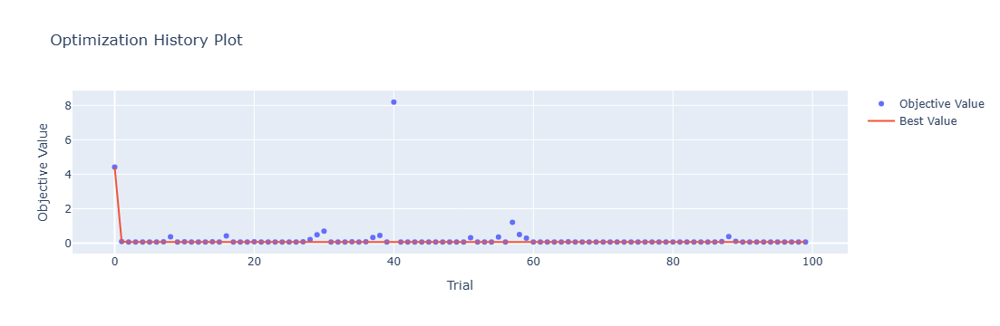

In [4]:
optuna.visualization.plot_optimization_history(study)

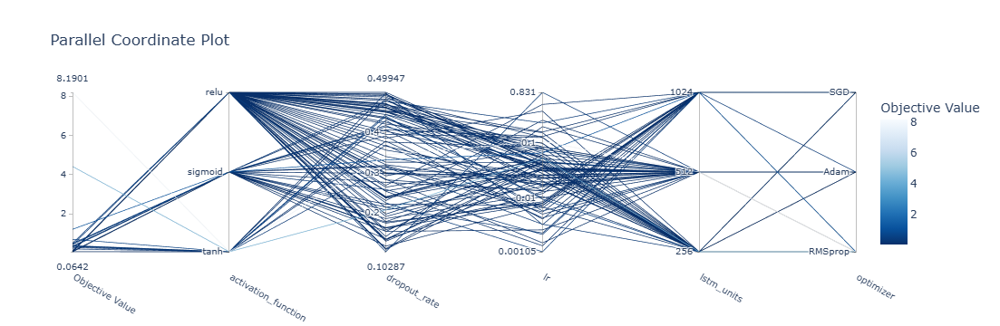

In [5]:
optuna.visualization.plot_parallel_coordinate(study)

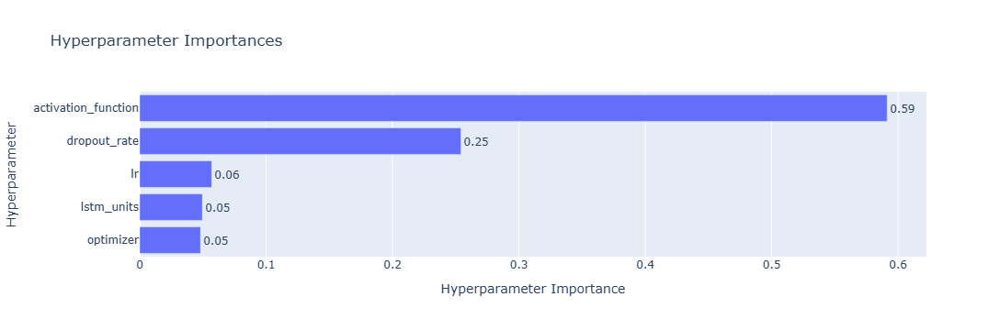

In [6]:
optuna.visualization.plot_param_importances(study)

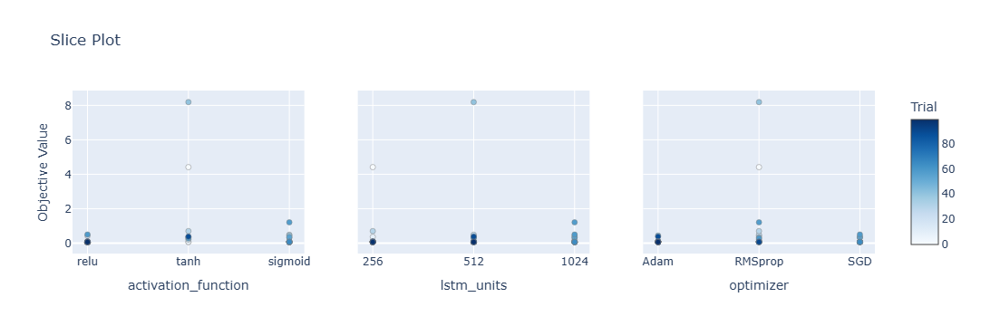

In [7]:
optuna.visualization.plot_slice(study, params=['optimizer', 'activation_function', 'lstm_units'])

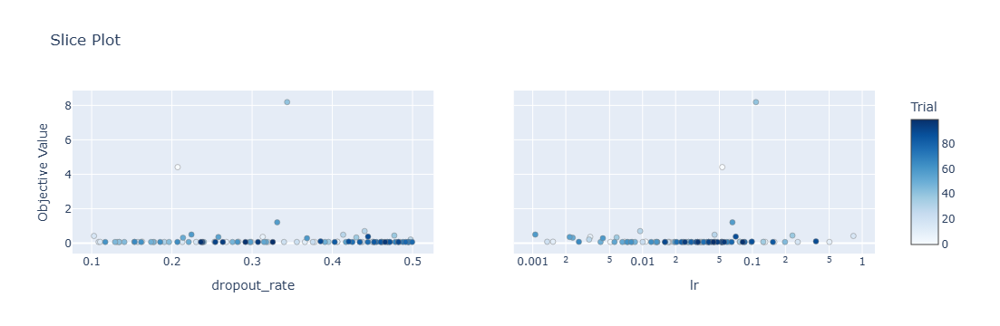

In [8]:
optuna.visualization.plot_slice(study, params=['lr', 'dropout_rate'])

Epoch 1/100
84/84 [==============================] - 27s 97ms/step - loss: 0.6129 - accuracy: 0.3810 - mae: 0.5593 - rmse: 0.6129 - mape: 121.0548 - pearson: 0.5824 - val_loss: 0.0638 - val_accuracy: 0.7000 - val_mae: 0.0507 - val_rmse: 0.0638 - val_mape: 10.8741 - val_pearson: 0.7852
Epoch 2/100
84/84 [==============================] - 4s 42ms/step - loss: 0.0690 - accuracy: 0.5357 - mae: 0.0544 - rmse: 0.0690 - mape: 12.2008 - pearson: 0.7612 - val_loss: 0.0739 - val_accuracy: 0.7000 - val_mae: 0.0579 - val_rmse: 0.0739 - val_mape: 12.8102 - val_pearson: 0.7170
Epoch 3/100
84/84 [==============================] - 2s 29ms/step - loss: 0.0693 - accuracy: 0.5000 - mae: 0.0548 - rmse: 0.0693 - mape: 12.3896 - pearson: 0.7600 - val_loss: 0.0838 - val_accuracy: 0.7000 - val_mae: 0.0681 - val_rmse: 0.0838 - val_mape: 14.8613 - val_pearson: 0.6859
Epoch 4/100
84/84 [==============================] - 3s 36ms/step - loss: 0.0689 - accuracy: 0.4881 - mae: 0.0547 - rmse: 0.0689 - mape: 12.4095 -

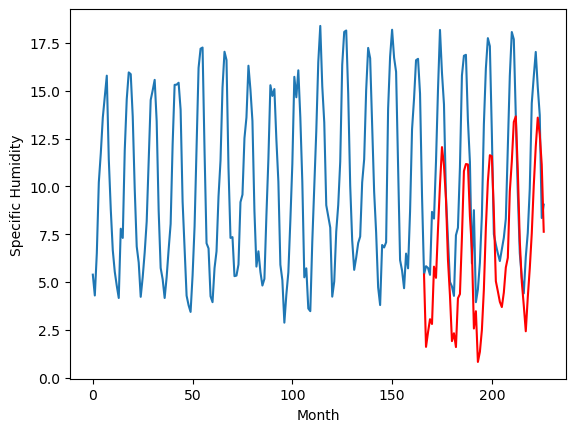

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.70		1.30		3.00
-1.37		2.07		3.44
-1.81		2.75		4.56
-1.08		2.50		3.58
2.80		5.50		2.70
1.01		4.91		3.90
3.33		7.45		4.12
7.01		9.77		2.76
8.67		11.75		3.08
8.61		10.79		2.18
6.51		9.02		2.51
3.95		5.85		1.90
0.62		4.00		3.38
-2.90		1.61		4.51
-2.55		2.02		4.57
-1.84		1.29		3.13
0.37		3.85		3.48
0.59		4.07		3.48
3.08		7.03		3.95
7.83		10.49		2.66
8.63		10.86		2.23
8.79		10.84		2.05
6.63		8.14		1.51
3.55		6.40		2.85
-2.11		2.26		4.37
1.53		3.17		1.64
-3.23		0.52		3.75
-2.01		1.05		3.06
-0.10		2.18		2.28
1.20		4.31		3.11
5.44		7.55		2.11
8.05		9.95		1.90
8.95		11.32		2.37
8.38		11.27		2.89
5.32		8.33		3.01
0.18		4.74		4.56
-0.02		4.21		4.23
-1.22		3.66		4.88
-1.13		3.39		4.52
0.56		4.14		3.58
0.94		5.45		4.51
1.73		5.96		4.23
3.92		9.43		5.51
7.25		11.00		3.75
8.92		13.06		4.14
9.70		13.35		3.65
5.68		10.53		4.85
0.98		6.83		5.85
-1.20		4.70		5.90
-2.64		3.47		6.11
-3.42		2.12		5.54
-2.20		3.8

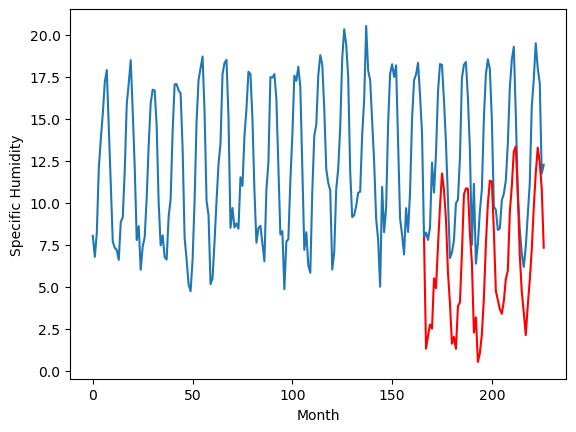

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.36		1.19		2.55
-1.11		1.96		3.07
-1.28		2.64		3.92
-0.73		2.39		3.12
1.87		5.39		3.52
0.62		4.80		4.18
3.48		7.34		3.86
7.39		9.66		2.27
9.79		11.64		1.85
9.88		10.68		0.80
6.79		8.91		2.12
4.04		5.74		1.70
0.71		3.89		3.18
-2.45		1.50		3.95
-2.07		1.91		3.98
-1.92		1.18		3.10
-0.07		3.74		3.81
0.17		3.96		3.79
2.93		6.92		3.99
7.55		10.38		2.83
9.46		10.75		1.29
9.66		10.73		1.07
6.66		8.03		1.37
3.94		6.29		2.35
-1.93		2.15		4.08
0.47		3.06		2.59
-2.94		0.41		3.35
-1.73		0.94		2.67
-1.02		2.07		3.09
0.43		4.20		3.77
4.57		7.44		2.87
7.35		9.84		2.49
9.55		11.21		1.66
8.85		11.16		2.31
5.12		8.22		3.10
0.12		4.63		4.51
-0.20		4.10		4.30
-1.53		3.55		5.08
-1.16		3.28		4.44
-0.05		4.03		4.08
-0.69		5.34		6.03
0.75		5.85		5.10
3.53		9.32		5.79
6.11		10.89		4.78
8.97		12.95		3.98
9.06		13.24		4.18
5.48		10.42		4.94
1.57		6.72		5.15
-0.96		4.59		5.55
-1.77		3.36		5.13
-2.57		2.01		4.58
-1.93		

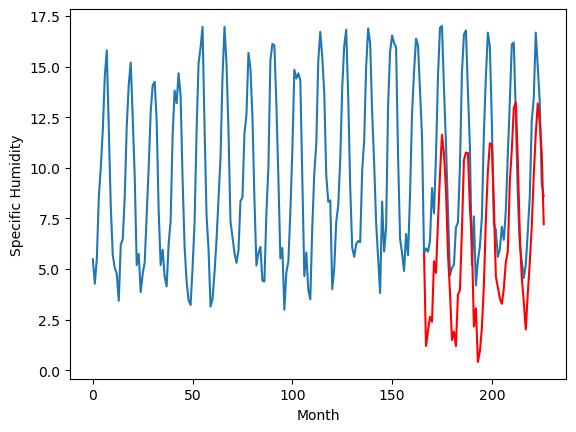

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.82		0.89		2.71
-1.28		1.66		2.94
-1.04		2.34		3.38
-0.90		2.09		2.99
3.41		5.09		1.68
2.26		4.50		2.24
4.41		7.04		2.63
6.90		9.36		2.46
9.65		11.34		1.69
8.40		10.38		1.98
7.05		8.61		1.56
3.24		5.44		2.20
0.19		3.59		3.40
-2.88		1.20		4.08
-2.81		1.61		4.42
-2.90		0.88		3.78
0.55		3.44		2.89
1.12		3.66		2.54
4.63		6.62		1.99
8.53		10.08		1.55
9.37		10.45		1.08
8.99		10.43		1.44
6.68		7.73		1.05
4.25		5.99		1.74
-1.96		1.85		3.81
1.09		2.76		1.67
-4.03		0.11		4.14
-2.82		0.64		3.46
-1.73		1.77		3.50
1.19		3.90		2.71
5.43		7.14		1.71
7.44		9.54		2.10
8.65		10.91		2.26
7.93		10.86		2.93
4.55		7.92		3.37
-0.55		4.33		4.88
-1.07		3.80		4.87
-1.57		3.25		4.82
-1.38		2.98		4.36
-0.71		3.73		4.44
0.37		5.04		4.67
0.77		5.55		4.78
3.62		9.02		5.40
7.77		10.59		2.82
8.80		12.65		3.85
8.55		12.94		4.39
6.37		10.12		3.75
1.80		6.42		4.62
-1.19		4.29		5.48
-2.59		3.06		5.65
-3.51		1.71		5.22
-1.73		3

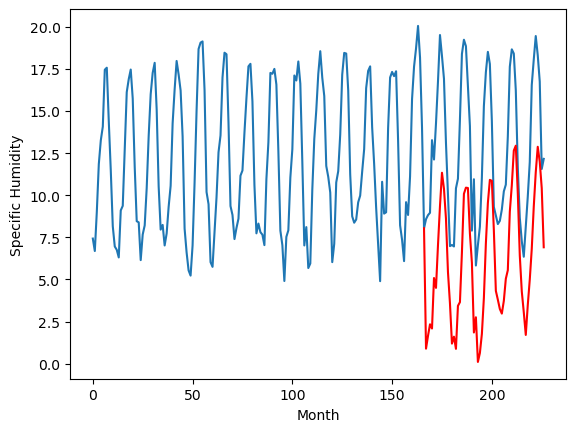

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.25		2.14		-0.11
1.00		2.91		1.91
1.79		3.59		1.80
1.18		3.34		2.16
5.63		6.34		0.71
5.35		5.75		0.40
7.93		8.29		0.36
10.29		10.61		0.32
13.15		12.59		-0.56
10.88		11.63		0.75
9.57		9.86		0.29
5.29		6.69		1.40
3.44		4.84		1.40
0.66		2.45		1.79
0.59		2.86		2.27
0.19		2.13		1.94
3.03		4.69		1.66
4.43		4.91		0.48
8.44		7.87		-0.57
12.13		11.33		-0.80
12.84		11.70		-1.14
12.76		11.68		-1.08
8.53		8.98		0.45
6.44		7.24		0.80
2.22		3.10		0.88
4.98		4.01		-0.97
-0.52		1.36		1.88
-0.26		1.89		2.15
1.29		3.02		1.73
5.21		5.15		-0.06
8.91		8.39		-0.52
9.88		10.79		0.91
9.64		12.16		2.52
10.73		12.11		1.38
7.90		9.17		1.27
3.10		5.58		2.48
3.09		5.05		1.96
2.01		4.50		2.49
1.25		4.23		2.98
1.59		4.98		3.39
3.78		6.29		2.51
4.54		6.80		2.26
8.48		10.27		1.79
12.60		11.84		-0.76
11.18		13.90		2.72
9.36		14.19		4.83
9.32		11.37		2.05
5.57		7.67		2.10
2.77		5.54		2.77
0.91		4.31		3.40
-0.27		2.96		3.23
2.

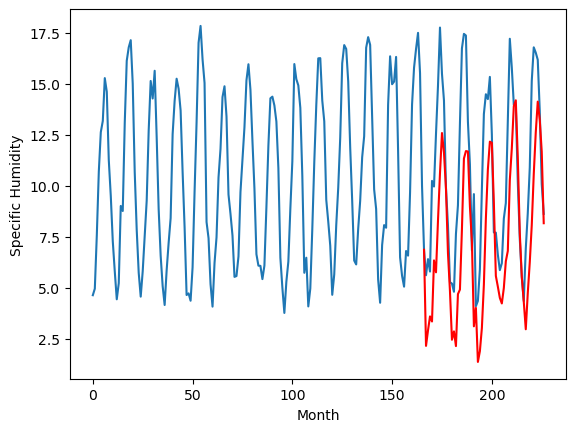

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.59		4.78		2.19
2.55		5.55		3.00
2.07		6.23		4.16
1.96		5.98		4.02
3.72		8.98		5.26
4.06		8.39		4.33
7.19		10.93		3.74
10.92		13.25		2.33
14.40		15.23		0.83
14.43		14.27		-0.16
11.53		12.50		0.97
7.83		9.33		1.50
4.88		7.48		2.60
1.12		5.09		3.97
0.51		5.50		4.99
1.10		4.77		3.67
2.67		7.33		4.66
3.68		7.55		3.87
6.18		10.51		4.33
11.44		13.97		2.53
12.56		14.34		1.78
13.72		14.32		0.60
9.63		11.62		1.99
7.31		9.88		2.57
2.05		5.74		3.69
3.47		6.65		3.18
0.36		4.00		3.64
1.74		4.53		2.79
3.07		5.66		2.59
4.20		7.79		3.59
8.98		11.03		2.05
10.07		13.43		3.36
14.40		14.80		0.40
12.61		14.75		2.14
9.91		11.81		1.90
5.27		8.22		2.95
4.61		7.69		3.08
1.26		7.14		5.88
2.01		6.87		4.86
2.94		7.62		4.68
2.72		8.93		6.21
5.40		9.44		4.04
6.16		12.91		6.75
10.06		14.48		4.42
14.41		16.54		2.13
13.52		16.83		3.31
10.40		14.01		3.61
6.00		10.31		4.31
2.98		8.18		5.20
2.16		6.95		4.79
1.37		5.60		4.23
1.

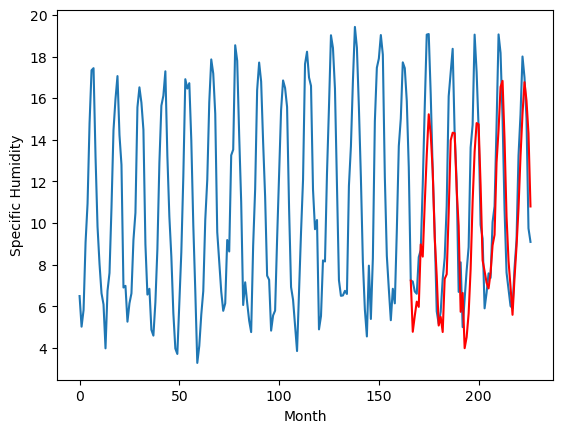

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.36		2.23		1.87
0.48		3.00		2.52
0.40		3.68		3.28
0.76		3.43		2.67
2.39		6.43		4.04
2.17		5.84		3.67
5.27		8.38		3.11
8.99		10.70		1.71
11.78		12.68		0.90
11.72		11.72		-0.00
8.19		9.95		1.76
5.47		6.78		1.31
2.62		4.93		2.31
-0.25		2.54		2.79
-0.40		2.95		3.35
-0.35		2.22		2.57
1.24		4.78		3.54
1.84		5.00		3.16
4.84		7.96		3.12
9.22		11.42		2.20
10.66		11.79		1.13
11.19		11.77		0.58
7.87		9.07		1.20
5.76		7.33		1.57
0.01		3.19		3.18
1.85		4.10		2.25
-0.93		1.45		2.38
0.35		1.98		1.63
1.36		3.11		1.75
2.36		5.24		2.88
6.72		8.48		1.76
8.60		10.88		2.28
12.22		12.25		0.03
10.87		12.20		1.33
7.43		9.26		1.83
2.87		5.67		2.80
2.27		5.14		2.87
0.09		4.59		4.50
0.95		4.32		3.37
1.63		5.07		3.44
1.22		6.38		5.16
3.43		6.89		3.46
5.02		10.36		5.34
7.75		11.93		4.18
11.49		13.99		2.50
11.12		14.28		3.16
8.18		11.46		3.28
3.92		7.76		3.84
0.59		5.63		5.04
0.52		4.40		3.88
-0.15		3.05		3.20
0.01		4.82

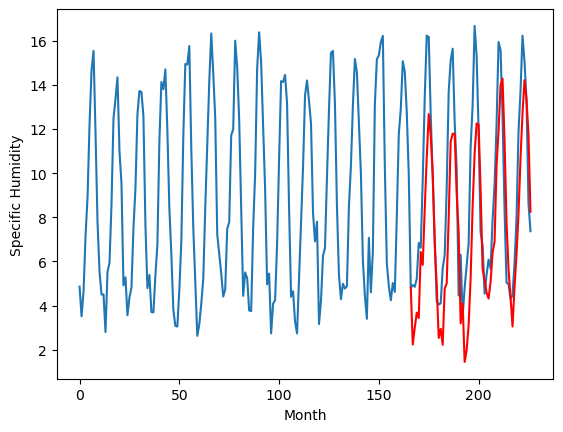

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.52		4.18		1.66
2.77		4.95		2.18
2.80		5.63		2.83
3.02		5.38		2.36
4.32		8.38		4.06
4.26		7.79		3.53
6.25		10.33		4.08
10.92		12.65		1.73
13.73		14.63		0.90
13.97		13.67		-0.30
10.07		11.90		1.83
7.36		8.73		1.37
4.82		6.88		2.06
1.95		4.49		2.54
1.64		4.90		3.26
1.67		4.17		2.50
3.29		6.73		3.44
3.99		6.95		2.96
7.01		9.91		2.90
11.28		13.37		2.09
12.78		13.74		0.96
13.06		13.72		0.66
9.57		11.02		1.45
7.69		9.28		1.59
1.90		5.14		3.24
3.67		6.05		2.38
1.16		3.40		2.24
2.39		3.93		1.54
3.38		5.06		1.68
4.28		7.19		2.91
8.57		10.43		1.86
10.02		12.83		2.81
13.39		14.20		0.81
12.32		14.15		1.83
9.53		11.21		1.68
5.11		7.62		2.51
4.41		7.09		2.68
2.07		6.54		4.47
3.00		6.27		3.27
3.36		7.02		3.66
3.28		8.33		5.05
5.56		8.84		3.28
6.88		12.31		5.43
9.50		13.88		4.38
13.85		15.94		2.09
12.79		16.23		3.44
9.99		13.41		3.42
6.24		9.71		3.47
2.72		7.58		4.86
2.92		6.35		3.43
2.23		5.00		2.77
2.26		

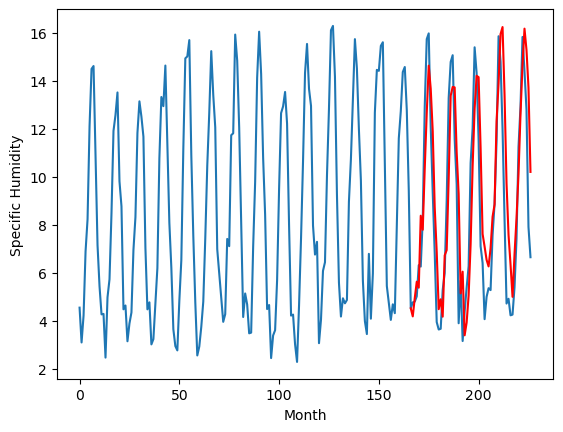

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.35		1.38		0.03
1.44		2.15		0.71
1.04		2.83		1.79
1.03		2.58		1.55
3.29		5.58		2.29
3.53		4.99		1.46
6.75		7.53		0.78
10.40		9.85		-0.55
13.49		11.83		-1.66
11.46		10.87		-0.59
8.74		9.10		0.36
4.29		5.93		1.64
2.53		4.08		1.55
0.62		1.69		1.07
0.39		2.10		1.71
-0.29		1.37		1.66
2.77		3.93		1.16
3.50		4.15		0.65
6.41		7.11		0.70
11.39		10.57		-0.82
12.89		10.94		-1.95
13.08		10.92		-2.16
9.27		8.22		-1.05
6.85		6.48		-0.37
1.56		2.34		0.78
3.15		3.25		0.10
-0.13		0.60		0.73
0.46		1.13		0.67
2.14		2.26		0.12
3.72		4.39		0.67
7.91		7.63		-0.28
10.09		10.03		-0.06
13.75		11.40		-2.35
12.78		11.35		-1.43
8.33		8.41		0.08
3.10		4.82		1.72
2.10		4.29		2.19
1.17		3.74		2.57
1.77		3.47		1.70
1.84		4.22		2.38
2.28		5.53		3.25
3.50		6.04		2.54
6.99		9.51		2.52
9.27		11.08		1.81
12.82		13.14		0.32
12.82		13.43		0.61
8.75		10.61		1.86
4.69		6.91		2.22
2.03		4.78		2.75
1.42		3.55		2.13
0.24		2.20		1.96
2

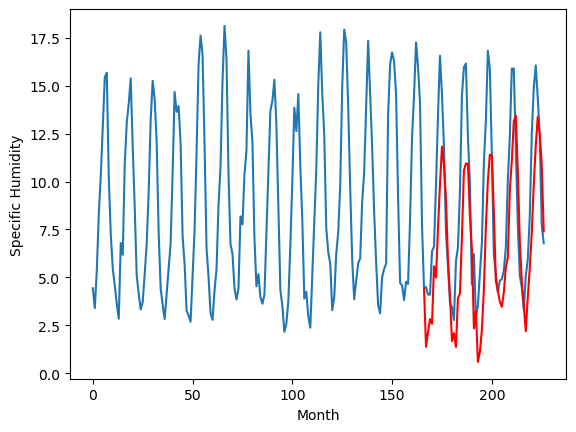

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.84		3.25		0.41
3.25		4.02		0.77
2.75		4.70		1.95
2.43		4.45		2.02
4.39		7.45		3.06
4.45		6.86		2.41
7.59		9.40		1.81
10.28		11.72		1.44
13.42		13.70		0.28
12.20		12.74		0.54
9.41		10.97		1.56
6.07		7.80		1.73
4.02		5.95		1.93
2.36		3.56		1.20
2.03		3.97		1.94
1.58		3.24		1.66
3.38		5.80		2.42
4.70		6.02		1.32
6.79		8.98		2.19
11.56		12.44		0.88
12.49		12.81		0.32
12.91		12.79		-0.12
9.74		10.09		0.35
8.43		8.35		-0.08
2.91		4.21		1.30
3.75		5.12		1.37
1.46		2.47		1.01
2.20		3.00		0.80
3.48		4.13		0.65
5.10		6.26		1.16
9.71		9.50		-0.21
11.39		11.90		0.51
14.97		13.27		-1.70
13.43		13.22		-0.21
10.37		10.28		-0.09
4.58		6.69		2.11
3.86		6.16		2.30
2.93		5.61		2.68
3.54		5.34		1.80
3.31		6.09		2.78
3.41		7.40		3.99
5.14		7.91		2.77
7.58		11.38		3.80
10.20		12.95		2.75
14.02		15.01		0.99
12.72		15.30		2.58
10.00		12.48		2.48
6.76		8.78		2.02
3.41		6.65		3.24
3.60		5.42		1.82
2.63		4.07		1.44


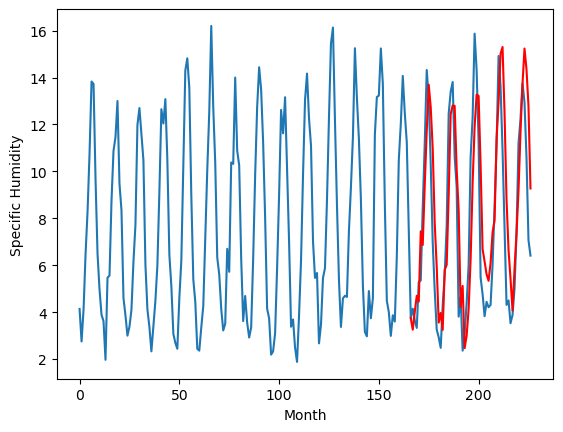

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.21		1.61		0.40
1.33		2.38		1.05
0.95		3.06		2.11
0.44		2.81		2.37
2.04		5.81		3.77
2.40		5.22		2.82
5.30		7.76		2.46
8.40		10.08		1.68
11.45		12.06		0.61
9.88		11.10		1.22
7.22		9.33		2.11
3.77		6.16		2.39
2.36		4.31		1.95
0.83		1.92		1.09
0.45		2.33		1.88
-0.29		1.60		1.89
1.33		4.16		2.83
2.93		4.38		1.45
4.45		7.34		2.89
9.58		10.80		1.22
10.65		11.17		0.52
11.14		11.15		0.01
7.52		8.45		0.93
6.53		6.71		0.18
1.68		2.57		0.89
1.68		3.48		1.80
-0.39		0.83		1.22
0.21		1.36		1.15
1.46		2.49		1.03
2.40		4.62		2.22
6.12		7.86		1.74
7.39		10.26		2.87
9.88		11.63		1.75
10.87		11.58		0.71
8.27		8.64		0.37
3.25		5.05		1.80
2.11		4.52		2.41
0.94		3.97		3.03
1.34		3.70		2.36
0.78		4.45		3.67
1.24		5.76		4.52
2.88		6.27		3.39
4.09		9.74		5.65
7.10		11.31		4.21
10.93		13.37		2.44
10.18		13.66		3.48
8.87		10.84		1.97
5.11		7.14		2.03
1.70		5.01		3.31
2.23		3.78		1.55
0.71		2.43		1.72
1.24		4.20		2.96

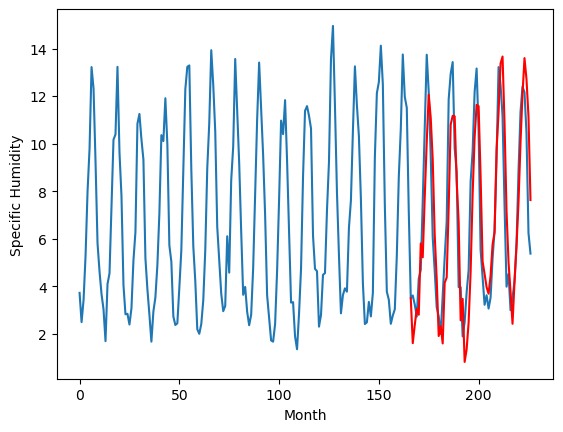

RangeIndex(start=1, stop=12, step=1)
[0.7500000000000009, -1.7000000000000002, -1.3600000000000003, -1.8200000000000012, 2.2500000000000004, 2.59, 0.3600000000000003, 2.5199999999999996, 1.3499999999999996, 2.84, 1.21]
[1.614483222961426, 1.3044832229614256, 1.1944832229614262, 0.8944832229614255, 2.1444832229614255, 4.784483222961425, 2.234483222961426, 4.1844832229614255, 1.3844832229614257, 3.254483222961426, 1.614483222961426]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    0.75   1.614483
1                 1   -1.70   1.304483
2                 2   -1.36   1.194483
3                 3   -1.82   0.894483
4                 4    2.25   2.144483
5                 5    2.59   4.784483
6                 6    0.36   2.234483
7                 7    2.52   4.184483
8                 8    1.35   1.384483
9                 9    2.84   3.254483
10               10    1.21   1.614483


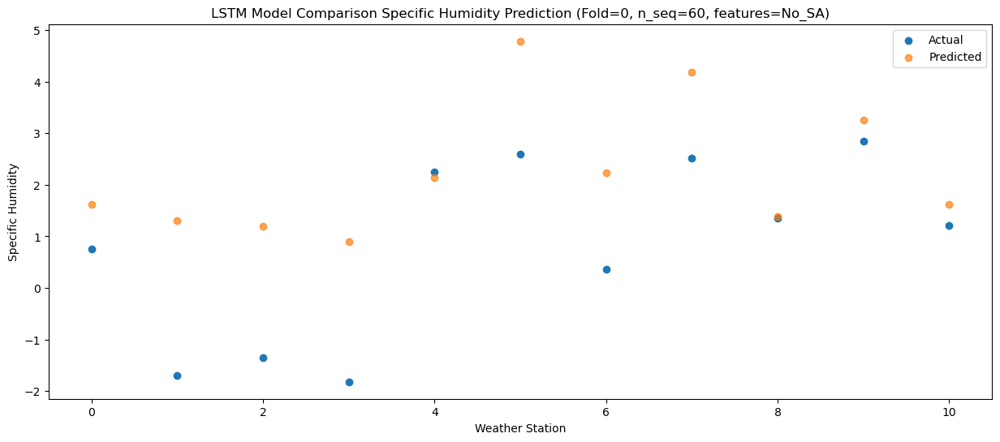

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    1.18   2.377014
1                 1   -1.37   2.067014
2                 2   -1.11   1.957014
3                 3   -1.28   1.657014
4                 4    1.00   2.907014
5                 5    2.55   5.547014
6                 6    0.48   2.997014
7                 7    2.77   4.947014
8                 8    1.44   2.147014
9                 9    3.25   4.017014
10               10    1.33   2.377014


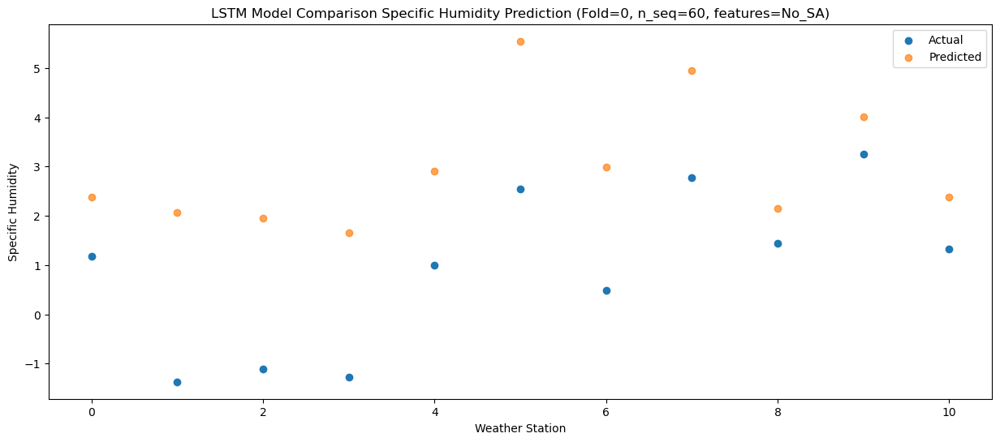

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0    1.09   3.061844
1                 1   -1.81   2.751844
2                 2   -1.28   2.641844
3                 3   -1.04   2.341844
4                 4    1.79   3.591844
5                 5    2.07   6.231844
6                 6    0.40   3.681844
7                 7    2.80   5.631844
8                 8    1.04   2.831844
9                 9    2.75   4.701844
10               10    0.95   3.061844


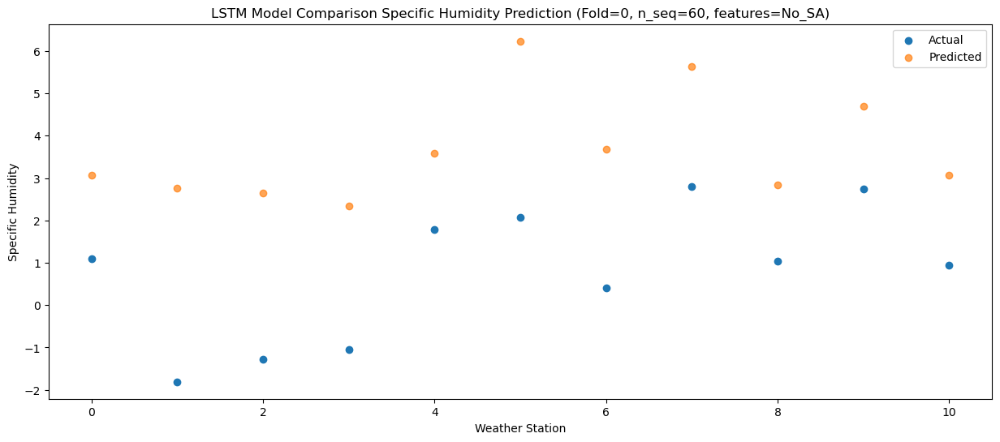

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0    0.73   2.809686
1                 1   -1.08   2.499686
2                 2   -0.73   2.389686
3                 3   -0.90   2.089686
4                 4    1.18   3.339686
5                 5    1.96   5.979686
6                 6    0.76   3.429686
7                 7    3.02   5.379686
8                 8    1.03   2.579686
9                 9    2.43   4.449686
10               10    0.44   2.809686


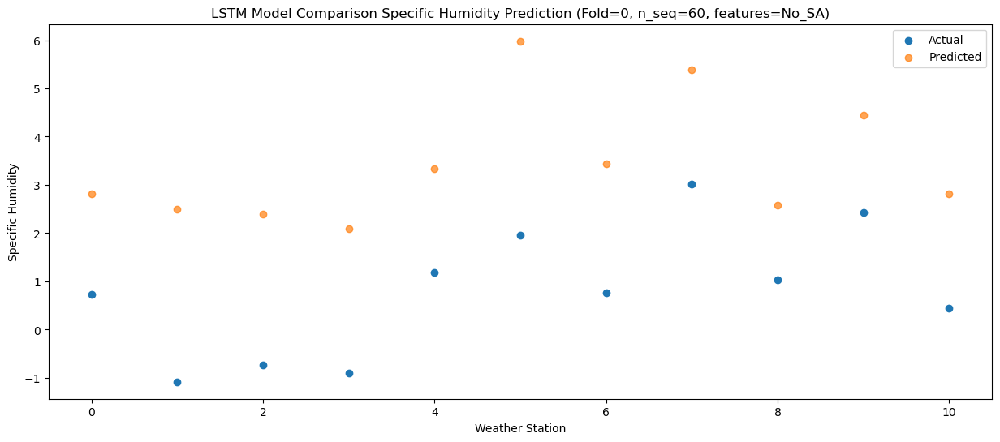

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    4.02   5.807527
1                 1    2.80   5.497527
2                 2    1.87   5.387527
3                 3    3.41   5.087527
4                 4    5.63   6.337527
5                 5    3.72   8.977527
6                 6    2.39   6.427527
7                 7    4.32   8.377527
8                 8    3.29   5.577527
9                 9    4.39   7.447527
10               10    2.04   5.807527


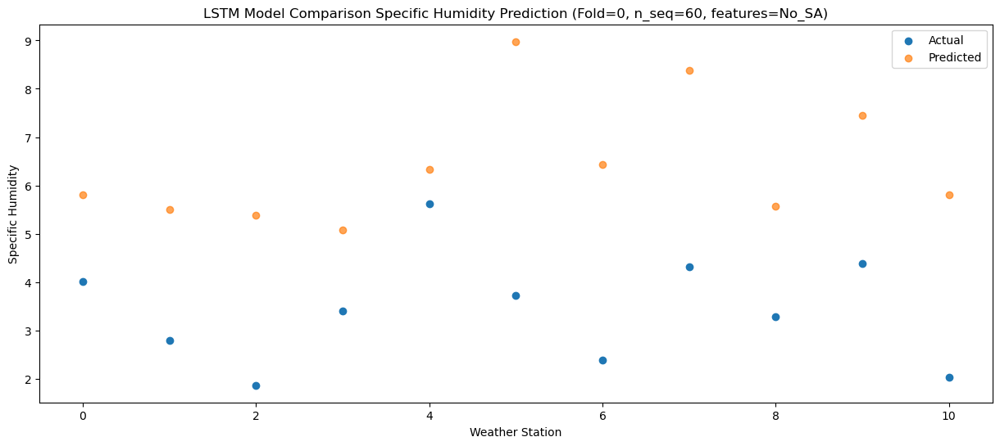

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    3.67     5.2235
1                 1    1.01     4.9135
2                 2    0.62     4.8035
3                 3    2.26     4.5035
4                 4    5.35     5.7535
5                 5    4.06     8.3935
6                 6    2.17     5.8435
7                 7    4.26     7.7935
8                 8    3.53     4.9935
9                 9    4.45     6.8635
10               10    2.40     5.2235


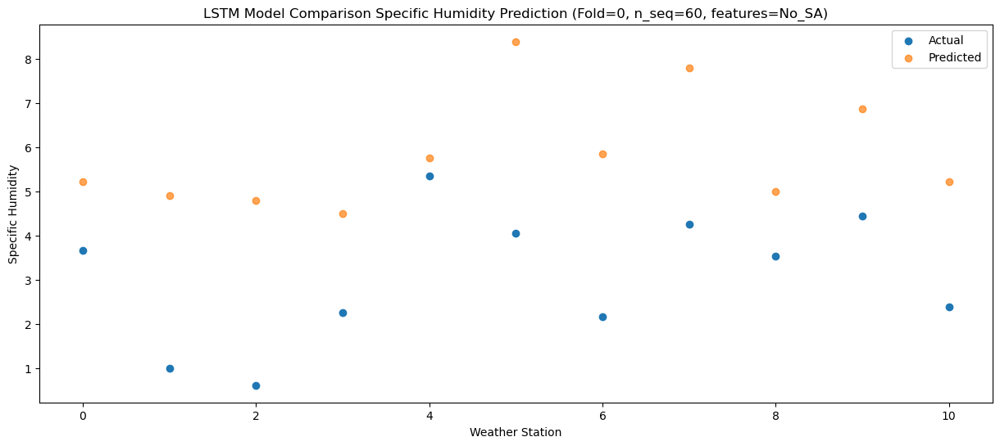

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    6.64   7.762778
1                 1    3.33   7.452778
2                 2    3.48   7.342778
3                 3    4.41   7.042778
4                 4    7.93   8.292778
5                 5    7.19  10.932778
6                 6    5.27   8.382778
7                 7    6.25  10.332778
8                 8    6.75   7.532778
9                 9    7.59   9.402778
10               10    5.30   7.762778


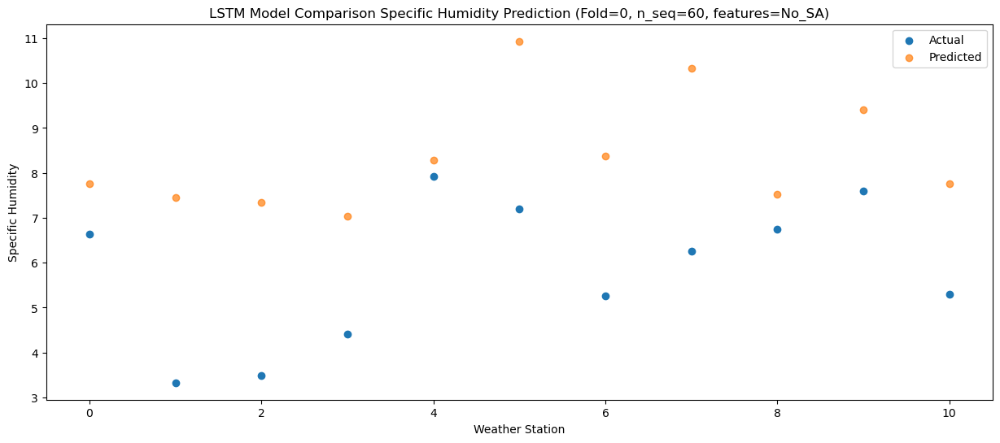

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   10.40  10.082813
1                 1    7.01   9.772813
2                 2    7.39   9.662813
3                 3    6.90   9.362813
4                 4   10.29  10.612813
5                 5   10.92  13.252813
6                 6    8.99  10.702813
7                 7   10.92  12.652813
8                 8   10.40   9.852813
9                 9   10.28  11.722813
10               10    8.40  10.082813


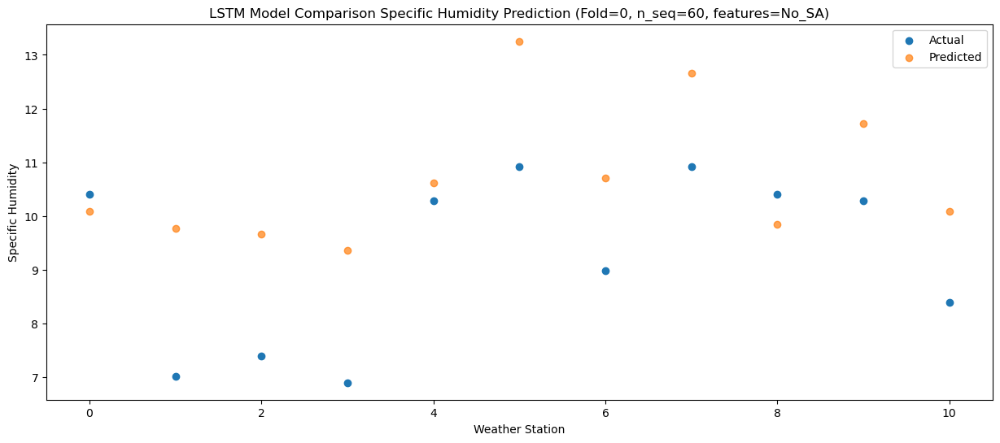

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   13.53  12.055579
1                 1    8.67  11.745579
2                 2    9.79  11.635579
3                 3    9.65  11.335579
4                 4   13.15  12.585579
5                 5   14.40  15.225579
6                 6   11.78  12.675579
7                 7   13.73  14.625579
8                 8   13.49  11.825579
9                 9   13.42  13.695579
10               10   11.45  12.055579


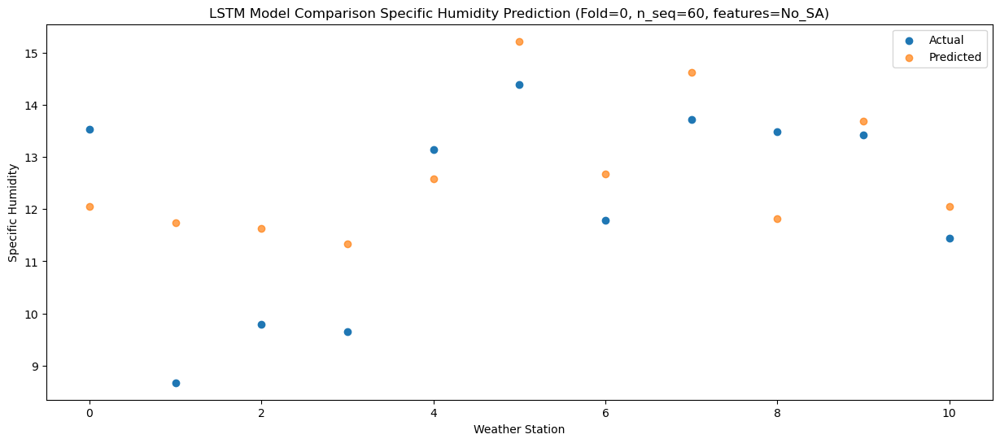

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   11.28  11.096626
1                 1    8.61  10.786626
2                 2    9.88  10.676626
3                 3    8.40  10.376626
4                 4   10.88  11.626626
5                 5   14.43  14.266626
6                 6   11.72  11.716626
7                 7   13.97  13.666626
8                 8   11.46  10.866626
9                 9   12.20  12.736626
10               10    9.88  11.096626


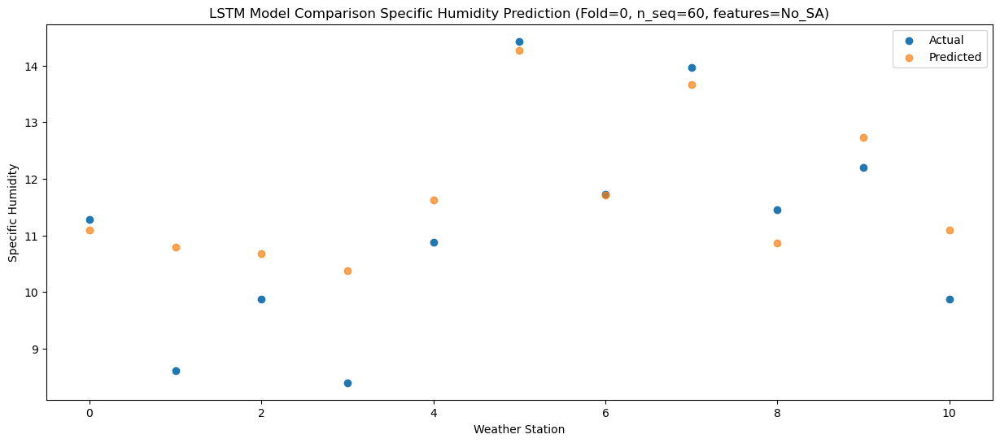

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    9.64   9.332497
1                 1    6.51   9.022497
2                 2    6.79   8.912497
3                 3    7.05   8.612497
4                 4    9.57   9.862497
5                 5   11.53  12.502497
6                 6    8.19   9.952497
7                 7   10.07  11.902497
8                 8    8.74   9.102497
9                 9    9.41  10.972497
10               10    7.22   9.332497


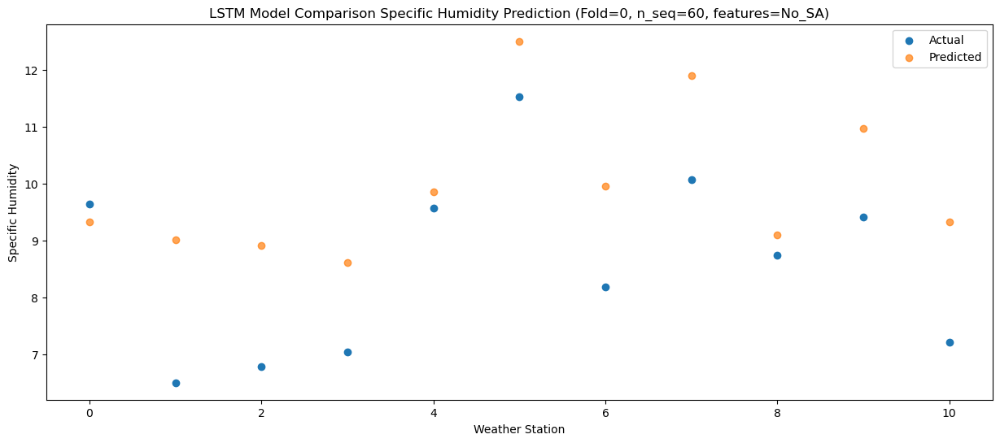

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    4.83   6.160953
1                 1    3.95   5.850953
2                 2    4.04   5.740953
3                 3    3.24   5.440953
4                 4    5.29   6.690953
5                 5    7.83   9.330953
6                 6    5.47   6.780953
7                 7    7.36   8.730953
8                 8    4.29   5.930953
9                 9    6.07   7.800953
10               10    3.77   6.160953


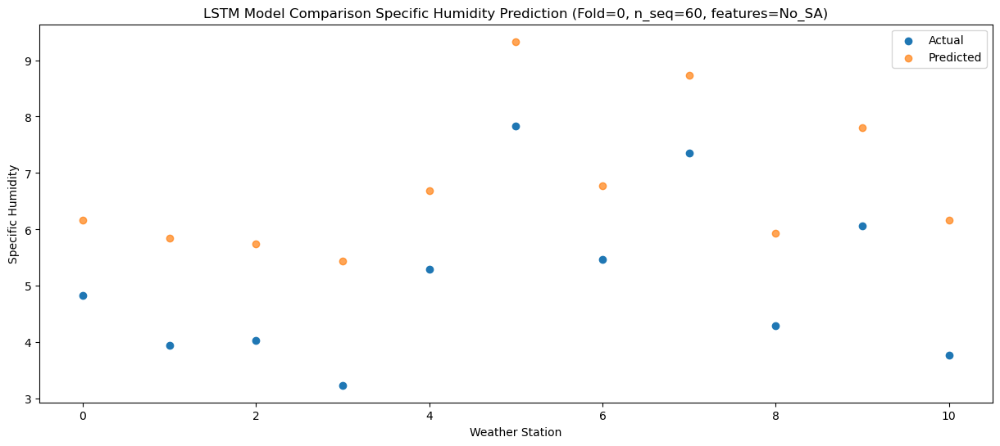

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    2.59   4.305594
1                 1    0.62   3.995594
2                 2    0.71   3.885594
3                 3    0.19   3.585594
4                 4    3.44   4.835594
5                 5    4.88   7.475594
6                 6    2.62   4.925594
7                 7    4.82   6.875594
8                 8    2.53   4.075594
9                 9    4.02   5.945594
10               10    2.36   4.305594


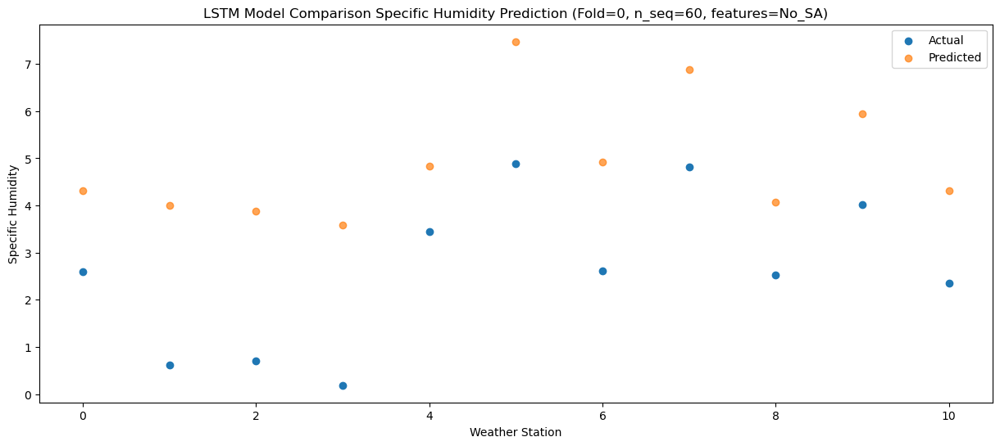

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0    0.36   1.915789
1                 1   -2.90   1.605789
2                 2   -2.45   1.495789
3                 3   -2.88   1.195789
4                 4    0.66   2.445789
5                 5    1.12   5.085789
6                 6   -0.25   2.535789
7                 7    1.95   4.485789
8                 8    0.62   1.685789
9                 9    2.36   3.555789
10               10    0.83   1.915789


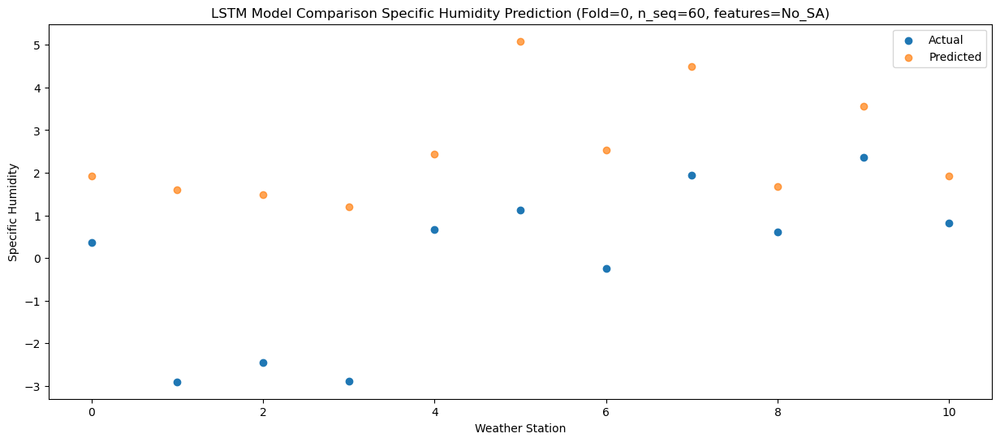

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0    0.12   2.327517
1                 1   -2.55   2.017517
2                 2   -2.07   1.907517
3                 3   -2.81   1.607517
4                 4    0.59   2.857517
5                 5    0.51   5.497517
6                 6   -0.40   2.947517
7                 7    1.64   4.897517
8                 8    0.39   2.097517
9                 9    2.03   3.967517
10               10    0.45   2.327517


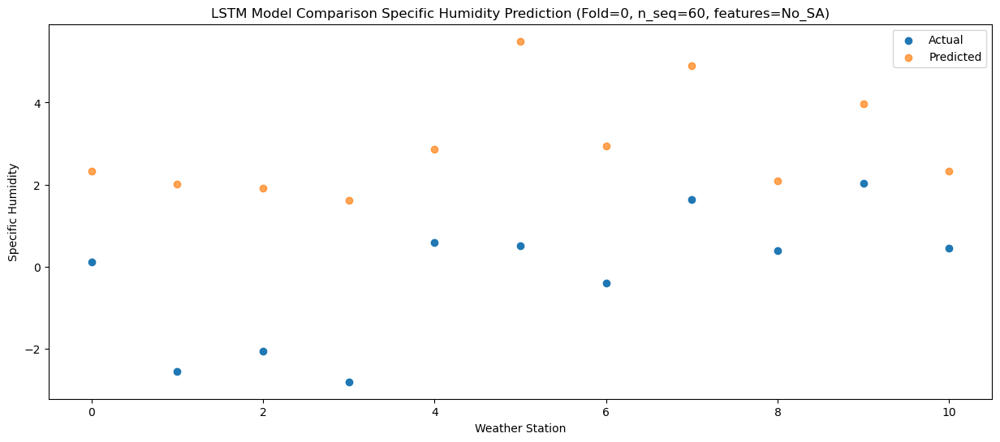

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -0.37   1.604161
1                 1   -1.84   1.294161
2                 2   -1.92   1.184161
3                 3   -2.90   0.884161
4                 4    0.19   2.134161
5                 5    1.10   4.774161
6                 6   -0.35   2.224161
7                 7    1.67   4.174161
8                 8   -0.29   1.374161
9                 9    1.58   3.244161
10               10   -0.29   1.604161


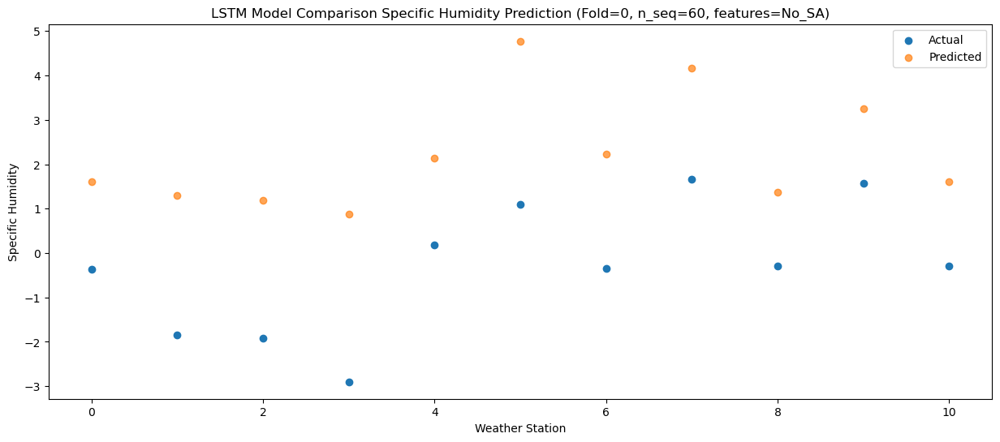

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    2.80   4.155042
1                 1    0.37   3.845042
2                 2   -0.07   3.735042
3                 3    0.55   3.435042
4                 4    3.03   4.685042
5                 5    2.67   7.325042
6                 6    1.24   4.775042
7                 7    3.29   6.725042
8                 8    2.77   3.925042
9                 9    3.38   5.795042
10               10    1.33   4.155042


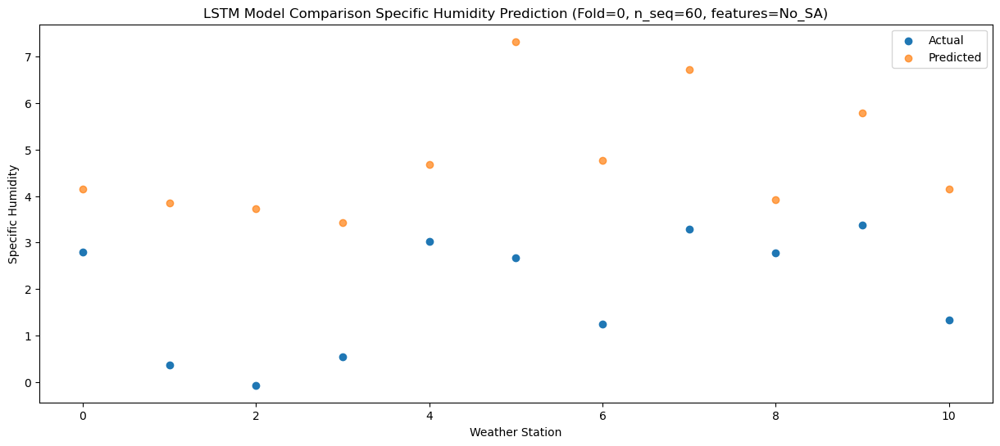

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    3.19    4.37671
1                 1    0.59    4.06671
2                 2    0.17    3.95671
3                 3    1.12    3.65671
4                 4    4.43    4.90671
5                 5    3.68    7.54671
6                 6    1.84    4.99671
7                 7    3.99    6.94671
8                 8    3.50    4.14671
9                 9    4.70    6.01671
10               10    2.93    4.37671


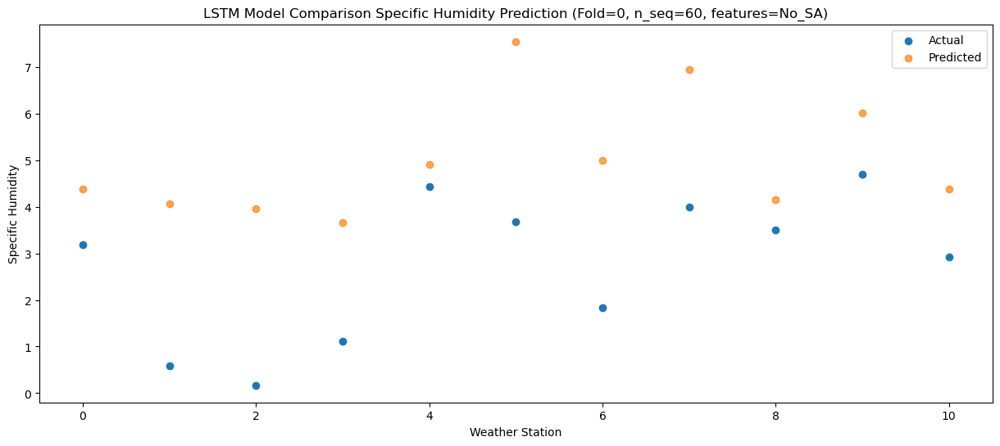

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    6.34   7.340522
1                 1    3.08   7.030522
2                 2    2.93   6.920522
3                 3    4.63   6.620522
4                 4    8.44   7.870522
5                 5    6.18  10.510522
6                 6    4.84   7.960522
7                 7    7.01   9.910522
8                 8    6.41   7.110522
9                 9    6.79   8.980522
10               10    4.45   7.340522


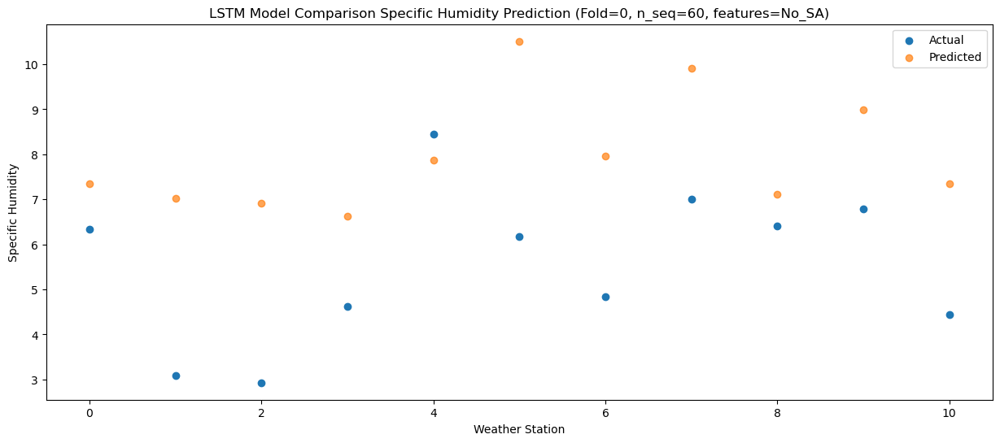

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   11.15  10.804738
1                 1    7.83  10.494738
2                 2    7.55  10.384738
3                 3    8.53  10.084738
4                 4   12.13  11.334738
5                 5   11.44  13.974738
6                 6    9.22  11.424738
7                 7   11.28  13.374738
8                 8   11.39  10.574738
9                 9   11.56  12.444738
10               10    9.58  10.804738


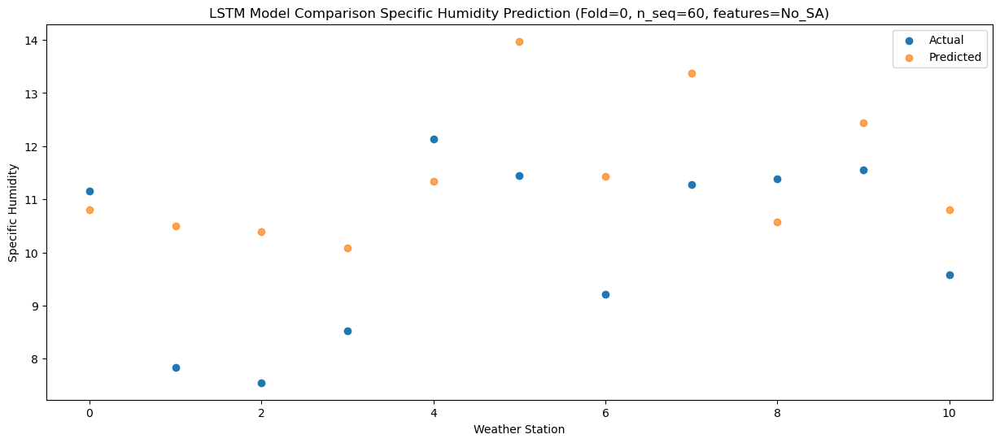

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   12.18  11.170596
1                 1    8.63  10.860596
2                 2    9.46  10.750596
3                 3    9.37  10.450596
4                 4   12.84  11.700596
5                 5   12.56  14.340596
6                 6   10.66  11.790596
7                 7   12.78  13.740596
8                 8   12.89  10.940596
9                 9   12.49  12.810596
10               10   10.65  11.170596


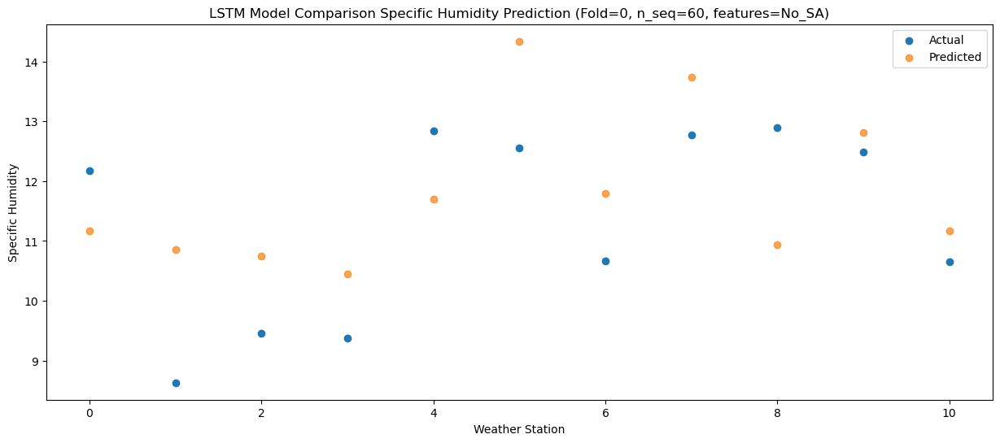

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   12.23  11.150929
1                 1    8.79  10.840929
2                 2    9.66  10.730929
3                 3    8.99  10.430929
4                 4   12.76  11.680929
5                 5   13.72  14.320929
6                 6   11.19  11.770929
7                 7   13.06  13.720929
8                 8   13.08  10.920929
9                 9   12.91  12.790929
10               10   11.14  11.150929


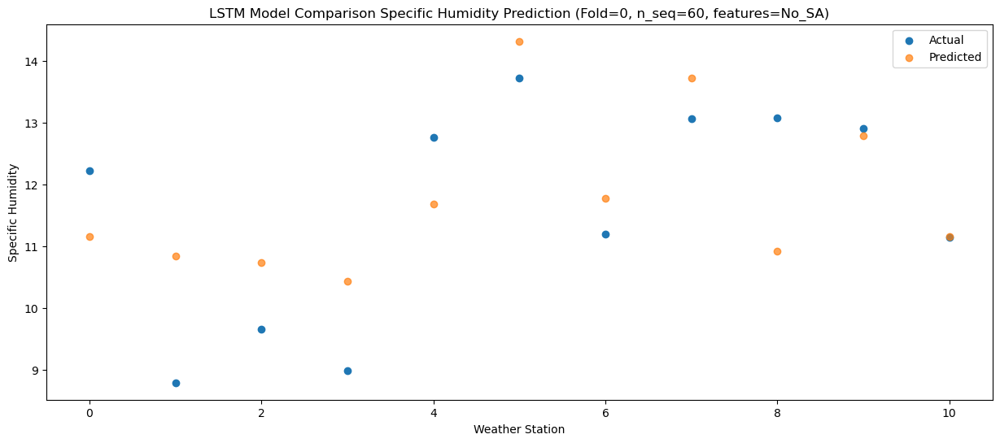

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    8.81   8.452388
1                 1    6.63   8.142388
2                 2    6.66   8.032388
3                 3    6.68   7.732388
4                 4    8.53   8.982388
5                 5    9.63  11.622388
6                 6    7.87   9.072388
7                 7    9.57  11.022388
8                 8    9.27   8.222388
9                 9    9.74  10.092388
10               10    7.52   8.452388


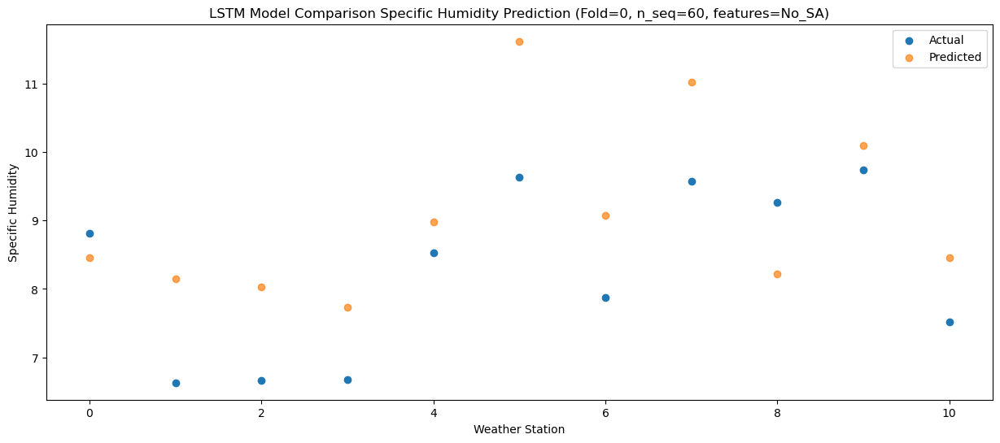

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    6.63   6.708006
1                 1    3.55   6.398006
2                 2    3.94   6.288006
3                 3    4.25   5.988006
4                 4    6.44   7.238006
5                 5    7.31   9.878006
6                 6    5.76   7.328006
7                 7    7.69   9.278006
8                 8    6.85   6.478006
9                 9    8.43   8.348006
10               10    6.53   6.708006


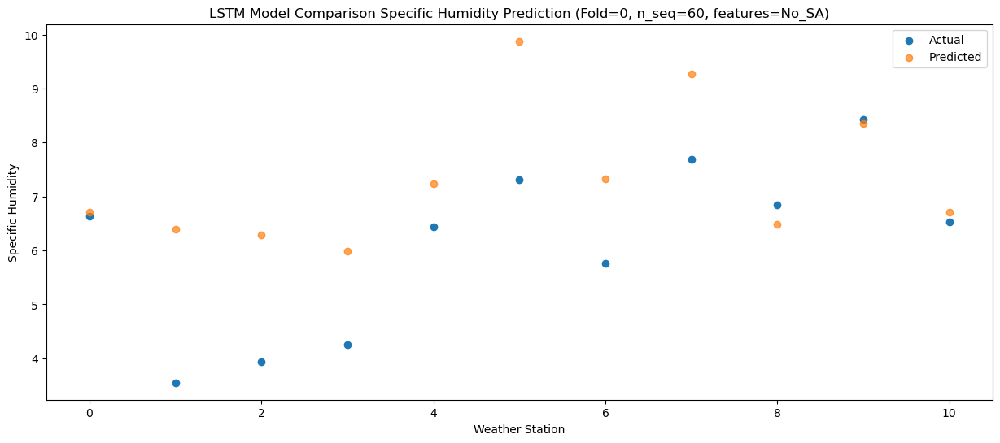

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    1.33   2.574338
1                 1   -2.11   2.264338
2                 2   -1.93   2.154338
3                 3   -1.96   1.854338
4                 4    2.22   3.104338
5                 5    2.05   5.744338
6                 6    0.01   3.194338
7                 7    1.90   5.144338
8                 8    1.56   2.344338
9                 9    2.91   4.214338
10               10    1.68   2.574338


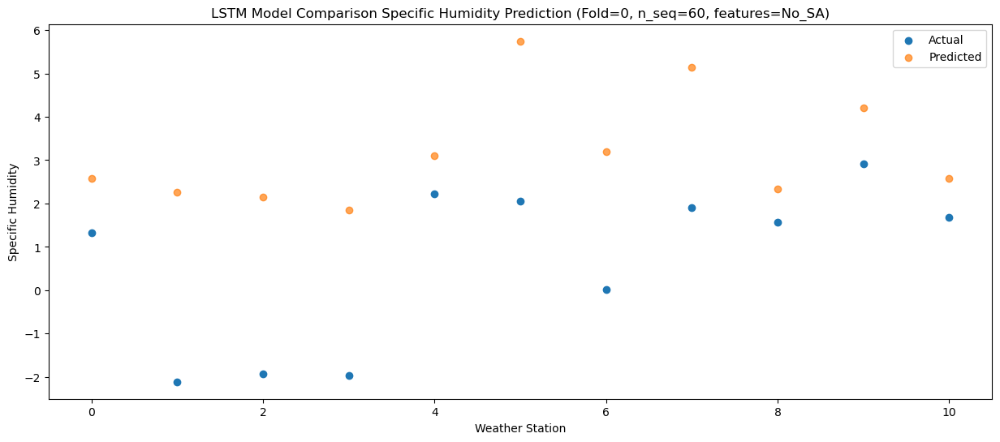

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    4.11   3.477738
1                 1    1.53   3.167738
2                 2    0.47   3.057738
3                 3    1.09   2.757738
4                 4    4.98   4.007738
5                 5    3.47   6.647738
6                 6    1.85   4.097738
7                 7    3.67   6.047738
8                 8    3.15   3.247738
9                 9    3.75   5.117738
10               10    1.68   3.477738


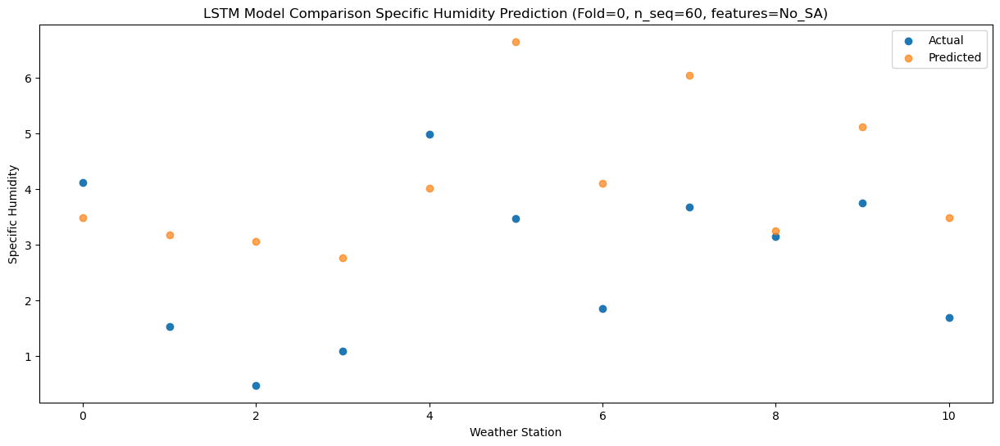

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -0.70   0.827657
1                 1   -3.23   0.517657
2                 2   -2.94   0.407657
3                 3   -4.03   0.107657
4                 4   -0.52   1.357657
5                 5    0.36   3.997657
6                 6   -0.93   1.447657
7                 7    1.16   3.397657
8                 8   -0.13   0.597657
9                 9    1.46   2.467657
10               10   -0.39   0.827657


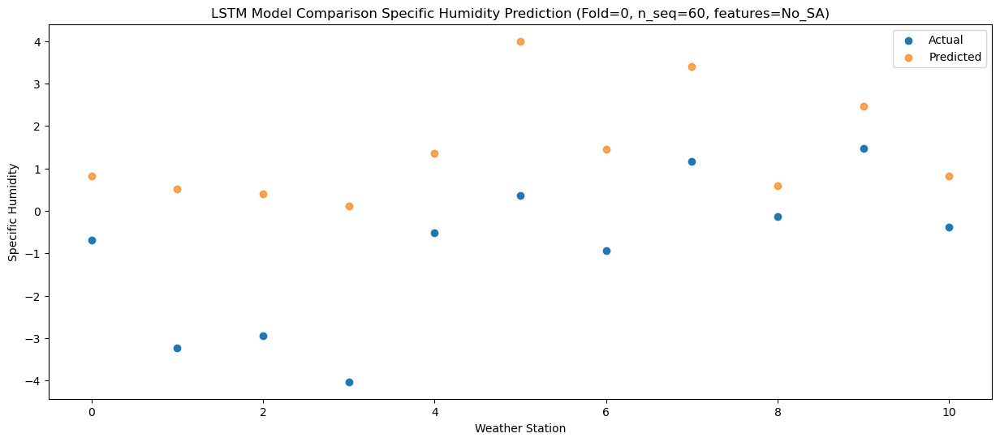

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -0.04   1.356303
1                 1   -2.01   1.046303
2                 2   -1.73   0.936303
3                 3   -2.82   0.636303
4                 4   -0.26   1.886303
5                 5    1.74   4.526303
6                 6    0.35   1.976303
7                 7    2.39   3.926303
8                 8    0.46   1.126303
9                 9    2.20   2.996303
10               10    0.21   1.356303


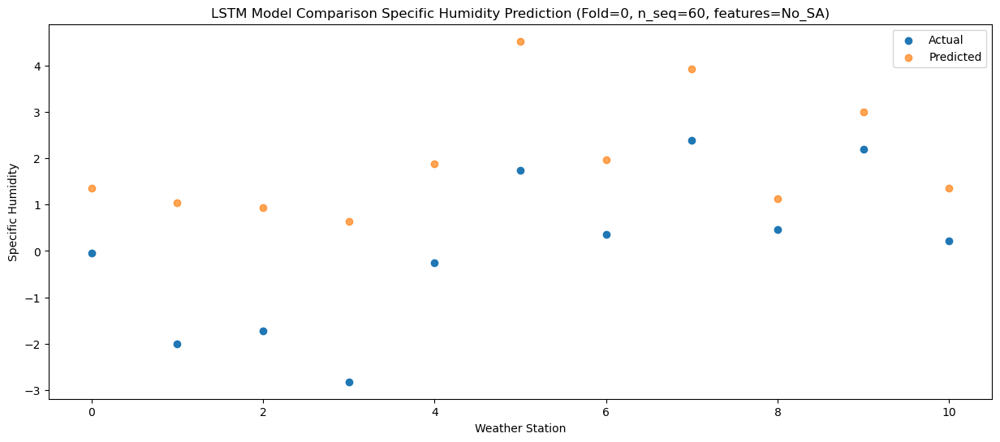

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    1.36   2.494261
1                 1   -0.10   2.184261
2                 2   -1.02   2.074261
3                 3   -1.73   1.774261
4                 4    1.29   3.024261
5                 5    3.07   5.664261
6                 6    1.36   3.114261
7                 7    3.38   5.064261
8                 8    2.14   2.264261
9                 9    3.48   4.134261
10               10    1.46   2.494261


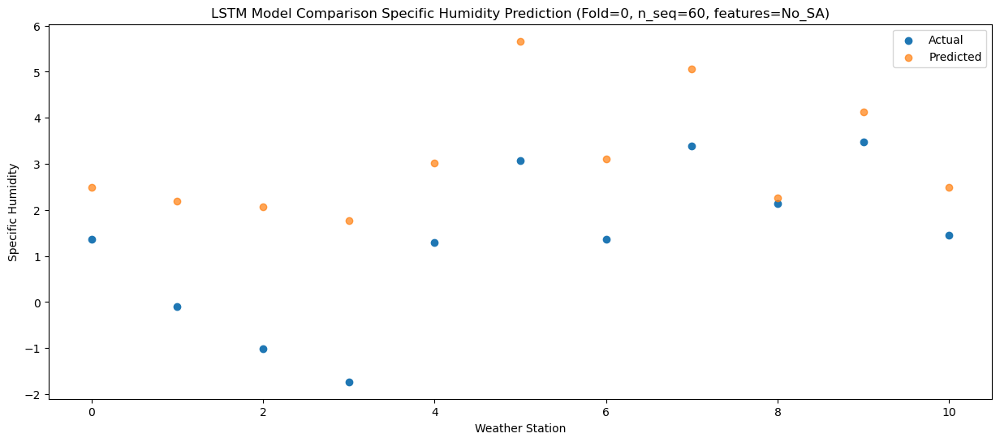

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    3.83   4.622174
1                 1    1.20   4.312174
2                 2    0.43   4.202174
3                 3    1.19   3.902174
4                 4    5.21   5.152174
5                 5    4.20   7.792174
6                 6    2.36   5.242174
7                 7    4.28   7.192174
8                 8    3.72   4.392174
9                 9    5.10   6.262174
10               10    2.40   4.622174


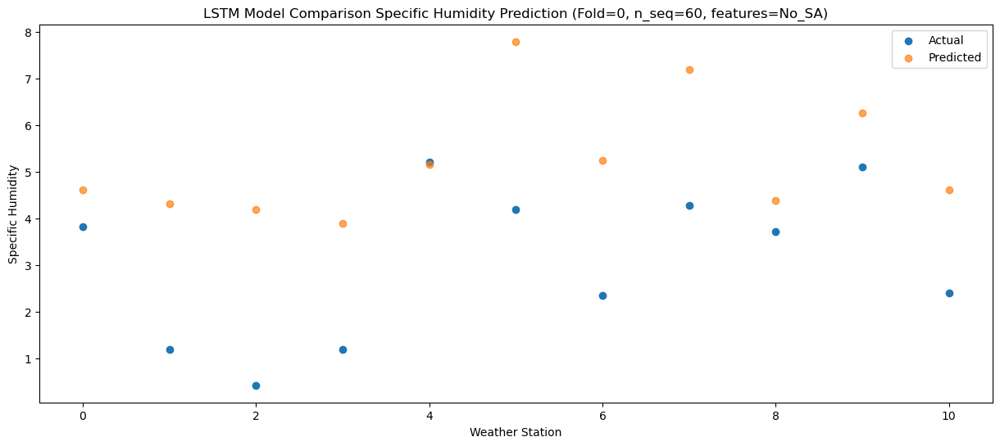

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    8.60   7.864173
1                 1    5.44   7.554173
2                 2    4.57   7.444173
3                 3    5.43   7.144173
4                 4    8.91   8.394173
5                 5    8.98  11.034173
6                 6    6.72   8.484173
7                 7    8.57  10.434173
8                 8    7.91   7.634173
9                 9    9.71   9.504173
10               10    6.12   7.864173


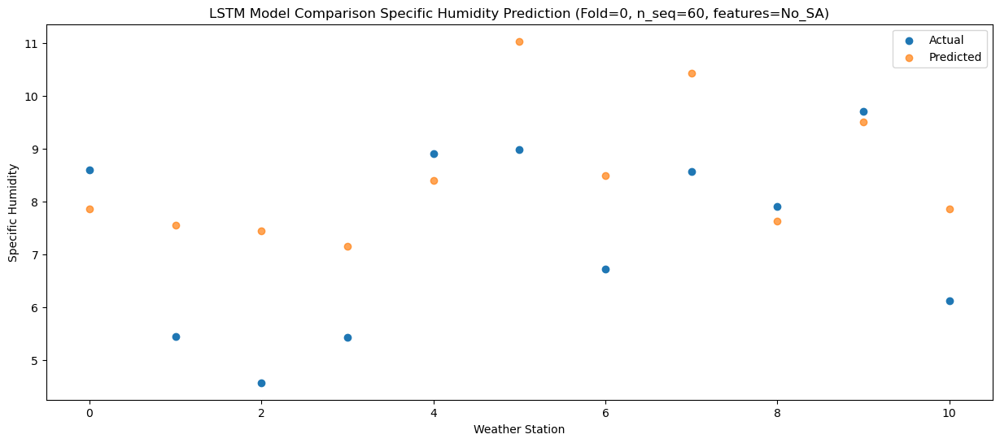

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   11.52  10.260712
1                 1    8.05   9.950712
2                 2    7.35   9.840712
3                 3    7.44   9.540712
4                 4    9.88  10.790712
5                 5   10.07  13.430712
6                 6    8.60  10.880712
7                 7   10.02  12.830712
8                 8   10.09  10.030712
9                 9   11.39  11.900712
10               10    7.39  10.260712


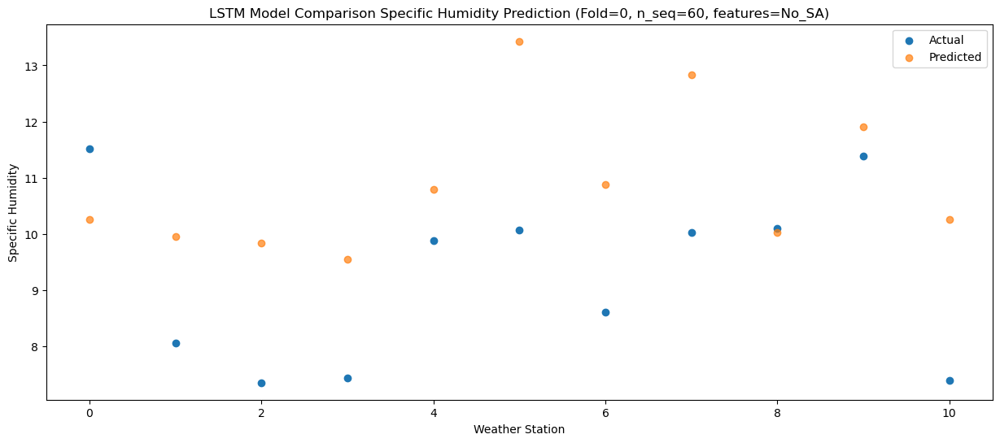

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   13.10   11.63247
1                 1    8.95   11.32247
2                 2    9.55   11.21247
3                 3    8.65   10.91247
4                 4    9.64   12.16247
5                 5   14.40   14.80247
6                 6   12.22   12.25247
7                 7   13.39   14.20247
8                 8   13.75   11.40247
9                 9   14.97   13.27247
10               10    9.88   11.63247


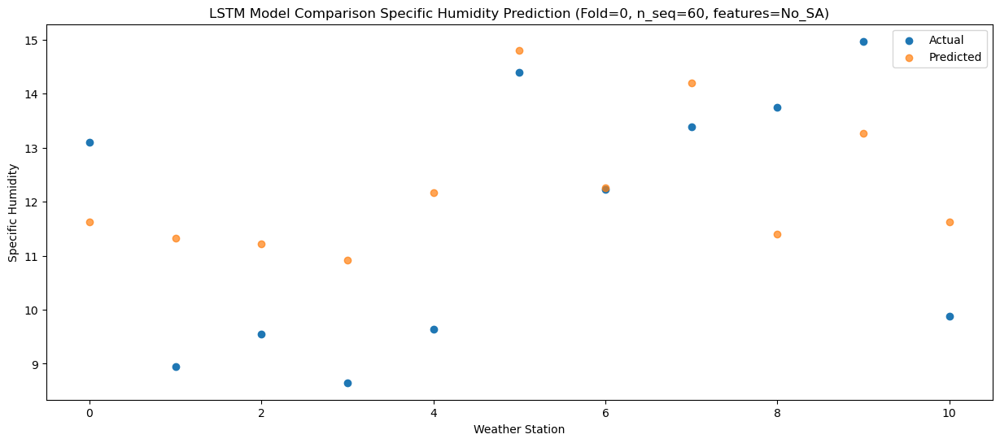

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   12.68  11.576502
1                 1    8.38  11.266502
2                 2    8.85  11.156502
3                 3    7.93  10.856502
4                 4   10.73  12.106502
5                 5   12.61  14.746502
6                 6   10.87  12.196502
7                 7   12.32  14.146502
8                 8   12.78  11.346502
9                 9   13.43  13.216502
10               10   10.87  11.576502


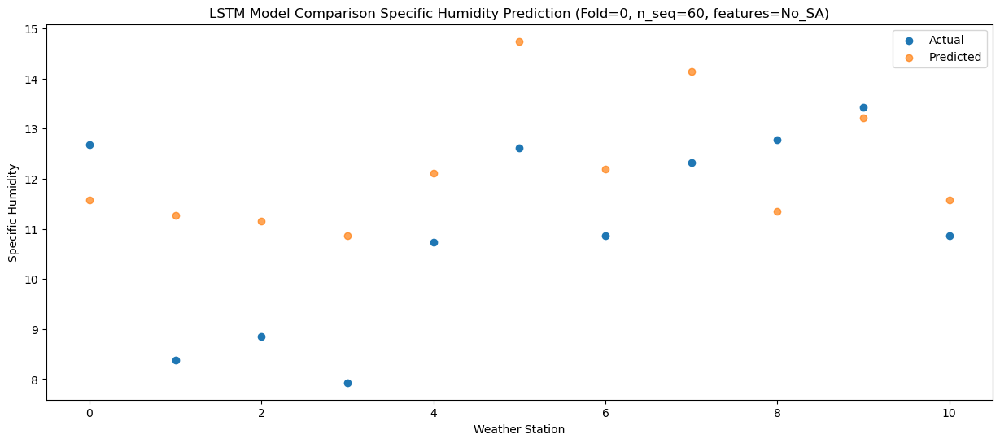

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    8.13   8.636886
1                 1    5.32   8.326886
2                 2    5.12   8.216886
3                 3    4.55   7.916886
4                 4    7.90   9.166886
5                 5    9.91  11.806886
6                 6    7.43   9.256886
7                 7    9.53  11.206886
8                 8    8.33   8.406886
9                 9   10.37  10.276886
10               10    8.27   8.636886


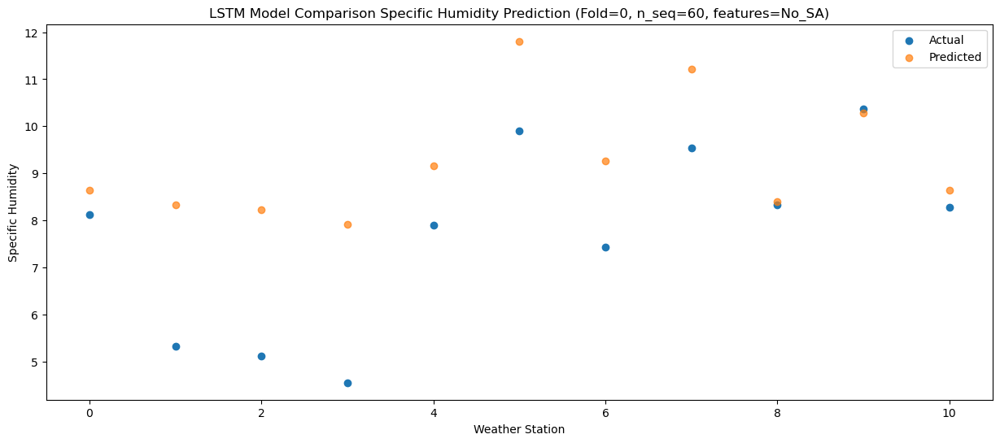

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    2.85   5.046465
1                 1    0.18   4.736465
2                 2    0.12   4.626465
3                 3   -0.55   4.326465
4                 4    3.10   5.576465
5                 5    5.27   8.216465
6                 6    2.87   5.666465
7                 7    5.11   7.616465
8                 8    3.10   4.816465
9                 9    4.58   6.686465
10               10    3.25   5.046465


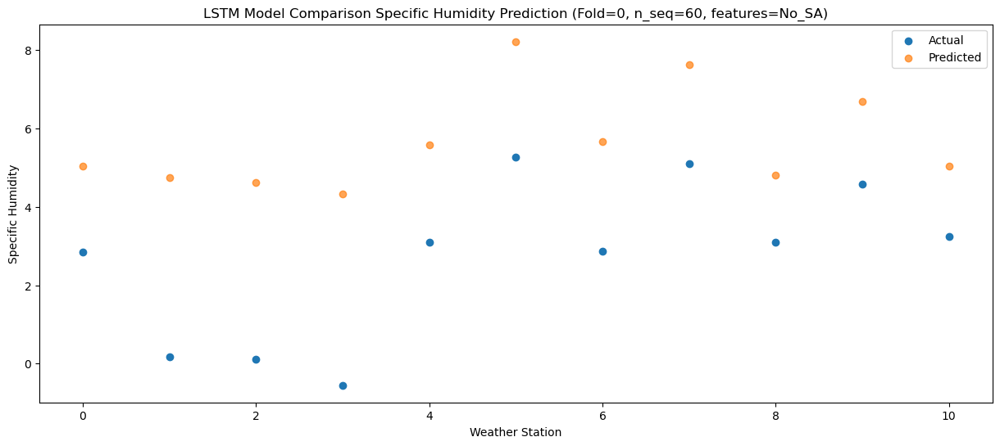

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    2.31   4.522281
1                 1   -0.02   4.212281
2                 2   -0.20   4.102281
3                 3   -1.07   3.802281
4                 4    3.09   5.052281
5                 5    4.61   7.692281
6                 6    2.27   5.142281
7                 7    4.41   7.092281
8                 8    2.10   4.292281
9                 9    3.86   6.162281
10               10    2.11   4.522281


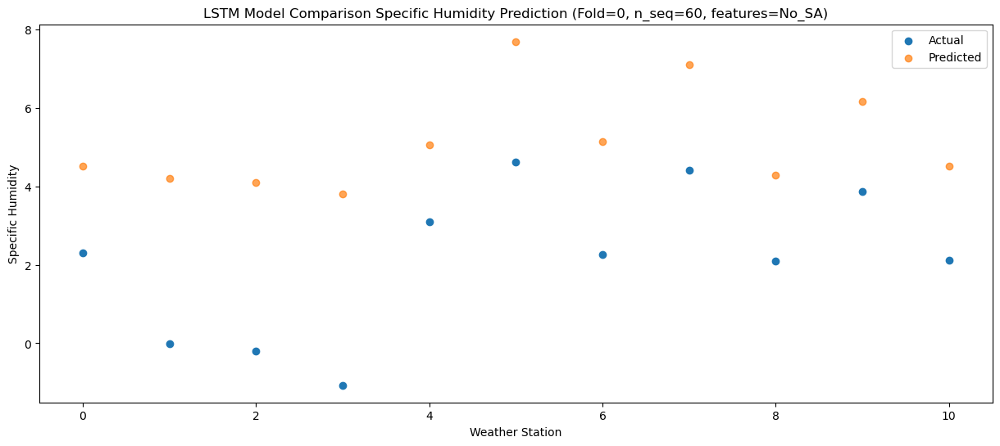

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0    1.85   3.970496
1                 1   -1.22   3.660496
2                 2   -1.53   3.550496
3                 3   -1.57   3.250496
4                 4    2.01   4.500496
5                 5    1.26   7.140496
6                 6    0.09   4.590496
7                 7    2.07   6.540496
8                 8    1.17   3.740496
9                 9    2.93   5.610496
10               10    0.94   3.970496


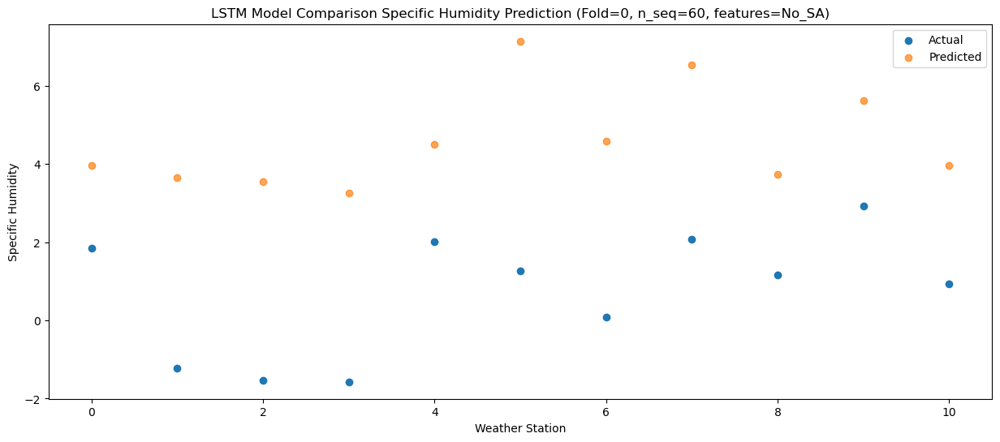

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    1.45   3.695657
1                 1   -1.13   3.385657
2                 2   -1.16   3.275657
3                 3   -1.38   2.975657
4                 4    1.25   4.225657
5                 5    2.01   6.865657
6                 6    0.95   4.315657
7                 7    3.00   6.265657
8                 8    1.77   3.465657
9                 9    3.54   5.335657
10               10    1.34   3.695657


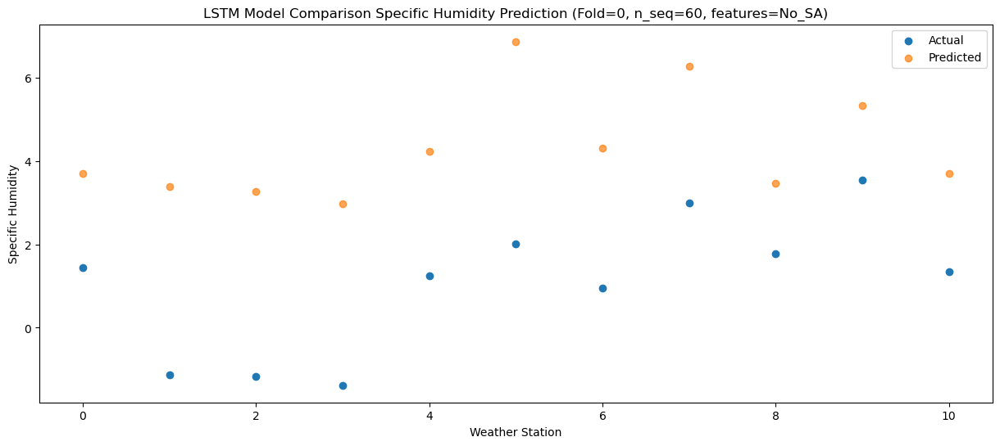

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    2.07   4.453274
1                 1    0.56   4.143274
2                 2   -0.05   4.033274
3                 3   -0.71   3.733274
4                 4    1.59   4.983274
5                 5    2.94   7.623274
6                 6    1.63   5.073274
7                 7    3.36   7.023274
8                 8    1.84   4.223274
9                 9    3.31   6.093274
10               10    0.78   4.453274


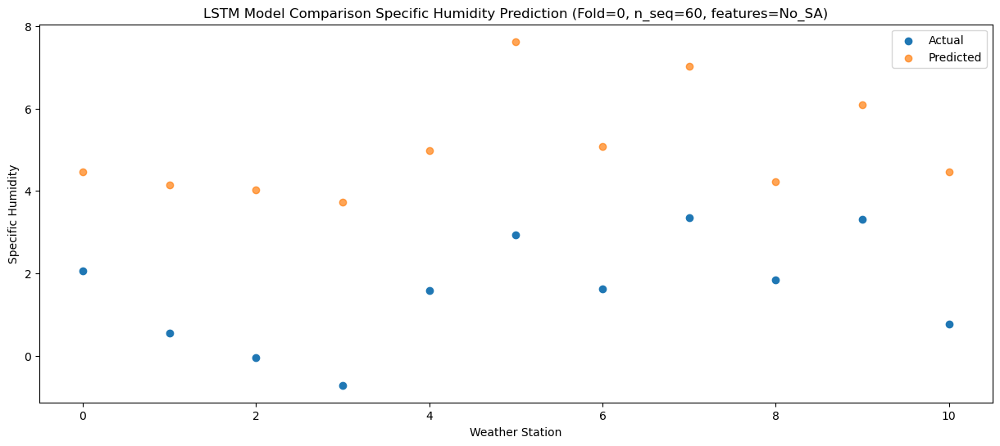

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    2.67    5.76404
1                 1    0.94    5.45404
2                 2   -0.69    5.34404
3                 3    0.37    5.04404
4                 4    3.78    6.29404
5                 5    2.72    8.93404
6                 6    1.22    6.38404
7                 7    3.28    8.33404
8                 8    2.28    5.53404
9                 9    3.41    7.40404
10               10    1.24    5.76404


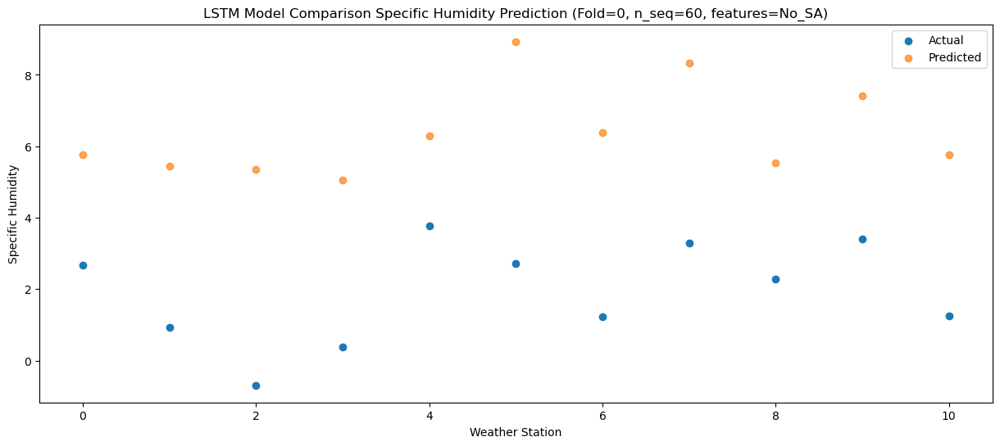

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    3.66   6.272112
1                 1    1.73   5.962112
2                 2    0.75   5.852112
3                 3    0.77   5.552112
4                 4    4.54   6.802112
5                 5    5.40   9.442112
6                 6    3.43   6.892112
7                 7    5.56   8.842112
8                 8    3.50   6.042112
9                 9    5.14   7.912112
10               10    2.88   6.272112


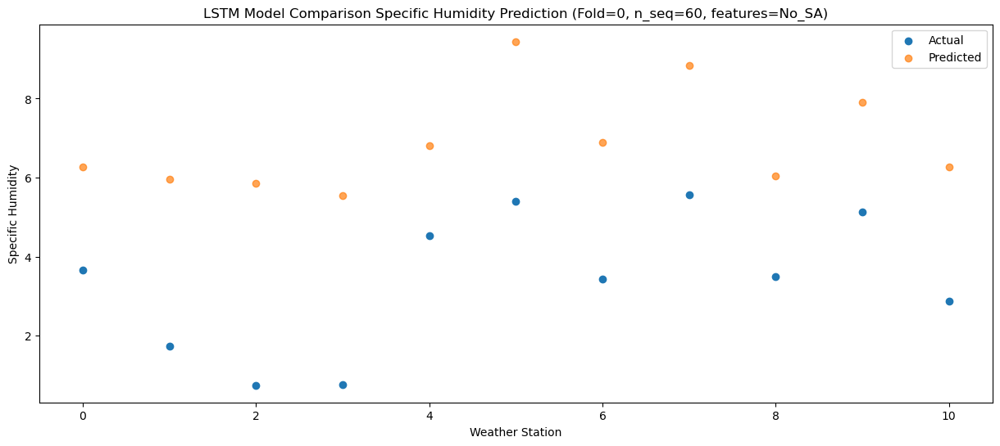

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    7.34   9.744846
1                 1    3.92   9.434846
2                 2    3.53   9.324846
3                 3    3.62   9.024846
4                 4    8.48  10.274846
5                 5    6.16  12.914846
6                 6    5.02  10.364846
7                 7    6.88  12.314846
8                 8    6.99   9.514846
9                 9    7.58  11.384846
10               10    4.09   9.744846


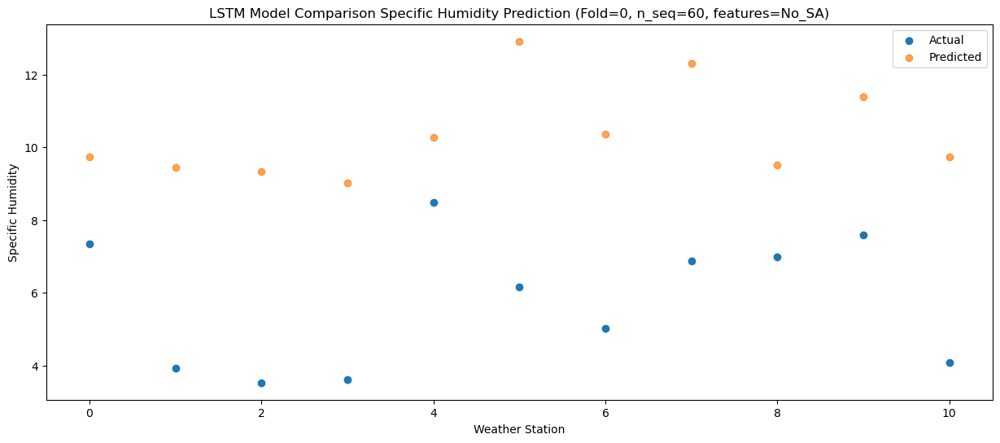

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   11.13   11.30757
1                 1    7.25   10.99757
2                 2    6.11   10.88757
3                 3    7.77   10.58757
4                 4   12.60   11.83757
5                 5   10.06   14.47757
6                 6    7.75   11.92757
7                 7    9.50   13.87757
8                 8    9.27   11.07757
9                 9   10.20   12.94757
10               10    7.10   11.30757


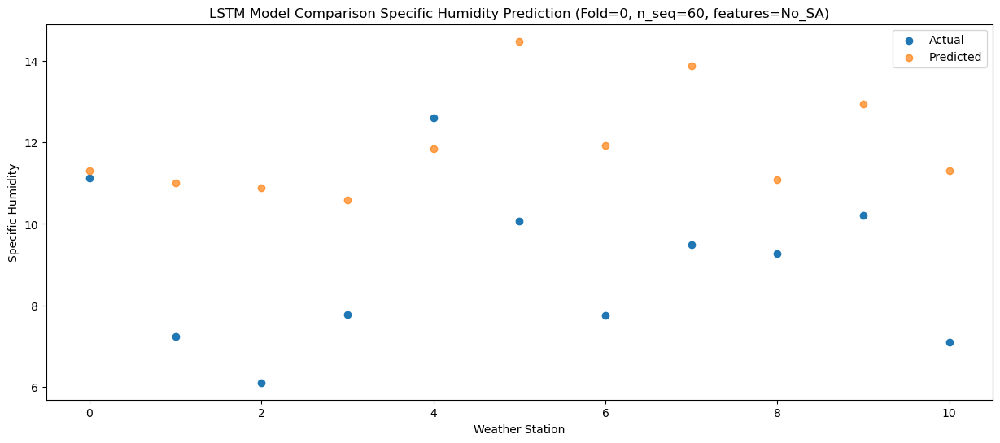

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   13.42  13.370444
1                 1    8.92  13.060444
2                 2    8.97  12.950444
3                 3    8.80  12.650444
4                 4   11.18  13.900444
5                 5   14.41  16.540444
6                 6   11.49  13.990444
7                 7   13.85  15.940444
8                 8   12.82  13.140444
9                 9   14.02  15.010444
10               10   10.93  13.370444


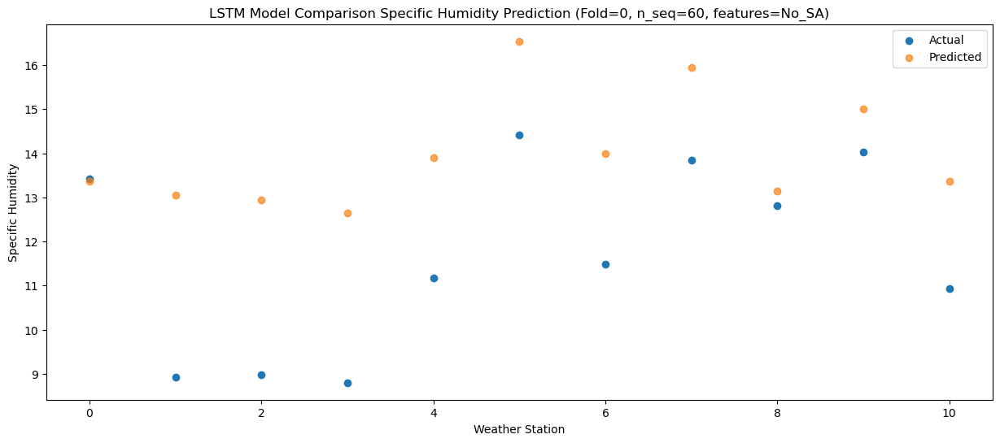

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   13.04  13.662396
1                 1    9.70  13.352396
2                 2    9.06  13.242396
3                 3    8.55  12.942396
4                 4    9.36  14.192396
5                 5   13.52  16.832396
6                 6   11.12  14.282396
7                 7   12.79  16.232396
8                 8   12.82  13.432396
9                 9   12.72  15.302396
10               10   10.18  13.662396


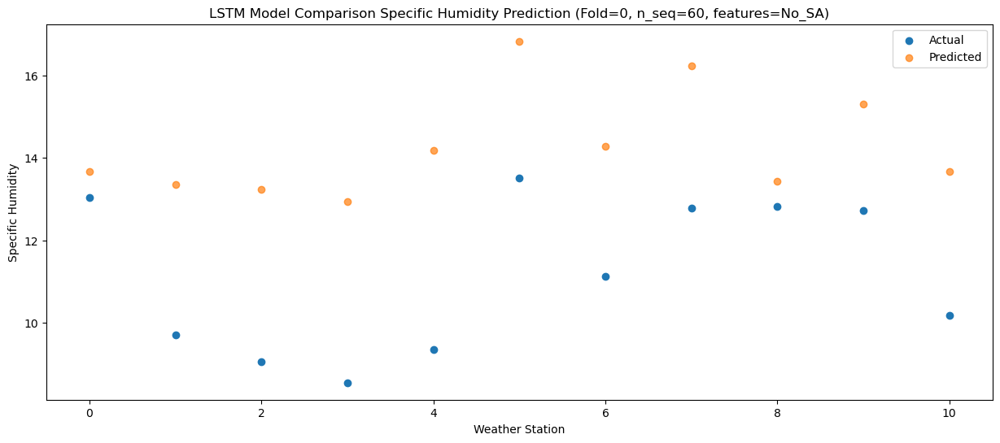

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    9.07  10.842743
1                 1    5.68  10.532743
2                 2    5.48  10.422743
3                 3    6.37  10.122743
4                 4    9.32  11.372743
5                 5   10.40  14.012743
6                 6    8.18  11.462743
7                 7    9.99  13.412743
8                 8    8.75  10.612743
9                 9   10.00  12.482743
10               10    8.87  10.842743


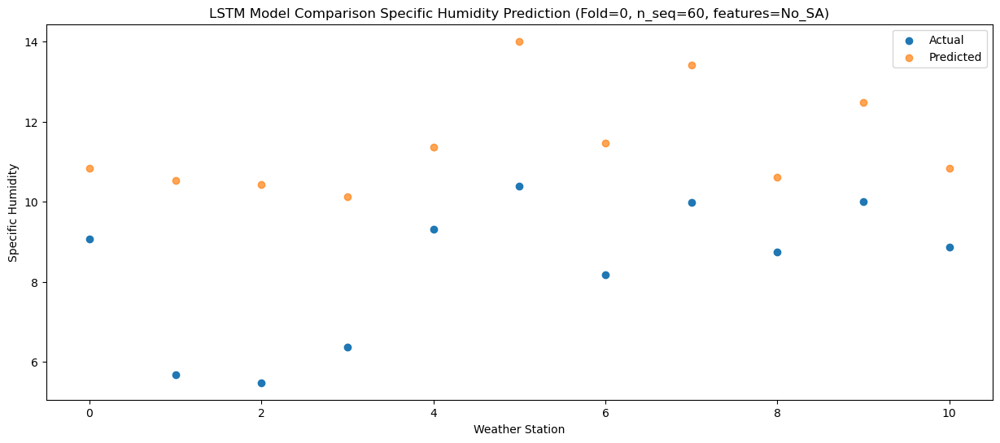

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    5.04   7.144339
1                 1    0.98   6.834339
2                 2    1.57   6.724339
3                 3    1.80   6.424339
4                 4    5.57   7.674339
5                 5    6.00  10.314339
6                 6    3.92   7.764339
7                 7    6.24   9.714339
8                 8    4.69   6.914339
9                 9    6.76   8.784339
10               10    5.11   7.144339


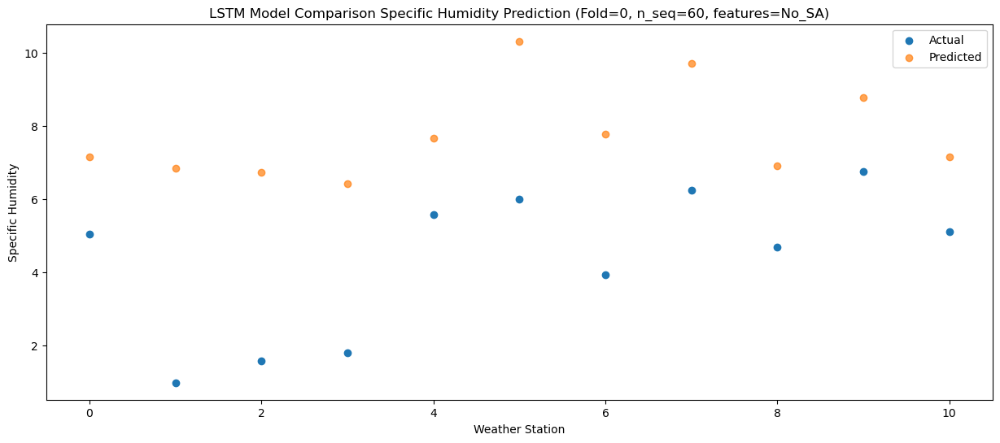

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    1.86   5.011883
1                 1   -1.20   4.701883
2                 2   -0.96   4.591883
3                 3   -1.19   4.291883
4                 4    2.77   5.541883
5                 5    2.98   8.181883
6                 6    0.59   5.631883
7                 7    2.72   7.581883
8                 8    2.03   4.781883
9                 9    3.41   6.651883
10               10    1.70   5.011883


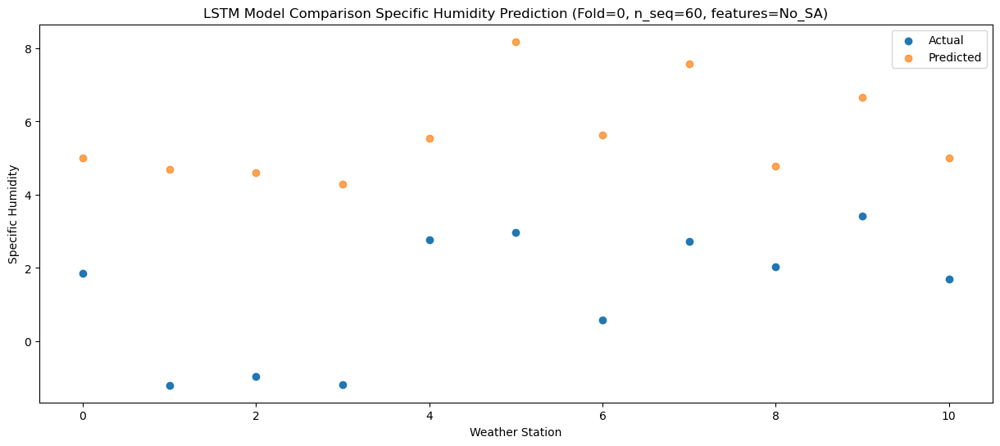

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0    0.58   3.777222
1                 1   -2.64   3.467222
2                 2   -1.77   3.357222
3                 3   -2.59   3.057222
4                 4    0.91   4.307222
5                 5    2.16   6.947222
6                 6    0.52   4.397222
7                 7    2.92   6.347222
8                 8    1.42   3.547222
9                 9    3.60   5.417222
10               10    2.23   3.777222


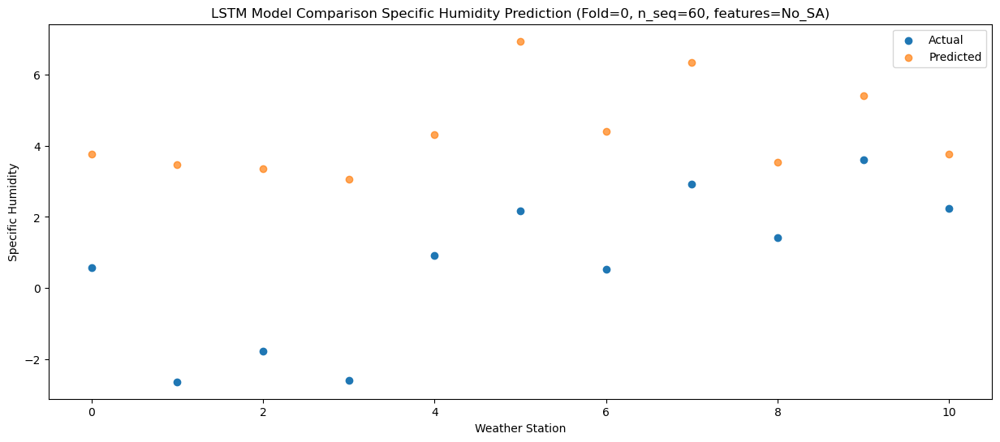

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -0.24   2.429503
1                 1   -3.42   2.119503
2                 2   -2.57   2.009503
3                 3   -3.51   1.709503
4                 4   -0.27   2.959503
5                 5    1.37   5.599503
6                 6   -0.15   3.049503
7                 7    2.23   4.999503
8                 8    0.24   2.199503
9                 9    2.63   4.069503
10               10    0.71   2.429503


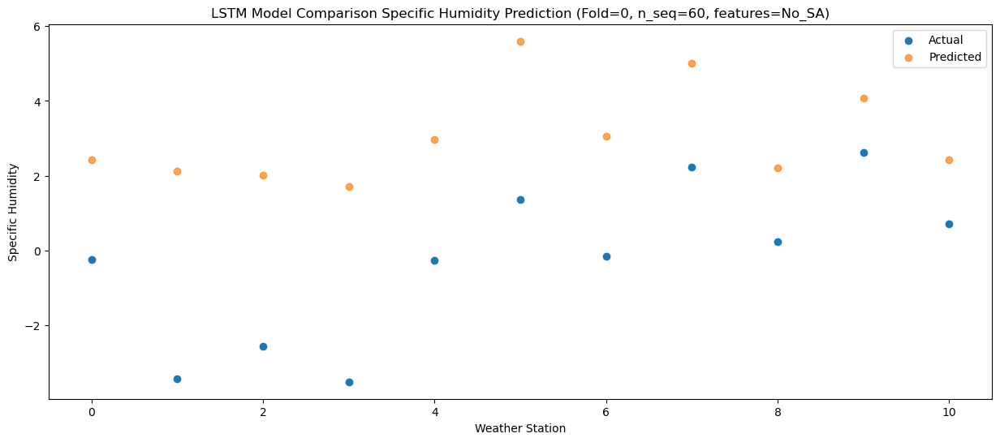

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    1.66    4.19973
1                 1   -2.20    3.88973
2                 2   -1.93    3.77973
3                 3   -1.73    3.47973
4                 4    2.30    4.72973
5                 5    1.27    7.36973
6                 6    0.01    4.81973
7                 7    2.26    6.76973
8                 8    2.00    3.96973
9                 9    2.98    5.83973
10               10    1.24    4.19973


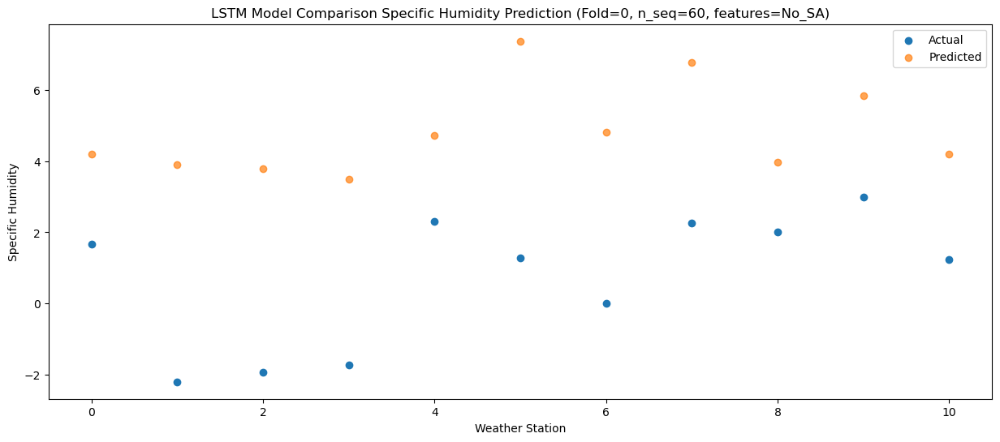

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    2.92   5.709745
1                 1   -0.35   5.399745
2                 2   -0.30   5.289745
3                 3    0.06   4.989745
4                 4    4.04   6.239745
5                 5    3.19   8.879745
6                 6    1.46   6.329745
7                 7    3.40   8.279745
8                 8    2.87   5.479745
9                 9    4.11   7.349745
10               10    1.93   5.709745


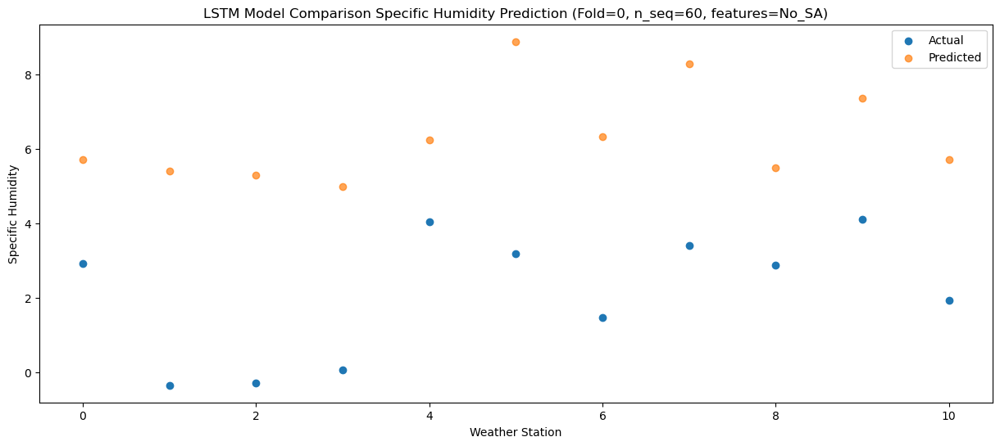

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    5.23   7.542088
1                 1    1.56   7.232088
2                 2    1.44   7.122088
3                 3    2.11   6.822088
4                 4    6.28   8.072088
5                 5    4.53  10.712088
6                 6    3.52   8.162088
7                 7    5.42  10.112088
8                 8    5.10   7.312088
9                 9    6.48   9.182088
10               10    3.49   7.542088


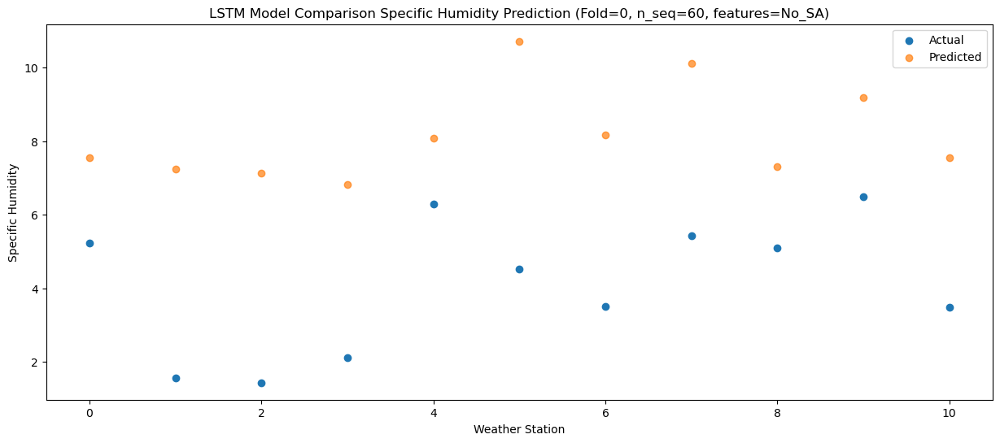

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    9.70  10.037648
1                 1    6.14   9.727648
2                 2    5.19   9.617648
3                 3    6.68   9.317648
4                 4   10.53  10.567648
5                 5    8.59  13.207648
6                 6    7.43  10.657648
7                 7    9.24  12.607648
8                 8    9.38   9.807648
9                 9   10.28  11.677648
10               10    6.54  10.037648


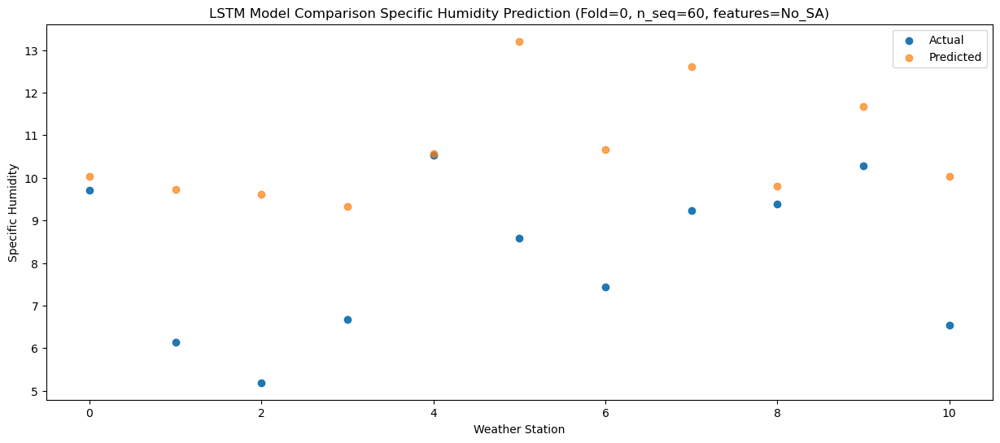

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   11.09  12.078231
1                 1    7.74  11.768231
2                 2    6.32  11.658231
3                 3    8.19  11.358231
4                 4   12.18  12.608231
5                 5   10.56  15.248231
6                 6    9.25  12.698231
7                 7   10.93  14.648231
8                 8   11.80  11.848231
9                 9   11.35  13.718231
10               10    9.04  12.078231


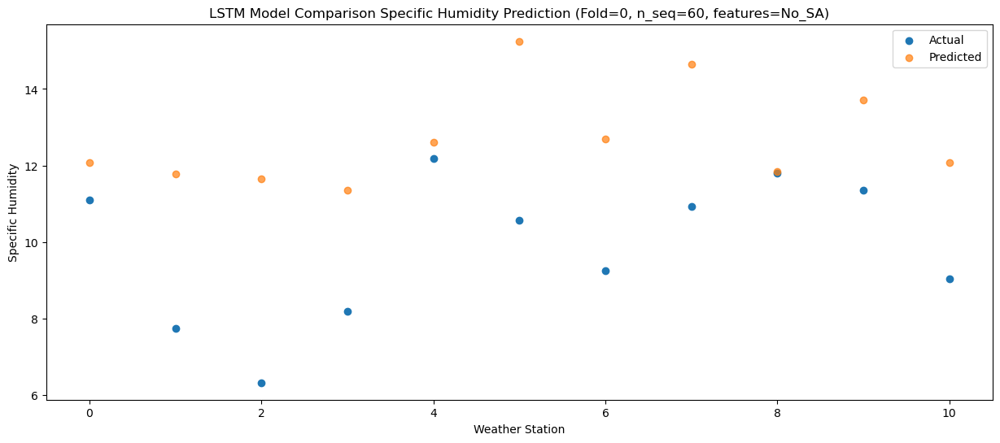

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   12.38  13.596382
1                 1    9.91  13.286382
2                 2    9.55  13.176382
3                 3    9.59  12.876382
4                 4   11.92  14.126382
5                 5   13.35  16.766382
6                 6   11.78  14.216382
7                 7   13.82  16.166382
8                 8   12.98  13.366382
9                 9   12.85  15.236382
10               10   10.11  13.596382


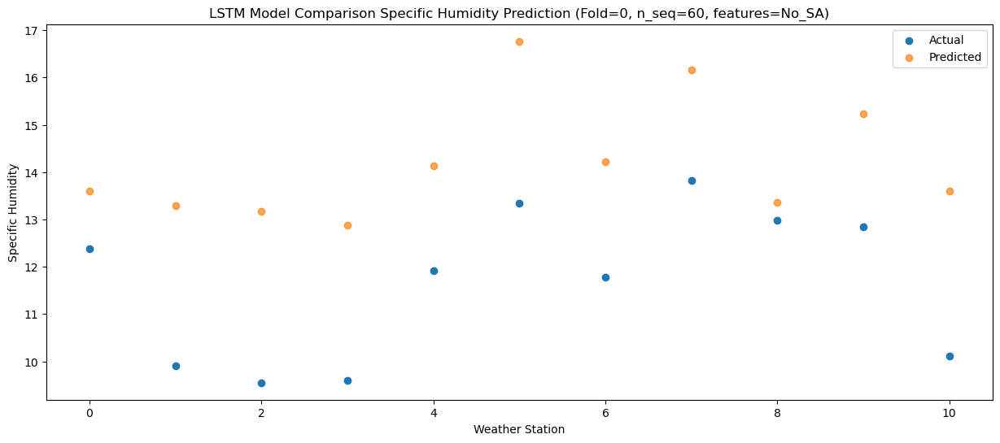

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   10.55  12.710634
1                 1    8.41  12.400634
2                 2    7.86  12.290634
3                 3    8.45  11.990634
4                 4   11.57  13.240634
5                 5   12.34  15.880634
6                 6   10.62  13.330634
7                 7   12.39  15.280634
8                 8   11.31  12.480634
9                 9   12.05  14.350634
10               10    9.87  12.710634


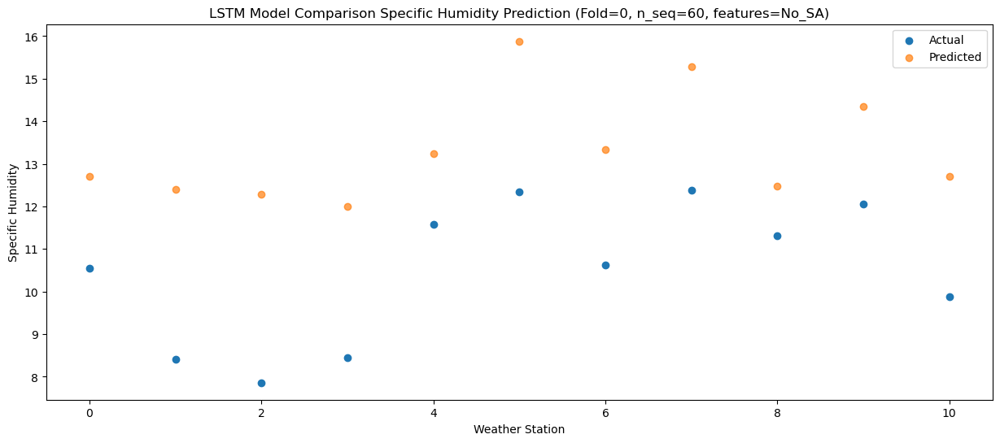

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    9.08  11.142213
1                 1    7.54  10.832213
2                 2    6.17  10.722213
3                 3    6.89  10.422213
4                 4    9.08  11.672213
5                 5   10.39  14.312213
6                 6    8.89  11.762213
7                 7   10.80  13.712213
8                 8    9.27  10.912213
9                 9    9.70  12.782213
10               10    8.16  11.142213


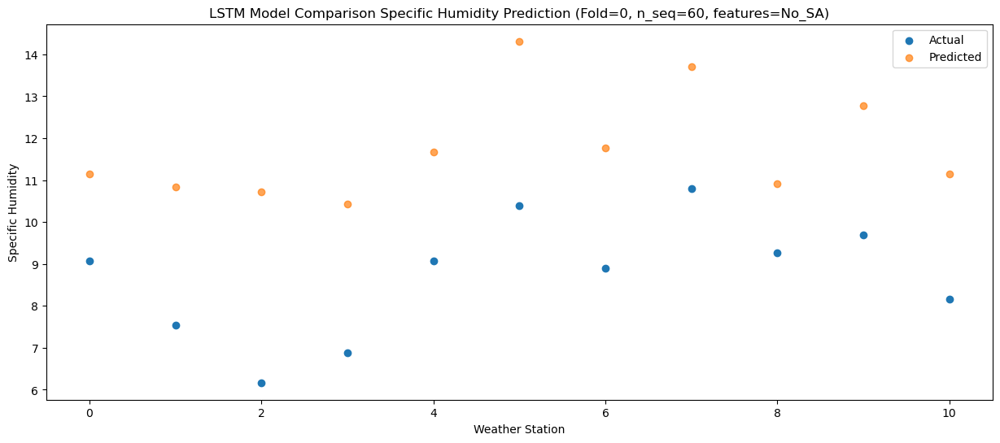

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    3.70   7.631589
1                 1    2.14   7.321589
2                 2    2.04   7.211589
3                 3    1.70   6.911589
4                 4    5.47   8.161589
5                 5    5.10  10.801589
6                 6    4.19   8.251589
7                 7    5.91  10.201589
8                 8    4.67   7.401589
9                 9    6.17   9.271589
10               10    3.96   7.631589


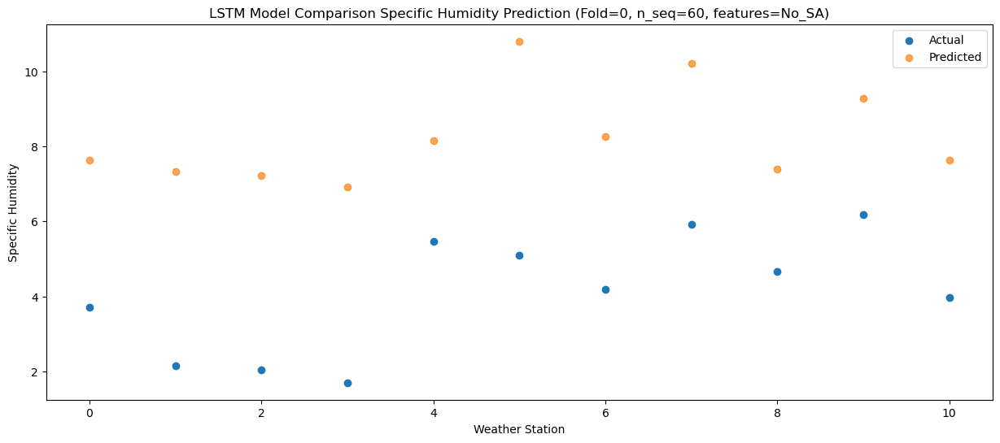

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (1, 1, 256)               2121728   
                                                                 
 dropout (Dropout)           (1, 1, 256)               0         
                                                                 
 lstm_1 (LSTM)               (1, 256)                  525312    
                                                                 
 dropout_1 (Dropout)         (1, 256)                  0         
                                                                 
 dense (Dense)               (1, 256)                  65792     
                                                                 
 dense_1 (Dense)             (1, 128)                  32896     
                                                                 
 dense_2 (Dense)             (1, 60)                   7

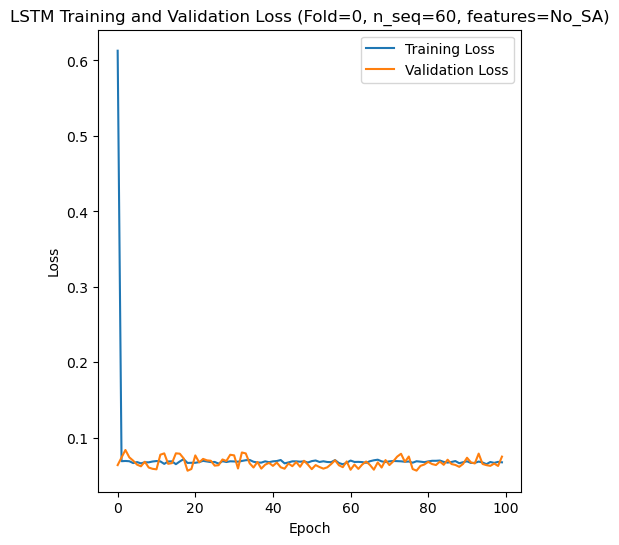

Epoch 1/100
84/84 [==============================] - 21s 34ms/step - loss: 0.6202 - accuracy: 0.3452 - mae: 0.5559 - rmse: 0.6202 - mape: 123.7718 - pearson: 0.5429 - val_loss: 0.0599 - val_accuracy: 0.5000 - val_mae: 0.0458 - val_rmse: 0.0599 - val_mape: 10.5155 - val_pearson: 0.7961
Epoch 2/100
84/84 [==============================] - 1s 12ms/step - loss: 0.0725 - accuracy: 0.4524 - mae: 0.0573 - rmse: 0.0725 - mape: 12.9256 - pearson: 0.7575 - val_loss: 0.0641 - val_accuracy: 0.5000 - val_mae: 0.0502 - val_rmse: 0.0641 - val_mape: 11.4519 - val_pearson: 0.7587
Epoch 3/100
84/84 [==============================] - 1s 11ms/step - loss: 0.0680 - accuracy: 0.5357 - mae: 0.0539 - rmse: 0.0680 - mape: 12.3092 - pearson: 0.7684 - val_loss: 0.0677 - val_accuracy: 0.5000 - val_mae: 0.0551 - val_rmse: 0.0677 - val_mape: 12.2140 - val_pearson: 0.7660
Epoch 4/100
84/84 [==============================] - 1s 11ms/step - loss: 0.0684 - accuracy: 0.4405 - mae: 0.0543 - rmse: 0.0684 - mape: 12.4132 -

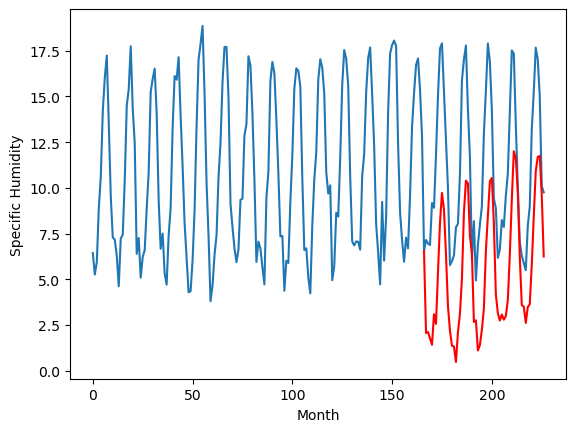

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.00		1.57		2.57
-0.95		1.62		2.57
-1.20		1.27		2.47
-0.68		0.93		1.61
1.55		2.60		1.05
-0.04		2.07		2.11
2.97		4.91		1.94
6.77		7.59		0.82
8.81		9.23		0.42
8.86		8.32		-0.54
5.96		5.88		-0.08
3.29		3.03		-0.26
0.23		1.70		1.47
-2.36		0.88		3.24
-2.34		0.83		3.17
-2.15		-0.01		2.14
-0.62		1.62		2.24
-0.26		2.63		2.89
2.66		4.53		1.87
6.64		8.16		1.52
8.51		9.91		1.40
8.72		9.76		1.04
5.77		6.88		1.11
3.73		5.94		2.21
-1.86		2.17		4.03
0.31		2.27		1.96
-2.69		0.61		3.30
-1.74		0.91		2.65
-1.06		1.74		2.80
0.00		2.91		2.91
4.17		6.05		1.88
6.57		7.96		1.39
9.24		9.87		0.63
8.83		10.05		1.22
5.47		7.58		2.11
0.58		3.69		3.11
0.10		2.66		2.56
-1.49		2.25		3.74
-1.08		2.58		3.66
0.04		2.30		2.26
-0.83		2.49		3.32
0.77		3.37		2.60
3.51		5.84		2.33
5.86		8.87		3.01
8.82		11.51		2.69
8.95		11.14		2.19
5.84		9.30		3.46
1.99		5.72		3.73
-1.02		3.10		4.12
-1.60		3.02		4.62
-2.37		2.12		4.49
-2.03		2.99

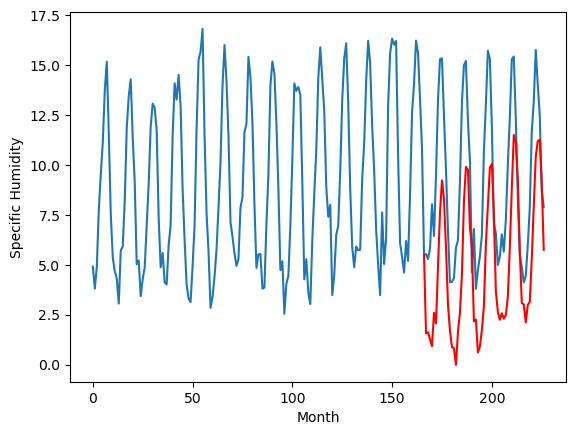

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.90		0.32		2.22
-0.99		0.37		1.36
-1.50		0.02		1.52
-1.11		-0.32		0.79
2.05		1.35		-0.70
0.43		0.82		0.39
3.20		3.66		0.46
7.05		6.34		-0.71
9.60		7.98		-1.62
9.12		7.07		-2.05
6.17		4.63		-1.54
3.41		1.78		-1.63
0.23		0.45		0.22
-2.54		-0.37		2.17
-2.39		-0.42		1.97
-2.39		-1.26		1.13
0.23		0.37		0.14
-0.06		1.38		1.44
2.78		3.28		0.50
7.30		6.91		-0.39
8.89		8.66		-0.23
9.11		8.51		-0.60
6.35		5.63		-0.72
3.60		4.69		1.09
-1.90		0.92		2.82
0.74		1.02		0.28
-3.14		-0.64		2.50
-2.11		-0.34		1.77
-1.32		0.49		1.81
0.44		1.66		1.22
4.80		4.80		0.00
7.89		6.71		-1.18
9.52		8.62		-0.90
8.65		8.80		0.15
5.14		6.33		1.19
0.03		2.44		2.41
-0.34		1.41		1.75
-1.03		1.00		2.03
-1.06		1.33		2.39
-0.01		1.05		1.06
-0.48		1.24		1.72
0.88		2.12		1.24
4.18		4.59		0.41
6.83		7.62		0.79
9.97		10.26		0.29
9.90		9.89		-0.01
6.09		8.05		1.96
1.58		4.47		2.89
-0.97		1.85		2.82
-1.99		1.77		3.76
-2.62		0.87		3.4

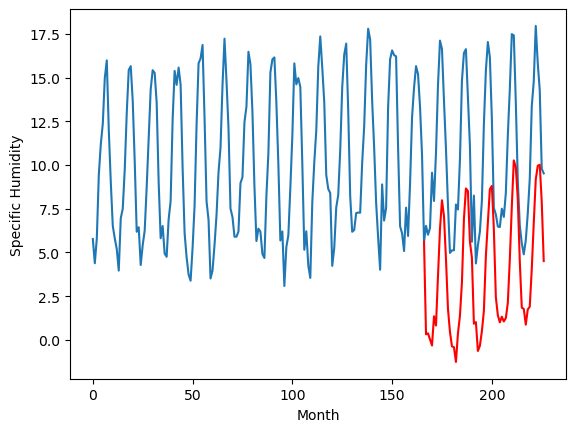

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.51		-0.38		1.13
-2.71		-0.33		2.38
-1.81		-0.68		1.13
-2.51		-1.02		1.49
1.85		0.65		-1.20
1.51		0.12		-1.39
3.49		2.96		-0.53
5.61		5.64		0.03
8.12		7.28		-0.84
7.01		6.37		-0.64
5.43		3.93		-1.50
2.03		1.08		-0.95
-0.07		-0.25		-0.18
-2.62		-1.07		1.55
-2.96		-1.12		1.84
-2.89		-1.96		0.93
-0.25		-0.33		-0.08
1.09		0.68		-0.41
4.98		2.58		-2.40
8.17		6.21		-1.96
8.65		7.96		-0.69
8.99		7.81		-1.18
5.90		4.93		-0.97
3.65		3.99		0.34
-0.80		0.22		1.02
2.12		0.32		-1.80
-3.53		-1.34		2.19
-3.36		-1.04		2.32
-1.68		-0.21		1.47
2.48		0.96		-1.52
6.29		4.10		-2.19
7.34		6.01		-1.33
8.26		7.92		-0.34
8.51		8.10		-0.41
5.22		5.63		0.41
0.26		1.74		1.48
-0.24		0.71		0.95
-1.05		0.30		1.35
-1.47		0.63		2.10
-0.69		0.35		1.04
0.86		0.54		-0.32
1.23		1.42		0.19
5.01		3.89		-1.12
8.41		6.92		-1.49
8.97		9.56		0.59
7.30		9.19		1.89
6.10		7.35		1.25
2.68		3.77		1.09
-0.65		1.15		1.80
-2.29		1.07		3.36


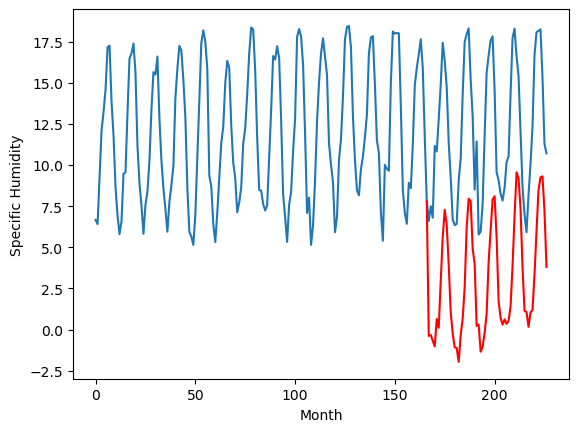

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.21		3.68		1.47
0.97		3.73		2.76
1.88		3.38		1.50
1.20		3.04		1.84
5.93		4.71		-1.22
5.62		4.18		-1.44
7.74		7.02		-0.72
10.03		9.70		-0.33
12.63		11.34		-1.29
11.18		10.43		-0.75
9.69		7.99		-1.70
5.84		5.14		-0.70
3.36		3.81		0.45
0.54		2.99		2.45
0.29		2.94		2.65
0.33		2.10		1.77
3.05		3.73		0.68
4.31		4.74		0.43
8.34		6.64		-1.70
11.75		10.27		-1.48
11.93		12.02		0.09
11.97		11.87		-0.10
8.87		8.99		0.12
6.92		8.05		1.13
2.33		4.28		1.95
5.26		4.38		-0.88
-0.28		2.72		3.00
-0.08		3.02		3.10
1.62		3.85		2.23
5.72		5.02		-0.70
9.60		8.16		-1.44
10.72		10.07		-0.65
11.47		11.98		0.51
11.85		12.16		0.31
8.50		9.69		1.19
3.60		5.80		2.20
3.22		4.77		1.55
2.40		4.36		1.96
1.92		4.69		2.77
2.52		4.41		1.89
4.22		4.60		0.38
4.67		5.48		0.81
8.34		7.95		-0.39
11.60		10.98		-0.62
11.68		13.62		1.94
10.28		13.25		2.97
9.53		11.41		1.88
6.14		7.83		1.69
2.80		5.21		2.41
1.08		5.13		4.05
-0.09		4.23	

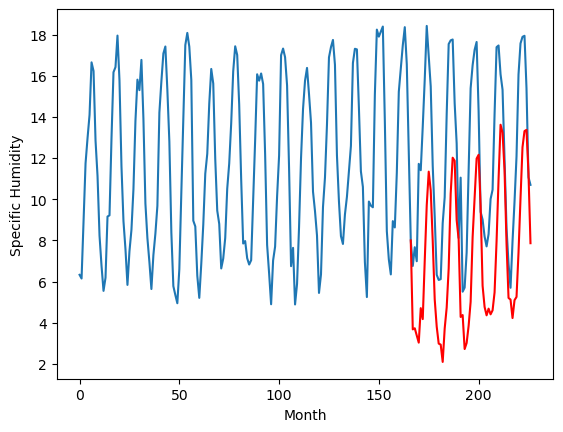

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
3.35		2.17		-1.18
1.87		2.22		0.35
1.59		1.87		0.28
1.77		1.53		-0.24
4.44		3.20		-1.24
3.43		2.67		-0.76
6.11		5.51		-0.60
7.93		8.19		0.26
8.92		9.83		0.91
7.69		8.92		1.23
7.26		6.48		-0.78
3.75		3.63		-0.12
3.19		2.30		-0.89
0.75		1.48		0.73
1.58		1.43		-0.15
0.95		0.59		-0.36
1.74		2.22		0.48
3.04		3.23		0.19
7.35		5.13		-2.22
9.52		8.76		-0.76
10.85		10.51		-0.34
11.07		10.36		-0.71
7.53		7.48		-0.05
4.42		6.54		2.12
2.58		2.77		0.19
1.53		2.87		1.34
0.26		1.21		0.95
0.14		1.51		1.37
0.69		2.34		1.65
2.96		3.51		0.55
4.73		6.65		1.92
7.33		8.56		1.23
8.28		10.47		2.19
10.39		10.65		0.26
9.12		8.18		-0.94
5.93		4.29		-1.64
3.06		3.26		0.20
2.39		2.85		0.46
0.84		3.18		2.34
0.87		2.90		2.03
1.92		3.09		1.17
2.18		3.97		1.79
6.55		6.44		-0.11
6.50		9.47		2.97
8.67		12.11		3.44
8.82		11.74		2.92
8.46		9.90		1.44
6.48		6.32		-0.16
3.85		3.70		-0.15
1.98		3.62		1.64
0.83		2.72		1.89
1.24		3.5

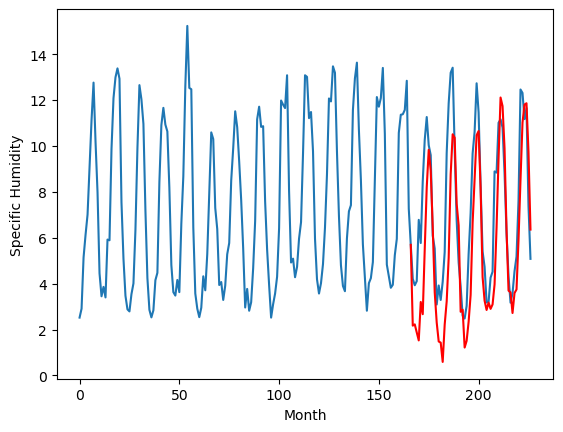

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.70		3.02		2.32
0.73		3.07		2.34
0.31		2.72		2.41
0.79		2.38		1.59
2.76		4.05		1.29
2.11		3.52		1.41
5.31		6.36		1.05
8.95		9.04		0.09
11.39		10.68		-0.71
11.41		9.77		-1.64
8.10		7.33		-0.77
5.61		4.48		-1.13
2.50		3.15		0.65
-0.22		2.33		2.55
-0.33		2.28		2.61
-0.21		1.44		1.65
1.35		3.07		1.72
1.97		4.08		2.11
4.90		5.98		1.08
9.25		9.61		0.36
11.75		11.36		-0.39
12.04		11.21		-0.83
8.69		8.33		-0.36
6.56		7.39		0.83
0.63		3.62		2.99
2.50		3.72		1.22
-0.50		2.06		2.56
0.63		2.36		1.73
1.38		3.19		1.81
2.57		4.36		1.79
6.83		7.50		0.67
9.55		9.41		-0.14
12.54		11.32		-1.22
11.45		11.50		0.05
7.97		9.03		1.06
2.91		5.14		2.23
2.42		4.11		1.69
0.52		3.70		3.18
0.88		4.03		3.15
2.08		3.75		1.67
1.32		3.94		2.62
3.13		4.82		1.69
5.69		7.29		1.60
8.27		10.32		2.05
11.89		12.96		1.07
11.78		12.59		0.81
8.81		10.75		1.94
4.56		7.17		2.61
1.21		4.55		3.34
0.71		4.47		3.76
-0.11		3.57		3.68
0.37		4

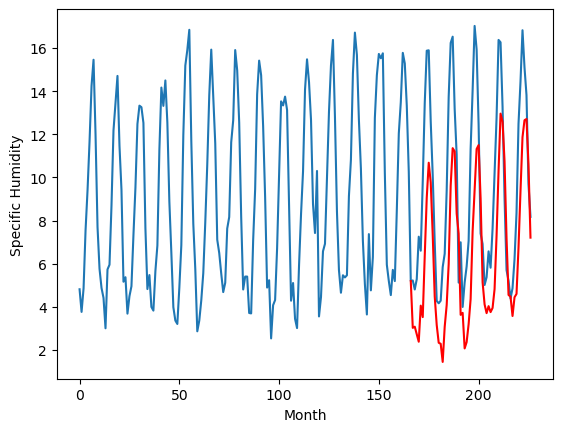

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
3.11		3.91		0.80
2.78		3.96		1.18
2.70		3.61		0.91
2.58		3.27		0.69
5.24		4.94		-0.30
5.50		4.41		-1.09
8.40		7.25		-1.15
12.23		9.93		-2.30
15.31		11.57		-3.74
13.14		10.66		-2.48
11.34		8.22		-3.12
6.52		5.37		-1.15
4.50		4.04		-0.46
2.18		3.22		1.04
2.05		3.17		1.12
1.53		2.33		0.80
4.26		3.96		-0.30
5.49		4.97		-0.52
8.70		6.87		-1.83
13.46		10.50		-2.96
14.09		12.25		-1.84
13.94		12.10		-1.84
10.69		9.22		-1.47
7.96		8.28		0.32
3.40		4.51		1.11
5.04		4.61		-0.43
1.29		2.95		1.66
1.97		3.25		1.28
3.50		4.08		0.58
5.69		5.25		-0.44
10.14		8.39		-1.75
12.90		10.30		-2.60
13.87		12.21		-1.66
13.78		12.39		-1.39
9.82		9.92		0.10
5.28		6.03		0.75
4.03		5.00		0.97
3.12		4.59		1.47
3.24		4.92		1.68
3.34		4.64		1.30
4.10		4.83		0.73
5.30		5.71		0.41
9.34		8.18		-1.16
12.26		11.21		-1.05
14.83		13.85		-0.98
14.41		13.48		-0.93
9.92		11.64		1.72
6.67		8.06		1.39
3.96		5.44		1.48
2.57		5.36		2.79
1.

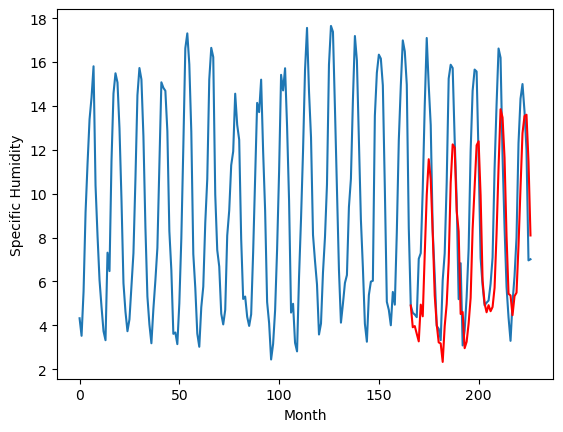

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
4.03		3.58		-0.45
3.19		3.63		0.44
3.64		3.28		-0.36
3.02		2.94		-0.08
6.04		4.61		-1.43
6.23		4.08		-2.15
9.56		6.92		-2.64
11.70		9.60		-2.10
15.06		11.24		-3.82
12.16		10.33		-1.83
10.68		7.89		-2.79
6.01		5.04		-0.97
4.90		3.71		-1.19
2.62		2.89		0.27
2.78		2.84		0.06
1.97		2.00		0.03
4.58		3.63		-0.95
5.74		4.64		-1.10
9.96		6.54		-3.42
13.10		10.17		-2.93
14.15		11.92		-2.23
13.73		11.77		-1.96
10.16		8.89		-1.27
7.72		7.95		0.23
4.19		4.18		-0.01
3.58		4.28		0.70
1.60		2.62		1.02
2.13		2.92		0.79
3.22		3.75		0.53
6.34		4.92		-1.42
10.58		8.06		-2.52
12.48		9.97		-2.51
11.84		11.88		0.04
12.58		12.06		-0.52
9.84		9.59		-0.25
5.89		5.70		-0.19
4.91		4.67		-0.24
3.17		4.26		1.09
2.69		4.59		1.90
3.02		4.31		1.29
4.44		4.50		0.06
5.66		5.38		-0.28
10.71		7.85		-2.86
13.29		10.88		-2.41
13.52		13.52		0.00
11.69		13.15		1.46
10.74		11.31		0.57
7.31		7.73		0.42
4.64		5.11		0.47
3.59		5.03		1.

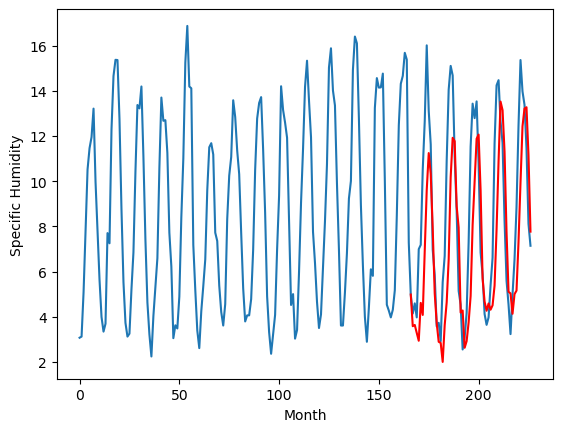

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.80		-0.23		-1.03
0.15		-0.18		-0.33
-0.00		-0.53		-0.53
0.01		-0.87		-0.88
1.90		0.80		-1.10
2.06		0.27		-1.79
4.88		3.11		-1.77
6.59		5.79		-0.80
9.48		7.43		-2.05
8.16		6.52		-1.64
5.37		4.08		-1.29
1.85		1.23		-0.62
1.53		-0.10		-1.63
-0.33		-0.92		-0.59
-0.14		-0.97		-0.83
-0.88		-1.81		-0.93
0.94		-0.18		-1.12
1.11		0.83		-0.28
6.26		2.73		-3.53
9.25		6.36		-2.89
10.49		8.11		-2.38
9.46		7.96		-1.50
6.50		5.08		-1.42
3.06		4.14		1.08
0.70		0.37		-0.33
-0.28		0.47		0.75
-0.92		-1.19		-0.27
-1.00		-0.89		0.11
-0.04		-0.06		-0.02
0.93		1.11		0.18
3.49		4.25		0.76
7.67		6.16		-1.51
8.32		8.07		-0.25
8.73		8.25		-0.48
6.73		5.78		-0.95
3.34		1.89		-1.45
1.36		0.86		-0.50
0.15		0.45		0.30
-0.16		0.78		0.94
-0.30		0.50		0.80
0.49		0.69		0.20
1.01		1.57		0.56
6.74		4.04		-2.70
8.35		7.07		-1.28
10.28		9.71		-0.57
8.37		9.34		0.97
6.72		7.50		0.78
3.61		3.92		0.31
1.29		1.30		0.01
0.85		1.22		

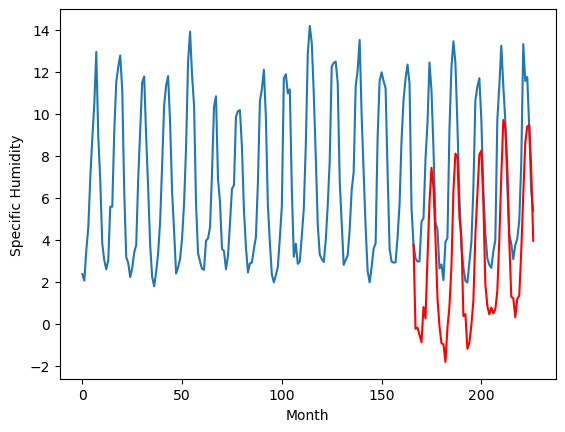

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.62		2.06		1.44
0.61		2.11		1.50
0.46		1.76		1.30
0.53		1.42		0.89
1.48		3.09		1.61
1.77		2.56		0.79
4.34		5.40		1.06
7.98		8.08		0.10
11.62		9.72		-1.90
11.53		8.81		-2.72
8.05		6.37		-1.68
5.13		3.52		-1.61
2.75		2.19		-0.56
0.59		1.37		0.78
-0.14		1.32		1.46
-0.10		0.48		0.58
1.14		2.11		0.97
2.51		3.12		0.61
4.04		5.02		0.98
9.36		8.65		-0.71
11.22		10.40		-0.82
11.56		10.25		-1.31
8.37		7.37		-1.00
6.51		6.43		-0.08
1.32		2.66		1.34
1.20		2.76		1.56
-0.41		1.10		1.51
0.33		1.40		1.07
1.35		2.23		0.88
2.01		3.40		1.39
6.14		6.54		0.40
7.73		8.45		0.72
11.36		10.36		-1.00
10.93		10.54		-0.39
7.68		8.07		0.39
4.24		4.18		-0.06
2.74		3.15		0.41
0.61		2.74		2.13
1.47		3.07		1.60
0.67		2.79		2.12
0.70		2.98		2.28
3.31		3.86		0.55
3.61		6.33		2.72
6.90		9.36		2.46
11.61		12.00		0.39
9.32		11.63		2.31
8.06		9.79		1.73
5.01		6.21		1.20
1.35		3.59		2.24
1.59		3.51		1.92
0.54		2.61		2.07
0.41		3.

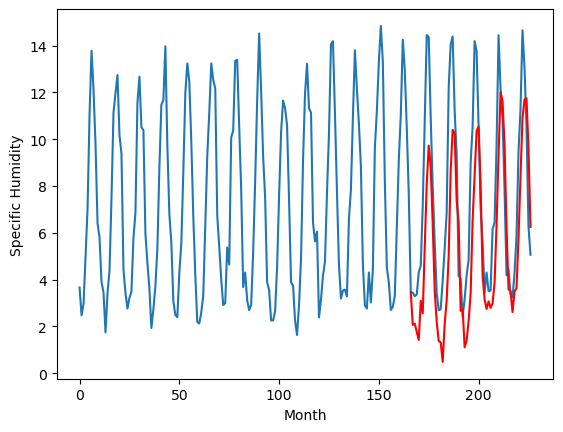

RangeIndex(start=1, stop=12, step=1)
[-1.4400000000000013, -1.0, -1.9, -1.5099999999999993, 2.209999999999999, 3.3500000000000005, 0.7000000000000002, 3.110000000000001, 4.03, 0.7999999999999996, 0.6200000000000001]
[2.060556945800781, 1.5705569458007815, 0.3205569458007811, -0.37944305419921864, 3.680556945800781, 2.170556945800781, 3.020556945800781, 3.9105569458007814, 3.5805569458007813, -0.22944305419921873, 2.060556945800781]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -1.44   2.060557
1                 1   -1.00   1.570557
2                 2   -1.90   0.320557
3                 3   -1.51  -0.379443
4                 4    2.21   3.680557
5                 5    3.35   2.170557
6                 6    0.70   3.020557
7                 7    3.11   3.910557
8                 8    4.03   3.580557
9                 9    0.80  -0.229443
10               10    0.62   2.060557


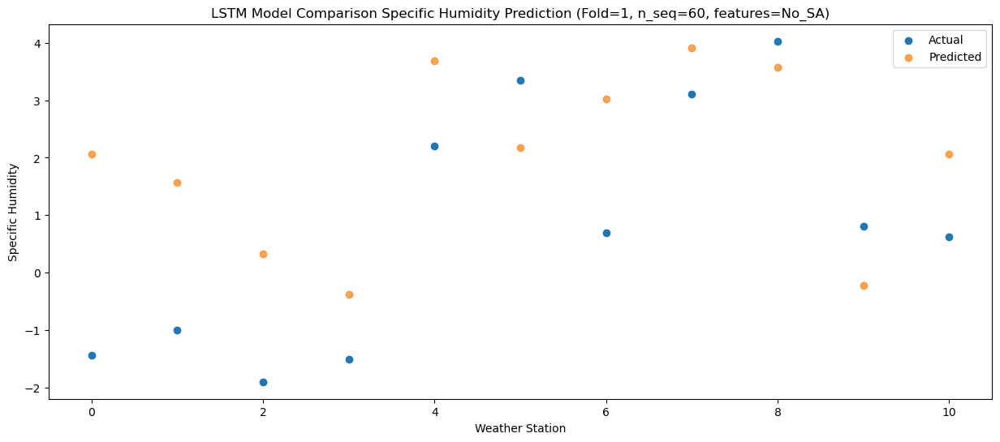

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -0.84   2.114529
1                 1   -0.95   1.624529
2                 2   -0.99   0.374529
3                 3   -2.71  -0.325471
4                 4    0.97   3.734529
5                 5    1.87   2.224529
6                 6    0.73   3.074529
7                 7    2.78   3.964529
8                 8    3.19   3.634529
9                 9    0.15  -0.175471
10               10    0.61   2.114529


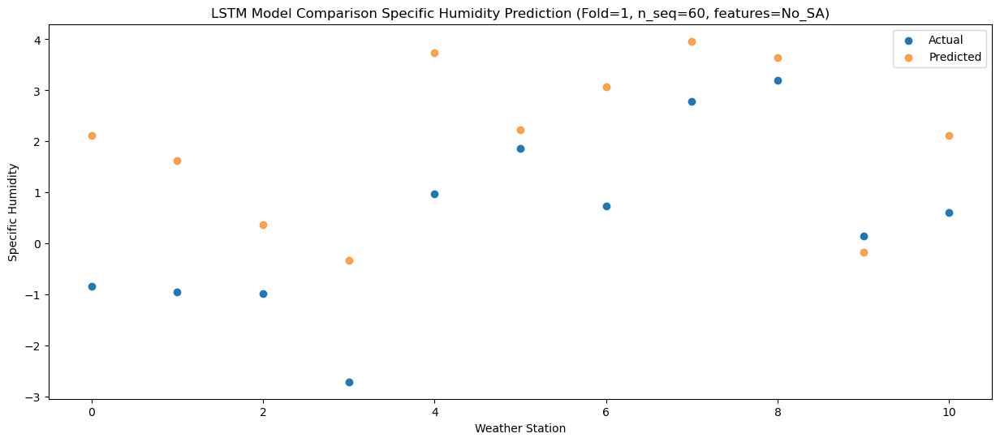

Predictions for (t+2):
    Weather_Station        Actual  Predicted
0                 0 -1.030000e+00   1.762165
1                 1 -1.200000e+00   1.272165
2                 2 -1.500000e+00   0.022165
3                 3 -1.810000e+00  -0.677835
4                 4  1.880000e+00   3.382165
5                 5  1.590000e+00   1.872165
6                 6  3.100000e-01   2.722165
7                 7  2.700000e+00   3.612165
8                 8  3.640000e+00   3.282165
9                 9 -2.775558e-16  -0.527835
10               10  4.600000e-01   1.762165


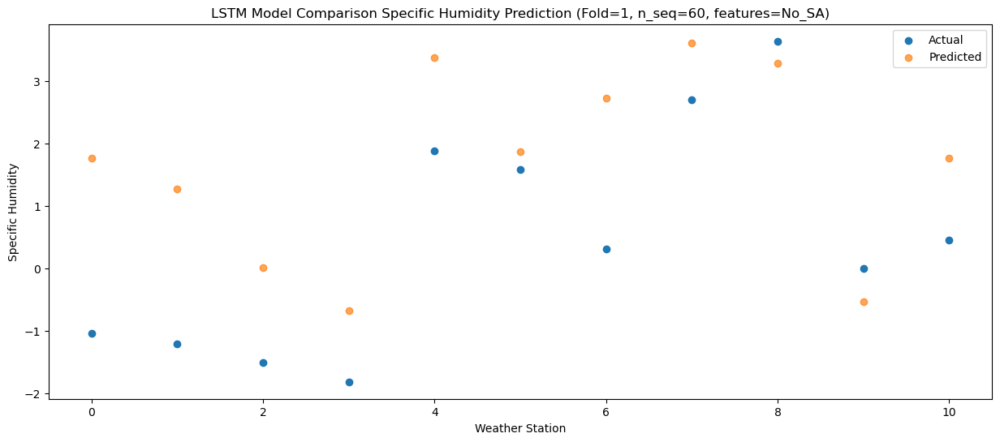

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -1.12   1.416975
1                 1   -0.68   0.926975
2                 2   -1.11  -0.323025
3                 3   -2.51  -1.023025
4                 4    1.20   3.036975
5                 5    1.77   1.526975
6                 6    0.79   2.376975
7                 7    2.58   3.266975
8                 8    3.02   2.936975
9                 9    0.01  -0.873025
10               10    0.53   1.416975
84/84 [==============================] - 3s 30ms/step - loss: 0.0680 - accuracy: 0.4762 - mae: 0.0539 - rmse: 0.0680 - mape: 12.2500 - pearson: 0.7695 - val_loss: 0.0512 - val_accuracy: 0.8000 - val_mae: 0.0398 - val_rmse: 0.0512 - val_mape: 8.8241 - val_pearson: 0.8775
Epoch 12/100
84/84 [==============================] - 3s 37ms/step - loss: 0.0695 - accuracy: 0.5476 - mae: 0.0552 - rmse: 0.0695 - mape: 12.4795 - pearson: 0.7682 - val_loss: 0.0603 - val_accuracy: 0.8000 - val_mae: 0.0478 - val_rmse: 0.

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



1/1 [==============================] - 0s 28ms/step
Month at t+1:
t+1 RMSE: 1.828717
t+1 MAE: 1.554255
t+1 MAPE: 4.142911
t+1 R2_SCORE: 0.524709
Month at t+2:
t+2 RMSE: 1.658748
t+2 MAE: 1.457786
t+2 MAPE: 16.111441
t+2 R2_SCORE: 0.573835
Month at t+3:
t+3 RMSE: 1.626333
t+3 MAE: 1.237358
t+3 MAPE: 7.028752
t+3 R2_SCORE: 0.601568
Month at t+4:
t+4 RMSE: 1.464752
t+4 MAE: 1.032985
t+4 MAPE: 3.206843
t+4 R2_SCORE: 0.613562
Month at t+5:
t+5 RMSE: 1.746164
t+5 MAE: 1.574006
t+5 MAPE: 0.967199
t+5 R2_SCORE: 0.543789
Month at t+6:
t+6 RMSE: 1.712017
t+6 MAE: 1.343256
t+6 MAPE: 0.583102
t+6 R2_SCORE: 0.609413
Month at t+7:
t+7 RMSE: 1.932350
t+7 MAE: 1.616158
t+7 MAPE: 0.433593
t+7 R2_SCORE: 0.516720
Month at t+8:
t+8 RMSE: 1.660837
t+8 MAE: 1.231200
t+8 MAPE: 0.208832
t+8 R2_SCORE: 0.561942
Month at t+9:
t+9 RMSE: 2.479163
t+9 MAE: 2.070528
t+9 MAPE: 0.222818
t+9 R2_SCORE: -0.005942
Month at t+10:
t+10 RMSE: 1.838897
t+10 MAE: 1.432775
t+10 MAPE: 0.181157
t+10 R2_SCORE: 0.363114
Month at t+

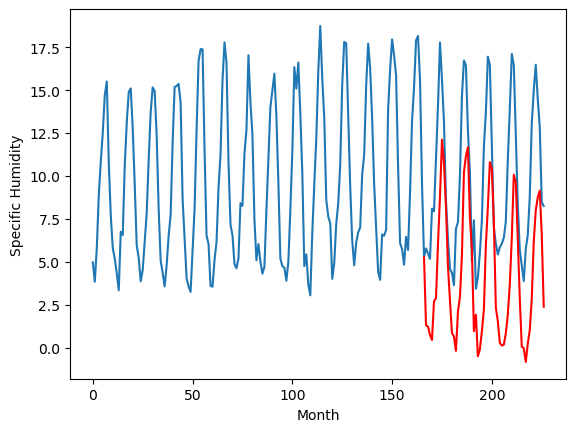

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.26		-1.42		-1.68
-0.25		-1.50		-1.25
-0.27		-1.99		-1.72
-0.21		-2.28		-2.07
1.58		-0.03		-1.61
1.87		0.16		-1.71
4.77		3.33		-1.44
6.19		6.05		-0.14
11.00		9.39		-1.61
9.57		8.02		-1.55
5.51		5.47		-0.04
1.78		2.01		0.23
1.56		0.02		-1.54
-0.17		-1.87		-1.70
-0.22		-2.08		-1.86
-0.90		-2.92		-2.02
0.95		-0.64		-1.59
1.07		0.22		-0.85
6.19		2.65		-3.54
9.10		7.49		-1.61
10.71		8.43		-2.28
9.09		8.95		-0.14
6.27		4.86		-1.41
2.88		2.98		0.10
0.45		-1.77		-2.22
-0.61		-0.81		-0.20
-0.94		-3.22		-2.28
-1.03		-2.83		-1.80
-0.15		-1.78		-1.63
1.00		-0.52		-1.52
3.39		3.26		-0.13
7.75		5.45		-2.30
9.09		8.08		-1.01
8.59		7.67		-0.92
6.02		4.60		-1.42
2.34		-0.39		-2.73
0.84		-1.20		-2.04
-0.35		-2.46		-2.11
-0.36		-2.60		-2.24
-0.44		-2.56		-2.12
0.25		-1.90		-2.15
0.87		-0.81		-1.68
6.65		0.98		-5.67
9.30		3.69		-5.61
11.36		7.34		-4.02
9.47		6.90		-2.57
6.88		3.57		-3.31
3.42		0.12		-3.30
0.86	

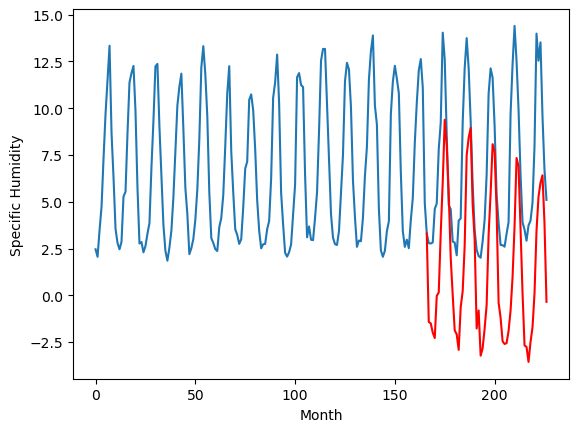

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.12		1.73		1.61
0.43		1.65		1.22
-1.13		1.16		2.29
-0.25		0.87		1.12
0.92		3.12		2.20
2.40		3.31		0.91
3.51		6.48		2.97
6.85		9.20		2.35
7.87		12.54		4.67
8.57		11.17		2.60
7.87		8.62		0.75
5.28		5.16		-0.12
2.33		3.17		0.84
-2.34		1.28		3.62
-1.85		1.07		2.92
0.28		0.23		-0.05
0.50		2.51		2.01
1.47		3.37		1.90
2.78		5.80		3.02
6.56		10.64		4.08
6.96		11.58		4.62
7.58		12.10		4.52
6.30		8.01		1.71
3.64		6.13		2.49
-0.31		1.38		1.69
1.09		2.34		1.25
-2.56		-0.07		2.49
-1.37		0.32		1.69
0.44		1.37		0.93
1.80		2.63		0.83
4.90		6.41		1.51
6.83		8.60		1.77
7.66		11.23		3.57
7.55		10.82		3.27
7.40		7.75		0.35
3.01		2.76		-0.25
2.90		1.95		-0.95
-0.76		0.69		1.45
-1.14		0.55		1.69
0.71		0.59		-0.12
1.10		1.25		0.15
2.61		2.34		-0.27
3.42		4.13		0.71
6.58		6.84		0.26
7.55		10.49		2.94
8.27		10.05		1.78
5.88		6.72		0.84
2.96		3.27		0.31
0.46		0.47		0.01
-0.11		0.39		0.50
-1.18		-0.41		0.77
-1.60		0.6

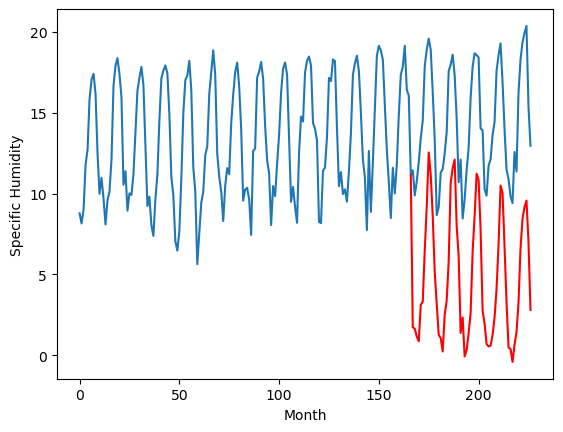

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.77		1.75		0.98
0.21		1.67		1.46
0.03		1.18		1.15
0.05		0.89		0.84
0.57		3.14		2.57
0.95		3.33		2.38
3.20		6.50		3.30
7.21		9.22		2.01
10.59		12.56		1.97
9.76		11.19		1.43
6.67		8.64		1.97
4.16		5.18		1.02
2.29		3.19		0.90
0.37		1.30		0.93
-0.71		1.09		1.80
-0.54		0.25		0.79
0.10		2.53		2.43
1.45		3.39		1.94
3.13		5.82		2.69
7.73		10.66		2.93
10.33		11.60		1.27
11.07		12.12		1.05
8.41		8.03		-0.38
5.45		6.15		0.70
1.00		1.40		0.40
0.64		2.36		1.72
-0.69		-0.05		0.64
-0.12		0.34		0.46
0.64		1.39		0.75
1.34		2.65		1.31
4.64		6.43		1.79
6.90		8.62		1.72
10.26		11.25		0.99
10.94		10.84		-0.10
7.14		7.77		0.63
4.27		2.78		-1.49
2.45		1.97		-0.48
0.36		0.71		0.35
0.87		0.57		-0.30
0.11		0.61		0.50
0.36		1.27		0.91
2.44		2.36		-0.08
3.25		4.15		0.90
7.15		6.86		-0.29
11.41		10.51		-0.90
9.07		10.07		1.00
8.06		6.74		-1.32
4.70		3.29		-1.41
0.87		0.49		-0.38
1.16		0.41		-0.75
-0.17		-0.39		-0.22
-0.

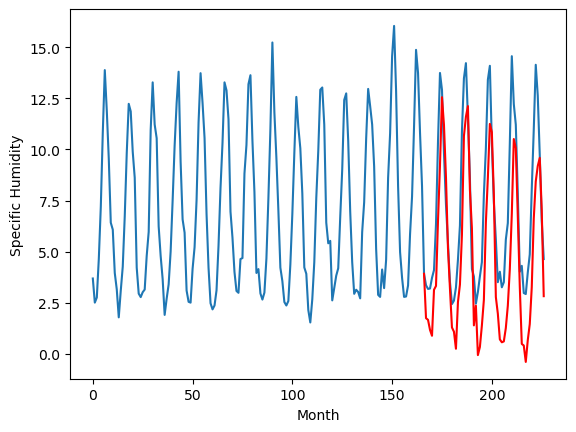

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.79		1.66		2.45
0.01		1.58		1.57
0.04		1.09		1.05
0.36		0.80		0.44
3.85		3.05		-0.80
2.89		3.24		0.35
5.01		6.41		1.40
8.35		9.13		0.78
10.48		12.47		1.99
9.75		11.10		1.35
7.95		8.55		0.60
4.74		5.09		0.35
2.01		3.10		1.09
-1.27		1.21		2.48
-1.14		1.00		2.14
-1.16		0.16		1.32
2.13		2.44		0.31
2.15		3.30		1.15
5.35		5.73		0.38
9.24		10.57		1.33
10.27		11.51		1.24
9.87		12.03		2.16
7.73		7.94		0.21
5.20		6.06		0.86
-0.46		1.31		1.77
2.82		2.27		-0.55
-2.09		-0.14		1.95
-0.63		0.25		0.88
0.22		1.30		1.08
2.65		2.56		-0.09
6.68		6.34		-0.34
8.98		8.53		-0.45
10.27		11.16		0.89
10.67		10.75		0.08
7.16		7.68		0.52
1.98		2.69		0.71
1.54		1.88		0.34
0.99		0.62		-0.37
0.90		0.48		-0.42
2.20		0.52		-1.68
3.08		1.18		-1.90
3.63		2.27		-1.36
6.69		4.06		-2.63
10.00		6.77		-3.23
11.34		10.42		-0.92
11.37		9.98		-1.39
9.02		6.65		-2.37
3.79		3.20		-0.59
1.27		0.40		-0.87
-0.32		0.32		0.64
-1.19		-0.48		

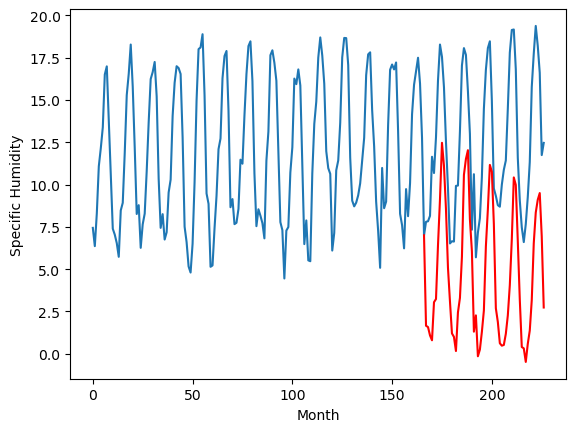

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.21		-0.85		0.36
-2.40		-0.93		1.47
-1.57		-1.42		0.15
-2.24		-1.71		0.53
2.37		0.54		-1.83
1.85		0.73		-1.12
3.93		3.90		-0.03
6.05		6.62		0.57
8.63		9.96		1.33
7.19		8.59		1.40
5.74		6.04		0.30
1.87		2.58		0.71
-0.19		0.59		0.78
-2.51		-1.30		1.21
-2.64		-1.51		1.13
-2.69		-2.35		0.34
0.30		-0.07		-0.37
1.87		0.79		-1.08
6.70		3.22		-3.48
9.34		8.06		-1.28
8.30		9.00		0.70
8.43		9.52		1.09
4.87		5.43		0.56
3.28		3.55		0.27
-0.91		-1.20		-0.29
1.96		-0.24		-2.20
-3.67		-2.65		1.02
-3.45		-2.26		1.19
-1.83		-1.21		0.62
2.13		0.05		-2.08
5.78		3.83		-1.95
6.81		6.02		-0.79
7.91		8.65		0.74
8.37		8.24		-0.13
5.01		5.17		0.16
0.19		0.18		-0.01
0.05		-0.63		-0.68
-0.86		-1.89		-1.03
-1.24		-2.03		-0.79
-0.79		-1.99		-1.20
0.99		-1.33		-2.32
1.54		-0.24		-1.78
5.24		1.55		-3.69
8.70		4.26		-4.44
8.41		7.91		-0.50
6.98		7.47		0.49
6.43		4.14		-2.29
2.90		0.69		-2.21
-0.27		-2.11		-1.84
-2.20		-2.

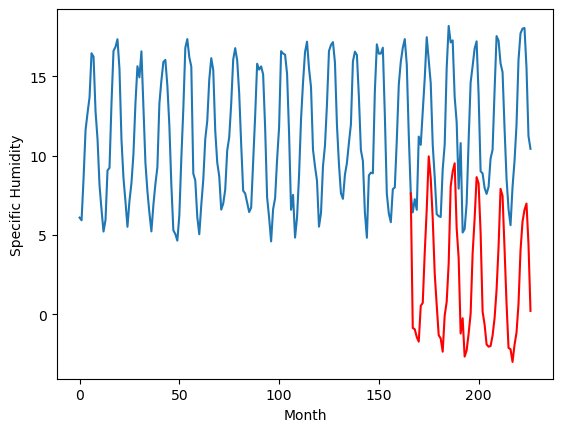

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
5.57		5.47		-0.10
4.47		5.39		0.92
5.15		4.90		-0.25
4.59		4.61		0.02
8.81		6.86		-1.95
8.39		7.05		-1.34
11.33		10.22		-1.11
13.61		12.94		-0.67
16.52		16.28		-0.24
13.82		14.91		1.09
12.88		12.36		-0.52
8.39		8.90		0.51
6.80		6.91		0.11
4.09		5.02		0.93
3.99		4.81		0.82
3.66		3.97		0.31
6.52		6.25		-0.27
7.84		7.11		-0.73
12.04		9.54		-2.50
15.79		14.38		-1.41
16.61		15.32		-1.29
16.99		15.84		-1.15
12.54		11.75		-0.79
9.93		9.87		-0.06
5.94		5.12		-0.82
8.44		6.08		-2.36
3.15		3.67		0.52
3.62		4.06		0.44
5.25		5.11		-0.14
9.15		6.37		-2.78
13.24		10.15		-3.09
14.04		12.34		-1.70
13.36		14.97		1.61
14.42		14.56		0.14
11.75		11.49		-0.26
6.97		6.50		-0.47
6.52		5.69		-0.83
5.35		4.43		-0.92
4.57		4.29		-0.28
4.97		4.33		-0.64
6.88		4.99		-1.89
7.55		6.08		-1.47
11.44		7.87		-3.57
15.34		10.58		-4.76
14.63		14.23		-0.40
12.58		13.79		1.21
11.95		10.46		-1.49
8.80		7.01		-1.79
6.18		4.21		-1.9

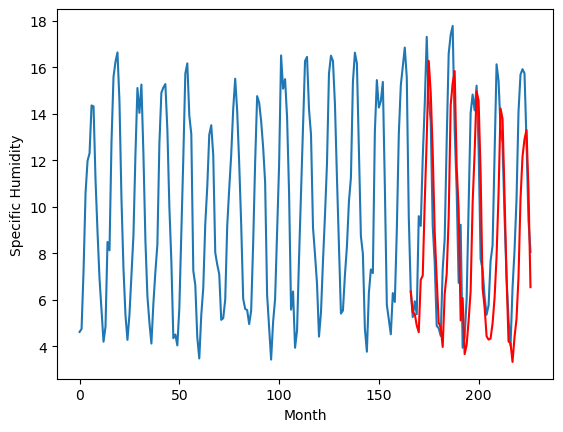

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.62		0.38		-2.24
2.17		0.30		-1.87
1.22		-0.19		-1.41
1.75		-0.48		-2.23
3.21		1.77		-1.44
1.81		1.96		0.15
2.05		5.13		3.08
3.73		7.85		4.12
7.17		11.19		4.02
5.44		9.82		4.38
4.79		7.27		2.48
1.72		3.81		2.09
1.77		1.82		0.05
0.51		-0.07		-0.58
0.79		-0.28		-1.07
0.66		-1.12		-1.78
0.75		1.16		0.41
1.05		2.02		0.97
1.17		4.45		3.28
3.83		9.29		5.46
9.07		10.23		1.16
9.36		10.75		1.39
6.60		6.66		0.06
2.89		4.78		1.89
1.24		0.03		-1.21
1.37		0.99		-0.38
1.09		-1.42		-2.51
0.10		-1.03		-1.13
0.50		0.02		-0.48
0.51		1.28		0.77
0.44		5.06		4.62
5.94		7.25		1.31
8.50		9.88		1.38
10.47		9.47		-1.00
7.43		6.40		-1.03
5.35		1.41		-3.94
1.38		0.60		-0.78
2.20		-0.66		-2.86
1.31		-0.80		-2.11
1.19		-0.76		-1.95
1.53		-0.10		-1.63
0.69		0.99		0.30
2.69		2.78		0.09
2.49		5.49		3.00
5.84		9.14		3.30
8.03		8.70		0.67
6.22		5.37		-0.85
3.77		1.92		-1.85
2.85		-0.88		-3.73
1.33		-0.96		-2.29
1.75		-1.76		

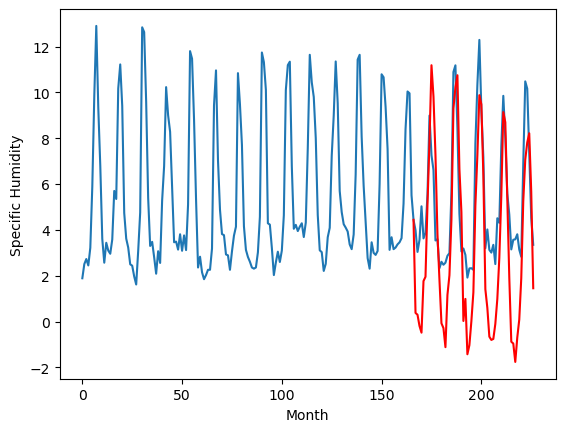

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
7.78		4.13		-3.65
7.60		4.05		-3.55
7.39		3.56		-3.83
6.67		3.27		-3.40
8.31		5.52		-2.79
9.72		5.71		-4.01
10.48		8.88		-1.60
10.46		11.60		1.14
11.23		14.94		3.71
12.31		13.57		1.26
10.53		11.02		0.49
9.40		7.56		-1.84
7.16		5.57		-1.59
5.59		3.68		-1.91
6.44		3.47		-2.97
6.97		2.63		-4.34
7.08		4.91		-2.17
8.40		5.77		-2.63
9.88		8.20		-1.68
11.13		13.04		1.91
12.28		13.98		1.70
11.68		14.50		2.82
11.22		10.41		-0.81
8.42		8.53		0.11
7.88		3.78		-4.10
7.70		4.74		-2.96
6.34		2.33		-4.01
5.60		2.72		-2.88
7.34		3.77		-3.57
8.18		5.03		-3.15
9.44		8.81		-0.63
11.21		11.00		-0.21
12.10		13.63		1.53
12.20		13.22		1.02
13.05		10.15		-2.90
11.28		5.16		-6.12
6.64		4.35		-2.29
7.49		3.09		-4.40
7.58		2.95		-4.63
6.17		2.99		-3.18
8.09		3.65		-4.44
8.79		4.74		-4.05
10.19		6.53		-3.66
10.57		9.24		-1.33
11.91		12.89		0.98
12.52		12.45		-0.07
12.27		9.12		-3.15
9.97		5.67		-4.30
6.94		2.87		-4.07
7

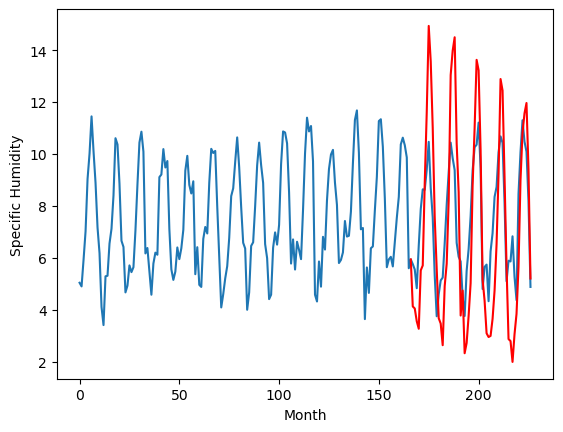

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.89		2.79		1.90
1.00		2.71		1.71
0.98		2.22		1.24
1.37		1.93		0.56
3.00		4.18		1.18
2.91		4.37		1.46
6.24		7.54		1.30
9.75		10.26		0.51
12.60		13.60		1.00
12.59		12.23		-0.36
8.87		9.68		0.81
6.25		6.22		-0.03
3.60		4.23		0.63
0.38		2.34		1.96
0.26		2.13		1.87
0.33		1.29		0.96
2.06		3.57		1.51
2.59		4.43		1.84
5.30		6.86		1.56
9.80		11.70		1.90
11.32		12.64		1.32
11.90		13.16		1.26
8.30		9.07		0.77
6.14		7.19		1.05
0.58		2.44		1.86
2.43		3.40		0.97
-0.35		0.99		1.34
0.96		1.38		0.42
1.92		2.43		0.51
2.96		3.69		0.73
7.28		7.47		0.19
9.08		9.66		0.58
12.66		12.29		-0.37
11.09		11.88		0.79
7.66		8.81		1.15
3.30		3.82		0.52
2.83		3.01		0.18
0.59		1.75		1.16
1.45		1.61		0.16
2.21		1.65		-0.56
1.90		2.31		0.41
4.03		3.40		-0.63
5.56		5.19		-0.37
8.42		7.90		-0.52
12.26		11.55		-0.71
11.77		11.11		-0.66
8.63		7.78		-0.85
4.44		4.33		-0.11
1.33		1.53		0.20
1.24		1.45		0.21
0.55		0.65		0.10
0.69		1

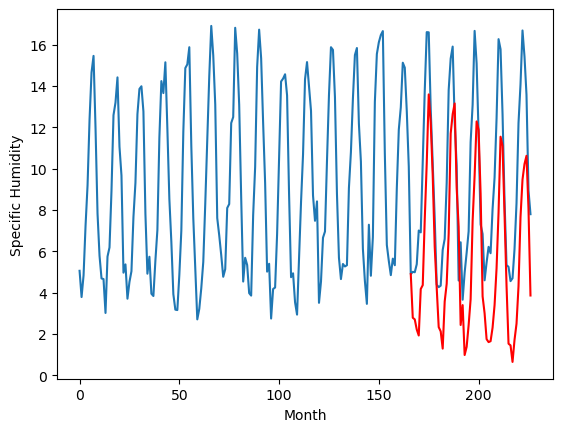

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.08		1.31		1.23
0.53		1.23		0.70
0.33		0.74		0.41
0.44		0.45		0.01
2.29		2.70		0.41
1.72		2.89		1.17
4.51		6.06		1.55
7.95		8.78		0.83
10.65		12.12		1.47
10.41		10.75		0.34
7.80		8.20		0.40
4.61		4.74		0.13
1.49		2.75		1.26
-0.30		0.86		1.16
-0.29		0.65		0.94
-0.05		-0.19		-0.14
0.98		2.09		1.11
1.59		2.95		1.36
4.26		5.38		1.12
8.36		10.22		1.86
9.77		11.16		1.39
10.16		11.68		1.52
6.95		7.59		0.64
5.22		5.71		0.49
-0.14		0.96		1.10
1.42		1.92		0.50
-1.00		-0.49		0.51
-0.10		-0.10		0.00
0.52		0.95		0.43
1.79		2.21		0.42
5.95		5.99		0.04
7.91		8.18		0.27
11.12		10.81		-0.31
10.13		10.40		0.27
6.65		7.33		0.68
1.99		2.34		0.35
1.37		1.53		0.16
0.28		0.27		-0.01
0.55		0.13		-0.42
0.95		0.17		-0.78
0.55		0.83		0.28
2.19		1.92		-0.27
4.78		3.71		-1.07
6.62		6.42		-0.20
9.93		10.07		0.14
10.04		9.63		-0.41
7.62		6.30		-1.32
3.51		2.85		-0.66
0.56		0.05		-0.51
0.35		-0.03		-0.38
-0.27		-0.83		-0.

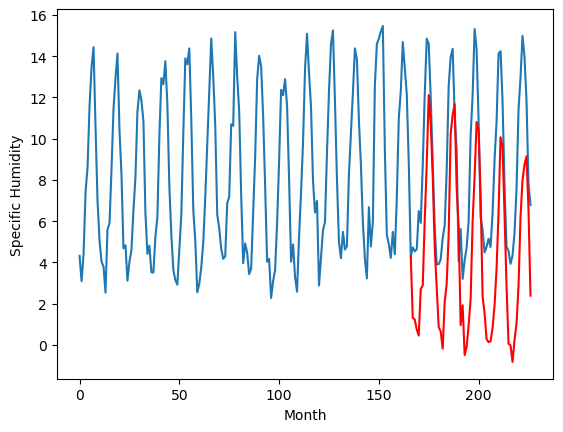

RangeIndex(start=1, stop=12, step=1)
[0.41000000000000014, 0.26000000000000045, 0.1200000000000001, 0.7699999999999987, -0.79, -1.2099999999999995, 5.569999999999999, 2.62, 7.780000000000001, 0.8900000000000006, 0.08000000000000007]
[1.3089367103576661, -1.421063289642334, 1.728936710357666, 1.7489367103576656, 1.6589367103576658, -0.851063289642334, 5.468936710357665, 0.37893671035766596, 4.128936710357666, 2.7889367103576657, 1.3089367103576661]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    0.41   1.308937
1                 1    0.26  -1.421063
2                 2    0.12   1.728937
3                 3    0.77   1.748937
4                 4   -0.79   1.658937
5                 5   -1.21  -0.851063
6                 6    5.57   5.468937
7                 7    2.62   0.378937
8                 8    7.78   4.128937
9                 9    0.89   2.788937
10               10    0.08   1.308937


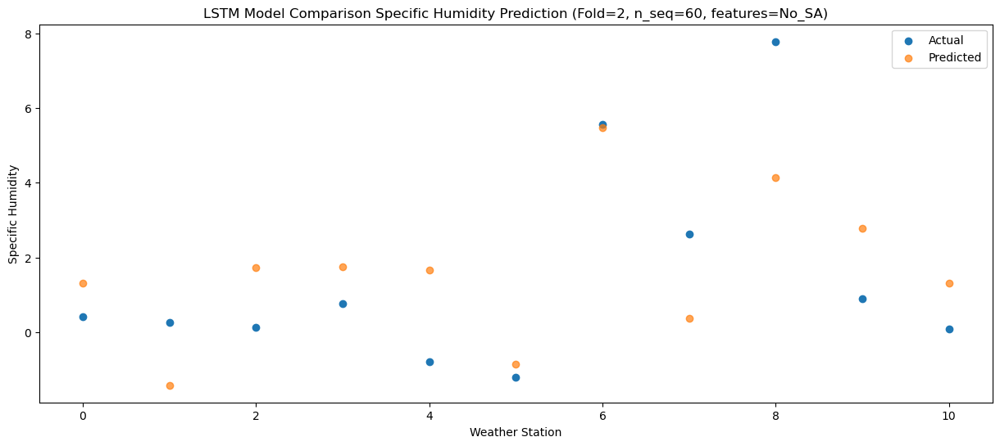

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    0.91   1.229129
1                 1   -0.25  -1.500871
2                 2    0.43   1.649129
3                 3    0.21   1.669129
4                 4    0.01   1.579129
5                 5   -2.40  -0.930871
6                 6    4.47   5.389129
7                 7    2.17   0.299129
8                 8    7.60   4.049129
9                 9    1.00   2.709129
10               10    0.53   1.229129


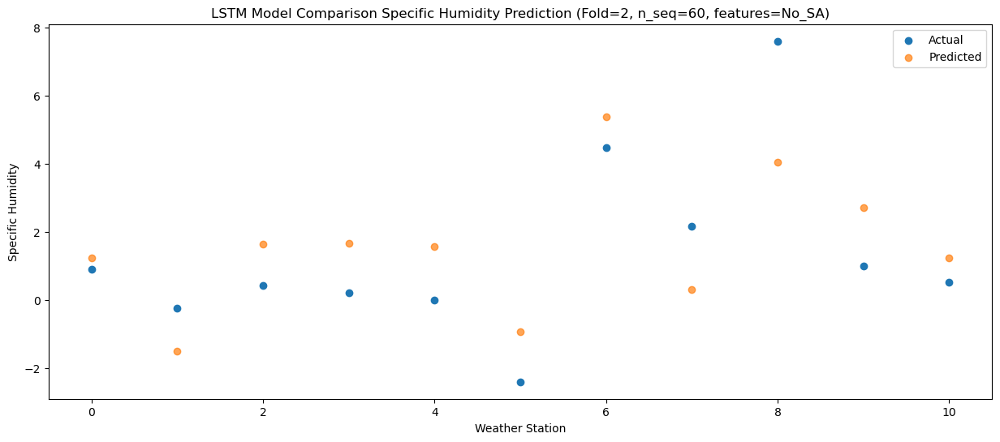

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0    0.62   0.736978
1                 1   -0.27  -1.993022
2                 2   -1.13   1.156978
3                 3    0.03   1.176978
4                 4    0.04   1.086978
5                 5   -1.57  -1.423022
6                 6    5.15   4.896978
7                 7    1.22  -0.193022
8                 8    7.39   3.556978
9                 9    0.98   2.216978
10               10    0.33   0.736978


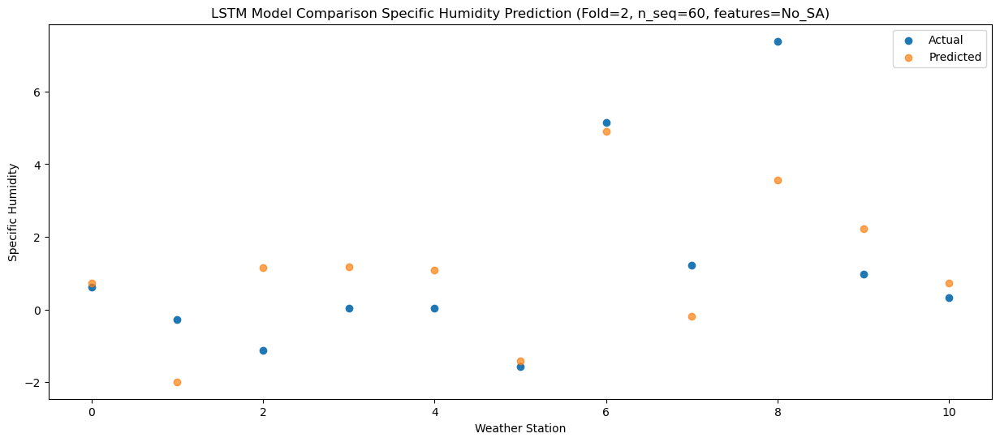

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0    0.30   0.448566
1                 1   -0.21  -2.281434
2                 2   -0.25   0.868566
3                 3    0.05   0.888566
4                 4    0.36   0.798566
5                 5   -2.24  -1.711434
6                 6    4.59   4.608566
7                 7    1.75  -0.481434
8                 8    6.67   3.268566
9                 9    1.37   1.928566
10               10    0.44   0.448566


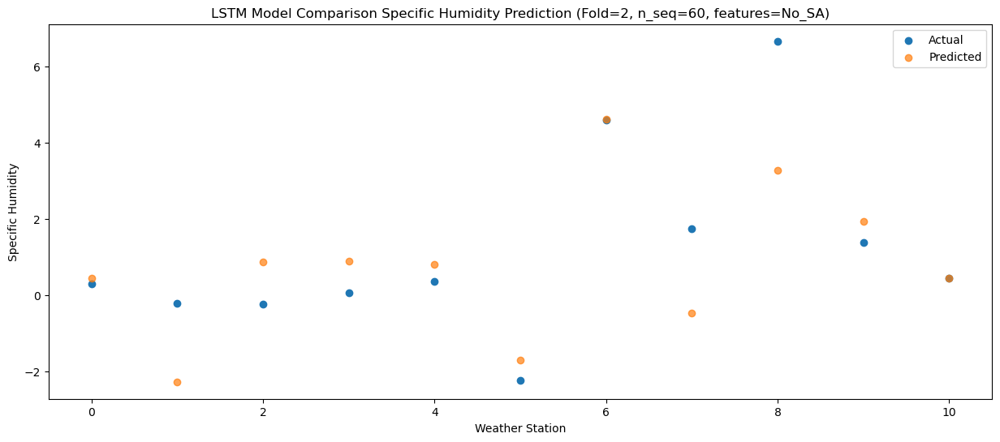

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    3.23   2.698643
1                 1    1.58  -0.031357
2                 2    0.92   3.118643
3                 3    0.57   3.138643
4                 4    3.85   3.048643
5                 5    2.37   0.538643
6                 6    8.81   6.858643
7                 7    3.21   1.768643
8                 8    8.31   5.518643
9                 9    3.00   4.178643
10               10    2.29   2.698643


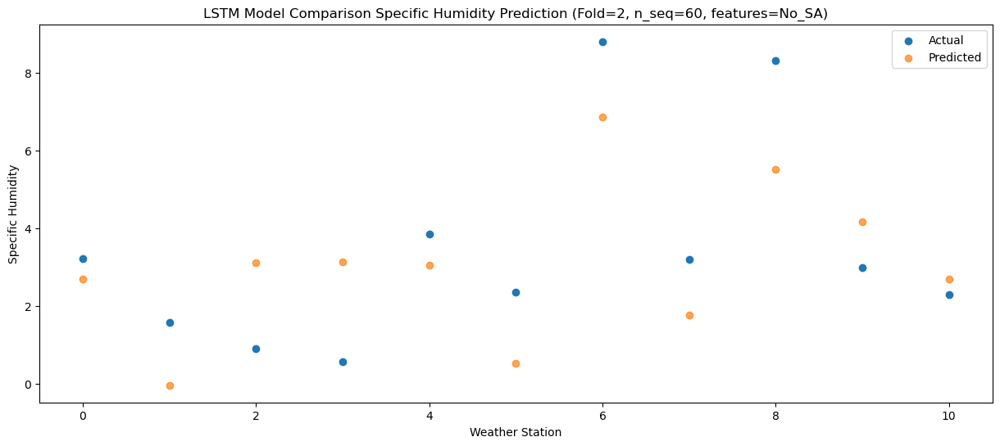

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    3.07   2.885817
1                 1    1.87   0.155817
2                 2    2.40   3.305817
3                 3    0.95   3.325817
4                 4    2.89   3.235817
5                 5    1.85   0.725817
6                 6    8.39   7.045817
7                 7    1.81   1.955817
8                 8    9.72   5.705817
9                 9    2.91   4.365817
10               10    1.72   2.885817


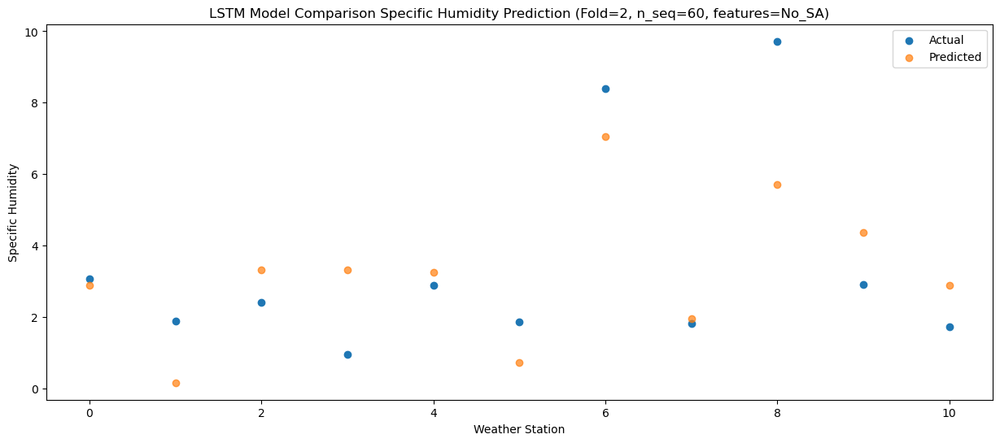

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    6.06   6.057733
1                 1    4.77   3.327733
2                 2    3.51   6.477733
3                 3    3.20   6.497733
4                 4    5.01   6.407733
5                 5    3.93   3.897733
6                 6   11.33  10.217733
7                 7    2.05   5.127733
8                 8   10.48   8.877733
9                 9    6.24   7.537733
10               10    4.51   6.057733


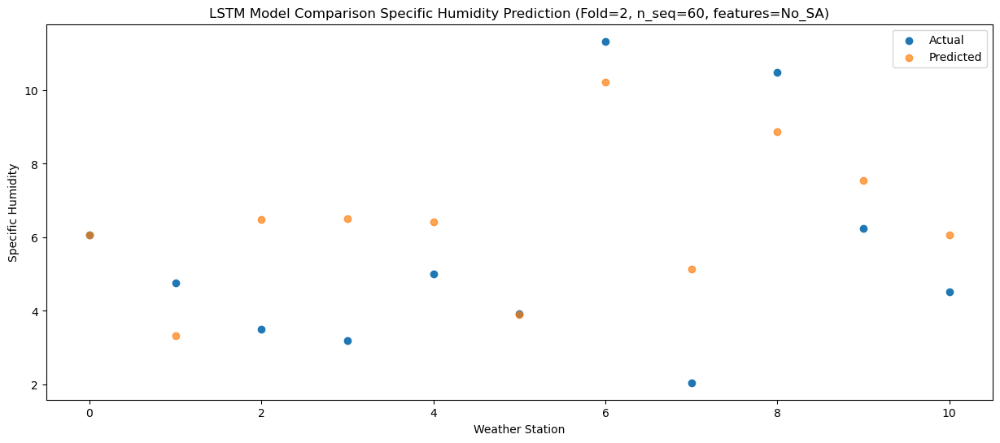

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0    9.21   8.778639
1                 1    6.19   6.048639
2                 2    6.85   9.198639
3                 3    7.21   9.218639
4                 4    8.35   9.128639
5                 5    6.05   6.618639
6                 6   13.61  12.938639
7                 7    3.73   7.848639
8                 8   10.46  11.598639
9                 9    9.75  10.258639
10               10    7.95   8.778639


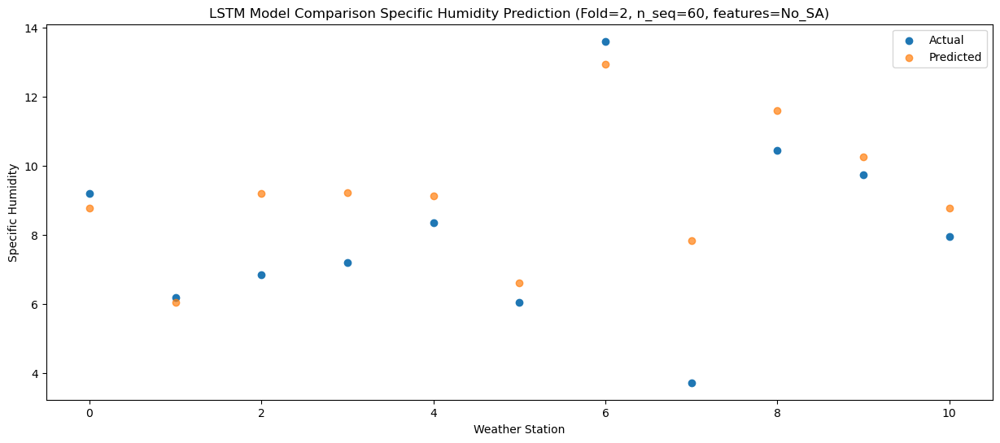

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   12.91  12.115162
1                 1   11.00   9.385162
2                 2    7.87  12.535162
3                 3   10.59  12.555162
4                 4   10.48  12.465162
5                 5    8.63   9.955162
6                 6   16.52  16.275162
7                 7    7.17  11.185162
8                 8   11.23  14.935162
9                 9   12.60  13.595162
10               10   10.65  12.115162


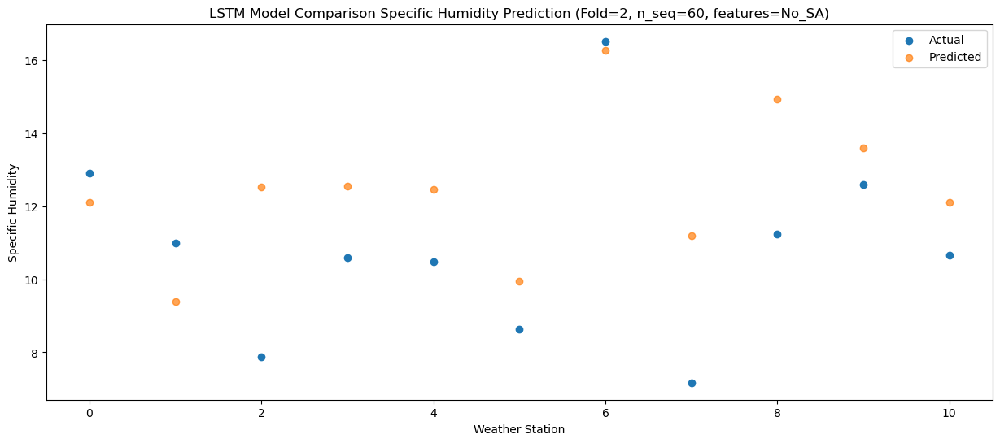

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   10.75  10.750074
1                 1    9.57   8.020074
2                 2    8.57  11.170074
3                 3    9.76  11.190074
4                 4    9.75  11.100074
5                 5    7.19   8.590074
6                 6   13.82  14.910074
7                 7    5.44   9.820074
8                 8   12.31  13.570074
9                 9   12.59  12.230074
10               10   10.41  10.750074


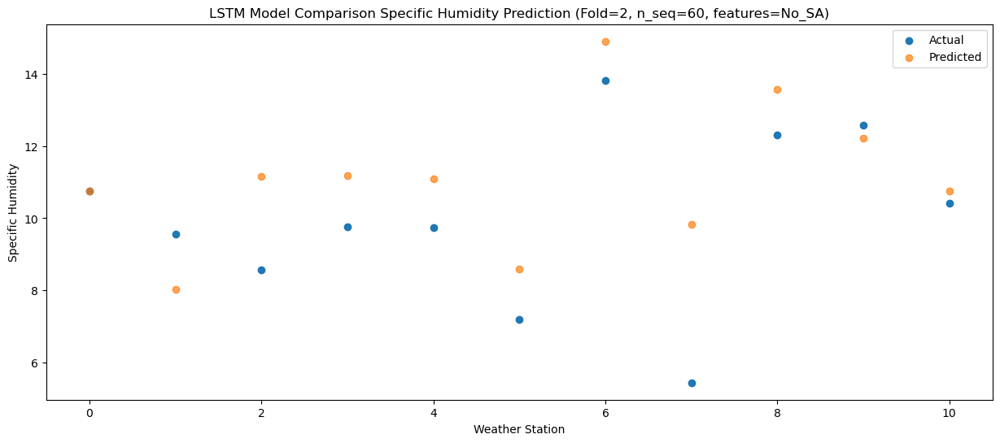

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    8.29   8.198518
1                 1    5.51   5.468518
2                 2    7.87   8.618518
3                 3    6.67   8.638518
4                 4    7.95   8.548518
5                 5    5.74   6.038518
6                 6   12.88  12.358518
7                 7    4.79   7.268518
8                 8   10.53  11.018518
9                 9    8.87   9.678518
10               10    7.80   8.198518


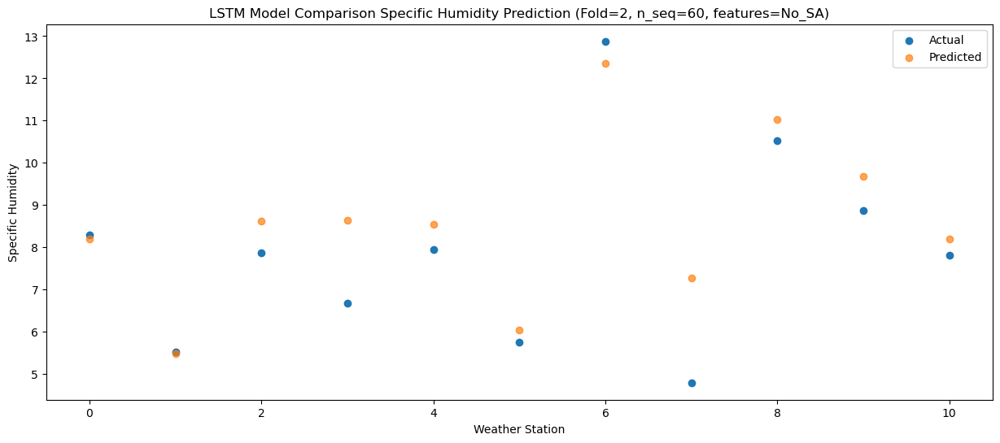

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    3.70   4.740006
1                 1    1.78   2.010006
2                 2    5.28   5.160006
3                 3    4.16   5.180006
4                 4    4.74   5.090006
5                 5    1.87   2.580006
6                 6    8.39   8.900006
7                 7    1.72   3.810006
8                 8    9.40   7.560006
9                 9    6.25   6.220006
10               10    4.61   4.740006


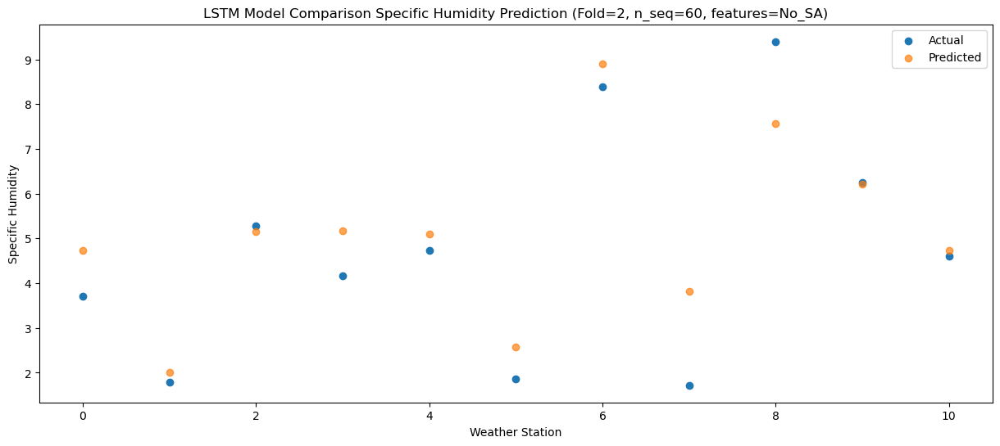

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    1.45    2.74782
1                 1    1.56    0.01782
2                 2    2.33    3.16782
3                 3    2.29    3.18782
4                 4    2.01    3.09782
5                 5   -0.19    0.58782
6                 6    6.80    6.90782
7                 7    1.77    1.81782
8                 8    7.16    5.56782
9                 9    3.60    4.22782
10               10    1.49    2.74782


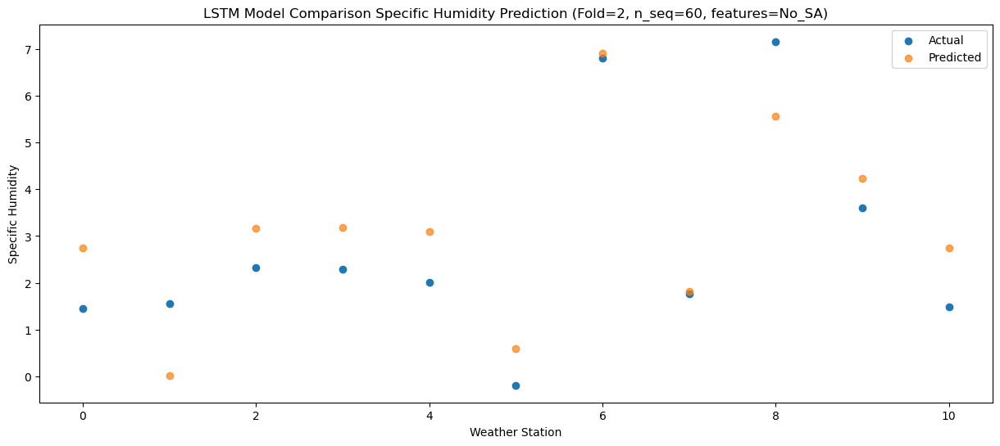

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -0.28   0.855603
1                 1   -0.17  -1.874397
2                 2   -2.34   1.275603
3                 3    0.37   1.295603
4                 4   -1.27   1.205603
5                 5   -2.51  -1.304397
6                 6    4.09   5.015603
7                 7    0.51  -0.074397
8                 8    5.59   3.675603
9                 9    0.38   2.335603
10               10   -0.30   0.855603


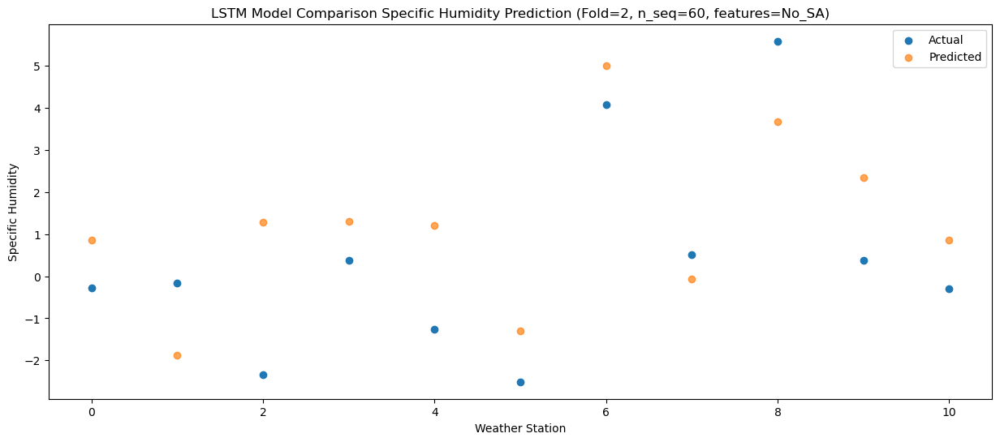

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -0.51   0.647444
1                 1   -0.22  -2.082556
2                 2   -1.85   1.067444
3                 3   -0.71   1.087444
4                 4   -1.14   0.997444
5                 5   -2.64  -1.512556
6                 6    3.99   4.807444
7                 7    0.79  -0.282556
8                 8    6.44   3.467444
9                 9    0.26   2.127444
10               10   -0.29   0.647444


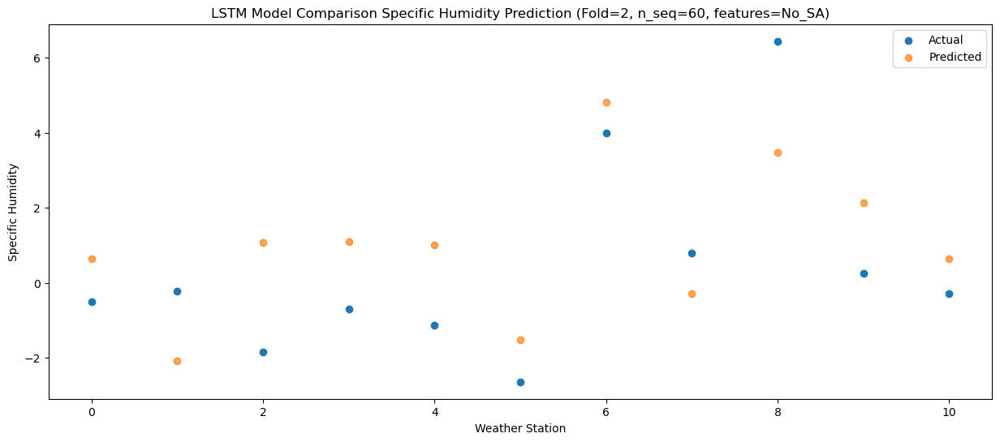

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -1.23  -0.185291
1                 1   -0.90  -2.915291
2                 2    0.28   0.234709
3                 3   -0.54   0.254709
4                 4   -1.16   0.164709
5                 5   -2.69  -2.345291
6                 6    3.66   3.974709
7                 7    0.66  -1.115291
8                 8    6.97   2.634709
9                 9    0.33   1.294709
10               10   -0.05  -0.185291


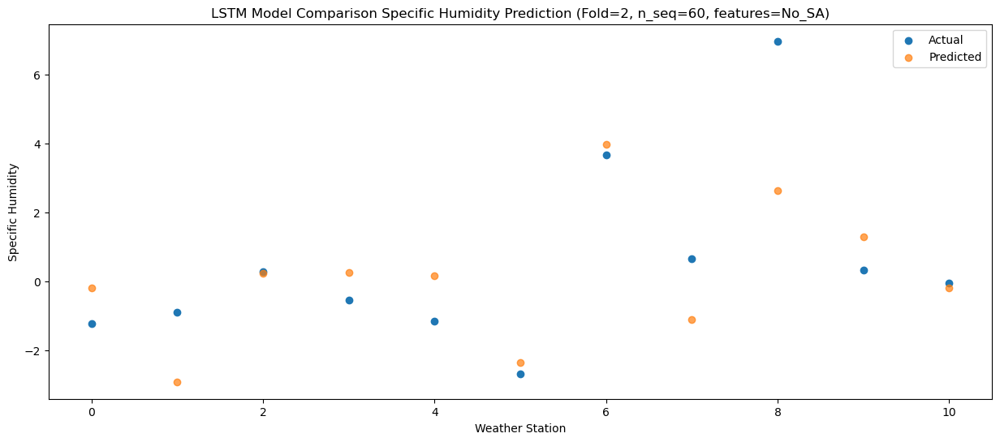

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    2.05   2.093358
1                 1    0.95  -0.636642
2                 2    0.50   2.513358
3                 3    0.10   2.533358
4                 4    2.13   2.443358
5                 5    0.30  -0.066642
6                 6    6.52   6.253358
7                 7    0.75   1.163358
8                 8    7.08   4.913358
9                 9    2.06   3.573358
10               10    0.98   2.093358


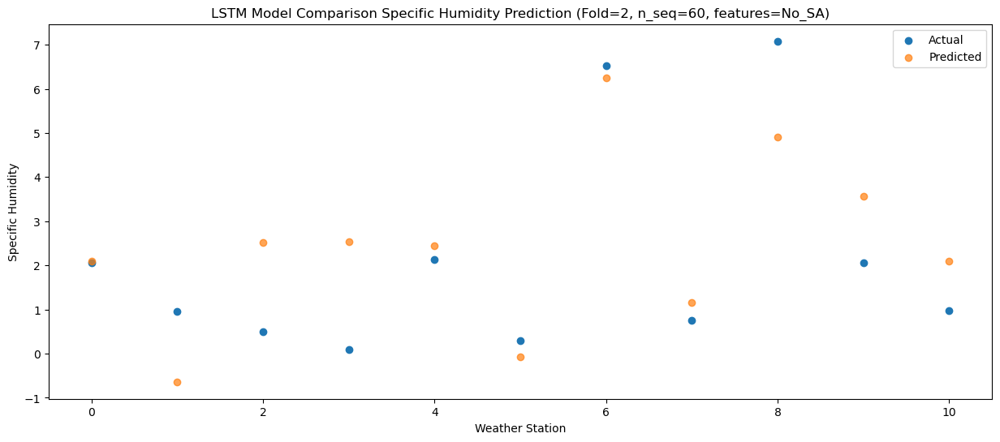

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    2.44   2.951501
1                 1    1.07   0.221501
2                 2    1.47   3.371501
3                 3    1.45   3.391501
4                 4    2.15   3.301501
5                 5    1.87   0.791501
6                 6    7.84   7.111501
7                 7    1.05   2.021501
8                 8    8.40   5.771501
9                 9    2.59   4.431501
10               10    1.59   2.951501


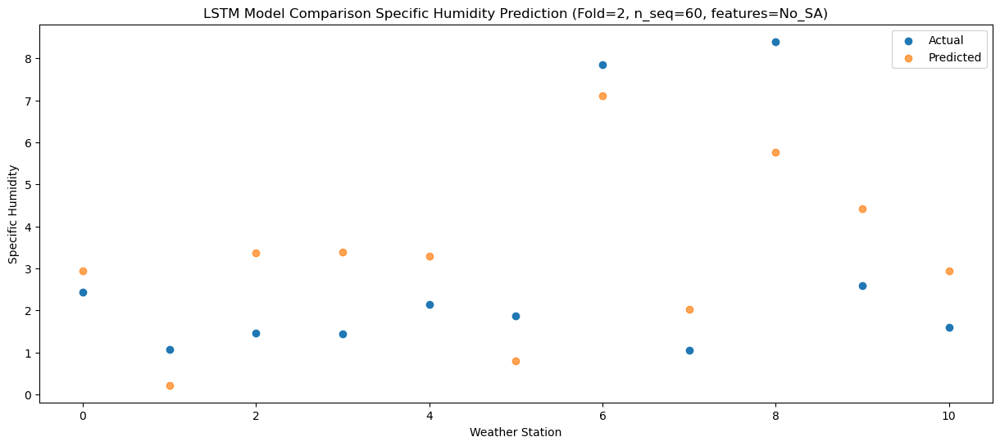

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    5.11   5.381828
1                 1    6.19   2.651828
2                 2    2.78   5.801828
3                 3    3.13   5.821828
4                 4    5.35   5.731828
5                 5    6.70   3.221828
6                 6   12.04   9.541828
7                 7    1.17   4.451828
8                 8    9.88   8.201828
9                 9    5.30   6.861828
10               10    4.26   5.381828


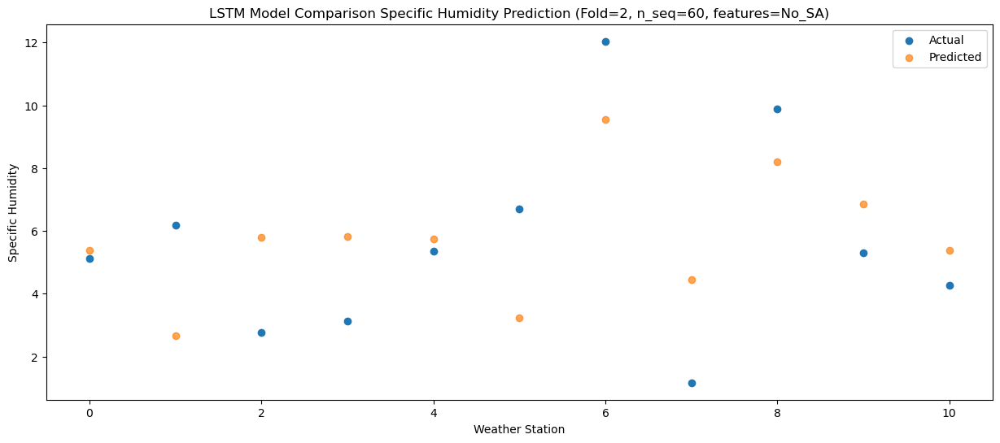

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0    9.76  10.220744
1                 1    9.10   7.490744
2                 2    6.56  10.640744
3                 3    7.73  10.660744
4                 4    9.24  10.570744
5                 5    9.34   8.060744
6                 6   15.79  14.380744
7                 7    3.83   9.290744
8                 8   11.13  13.040744
9                 9    9.80  11.700744
10               10    8.36  10.220744


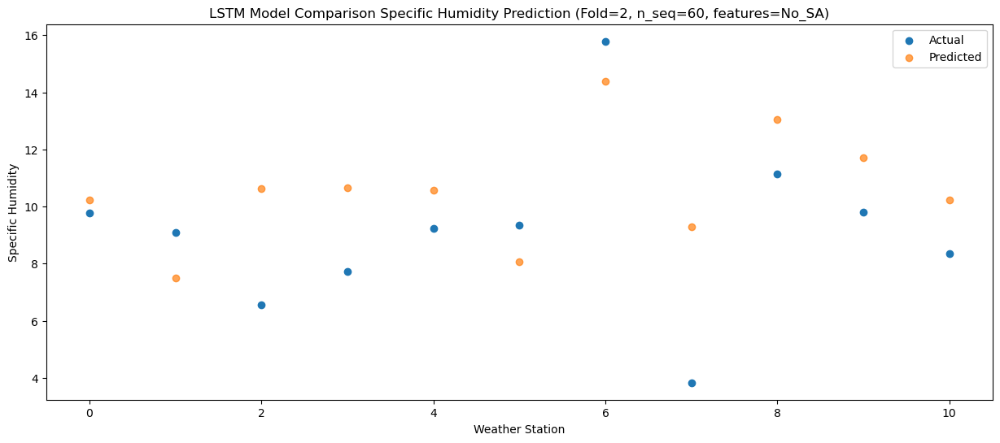

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   11.86  11.159393
1                 1   10.71   8.429393
2                 2    6.96  11.579393
3                 3   10.33  11.599393
4                 4   10.27  11.509393
5                 5    8.30   8.999393
6                 6   16.61  15.319393
7                 7    9.07  10.229393
8                 8   12.28  13.979393
9                 9   11.32  12.639393
10               10    9.77  11.159393


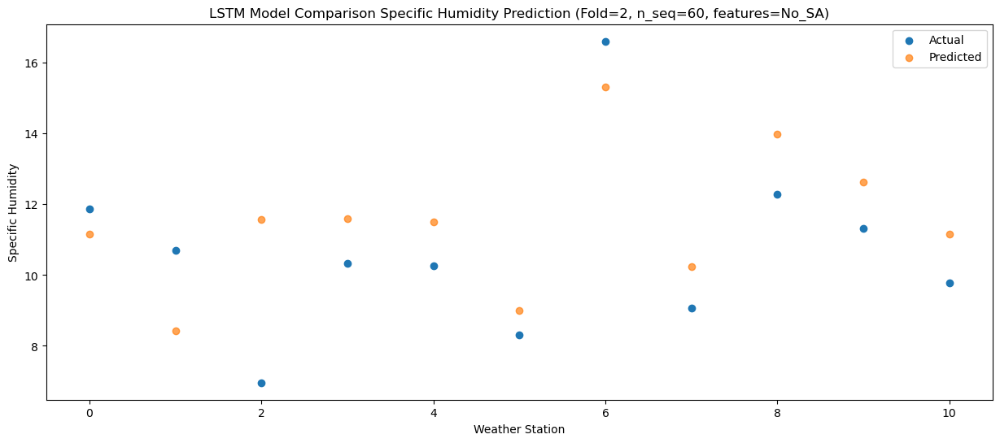

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   11.56  11.678253
1                 1    9.09   8.948253
2                 2    7.58  12.098253
3                 3   11.07  12.118253
4                 4    9.87  12.028253
5                 5    8.43   9.518253
6                 6   16.99  15.838253
7                 7    9.36  10.748253
8                 8   11.68  14.498253
9                 9   11.90  13.158253
10               10   10.16  11.678253


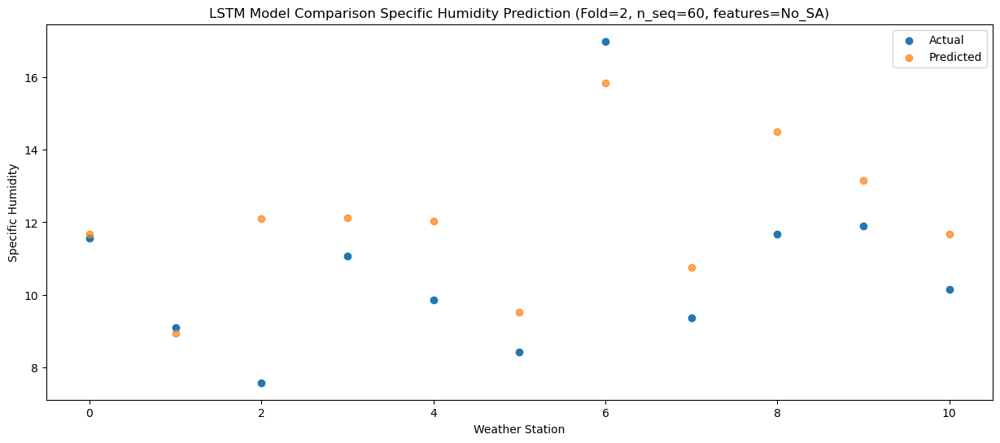

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    7.79   7.587473
1                 1    6.27   4.857473
2                 2    6.30   8.007473
3                 3    8.41   8.027473
4                 4    7.73   7.937473
5                 5    4.87   5.427473
6                 6   12.54  11.747473
7                 7    6.60   6.657473
8                 8   11.22  10.407473
9                 9    8.30   9.067473
10               10    6.95   7.587473


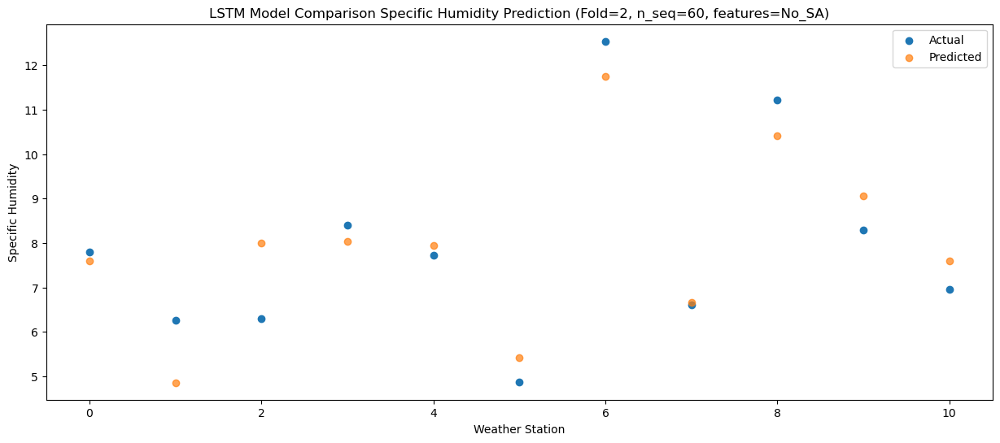

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    5.34   5.709636
1                 1    2.88   2.979636
2                 2    3.64   6.129636
3                 3    5.45   6.149636
4                 4    5.20   6.059636
5                 5    3.28   3.549636
6                 6    9.93   9.869636
7                 7    2.89   4.779636
8                 8    8.42   8.529636
9                 9    6.14   7.189636
10               10    5.22   5.709636


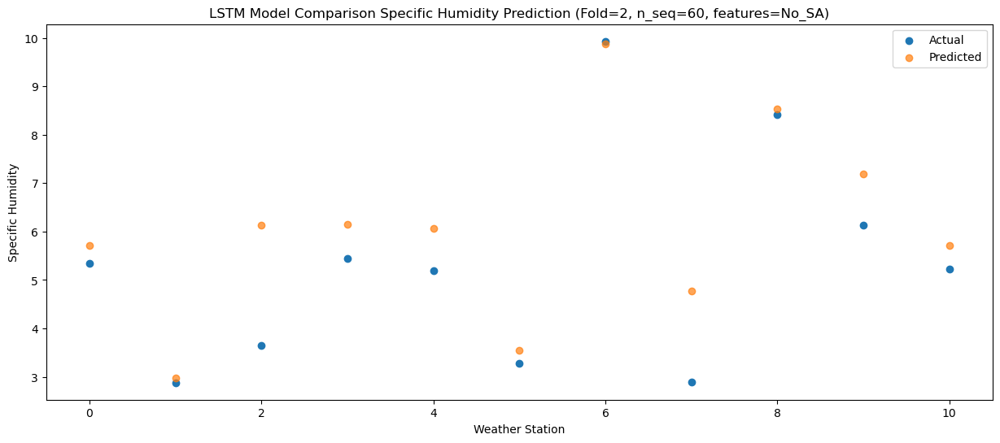

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    0.15   0.957545
1                 1    0.45  -1.772455
2                 2   -0.31   1.377545
3                 3    1.00   1.397545
4                 4   -0.46   1.307545
5                 5   -0.91  -1.202455
6                 6    5.94   5.117545
7                 7    1.24   0.027545
8                 8    7.88   3.777545
9                 9    0.58   2.437545
10               10   -0.14   0.957545


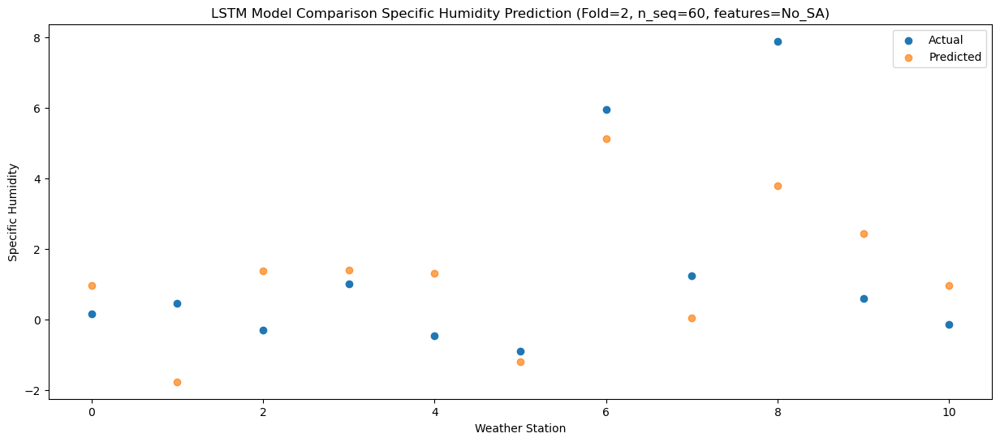

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    2.55    1.92037
1                 1   -0.61   -0.80963
2                 2    1.09    2.34037
3                 3    0.64    2.36037
4                 4    2.82    2.27037
5                 5    1.96   -0.23963
6                 6    8.44    6.08037
7                 7    1.37    0.99037
8                 8    7.70    4.74037
9                 9    2.43    3.40037
10               10    1.42    1.92037


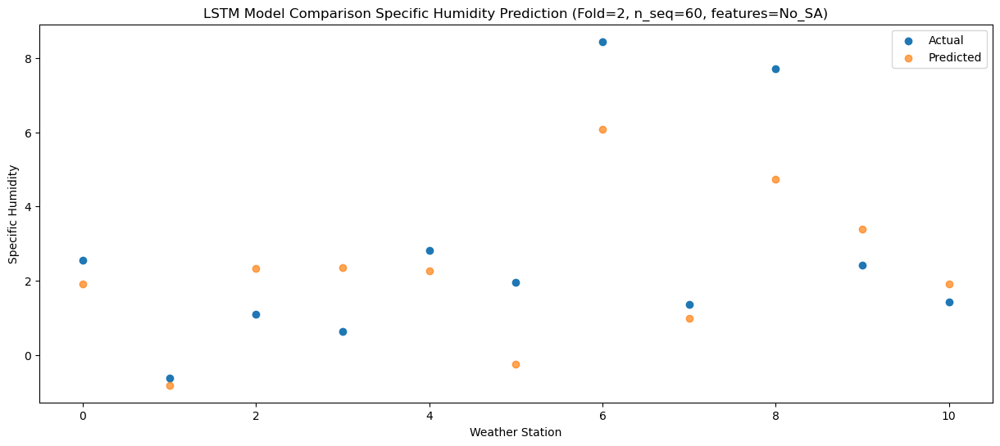

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -1.44  -0.494811
1                 1   -0.94  -3.224811
2                 2   -2.56  -0.074811
3                 3   -0.69  -0.054811
4                 4   -2.09  -0.144811
5                 5   -3.67  -2.654811
6                 6    3.15   3.665189
7                 7    1.09  -1.424811
8                 8    6.34   2.325189
9                 9   -0.35   0.985189
10               10   -1.00  -0.494811


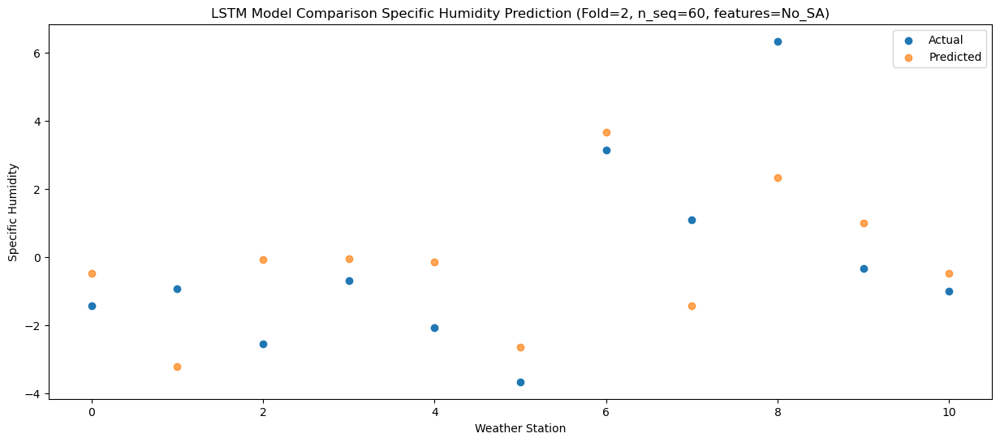

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -0.78  -0.099432
1                 1   -1.03  -2.829432
2                 2   -1.37   0.320568
3                 3   -0.12   0.340568
4                 4   -0.63   0.250568
5                 5   -3.45  -2.259432
6                 6    3.62   4.060568
7                 7    0.10  -1.029432
8                 8    5.60   2.720568
9                 9    0.96   1.380568
10               10   -0.10  -0.099432


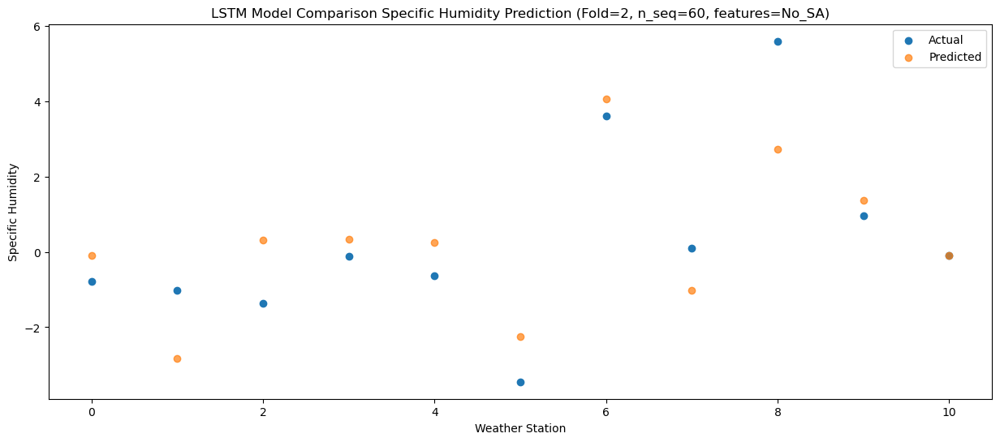

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    0.65   0.950467
1                 1   -0.15  -1.779533
2                 2    0.44   1.370467
3                 3    0.64   1.390467
4                 4    0.22   1.300467
5                 5   -1.83  -1.209533
6                 6    5.25   5.110467
7                 7    0.50   0.020467
8                 8    7.34   3.770467
9                 9    1.92   2.430467
10               10    0.52   0.950467


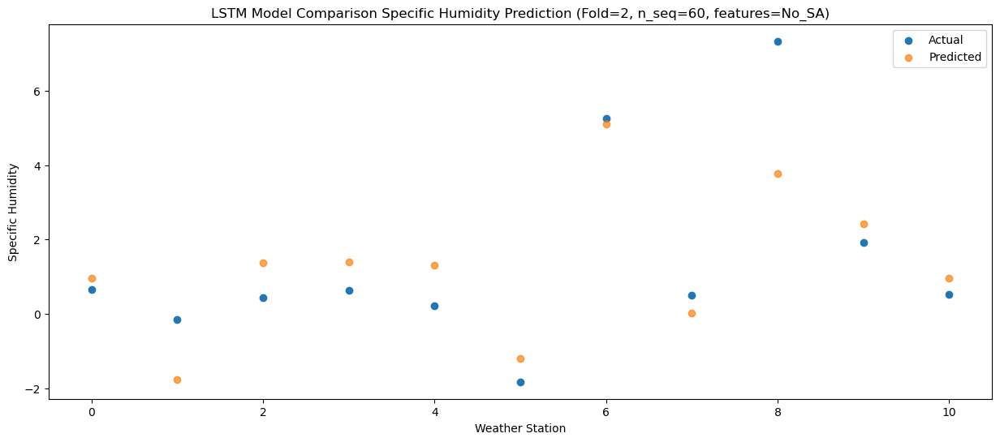

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    2.55   2.207646
1                 1    1.00  -0.522354
2                 2    1.80   2.627646
3                 3    1.34   2.647646
4                 4    2.65   2.557646
5                 5    2.13   0.047646
6                 6    9.15   6.367646
7                 7    0.51   1.277646
8                 8    8.18   5.027646
9                 9    2.96   3.687646
10               10    1.79   2.207646


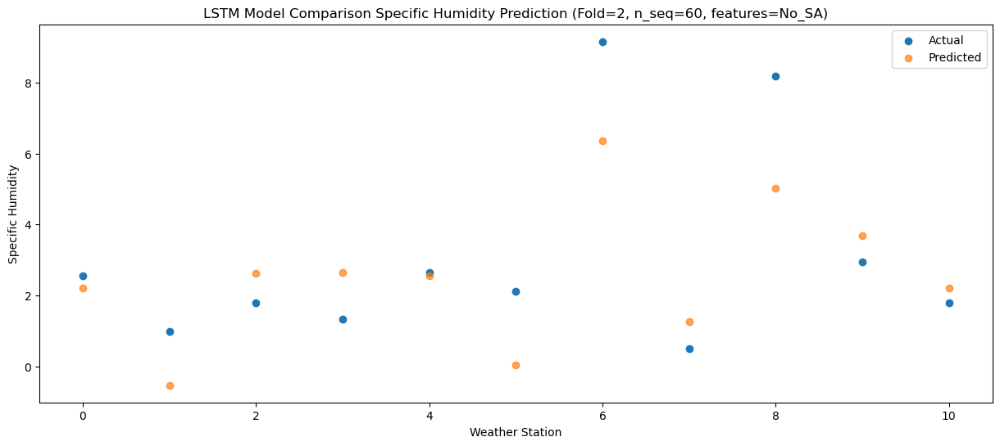

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    6.81   5.991269
1                 1    3.39   3.261269
2                 2    4.90   6.411269
3                 3    4.64   6.431269
4                 4    6.68   6.341269
5                 5    5.78   3.831269
6                 6   13.24  10.151269
7                 7    0.44   5.061269
8                 8    9.44   8.811269
9                 9    7.28   7.471269
10               10    5.95   5.991269


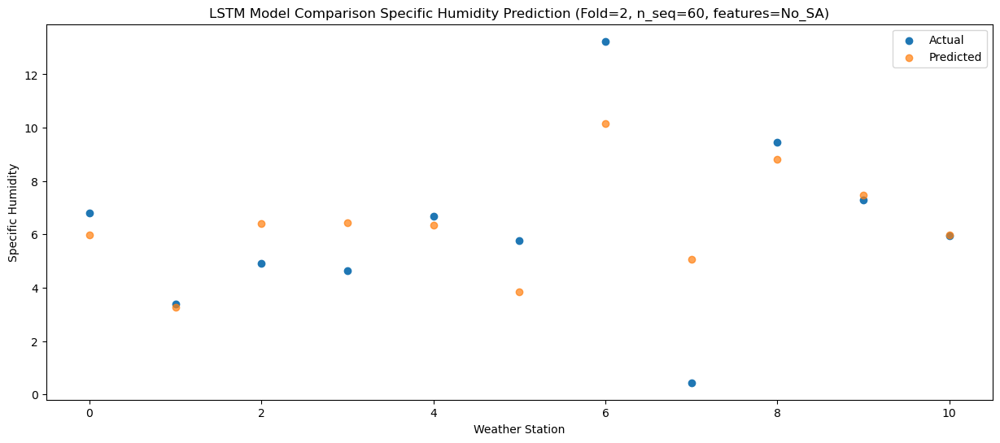

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0    8.86   8.183324
1                 1    7.75   5.453324
2                 2    6.83   8.603324
3                 3    6.90   8.623324
4                 4    8.98   8.533324
5                 5    6.81   6.023324
6                 6   14.04  12.343324
7                 7    5.94   7.253324
8                 8   11.21  11.003324
9                 9    9.08   9.663324
10               10    7.91   8.183324


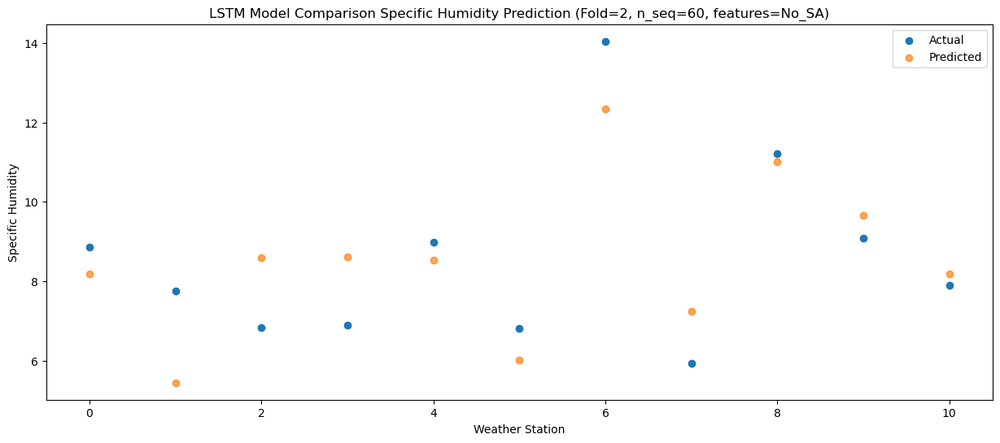

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   12.08  10.808279
1                 1    9.09   8.078279
2                 2    7.66  11.228279
3                 3   10.26  11.248279
4                 4   10.27  11.158279
5                 5    7.91   8.648279
6                 6   13.36  14.968279
7                 7    8.50   9.878279
8                 8   12.10  13.628279
9                 9   12.66  12.288279
10               10   11.12  10.808279


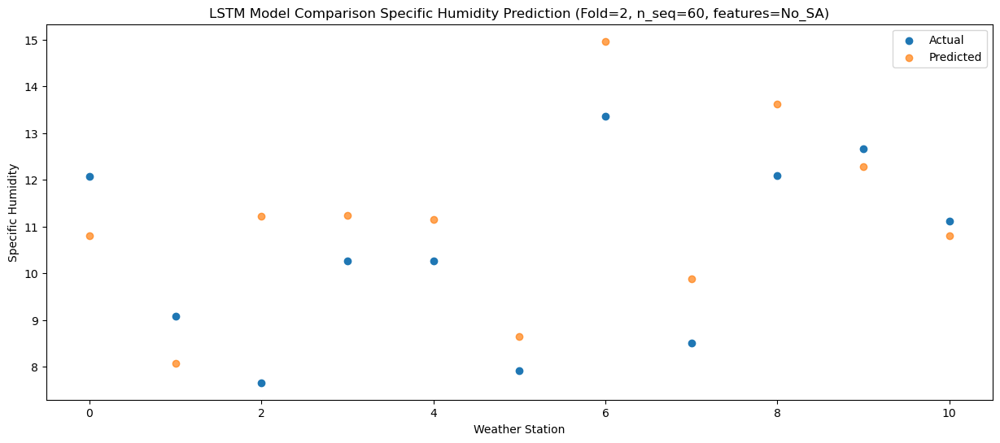

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   11.60   10.40496
1                 1    8.59    7.67496
2                 2    7.55   10.82496
3                 3   10.94   10.84496
4                 4   10.67   10.75496
5                 5    8.37    8.24496
6                 6   14.42   14.56496
7                 7   10.47    9.47496
8                 8   12.20   13.22496
9                 9   11.09   11.88496
10               10   10.13   10.40496


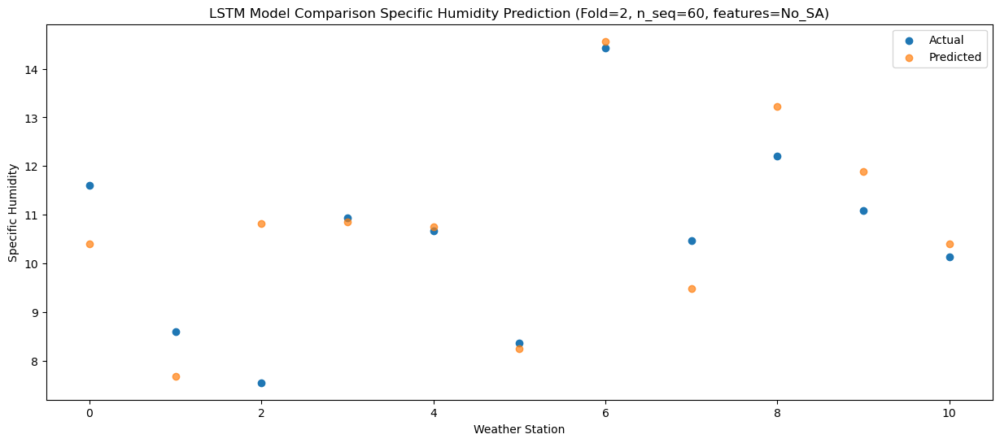

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    6.85   7.325186
1                 1    6.02   4.595186
2                 2    7.40   7.745186
3                 3    7.14   7.765186
4                 4    7.16   7.675186
5                 5    5.01   5.165186
6                 6   11.75  11.485186
7                 7    7.43   6.395186
8                 8   13.05  10.145186
9                 9    7.66   8.805186
10               10    6.65   7.325186


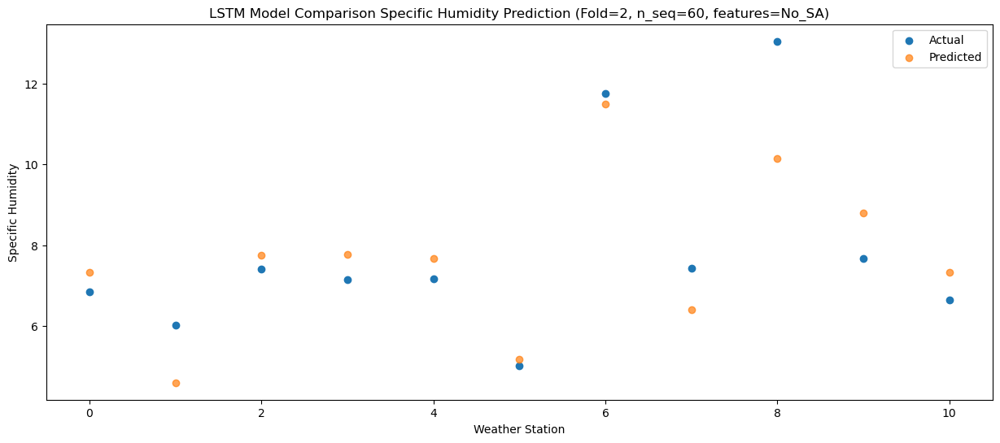

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    2.13   2.342797
1                 1    2.34  -0.387203
2                 2    3.01   2.762797
3                 3    4.27   2.782797
4                 4    1.98   2.692797
5                 5    0.19   0.182797
6                 6    6.97   6.502797
7                 7    5.35   1.412797
8                 8   11.28   5.162797
9                 9    3.30   3.822797
10               10    1.99   2.342797


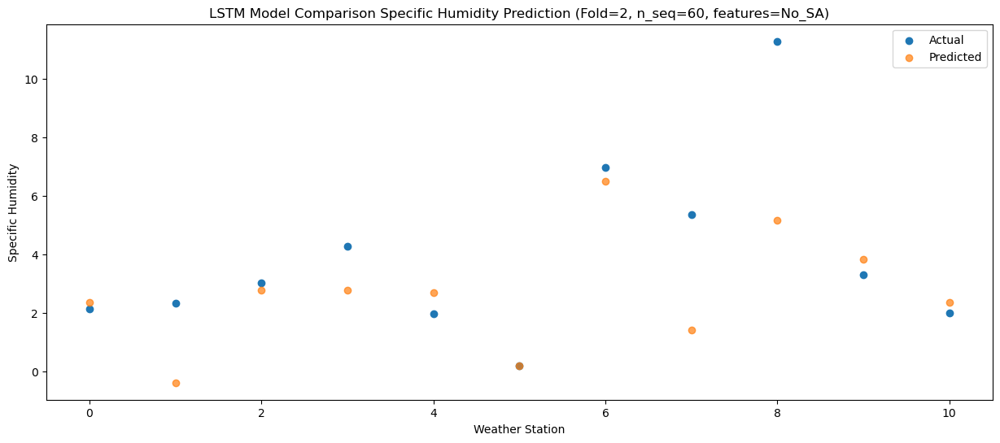

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    1.19   1.528306
1                 1    0.84  -1.201694
2                 2    2.90   1.948306
3                 3    2.45   1.968306
4                 4    1.54   1.878306
5                 5    0.05  -0.631694
6                 6    6.52   5.688306
7                 7    1.38   0.598306
8                 8    6.64   4.348306
9                 9    2.83   3.008306
10               10    1.37   1.528306


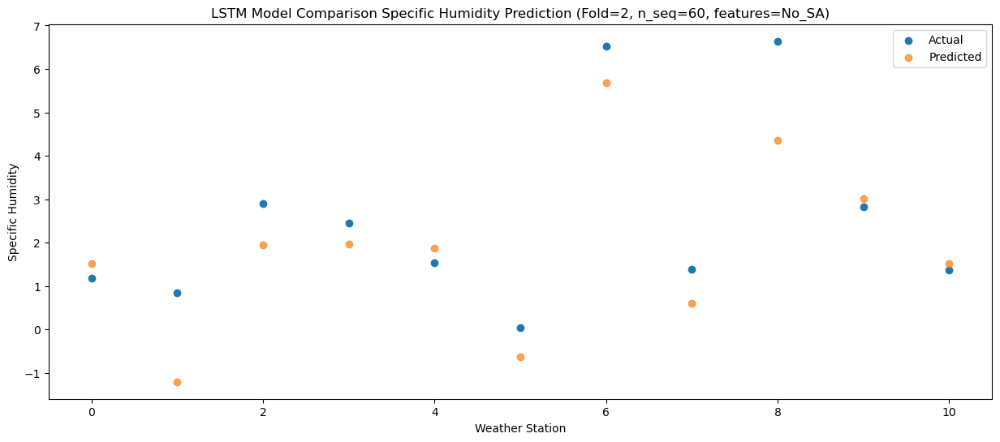

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0    0.56   0.273289
1                 1   -0.35  -2.456711
2                 2   -0.76   0.693289
3                 3    0.36   0.713289
4                 4    0.99   0.623289
5                 5   -0.86  -1.886711
6                 6    5.35   4.433289
7                 7    2.20  -0.656711
8                 8    7.49   3.093289
9                 9    0.59   1.753289
10               10    0.28   0.273289


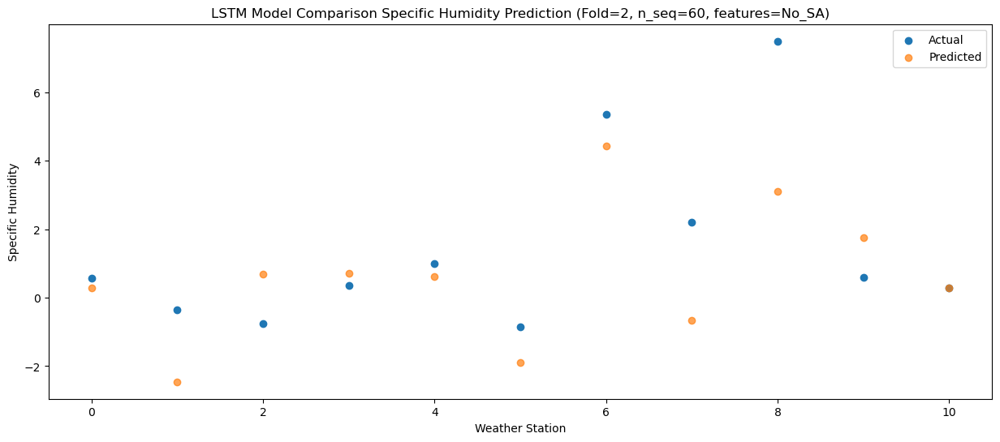

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    0.97   0.130019
1                 1   -0.36  -2.599981
2                 2   -1.14   0.550019
3                 3    0.87   0.570019
4                 4    0.90   0.480019
5                 5   -1.24  -2.029981
6                 6    4.57   4.290019
7                 7    1.31  -0.799981
8                 8    7.58   2.950019
9                 9    1.45   1.610019
10               10    0.55   0.130019


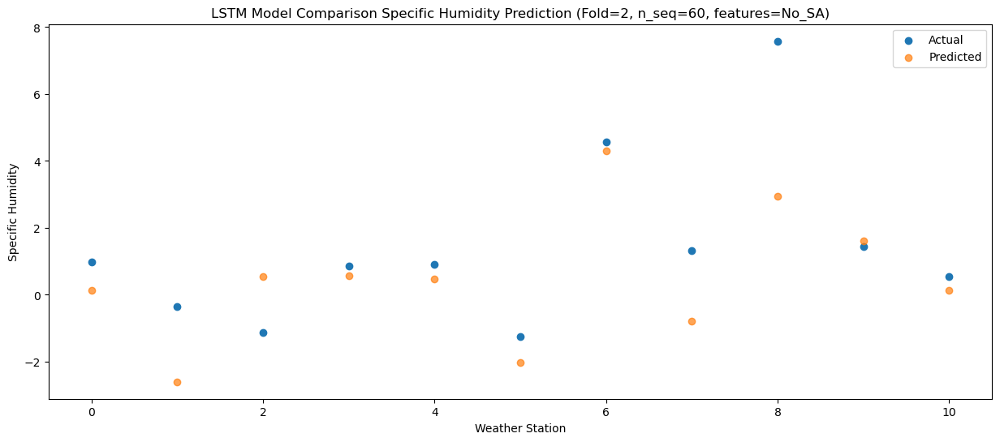

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    1.19   0.173788
1                 1   -0.44  -2.556212
2                 2    0.71   0.593788
3                 3    0.11   0.613788
4                 4    2.20   0.523788
5                 5   -0.79  -1.986212
6                 6    4.97   4.333788
7                 7    1.19  -0.756212
8                 8    6.17   2.993788
9                 9    2.21   1.653788
10               10    0.95   0.173788


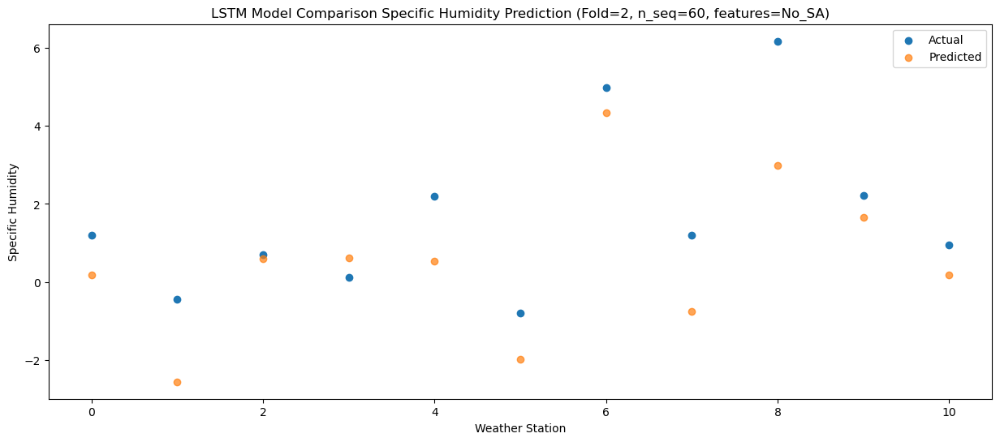

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    1.54   0.829363
1                 1    0.25  -1.900637
2                 2    1.10   1.249363
3                 3    0.36   1.269363
4                 4    3.08   1.179363
5                 5    0.99  -1.330637
6                 6    6.88   4.989363
7                 7    1.53  -0.100637
8                 8    8.09   3.649363
9                 9    1.90   2.309363
10               10    0.55   0.829363


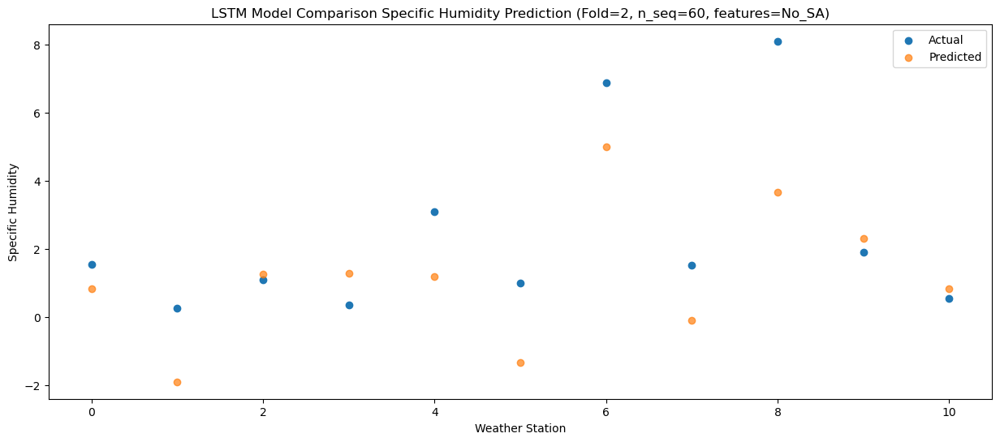

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    2.48   1.920016
1                 1    0.87  -0.809984
2                 2    2.61   2.340016
3                 3    2.44   2.360016
4                 4    3.63   2.270016
5                 5    1.54  -0.239984
6                 6    7.55   6.080016
7                 7    0.69   0.990016
8                 8    8.79   4.740016
9                 9    4.03   3.400016
10               10    2.19   1.920016


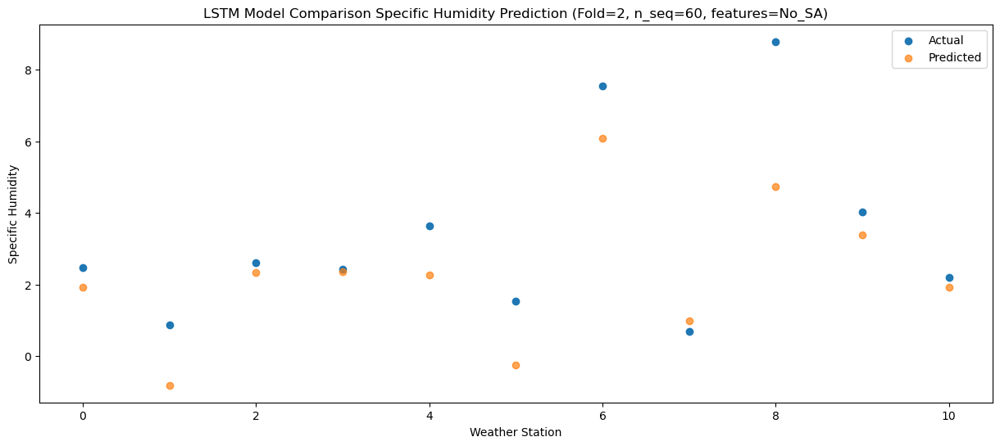

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    6.09   3.705595
1                 1    6.65   0.975595
2                 2    3.42   4.125595
3                 3    3.25   4.145595
4                 4    6.69   4.055595
5                 5    5.24   1.545595
6                 6   11.44   7.865595
7                 7    2.69   2.775595
8                 8   10.19   6.525595
9                 9    5.56   5.185595
10               10    4.78   3.705595


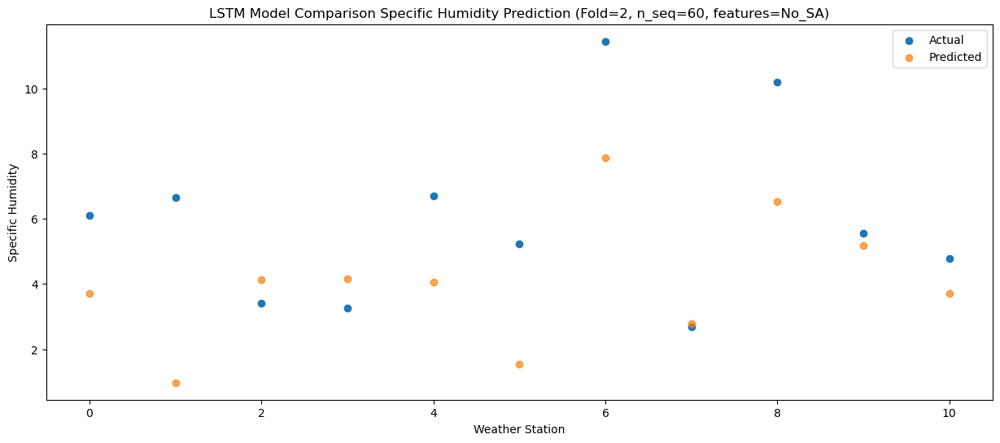

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0    9.06   6.422058
1                 1    9.30   3.692058
2                 2    6.58   6.842058
3                 3    7.15   6.862058
4                 4   10.00   6.772058
5                 5    8.70   4.262058
6                 6   15.34  10.582058
7                 7    2.49   5.492058
8                 8   10.57   9.242058
9                 9    8.42   7.902058
10               10    6.62   6.422058


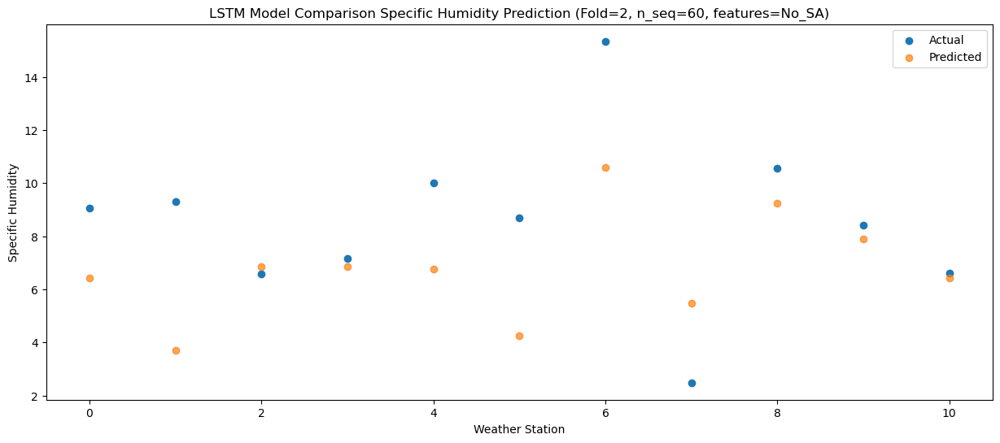

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   12.24  10.069223
1                 1   11.36   7.339223
2                 2    7.55  10.489223
3                 3   11.41  10.509223
4                 4   11.34  10.419223
5                 5    8.41   7.909223
6                 6   14.63  14.229223
7                 7    5.84   9.139223
8                 8   11.91  12.889223
9                 9   12.26  11.549223
10               10    9.93  10.069223


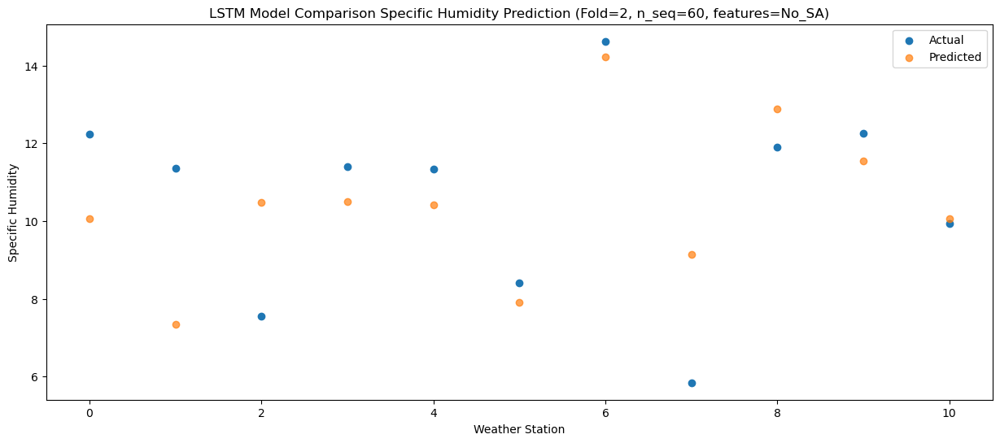

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   11.59   9.627984
1                 1    9.47   6.897984
2                 2    8.27  10.047984
3                 3    9.07  10.067984
4                 4   11.37   9.977984
5                 5    6.98   7.467984
6                 6   12.58  13.787984
7                 7    8.03   8.697984
8                 8   12.52  12.447984
9                 9   11.77  11.107984
10               10   10.04   9.627984


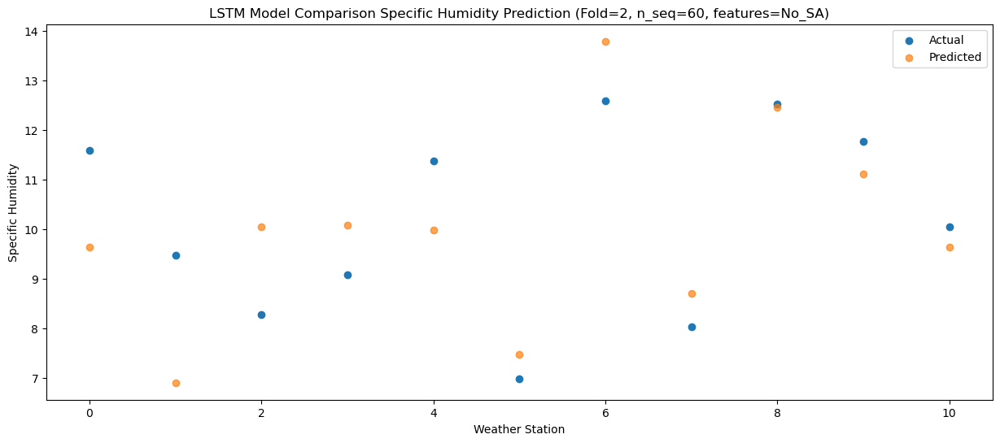

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    7.56   6.298946
1                 1    6.88   3.568946
2                 2    5.88   6.718946
3                 3    8.06   6.738946
4                 4    9.02   6.648946
5                 5    6.43   4.138946
6                 6   11.95  10.458946
7                 7    6.22   5.368946
8                 8   12.27   9.118946
9                 9    8.63   7.778946
10               10    7.62   6.298946


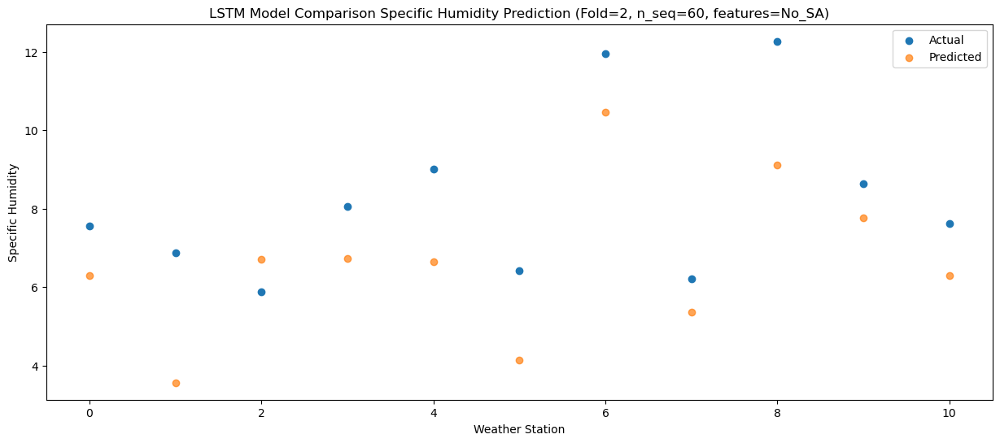

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    3.46   2.849869
1                 1    3.42   0.119869
2                 2    2.96   3.269869
3                 3    4.70   3.289869
4                 4    3.79   3.199869
5                 5    2.90   0.689869
6                 6    8.80   7.009869
7                 7    3.77   1.919869
8                 8    9.97   5.669869
9                 9    4.44   4.329869
10               10    3.51   2.849869


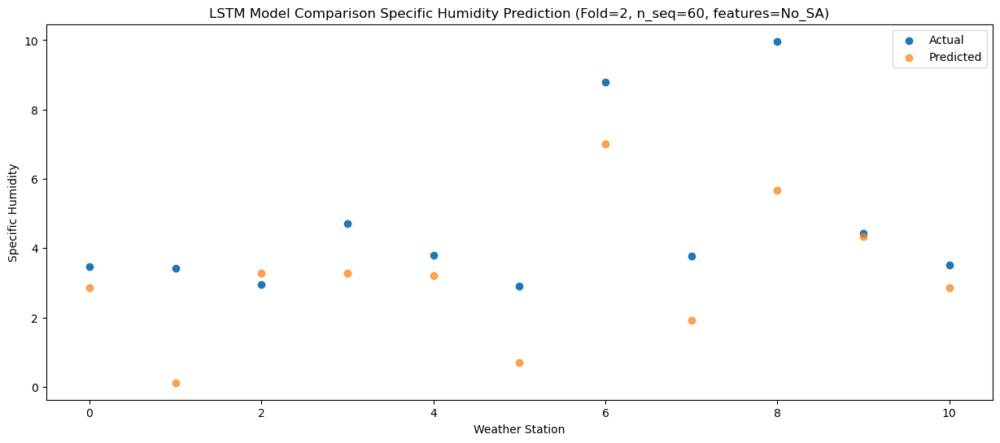

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    0.82   0.051626
1                 1    0.86  -2.678374
2                 2    0.46   0.471626
3                 3    0.87   0.491626
4                 4    1.27   0.401626
5                 5   -0.27  -2.108374
6                 6    6.18   4.211626
7                 7    2.85  -0.878374
8                 8    6.94   2.871626
9                 9    1.33   1.531626
10               10    0.56   0.051626


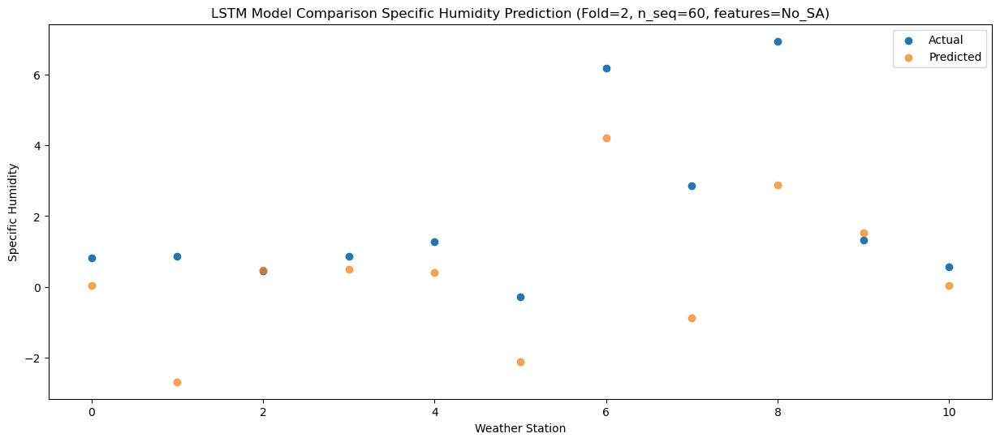

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -0.10  -0.027134
1                 1    0.47  -2.757134
2                 2   -0.11   0.392866
3                 3    1.16   0.412866
4                 4   -0.32   0.322866
5                 5   -2.20  -2.187134
6                 6    4.36   4.132866
7                 7    1.33  -0.957134
8                 8    7.73   2.792866
9                 9    1.24   1.452866
10               10    0.35  -0.027134


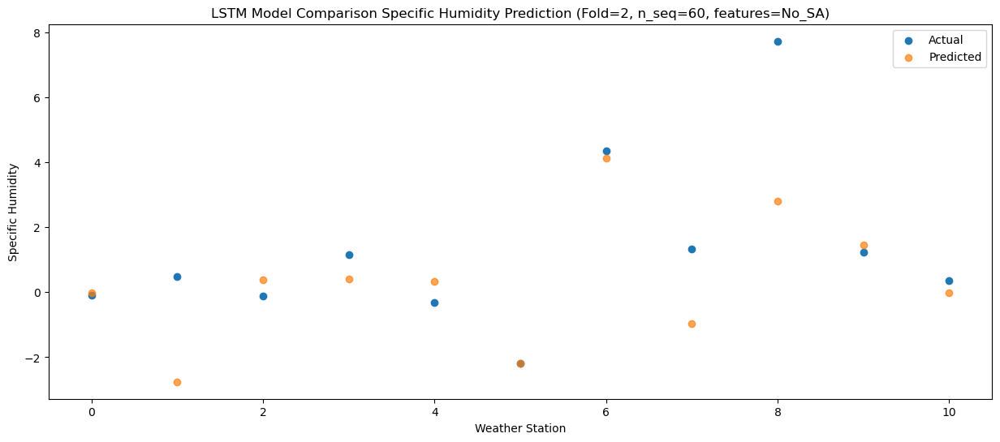

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -0.99  -0.829276
1                 1   -0.12  -3.559276
2                 2   -1.18  -0.409276
3                 3   -0.17  -0.389276
4                 4   -1.19  -0.479276
5                 5   -3.21  -2.989276
6                 6    3.24   3.330724
7                 7    1.75  -1.759276
8                 8    7.70   1.990724
9                 9    0.55   0.650724
10               10   -0.27  -0.829276


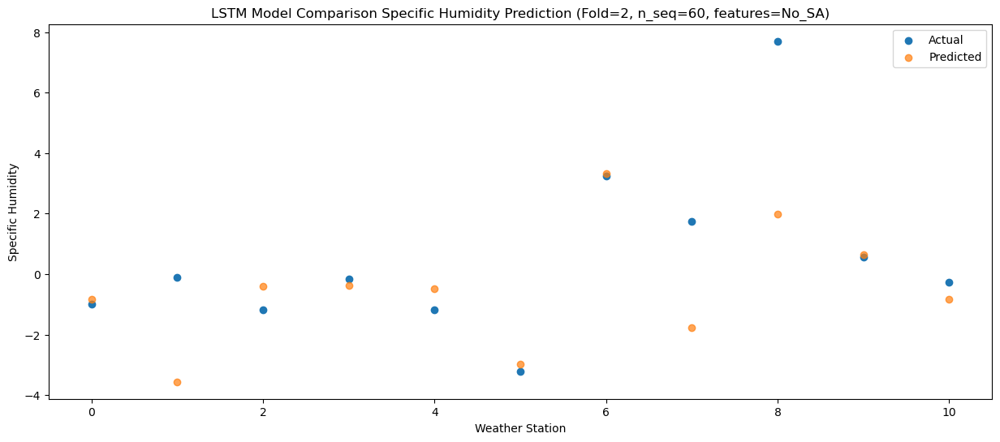

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    0.88   0.235514
1                 1    0.70  -2.494486
2                 2   -1.60   0.655514
3                 3   -0.22   0.675514
4                 4   -0.13   0.585514
5                 5   -0.81  -1.924486
6                 6    5.71   4.395514
7                 7    1.77  -0.694486
8                 8    8.67   3.055514
9                 9    0.69   1.715514
10               10    0.13   0.235514


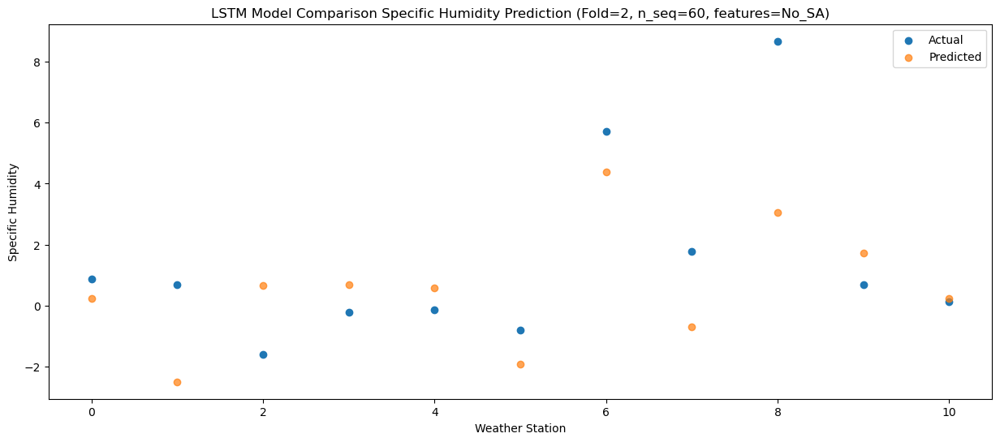

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    1.70   1.019983
1                 1    0.95  -1.710017
2                 2    1.56   1.439983
3                 3    0.83   1.459983
4                 4    1.47   1.369983
5                 5    0.83  -1.140017
6                 6    7.33   5.179983
7                 7    1.99   0.089983
8                 8    7.11   3.839983
9                 9    2.10   2.499983
10               10    1.23   1.019983


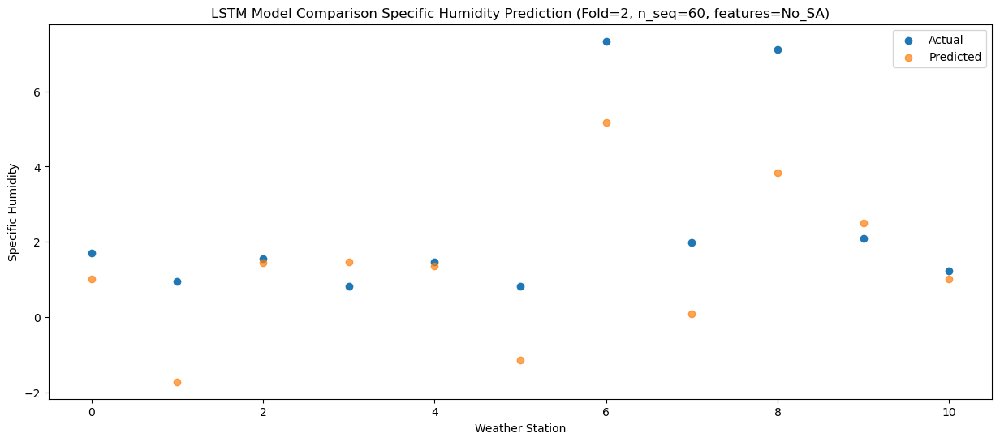

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    3.91   2.824737
1                 1    1.91   0.094737
2                 2    0.35   3.244737
3                 3    1.72   3.264737
4                 4    3.54   3.174737
5                 5    3.11   0.664737
6                 6    9.53   6.984737
7                 7    1.32   1.894737
8                 8    6.21   5.644737
9                 9    4.32   4.304737
10               10    3.34   2.824737


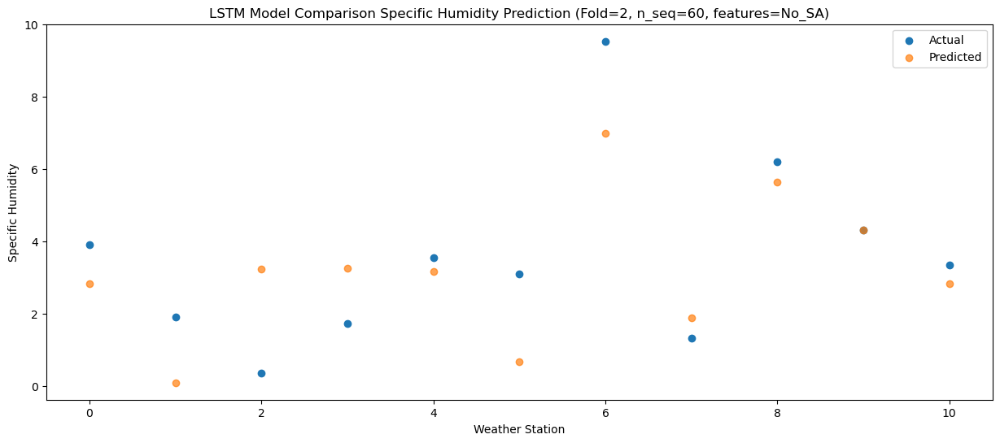

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    8.17   6.174838
1                 1    4.94   3.444838
2                 2    5.21   6.594838
3                 3    4.90   6.614838
4                 4    7.97   6.524838
5                 5    7.21   4.014838
6                 6   13.31  10.334838
7                 7    1.01   5.244838
8                 8   10.31   8.994838
9                 9    8.20   7.654838
10               10    7.20   6.174838


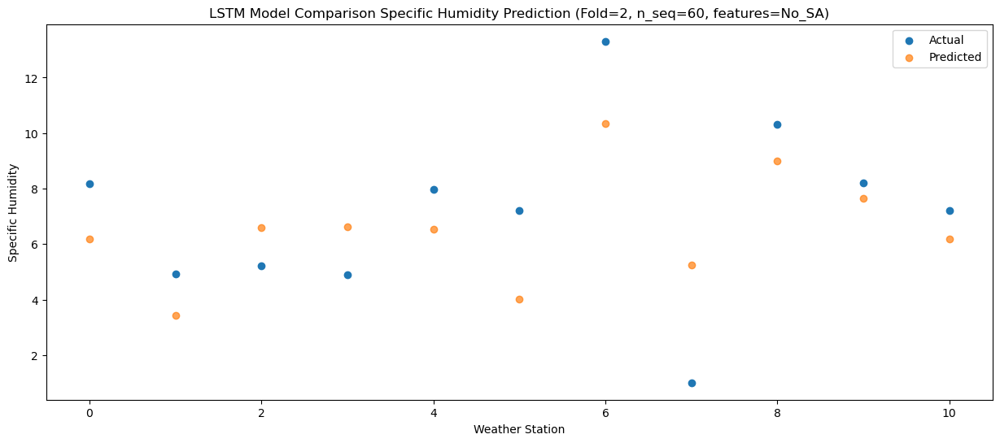

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   10.14   7.993496
1                 1   10.95   5.263496
2                 2    7.27   8.413496
3                 3    7.82   8.433496
4                 4    9.94   8.343496
5                 5    8.87   5.833496
6                 6   14.90  12.153496
7                 7    5.06   7.063496
8                 8   11.91  10.813496
9                 9   10.07   9.473496
10               10    8.75   7.993496


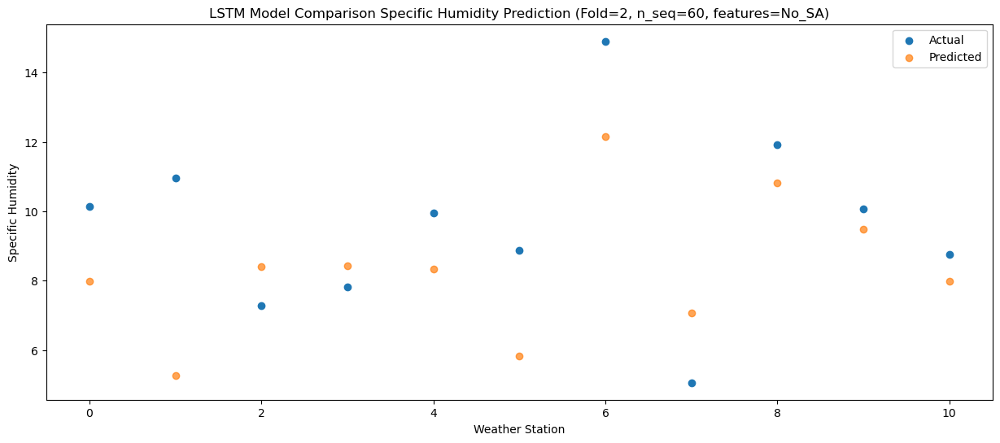

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   11.61   8.746916
1                 1    9.50   6.016916
2                 2    8.32   9.166916
3                 3   10.99   9.186916
4                 4   11.58   9.096916
5                 5    9.17   6.586916
6                 6   15.13  12.906916
7                 7    8.66   7.816916
8                 8   13.14  11.566916
9                 9   12.68  10.226916
10               10   10.79   8.746916


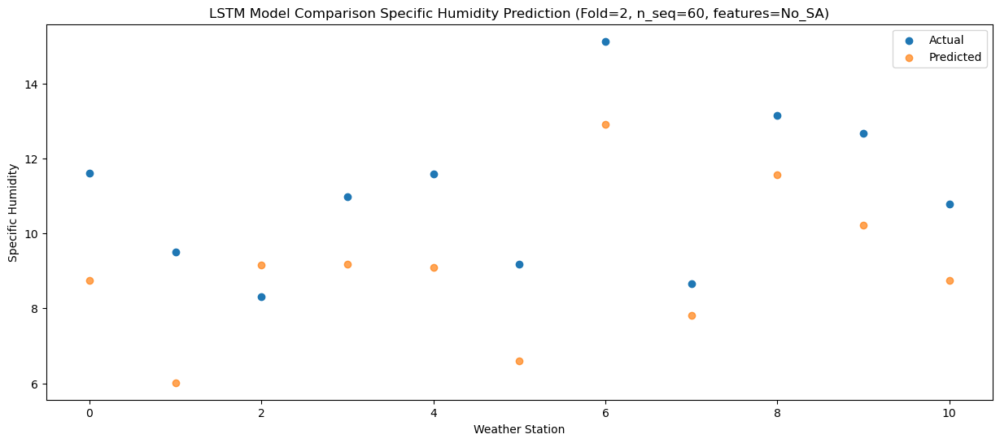

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0    9.61   9.145351
1                 1   10.48   6.415351
2                 2    8.92   9.565351
3                 3    9.49   9.585351
4                 4   10.41   9.495351
5                 5    9.21   6.985351
6                 6   14.95  13.305351
7                 7    8.34   8.215351
8                 8   12.32  11.965351
9                 9   11.42  10.625351
10               10    9.78   9.145351


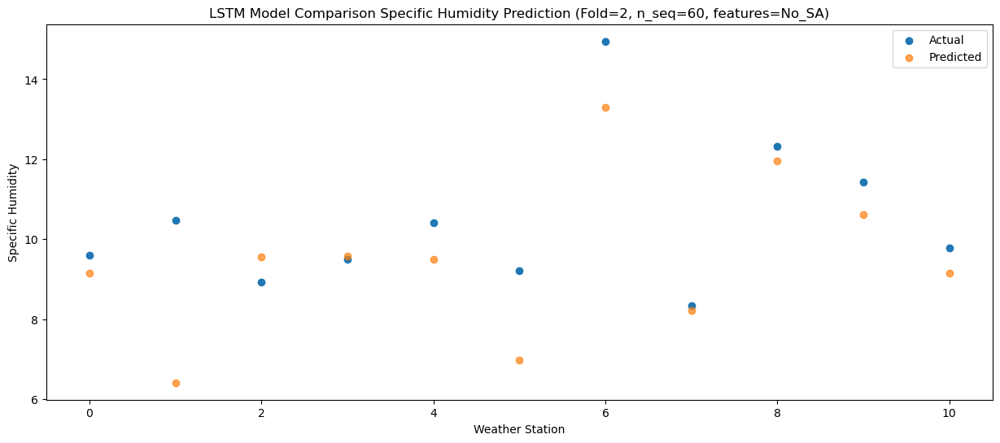

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    7.99   6.594069
1                 1    6.53   3.864069
2                 2    9.35   7.014069
3                 3    6.60   7.034069
4                 4    8.81   6.944069
5                 5    6.72   4.434069
6                 6   12.05  10.754069
7                 7    5.60   5.664069
8                 8   11.93   9.414069
9                 9    9.57   8.074069
10               10    7.68   6.594069


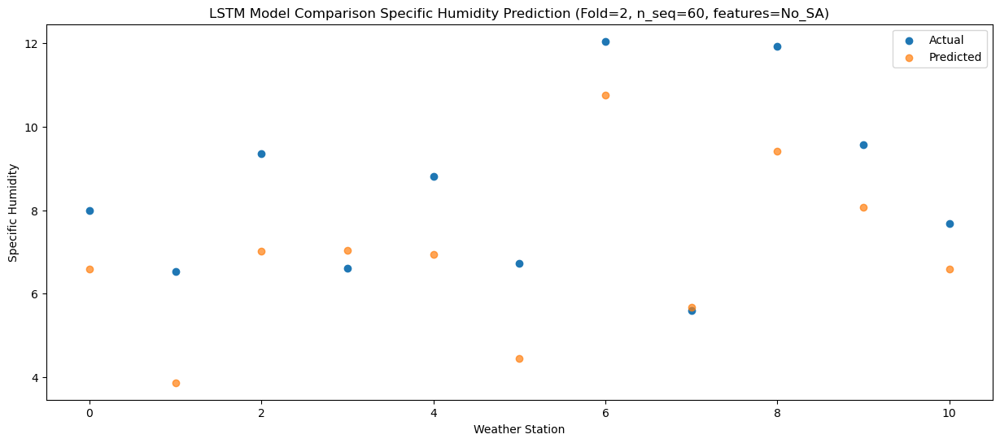

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    3.61      2.385
1                 1    3.67     -0.345
2                 2    4.37      2.805
3                 3    3.36      2.825
4                 4    3.95      2.735
5                 5    2.40      0.225
6                 6    8.63      6.545
7                 7    2.71      1.455
8                 8   10.03      5.205
9                 9    4.95      3.865
10               10    3.61      2.385


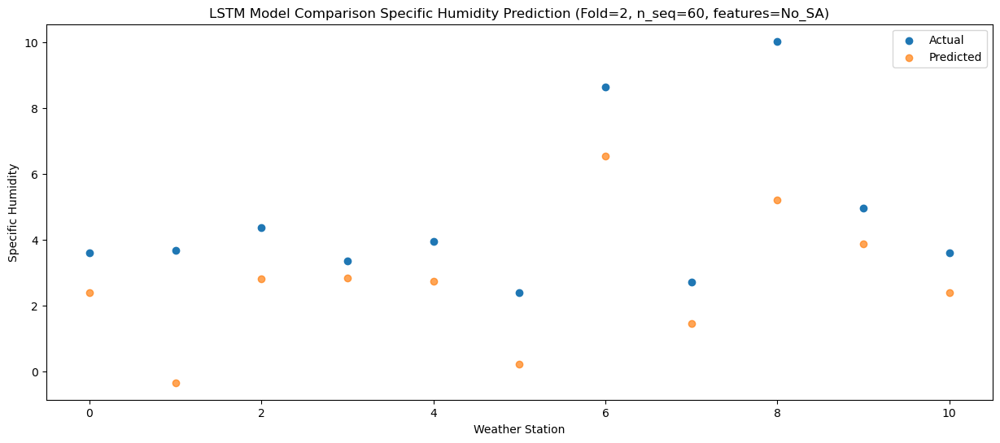

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_4 (LSTM)               (1, 1, 256)               2121728   
                                                                 
 dropout_4 (Dropout)         (1, 1, 256)               0         
                                                                 
 lstm_5 (LSTM)               (1, 256)                  525312    
                                                                 
 dropout_5 (Dropout)         (1, 256)                  0         
                                                                 
 dense_6 (Dense)             (1, 256)                  65792     
                                                                 
 dense_7 (Dense)             (1, 128)                  32896     
                                                                 
 dense_8 (Dense)             (1, 60)                  

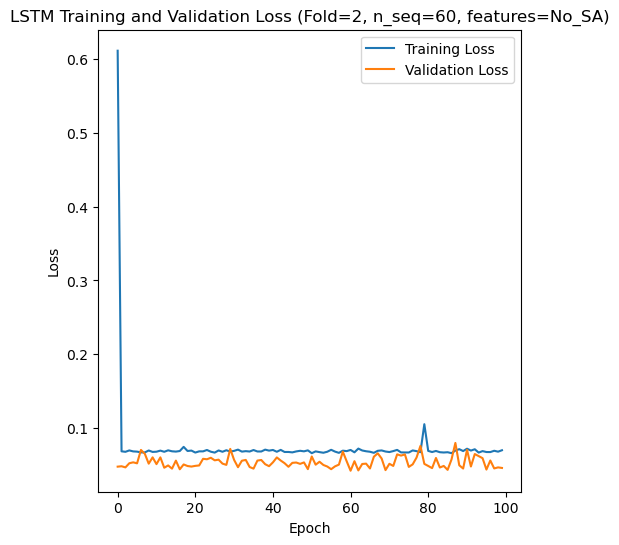

Epoch 1/100
84/84 [==============================] - 6s 25ms/step - loss: 0.7169 - accuracy: 0.2976 - mae: 0.6247 - rmse: 0.7169 - mape: 139.4258 - pearson: 0.5876 - val_loss: 0.0647 - val_accuracy: 0.6000 - val_mae: 0.0513 - val_rmse: 0.0647 - val_mape: 11.0278 - val_pearson: 0.7273
Epoch 2/100
84/84 [==============================] - 1s 10ms/step - loss: 0.0654 - accuracy: 0.4286 - mae: 0.0511 - rmse: 0.0654 - mape: 11.7115 - pearson: 0.7928 - val_loss: 0.0758 - val_accuracy: 0.6000 - val_mae: 0.0576 - val_rmse: 0.0758 - val_mape: 12.0784 - val_pearson: 0.6857
Epoch 3/100
84/84 [==============================] - 1s 10ms/step - loss: 0.0675 - accuracy: 0.3929 - mae: 0.0532 - rmse: 0.0675 - mape: 12.1993 - pearson: 0.7838 - val_loss: 0.0730 - val_accuracy: 0.0000e+00 - val_mae: 0.0597 - val_rmse: 0.0730 - val_mape: 12.9442 - val_pearson: 0.6860
Epoch 4/100
84/84 [==============================] - 1s 10ms/step - loss: 0.0659 - accuracy: 0.4286 - mae: 0.0523 - rmse: 0.0659 - mape: 11.886

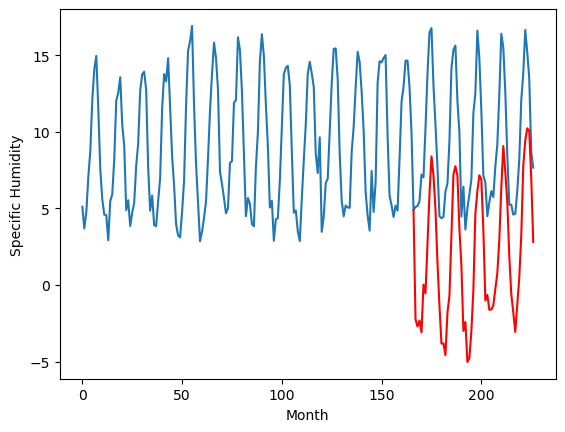

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.14		-1.19		-1.05
-0.55		-1.67		-1.12
-0.58		-1.27		-0.69
-0.94		-2.05		-1.11
1.66		1.07		-0.59
1.81		0.50		-1.31
4.78		3.73		-1.05
8.31		6.98		-1.33
11.05		9.44		-1.61
8.38		8.22		-0.16
6.94		5.98		-0.96
2.37		2.52		0.15
0.87		-0.31		-1.18
-1.17		-2.78		-1.61
-1.26		-2.77		-1.51
-1.82		-3.53		-1.71
0.69		-0.78		-1.47
1.86		0.34		-1.52
5.38		4.30		-1.08
9.91		8.26		-1.65
10.79		8.80		-1.99
10.96		8.18		-2.78
6.99		4.72		-2.27
4.80		2.29		-2.51
0.37		-1.95		-2.32
1.34		-1.37		-2.71
-1.85		-3.98		-2.13
-1.48		-3.73		-2.25
-0.01		-1.97		-1.96
2.29		0.72		-1.57
6.74		5.69		-1.05
9.36		7.17		-2.19
9.57		8.20		-1.37
10.18		7.93		-2.25
6.33		4.65		-1.68
1.87		0.03		-1.84
0.84		0.39		-0.45
-0.35		-0.58		-0.23
-0.43		-0.55		-0.12
-0.27		-0.29		-0.02
0.67		0.78		0.11
1.54		1.81		0.27
5.95		4.01		-1.94
8.59		7.42		-1.17
10.86		10.11		-0.75
11.10		8.43		-2.67
7.03		6.46		-0.57
3.59		2.92		-0.67
0.71		0

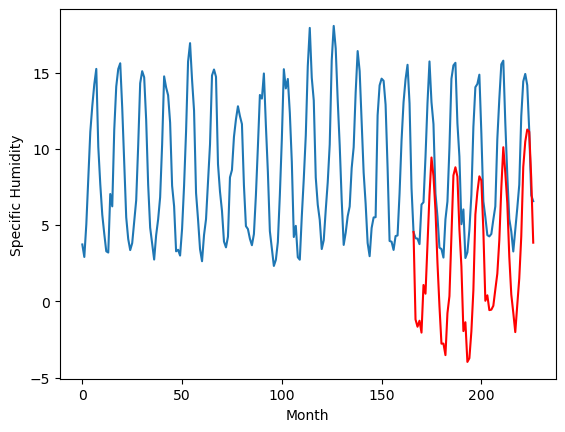

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
5.99		2.01		-3.98
6.53		1.53		-5.00
6.15		1.93		-4.22
5.46		1.15		-4.31
6.54		4.27		-2.27
7.91		3.70		-4.21
7.72		6.93		-0.79
9.26		10.18		0.92
9.48		12.64		3.16
11.00		11.42		0.42
10.52		9.18		-1.34
8.64		5.72		-2.92
5.95		2.89		-3.06
5.35		0.42		-4.93
5.79		0.43		-5.36
5.73		-0.33		-6.06
5.81		2.42		-3.39
6.43		3.54		-2.89
6.83		7.50		0.67
9.28		11.46		2.18
9.98		12.00		2.02
9.51		11.38		1.87
8.22		7.92		-0.30
7.08		5.49		-1.59
7.66		1.25		-6.41
6.16		1.83		-4.33
5.88		-0.78		-6.66
5.10		-0.53		-5.63
6.44		1.23		-5.21
6.11		3.92		-2.19
6.29		8.89		2.60
7.46		10.37		2.91
8.63		11.40		2.77
9.42		11.13		1.71
9.13		7.85		-1.28
7.96		3.23		-4.73
5.24		3.59		-1.65
6.08		2.62		-3.46
6.23		2.65		-3.58
5.10		2.91		-2.19
6.62		3.98		-2.64
6.82		5.01		-1.81
7.76		7.21		-0.55
8.53		10.62		2.09
9.63		13.31		3.68
10.70		11.63		0.93
9.16		9.66		0.50
8.00		6.12		-1.88
5.89		3.65		-2.24
6.12		2.46		-3.66
6.

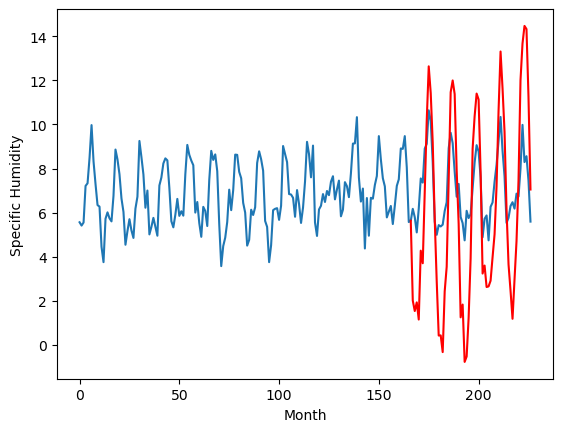

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.83		-0.21		0.62
-0.30		-0.69		-0.39
-0.70		-0.29		0.41
-0.88		-1.07		-0.19
0.98		2.05		1.07
0.90		1.48		0.58
4.33		4.71		0.38
7.57		7.96		0.39
10.67		10.42		-0.25
9.59		9.20		-0.39
7.02		6.96		-0.06
3.33		3.50		0.17
0.44		0.67		0.23
-1.17		-1.80		-0.63
-1.44		-1.79		-0.35
-1.51		-2.55		-1.04
-0.21		0.20		0.41
0.98		1.32		0.34
3.51		5.28		1.77
8.93		9.24		0.31
9.56		9.78		0.22
10.44		9.16		-1.28
6.97		5.70		-1.27
4.91		3.27		-1.64
-0.78		-0.97		-0.19
0.36		-0.39		-0.75
-1.96		-3.00		-1.04
-1.44		-2.75		-1.31
-0.46		-0.99		-0.53
0.81		1.70		0.89
5.23		6.67		1.44
7.49		8.15		0.66
10.53		9.18		-1.35
9.40		8.91		-0.49
6.15		5.63		-0.52
1.00		1.01		0.01
0.19		1.37		1.18
-0.84		0.40		1.24
-0.30		0.43		0.73
-0.48		0.69		1.17
-0.61		1.76		2.37
0.93		2.79		1.86
3.84		4.99		1.15
5.86		8.40		2.54
9.51		11.09		1.58
8.96		9.41		0.45
6.49		7.44		0.95
2.96		3.90		0.94
-0.43		1.43		1.86
-0.41		0.24		0.65
-

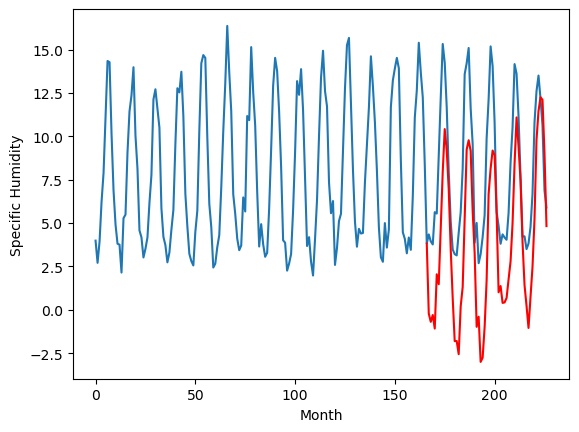

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
3.61		1.19		-2.42
2.11		0.71		-1.40
-0.18		1.11		1.29
-0.94		0.33		1.27
1.13		3.45		2.32
1.45		2.88		1.43
5.15		6.11		0.96
8.24		9.36		1.12
12.19		11.82		-0.37
9.81		10.60		0.79
6.85		8.36		1.51
2.13		4.90		2.77
1.03		2.07		1.04
-0.90		-0.40		0.50
-1.10		-0.39		0.71
-1.93		-1.15		0.78
0.55		1.60		1.05
1.61		2.72		1.11
4.03		6.68		2.65
8.49		10.64		2.15
10.44		11.18		0.74
10.53		10.56		0.03
6.76		7.10		0.34
4.81		4.67		-0.14
-0.31		0.43		0.74
0.39		1.01		0.62
-2.07		-1.60		0.47
-1.45		-1.35		0.10
0.12		0.41		0.29
1.68		3.10		1.42
5.77		8.07		2.30
7.87		9.55		1.68
10.46		10.58		0.12
9.96		10.31		0.35
6.86		7.03		0.17
1.86		2.41		0.55
0.47		2.77		2.30
-0.65		1.80		2.45
-0.27		1.83		2.10
0.61		2.09		1.48
0.28		3.16		2.88
1.51		4.19		2.68
4.69		6.39		1.70
6.82		9.80		2.98
10.59		12.49		1.90
10.98		10.81		-0.17
6.87		8.84		1.97
3.25		5.30		2.05
0.08		2.83		2.75
-0.33		1.64		1.97
-1.20		0.36		1.56
-

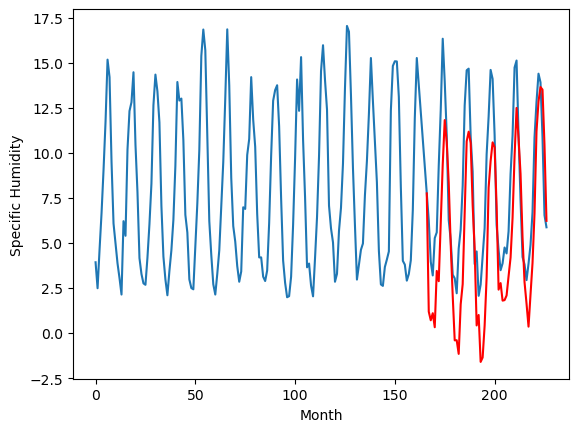

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.24		-0.19		-0.43
0.53		-0.67		-1.20
0.03		-0.27		-0.30
-0.22		-1.05		-0.83
1.77		2.07		0.30
1.89		1.50		-0.39
5.10		4.73		-0.37
7.83		7.98		0.15
10.99		10.44		-0.55
9.77		9.22		-0.55
6.59		6.98		0.39
3.17		3.52		0.35
1.40		0.69		-0.71
-0.26		-1.78		-1.52
-0.57		-1.77		-1.20
-1.09		-2.53		-1.44
0.94		0.22		-0.72
2.24		1.34		-0.90
4.48		5.30		0.82
9.70		9.26		-0.44
10.95		9.80		-1.15
11.12		9.18		-1.94
7.82		5.72		-2.10
6.20		3.29		-2.91
0.33		-0.95		-1.28
1.38		-0.37		-1.75
-1.13		-2.98		-1.85
-0.60		-2.73		-2.13
0.71		-0.97		-1.68
2.24		1.72		-0.52
6.47		6.69		0.22
8.54		8.17		-0.37
11.32		9.20		-2.12
10.12		8.93		-1.19
7.35		5.65		-1.70
2.05		1.03		-1.02
0.83		1.39		0.56
0.07		0.42		0.35
0.65		0.45		-0.20
0.32		0.71		0.39
0.75		1.78		1.03
2.06		2.81		0.75
4.66		5.01		0.35
6.82		8.42		1.60
11.33		11.11		-0.22
10.45		9.43		-1.02
7.22		7.46		0.24
3.84		3.92		0.08
0.65		1.45		0.80
0.61		0.26		

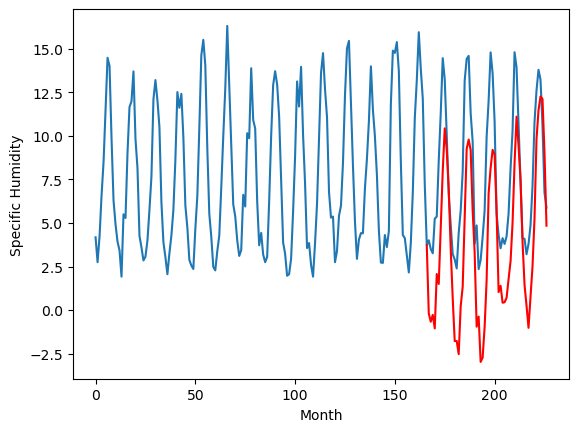

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
6.16		1.64		-4.52
5.79		1.16		-4.63
5.75		1.56		-4.19
5.71		0.78		-4.93
6.34		3.90		-2.44
6.69		3.33		-3.36
7.82		6.56		-1.26
8.88		9.81		0.93
10.40		12.27		1.87
9.19		11.05		1.86
8.05		8.81		0.76
6.40		5.35		-1.05
6.34		2.52		-3.82
5.53		0.05		-5.48
5.70		0.06		-5.64
5.76		-0.70		-6.46
6.07		2.05		-4.02
6.54		3.17		-3.37
7.94		7.13		-0.81
9.27		11.09		1.82
11.72		11.63		-0.09
10.29		11.01		0.72
8.59		7.55		-1.04
7.50		5.12		-2.38
6.79		0.88		-5.91
6.08		1.46		-4.62
5.60		-1.15		-6.75
5.39		-0.90		-6.29
6.07		0.86		-5.21
6.57		3.55		-3.02
7.38		8.52		1.14
9.32		10.00		0.68
12.31		11.03		-1.28
12.15		10.76		-1.39
9.20		7.48		-1.72
7.59		2.86		-4.73
5.93		3.22		-2.71
5.96		2.25		-3.71
5.93		2.28		-3.65
5.55		2.54		-3.01
5.85		3.61		-2.24
6.48		4.64		-1.84
8.64		6.84		-1.80
8.87		10.25		1.38
9.71		12.94		3.23
11.36		11.26		-0.10
8.74		9.29		0.55
7.49		5.75		-1.74
6.16		3.28		-2.88
6.03		2.09		-3

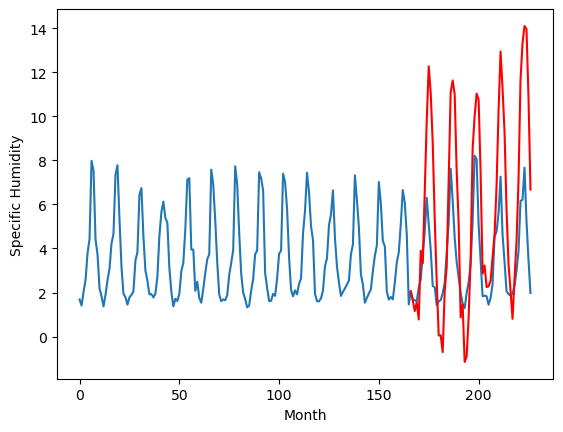

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
4.99		0.07		-4.92
5.98		-0.41		-6.39
4.86		-0.01		-4.87
4.44		-0.79		-5.23
6.18		2.33		-3.85
5.99		1.76		-4.23
5.29		4.99		-0.30
5.62		8.24		2.62
6.10		10.70		4.60
6.97		9.48		2.51
5.71		7.24		1.53
4.70		3.78		-0.92
4.68		0.95		-3.73
3.85		-1.52		-5.37
4.66		-1.51		-6.17
4.18		-2.27		-6.45
4.48		0.48		-4.00
4.17		1.60		-2.57
4.73		5.56		0.83
6.15		9.52		3.37
11.51		10.06		-1.45
9.08		9.44		0.36
7.36		5.98		-1.38
6.26		3.55		-2.71
4.99		-0.69		-5.68
5.13		-0.11		-5.24
4.14		-2.72		-6.86
3.71		-2.47		-6.18
4.33		-0.71		-5.04
4.33		1.98		-2.35
4.59		6.95		2.36
6.35		8.43		2.08
9.78		9.46		-0.32
12.85		9.19		-3.66
8.94		5.91		-3.03
6.21		1.29		-4.92
4.44		1.65		-2.79
5.19		0.68		-4.51
5.58		0.71		-4.87
4.33		0.97		-3.36
5.37		2.04		-3.33
4.52		3.07		-1.45
6.06		5.27		-0.79
6.56		8.68		2.12
7.53		11.37		3.84
10.11		9.69		-0.42
9.17		7.72		-1.45
6.11		4.18		-1.93
5.10		1.71		-3.39
5.02		0.52		-4.50

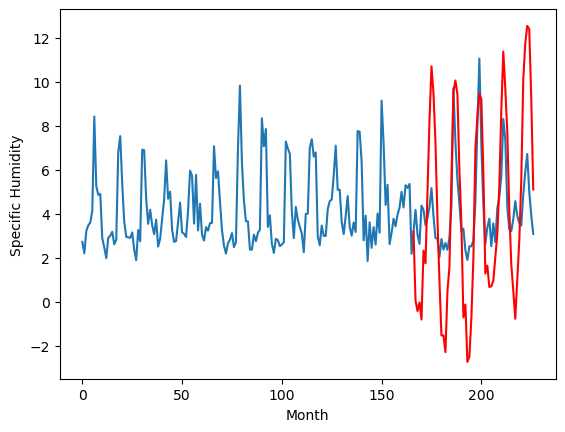

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
4.53		0.01		-4.52
5.76		-0.47		-6.23
5.08		-0.07		-5.15
4.19		-0.85		-5.04
4.67		2.27		-2.40
5.73		1.70		-4.03
6.59		4.93		-1.66
6.81		8.18		1.37
7.28		10.64		3.36
8.08		9.42		1.34
7.69		7.18		-0.51
5.49		3.72		-1.77
4.33		0.89		-3.44
3.99		-1.58		-5.57
4.66		-1.57		-6.23
4.31		-2.33		-6.64
3.96		0.42		-3.54
4.89		1.54		-3.35
5.33		5.50		0.17
6.76		9.46		2.70
7.24		10.00		2.76
7.63		9.38		1.75
6.99		5.92		-1.07
5.96		3.49		-2.47
6.18		-0.75		-6.93
4.93		-0.17		-5.10
4.60		-2.78		-7.38
3.76		-2.53		-6.29
4.76		-0.77		-5.53
4.86		1.92		-2.94
5.23		6.89		1.66
6.72		8.37		1.65
7.55		9.40		1.85
8.01		9.13		1.12
7.41		5.85		-1.56
6.10		1.23		-4.87
3.85		1.59		-2.26
4.64		0.62		-4.02
4.47		0.65		-3.82
3.61		0.91		-2.70
4.41		1.98		-2.43
4.79		3.01		-1.78
6.38		5.21		-1.17
6.44		8.62		2.18
7.28		11.31		4.03
8.55		9.63		1.08
8.00		7.66		-0.34
6.57		4.12		-2.45
5.48		1.65		-3.83
5.86		0.46		-5.40
5.87	

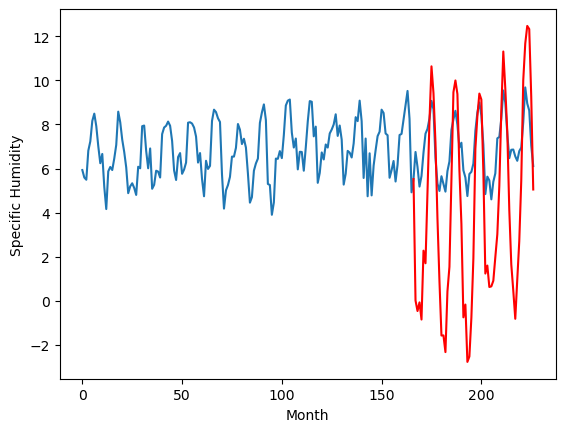

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.50		0.26		-0.24
0.14		-0.22		-0.36
-0.14		0.18		0.32
-0.06		-0.60		-0.54
0.43		2.52		2.09
0.93		1.95		1.02
3.16		5.18		2.02
7.27		8.43		1.16
11.25		10.89		-0.36
10.18		9.67		-0.51
6.81		7.43		0.62
4.28		3.97		-0.31
2.12		1.14		-0.98
0.16		-1.33		-1.49
-0.93		-1.32		-0.39
-0.78		-2.08		-1.30
0.00		0.67		0.67
1.38		1.79		0.41
2.95		5.75		2.80
7.85		9.71		1.86
10.06		10.25		0.19
10.44		9.63		-0.81
7.84		6.17		-1.67
5.30		3.74		-1.56
0.77		-0.50		-1.27
0.47		0.08		-0.39
-1.01		-2.53		-1.52
-0.42		-2.28		-1.86
0.42		-0.52		-0.94
1.07		2.17		1.10
4.46		7.14		2.68
6.80		8.62		1.82
9.96		9.65		-0.31
10.10		9.38		-0.72
6.43		6.10		-0.33
3.80		1.48		-2.32
1.95		1.84		-0.11
-0.02		0.87		0.89
0.55		0.90		0.35
-0.16		1.16		1.32
0.05		2.23		2.18
2.29		3.26		0.97
2.81		5.46		2.65
6.51		8.87		2.36
11.36		11.56		0.20
8.79		9.88		1.09
7.82		7.91		0.09
4.43		4.37		-0.06
0.63		1.90		1.27
0.96		0.71		-0.25
-0.

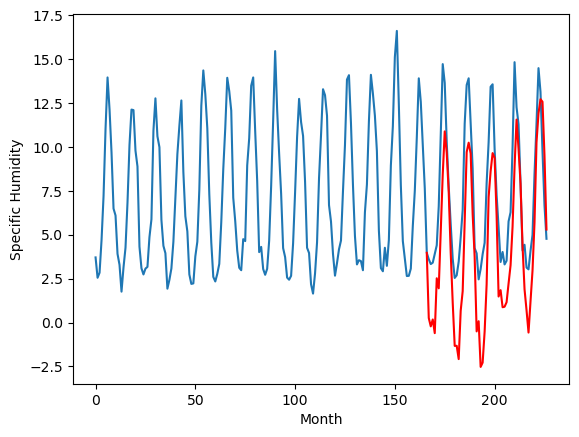

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-2.56		-2.23		0.33
-2.68		-2.71		-0.03
-2.76		-2.31		0.45
-2.77		-3.09		-0.32
-1.81		0.03		1.84
-1.38		-0.54		0.84
1.15		2.69		1.54
4.72		5.94		1.22
8.07		8.40		0.33
7.43		7.18		-0.25
4.14		4.94		0.80
1.37		1.48		0.11
-0.96		-1.35		-0.39
-2.81		-3.82		-1.01
-3.50		-3.81		-0.31
-3.64		-4.57		-0.93
-2.36		-1.82		0.54
-0.95		-0.70		0.25
0.64		3.26		2.62
5.51		7.22		1.71
7.20		7.76		0.56
7.52		7.14		-0.38
4.60		3.68		-0.92
2.70		1.25		-1.45
-2.22		-2.99		-0.77
-2.32		-2.41		-0.09
-3.83		-5.02		-1.19
-3.13		-4.77		-1.64
-2.19		-3.01		-0.82
-1.55		-0.32		1.23
2.63		4.65		2.02
4.03		6.13		2.10
7.01		7.16		0.15
6.64		6.89		0.25
3.62		3.61		-0.01
0.20		-1.01		-1.21
-1.02		-0.65		0.37
-2.94		-1.62		1.32
-2.16		-1.59		0.57
-2.91		-1.33		1.58
-2.78		-0.26		2.52
-0.35		0.77		1.12
0.12		2.97		2.85
3.81		6.38		2.57
7.79		9.07		1.28
6.55		7.39		0.84
4.86		5.42		0.56
1.59		1.88		0.29
-2.09		-0.59		1.50
-1.71

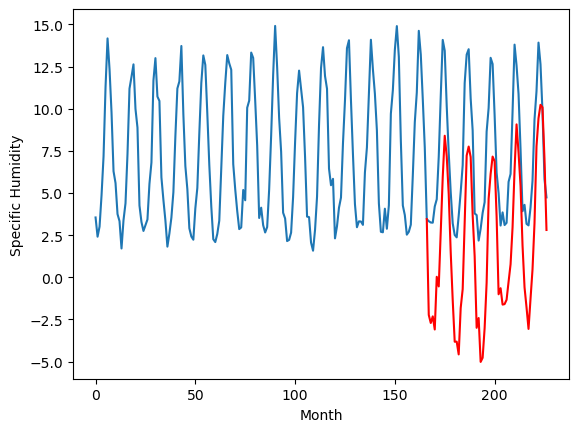

RangeIndex(start=1, stop=12, step=1)
[-3.310000000000001, -0.13999999999999968, 5.989999999999999, -0.8299999999999992, 3.6100000000000003, 0.2400000000000002, 6.16, 4.990000000000001, 4.529999999999999, 0.49999999999999956, -2.56]
[-2.2306788539886475, -1.1906788539886475, 2.0093211460113523, -0.2106788539886475, 1.1893211460113529, -0.19067885398864748, 1.6393211460113521, 0.06932114601135275, 0.009321146011352699, 0.25932114601135225, -2.2306788539886475]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -3.31  -2.230679
1                 1   -0.14  -1.190679
2                 2    5.99   2.009321
3                 3   -0.83  -0.210679
4                 4    3.61   1.189321
5                 5    0.24  -0.190679
6                 6    6.16   1.639321
7                 7    4.99   0.069321
8                 8    4.53   0.009321
9                 9    0.50   0.259321
10               10   -2.56  -2.230679


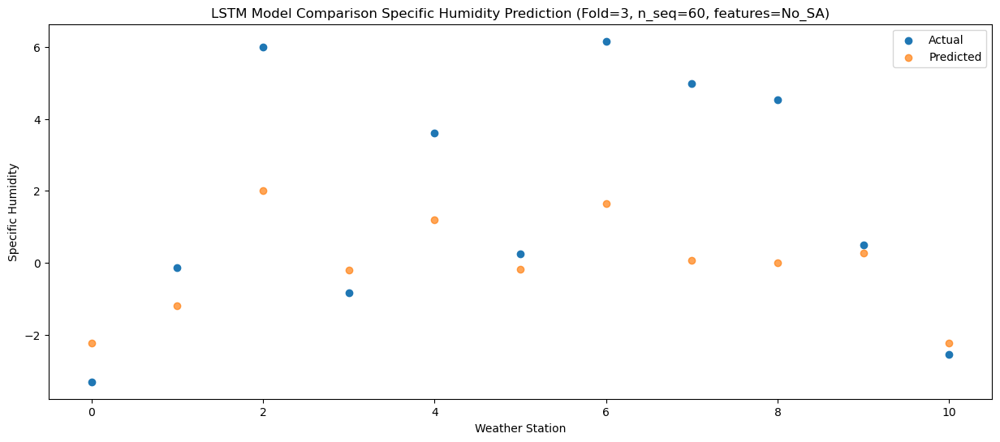

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -3.10  -2.708685
1                 1   -0.55  -1.668685
2                 2    6.53   1.531315
3                 3   -0.30  -0.688685
4                 4    2.11   0.711315
5                 5    0.53  -0.668685
6                 6    5.79   1.161315
7                 7    5.98  -0.408685
8                 8    5.76  -0.468685
9                 9    0.14  -0.218685
10               10   -2.68  -2.708685


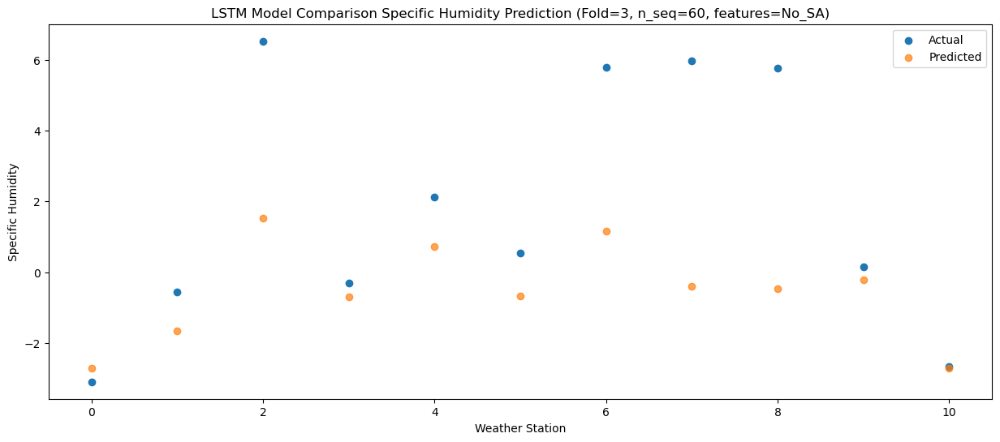

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -3.05  -2.314457
1                 1   -0.58  -1.274457
2                 2    6.15   1.925543
3                 3   -0.70  -0.294457
4                 4   -0.18   1.105543
5                 5    0.03  -0.274457
6                 6    5.75   1.555543
7                 7    4.86  -0.014457
8                 8    5.08  -0.074457
9                 9   -0.14   0.175543
10               10   -2.76  -2.314457


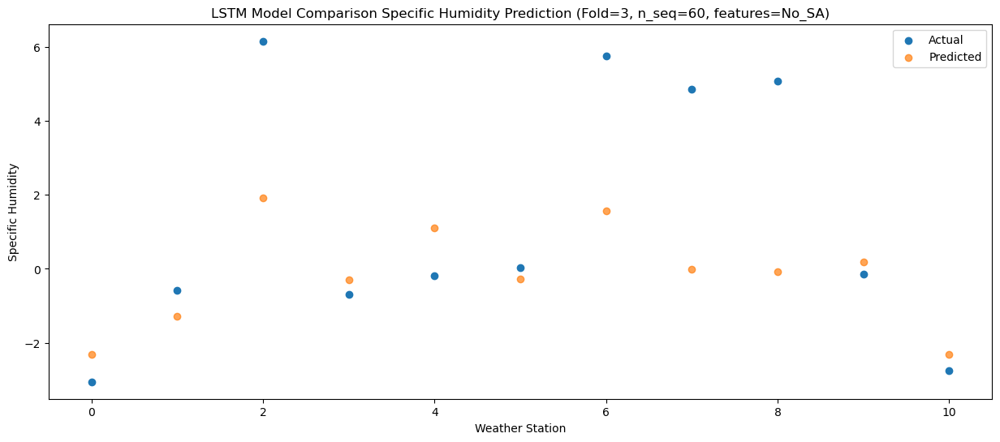

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -2.72  -3.093978
1                 1   -0.94  -2.053978
2                 2    5.46   1.146022
3                 3   -0.88  -1.073978
4                 4   -0.94   0.326022
5                 5   -0.22  -1.053978
6                 6    5.71   0.776022
7                 7    4.44  -0.793978
8                 8    4.19  -0.853978
9                 9   -0.06  -0.603978
10               10   -2.77  -3.093978


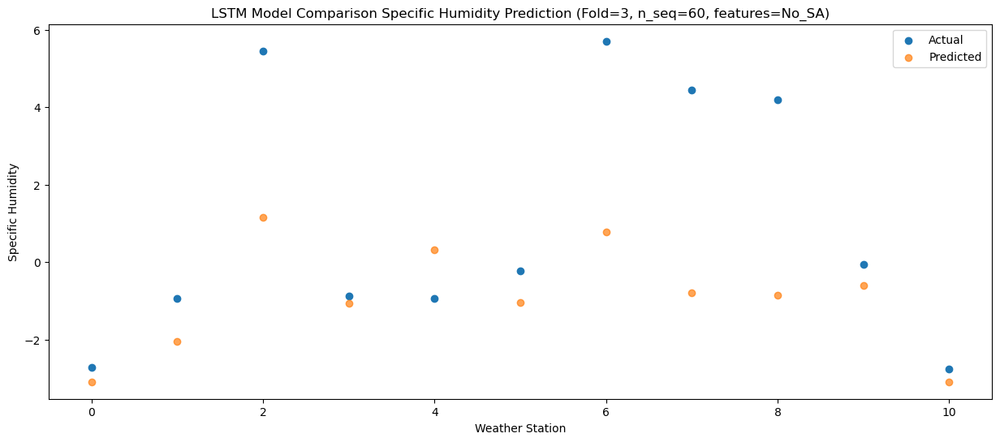

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0   -0.99   0.031051
1                 1    1.66   1.071051
2                 2    6.54   4.271051
3                 3    0.98   2.051051
4                 4    1.13   3.451051
5                 5    1.77   2.071051
6                 6    6.34   3.901051
7                 7    6.18   2.331051
8                 8    4.67   2.271051
9                 9    0.43   2.521051
10               10   -1.81   0.031051


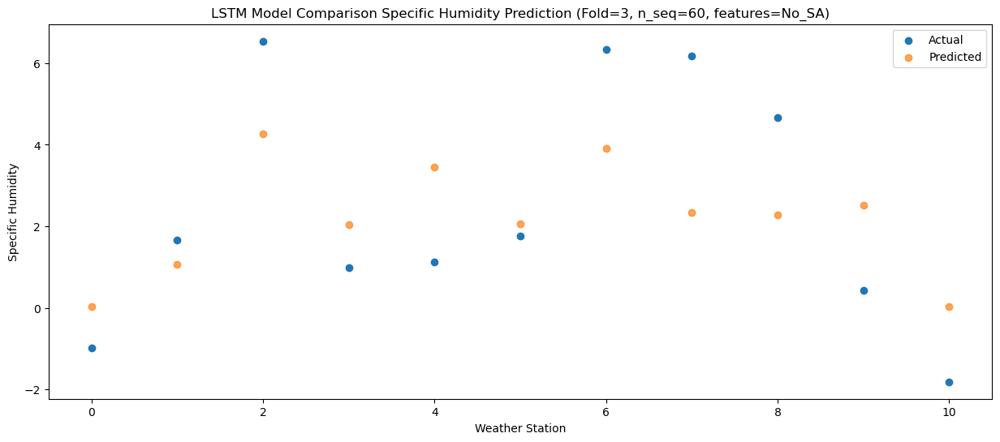

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0   -1.17  -0.539812
1                 1    1.81   0.500188
2                 2    7.91   3.700188
3                 3    0.90   1.480188
4                 4    1.45   2.880188
5                 5    1.89   1.500188
6                 6    6.69   3.330188
7                 7    5.99   1.760188
8                 8    5.73   1.700188
9                 9    0.93   1.950188
10               10   -1.38  -0.539812


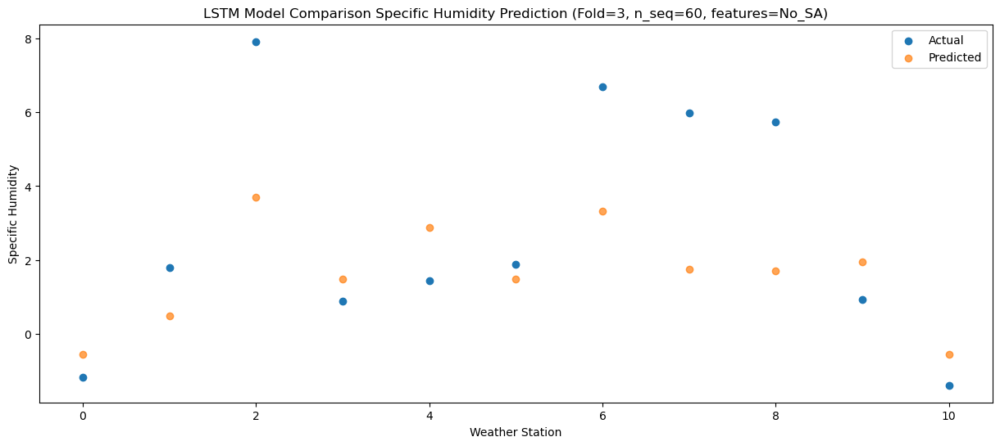

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    2.05   2.692006
1                 1    4.78   3.732006
2                 2    7.72   6.932006
3                 3    4.33   4.712006
4                 4    5.15   6.112006
5                 5    5.10   4.732006
6                 6    7.82   6.562006
7                 7    5.29   4.992006
8                 8    6.59   4.932006
9                 9    3.16   5.182006
10               10    1.15   2.692006


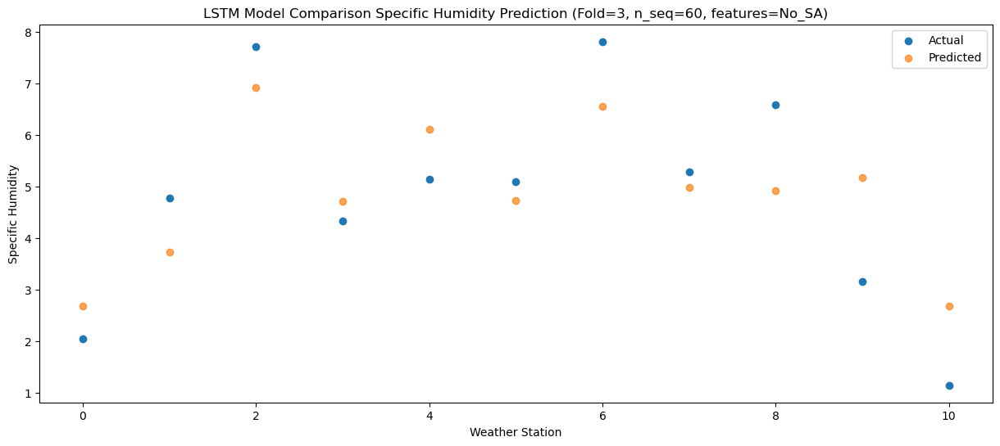

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0    5.59   5.936739
1                 1    8.31   6.976739
2                 2    9.26  10.176739
3                 3    7.57   7.956739
4                 4    8.24   9.356739
5                 5    7.83   7.976739
6                 6    8.88   9.806739
7                 7    5.62   8.236739
8                 8    6.81   8.176739
9                 9    7.27   8.426739
10               10    4.72   5.936739


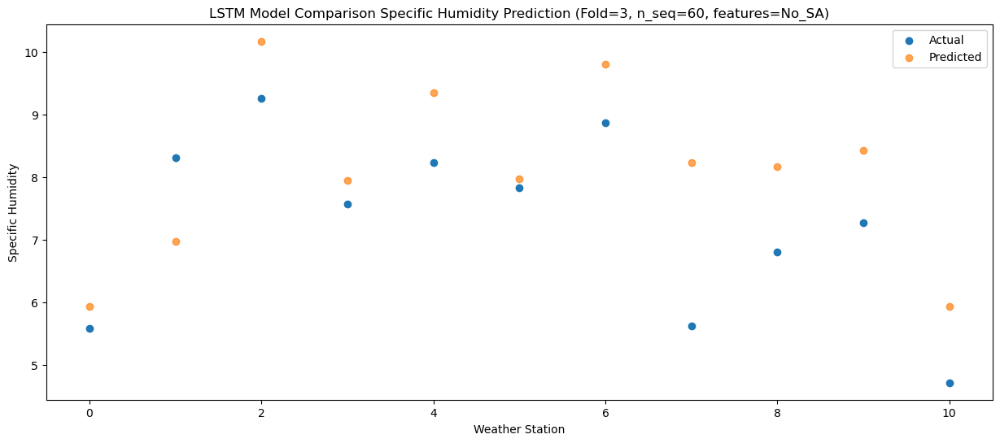

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0    8.28   8.396471
1                 1   11.05   9.436471
2                 2    9.48  12.636471
3                 3   10.67  10.416471
4                 4   12.19  11.816471
5                 5   10.99  10.436471
6                 6   10.40  12.266471
7                 7    6.10  10.696471
8                 8    7.28  10.636471
9                 9   11.25  10.886471
10               10    8.07   8.396471


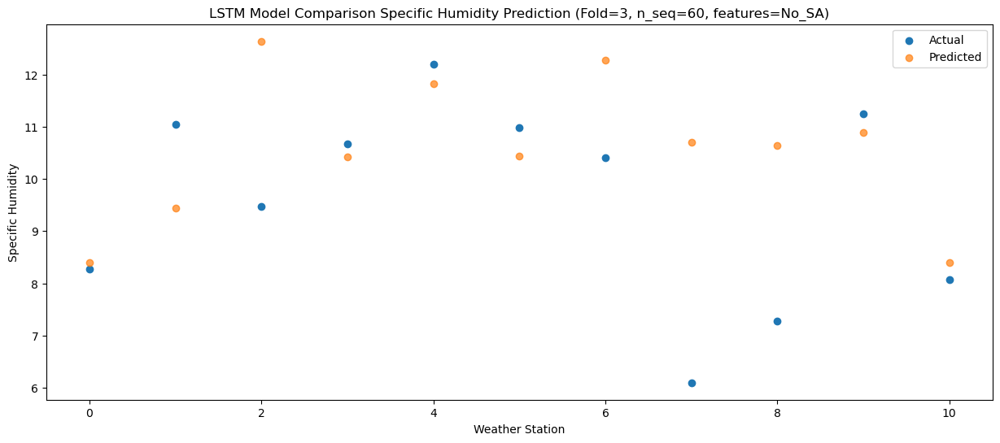

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0    8.57   7.183323
1                 1    8.38   8.223323
2                 2   11.00  11.423323
3                 3    9.59   9.203323
4                 4    9.81  10.603323
5                 5    9.77   9.223323
6                 6    9.19  11.053323
7                 7    6.97   9.483323
8                 8    8.08   9.423323
9                 9   10.18   9.673323
10               10    7.43   7.183323


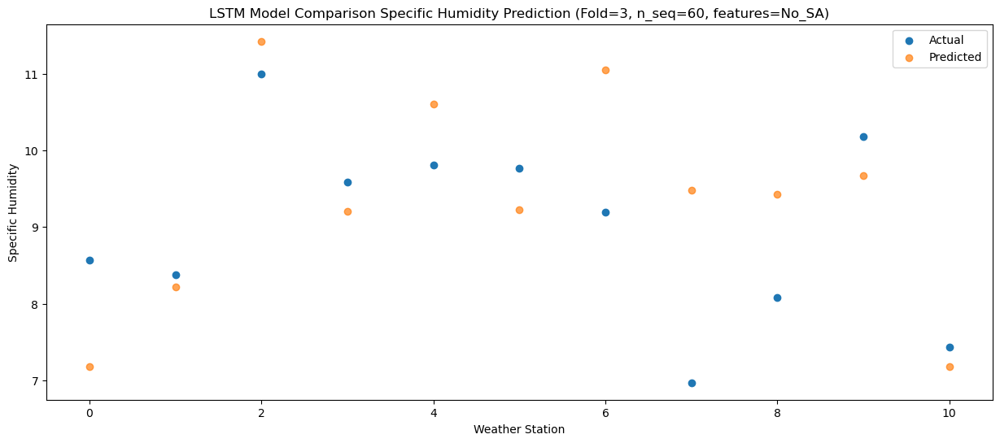

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    4.83   4.935275
1                 1    6.94   5.975275
2                 2   10.52   9.175275
3                 3    7.02   6.955275
4                 4    6.85   8.355275
5                 5    6.59   6.975275
6                 6    8.05   8.805275
7                 7    5.71   7.235275
8                 8    7.69   7.175275
9                 9    6.81   7.425275
10               10    4.14   4.935275


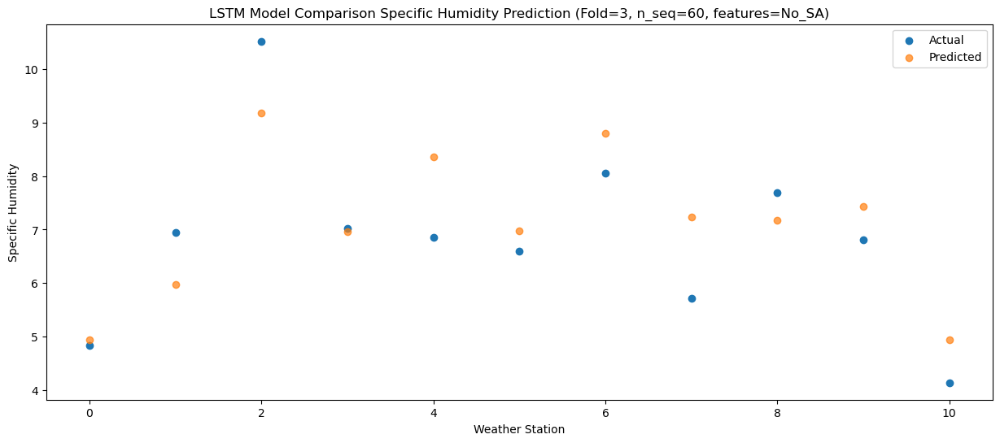

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    2.25   1.482162
1                 1    2.37   2.522162
2                 2    8.64   5.722162
3                 3    3.33   3.502162
4                 4    2.13   4.902162
5                 5    3.17   3.522162
6                 6    6.40   5.352162
7                 7    4.70   3.782162
8                 8    5.49   3.722162
9                 9    4.28   3.972162
10               10    1.37   1.482162


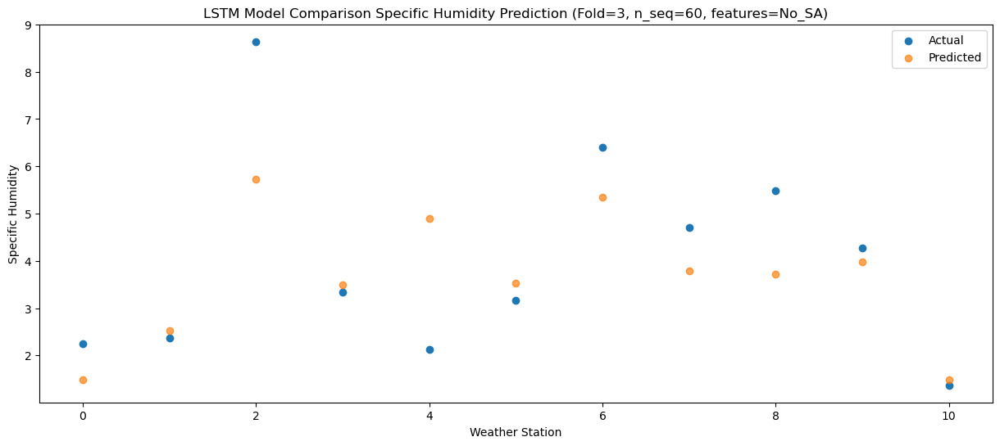

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0   -0.49  -1.352498
1                 1    0.87  -0.312498
2                 2    5.95   2.887502
3                 3    0.44   0.667502
4                 4    1.03   2.067502
5                 5    1.40   0.687502
6                 6    6.34   2.517502
7                 7    4.68   0.947502
8                 8    4.33   0.887502
9                 9    2.12   1.137502
10               10   -0.96  -1.352498


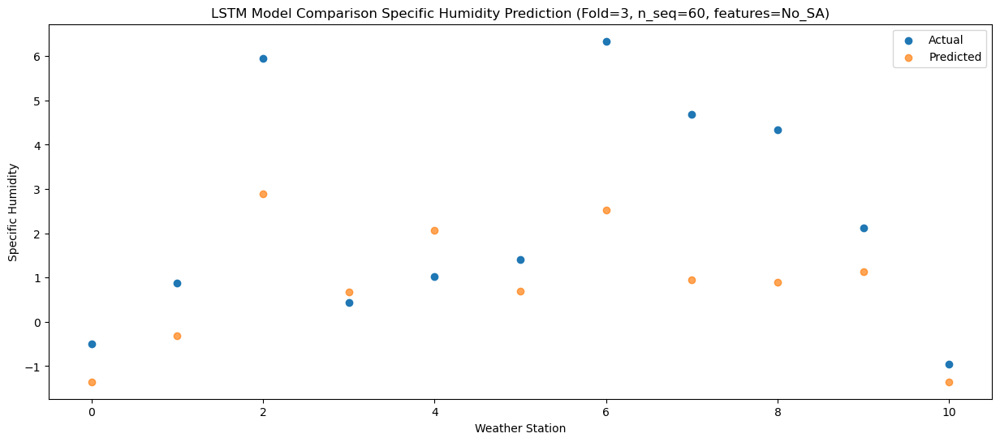

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -3.71  -3.820232
1                 1   -1.17  -2.780232
2                 2    5.35   0.419768
3                 3   -1.17  -1.800232
4                 4   -0.90  -0.400232
5                 5   -0.26  -1.780232
6                 6    5.53   0.049768
7                 7    3.85  -1.520232
8                 8    3.99  -1.580232
9                 9    0.16  -1.330232
10               10   -2.81  -3.820232


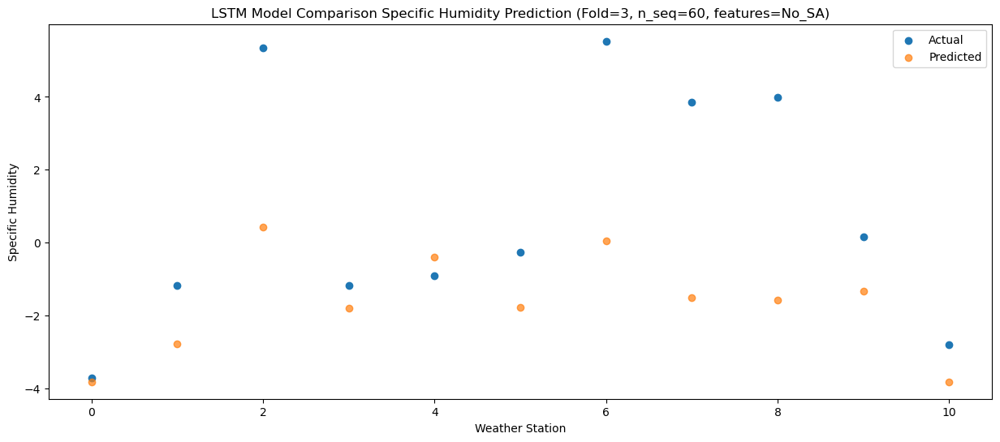

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -3.84  -3.814286
1                 1   -1.26  -2.774286
2                 2    5.79   0.425714
3                 3   -1.44  -1.794286
4                 4   -1.10  -0.394286
5                 5   -0.57  -1.774286
6                 6    5.70   0.055714
7                 7    4.66  -1.514286
8                 8    4.66  -1.574286
9                 9   -0.93  -1.324286
10               10   -3.50  -3.814286


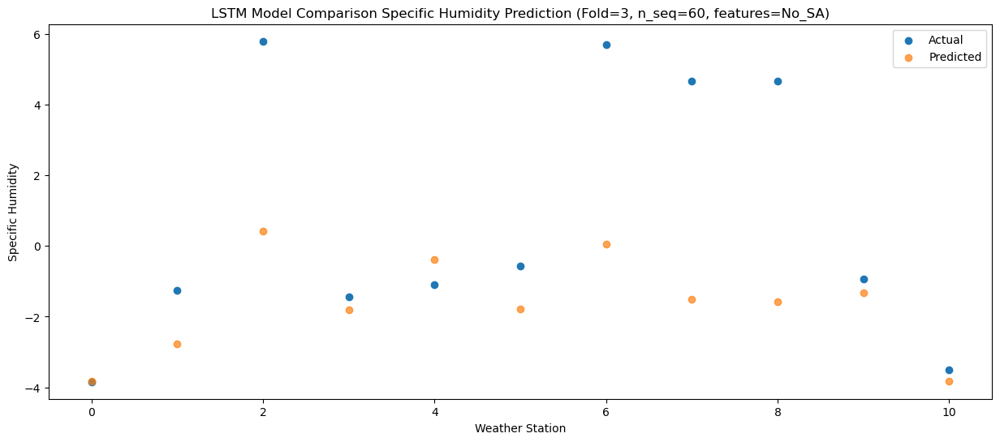

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -3.75   -4.57163
1                 1   -1.82   -3.53163
2                 2    5.73   -0.33163
3                 3   -1.51   -2.55163
4                 4   -1.93   -1.15163
5                 5   -1.09   -2.53163
6                 6    5.76   -0.70163
7                 7    4.18   -2.27163
8                 8    4.31   -2.33163
9                 9   -0.78   -2.08163
10               10   -3.64   -4.57163


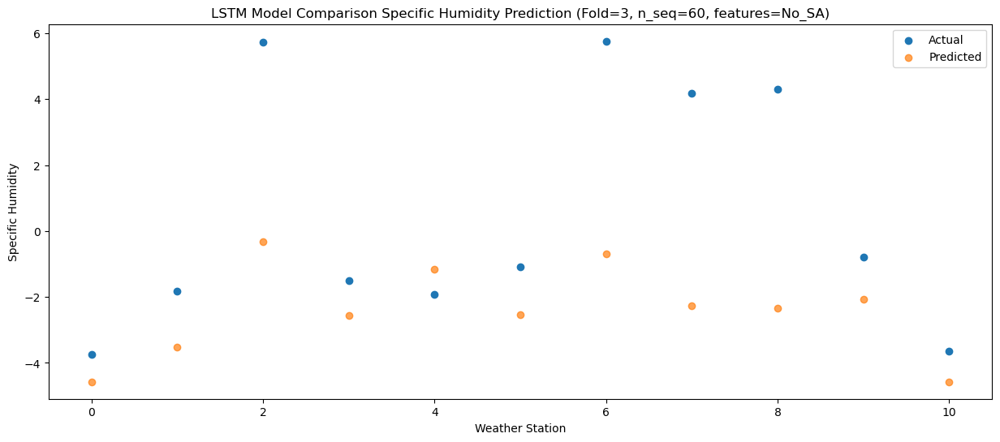

Predictions for (t+16):
    Weather_Station        Actual  Predicted
0                 0 -2.100000e+00  -1.817862
1                 1  6.900000e-01  -0.777862
2                 2  5.810000e+00   2.422138
3                 3 -2.100000e-01   0.202138
4                 4  5.500000e-01   1.602138
5                 5  9.400000e-01   0.222138
6                 6  6.070000e+00   2.052138
7                 7  4.480000e+00   0.482138
8                 8  3.960000e+00   0.422138
9                 9  2.220446e-16   0.672138
10               10 -2.360000e+00  -1.817862


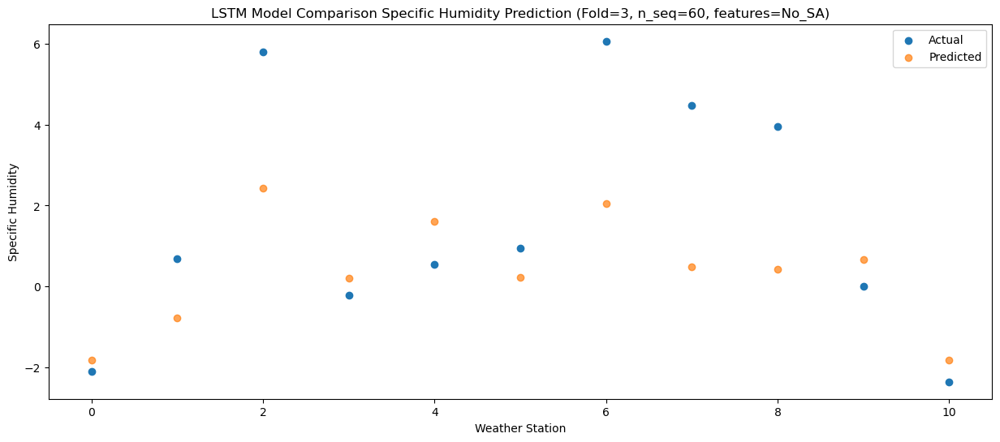

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0   -1.58  -0.702345
1                 1    1.86   0.337655
2                 2    6.43   3.537655
3                 3    0.98   1.317655
4                 4    1.61   2.717655
5                 5    2.24   1.337655
6                 6    6.54   3.167655
7                 7    4.17   1.597655
8                 8    4.89   1.537655
9                 9    1.38   1.787655
10               10   -0.95  -0.702345


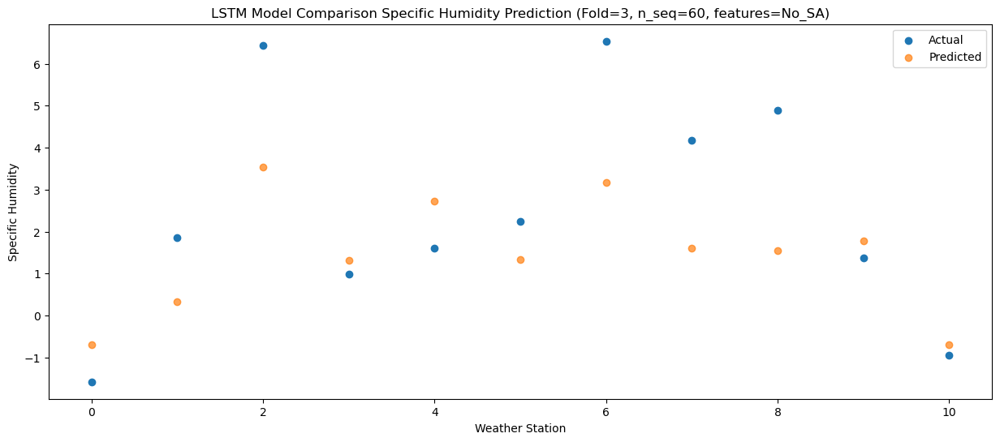

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    1.20   3.260836
1                 1    5.38   4.300836
2                 2    6.83   7.500836
3                 3    3.51   5.280836
4                 4    4.03   6.680836
5                 5    4.48   5.300836
6                 6    7.94   7.130836
7                 7    4.73   5.560836
8                 8    5.33   5.500836
9                 9    2.95   5.750836
10               10    0.64   3.260836


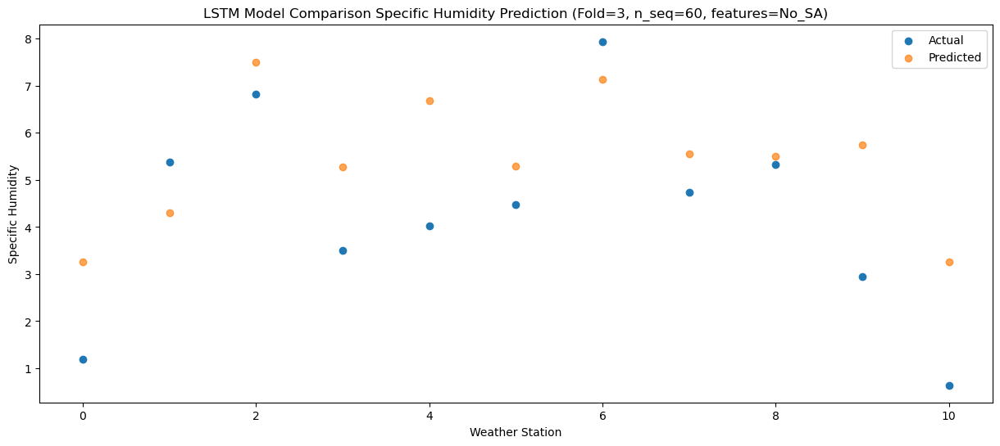

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0    5.92   7.221946
1                 1    9.91   8.261946
2                 2    9.28  11.461946
3                 3    8.93   9.241946
4                 4    8.49  10.641946
5                 5    9.70   9.261946
6                 6    9.27  11.091946
7                 7    6.15   9.521946
8                 8    6.76   9.461946
9                 9    7.85   9.711946
10               10    5.51   7.221946


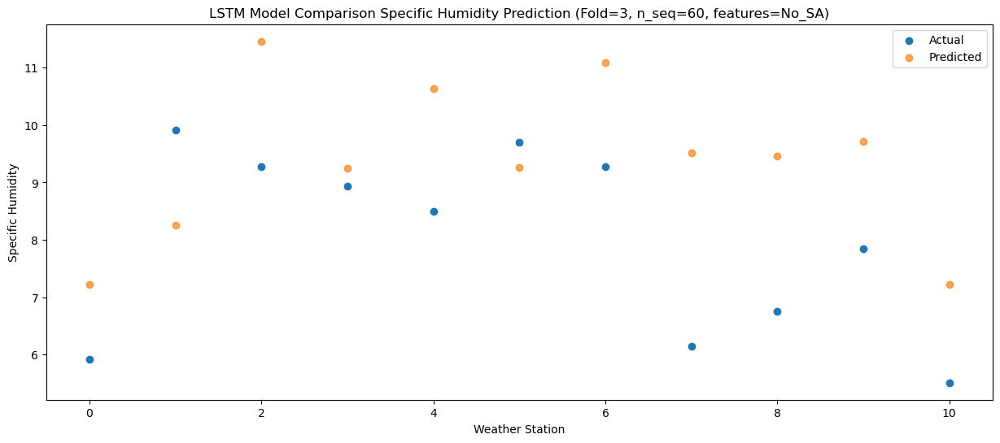

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0    7.16   7.755476
1                 1   10.79   8.795476
2                 2    9.98  11.995476
3                 3    9.56   9.775476
4                 4   10.44  11.175476
5                 5   10.95   9.795476
6                 6   11.72  11.625476
7                 7   11.51  10.055476
8                 8    7.24   9.995476
9                 9   10.06  10.245476
10               10    7.20   7.755476


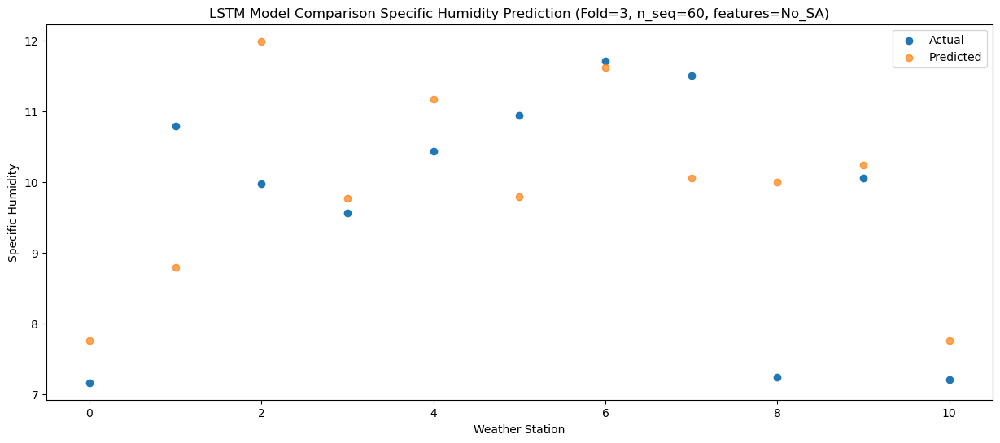

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0    7.43   7.138001
1                 1   10.96   8.178001
2                 2    9.51  11.378001
3                 3   10.44   9.158001
4                 4   10.53  10.558001
5                 5   11.12   9.178001
6                 6   10.29  11.008001
7                 7    9.08   9.438001
8                 8    7.63   9.378001
9                 9   10.44   9.628001
10               10    7.52   7.138001


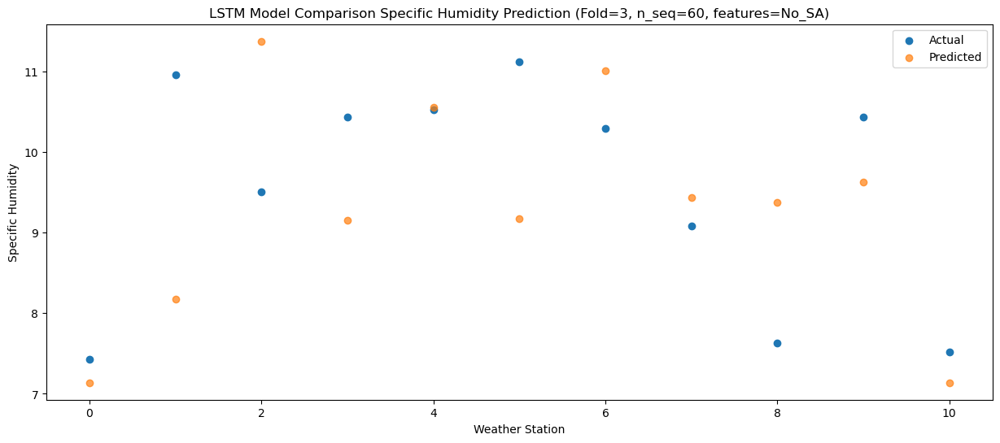

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    3.81   3.678832
1                 1    6.99   4.718832
2                 2    8.22   7.918832
3                 3    6.97   5.698832
4                 4    6.76   7.098832
5                 5    7.82   5.718832
6                 6    8.59   7.548832
7                 7    7.36   5.978832
8                 8    6.99   5.918832
9                 9    7.84   6.168832
10               10    4.60   3.678832


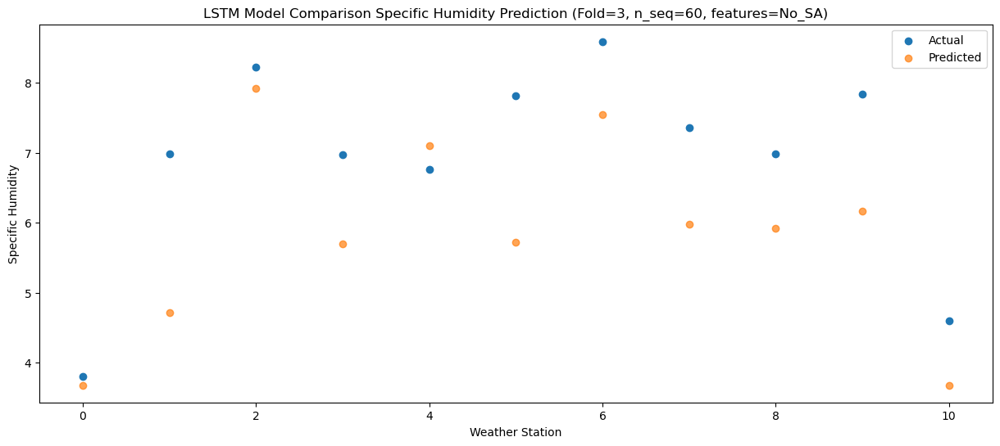

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    1.77   1.250005
1                 1    4.80   2.290005
2                 2    7.08   5.490005
3                 3    4.91   3.270005
4                 4    4.81   4.670005
5                 5    6.20   3.290005
6                 6    7.50   5.120005
7                 7    6.26   3.550005
8                 8    5.96   3.490005
9                 9    5.30   3.740005
10               10    2.70   1.250005


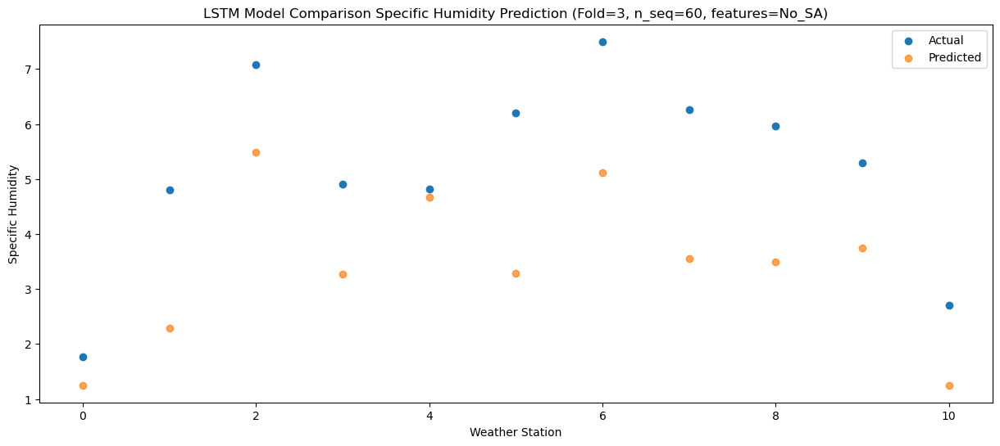

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0   -3.73   -2.99412
1                 1    0.37   -1.95412
2                 2    7.66    1.24588
3                 3   -0.78   -0.97412
4                 4   -0.31    0.42588
5                 5    0.33   -0.95412
6                 6    6.79    0.87588
7                 7    4.99   -0.69412
8                 8    6.18   -0.75412
9                 9    0.77   -0.50412
10               10   -2.22   -2.99412


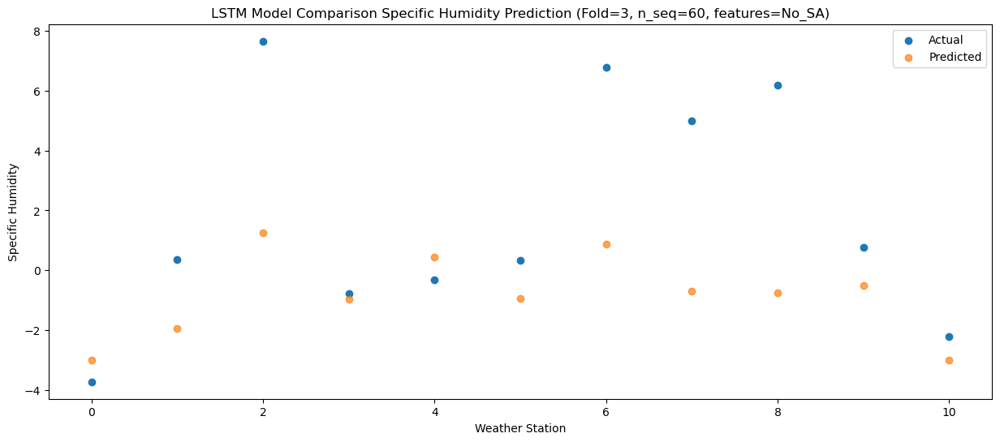

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0   -1.78  -2.414635
1                 1    1.34  -1.374635
2                 2    6.16   1.825365
3                 3    0.36  -0.394635
4                 4    0.39   1.005365
5                 5    1.38  -0.374635
6                 6    6.08   1.455365
7                 7    5.13  -0.114635
8                 8    4.93  -0.174635
9                 9    0.47   0.075365
10               10   -2.32  -2.414635


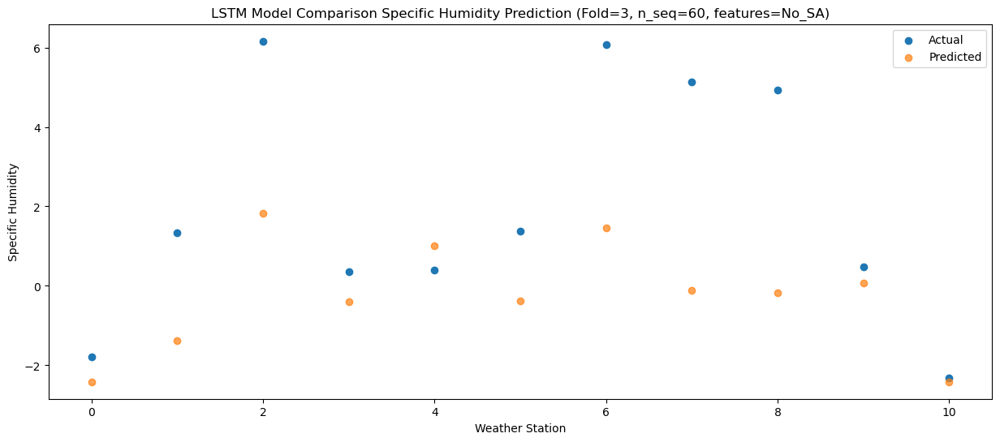

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -4.57  -5.017774
1                 1   -1.85  -3.977774
2                 2    5.88  -0.777774
3                 3   -1.96  -2.997774
4                 4   -2.07  -1.597774
5                 5   -1.13  -2.977774
6                 6    5.60  -1.147774
7                 7    4.14  -2.717774
8                 8    4.60  -2.777774
9                 9   -1.01  -2.527774
10               10   -3.83  -5.017774


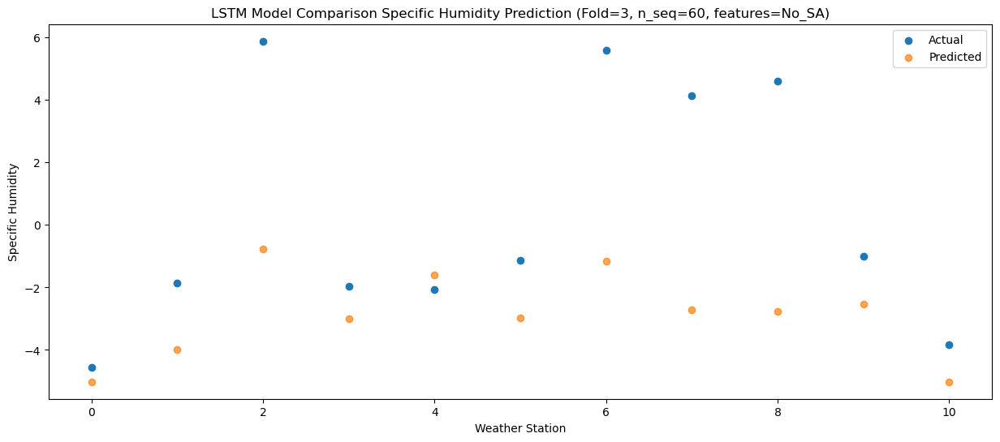

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -3.21   -4.77185
1                 1   -1.48   -3.73185
2                 2    5.10   -0.53185
3                 3   -1.44   -2.75185
4                 4   -1.45   -1.35185
5                 5   -0.60   -2.73185
6                 6    5.39   -0.90185
7                 7    3.71   -2.47185
8                 8    3.76   -2.53185
9                 9   -0.42   -2.28185
10               10   -3.13   -4.77185


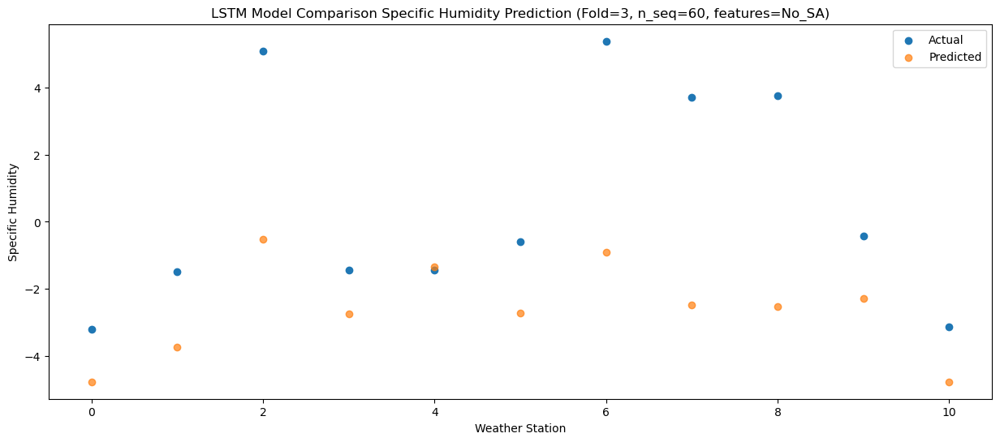

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0   -2.31  -3.007477
1                 1   -0.01  -1.967477
2                 2    6.44   1.232523
3                 3   -0.46  -0.987477
4                 4    0.12   0.412523
5                 5    0.71  -0.967477
6                 6    6.07   0.862523
7                 7    4.33  -0.707477
8                 8    4.76  -0.767477
9                 9    0.42  -0.517477
10               10   -2.19  -3.007477


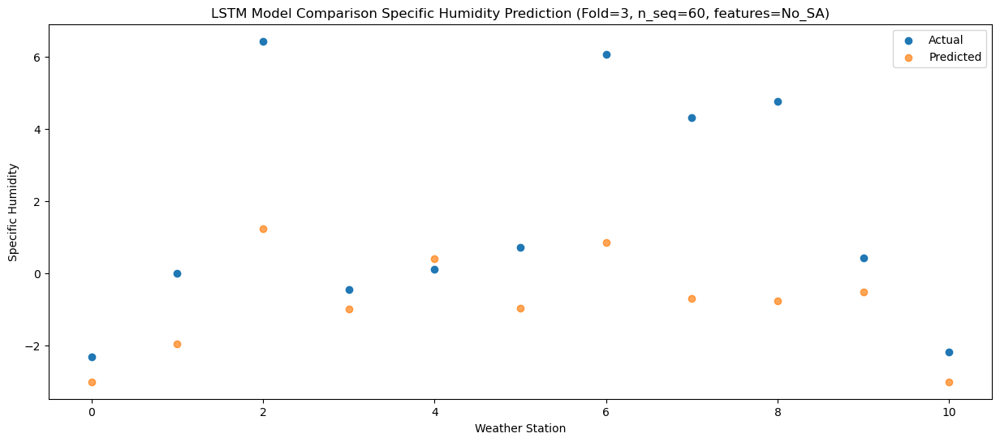

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0   -1.28  -0.318552
1                 1    2.29   0.721448
2                 2    6.11   3.921448
3                 3    0.81   1.701448
4                 4    1.68   3.101448
5                 5    2.24   1.721448
6                 6    6.57   3.551448
7                 7    4.33   1.981448
8                 8    4.86   1.921448
9                 9    1.07   2.171448
10               10   -1.55  -0.318552


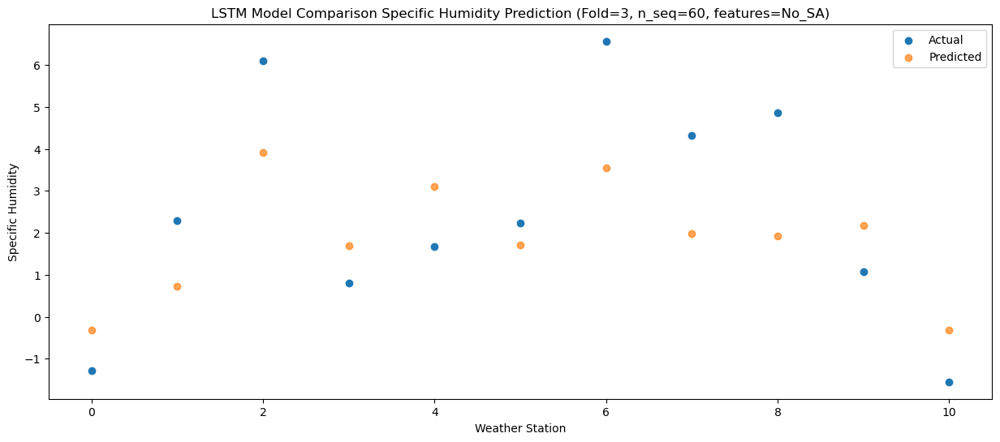

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    3.03   4.654718
1                 1    6.74   5.694718
2                 2    6.29   8.894718
3                 3    5.23   6.674718
4                 4    5.77   8.074718
5                 5    6.47   6.694718
6                 6    7.38   8.524718
7                 7    4.59   6.954718
8                 8    5.23   6.894718
9                 9    4.46   7.144718
10               10    2.63   4.654718


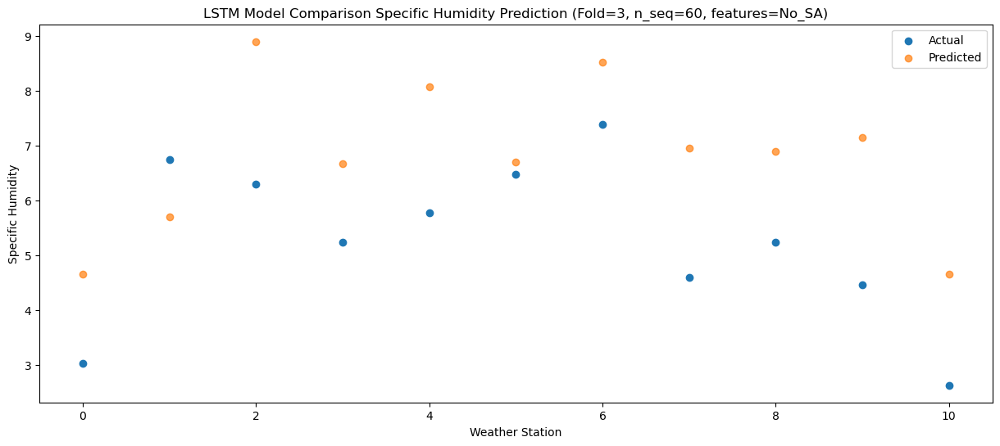

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0    4.33   6.126255
1                 1    9.36   7.166255
2                 2    7.46  10.366255
3                 3    7.49   8.146255
4                 4    7.87   9.546255
5                 5    8.54   8.166255
6                 6    9.32   9.996255
7                 7    6.35   8.426255
8                 8    6.72   8.366255
9                 9    6.80   8.616255
10               10    4.03   6.126255


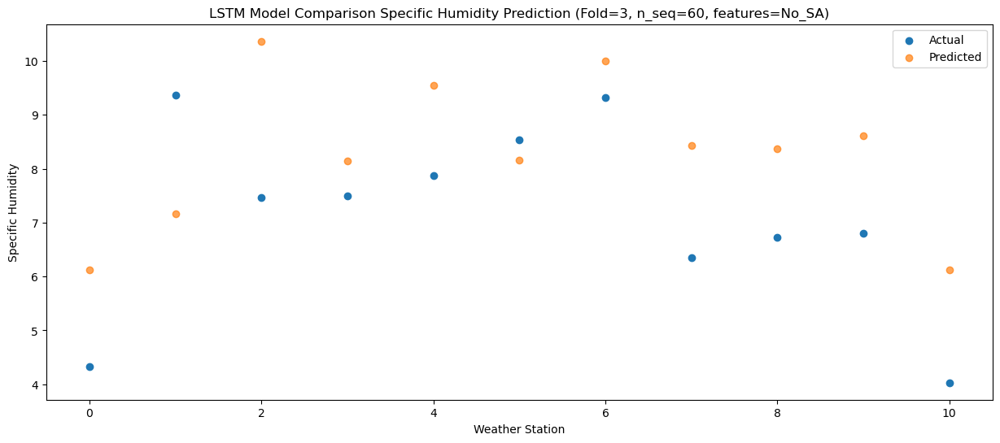

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0    8.40   7.160804
1                 1    9.57   8.200804
2                 2    8.63  11.400804
3                 3   10.53   9.180804
4                 4   10.46  10.580804
5                 5   11.32   9.200804
6                 6   12.31  11.030804
7                 7    9.78   9.460804
8                 8    7.55   9.400804
9                 9    9.96   9.650804
10               10    7.01   7.160804


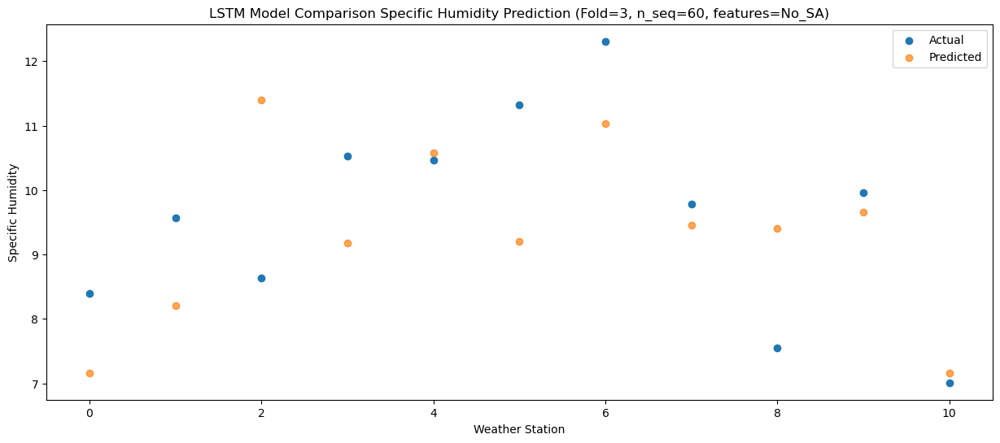

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0    6.59   6.890136
1                 1   10.18   7.930136
2                 2    9.42  11.130136
3                 3    9.40   8.910136
4                 4    9.96  10.310136
5                 5   10.12   8.930136
6                 6   12.15  10.760136
7                 7   12.85   9.190136
8                 8    8.01   9.130136
9                 9   10.10   9.380136
10               10    6.64   6.890136


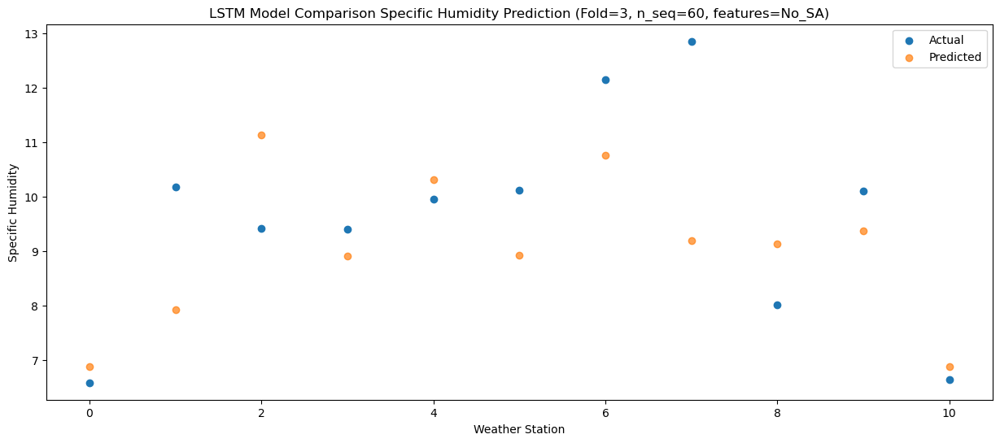

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    3.17   3.613934
1                 1    6.33   4.653934
2                 2    9.13   7.853934
3                 3    6.15   5.633934
4                 4    6.86   7.033934
5                 5    7.35   5.653934
6                 6    9.20   7.483934
7                 7    8.94   5.913934
8                 8    7.41   5.853934
9                 9    6.43   6.103934
10               10    3.62   3.613934


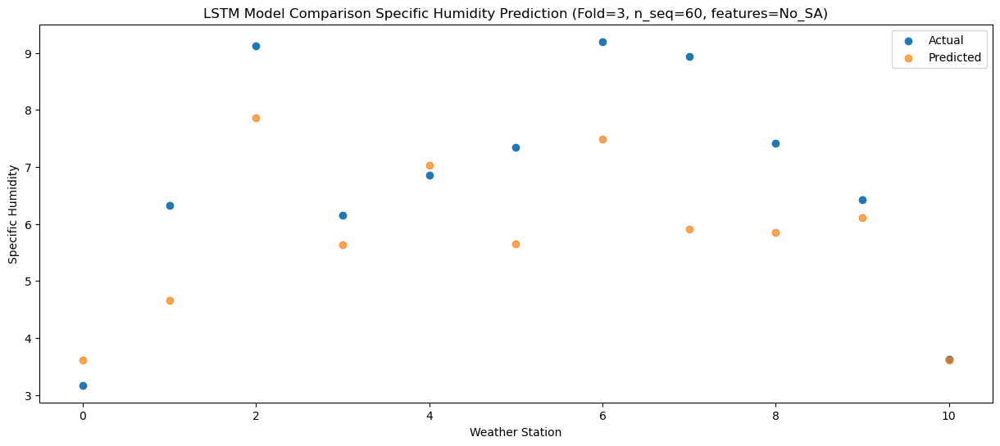

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0   -1.06  -1.006782
1                 1    1.87   0.033218
2                 2    7.96   3.233218
3                 3    1.00   1.013218
4                 4    1.86   2.413218
5                 5    2.05   1.033218
6                 6    7.59   2.863218
7                 7    6.21   1.293218
8                 8    6.10   1.233218
9                 9    3.80   1.483218
10               10    0.20  -1.006782


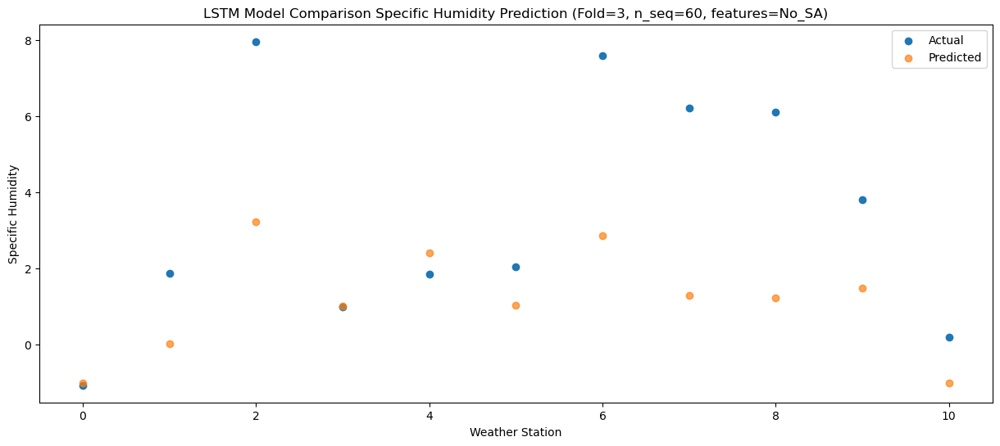

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0   -1.51  -0.645193
1                 1    0.84   0.394807
2                 2    5.24   3.594807
3                 3    0.19   1.374807
4                 4    0.47   2.774807
5                 5    0.83   1.394807
6                 6    5.93   3.224807
7                 7    4.44   1.654807
8                 8    3.85   1.594807
9                 9    1.95   1.844807
10               10   -1.02  -0.645193


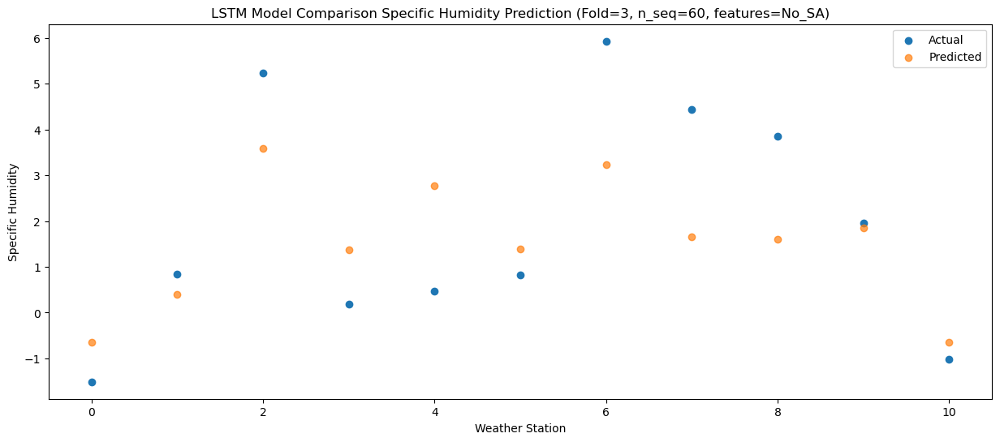

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -3.71  -1.618343
1                 1   -0.35  -0.578343
2                 2    6.08   2.621657
3                 3   -0.84   0.401657
4                 4   -0.65   1.801657
5                 5    0.07   0.421657
6                 6    5.96   2.251657
7                 7    5.19   0.681657
8                 8    4.64   0.621657
9                 9   -0.02   0.871657
10               10   -2.94  -1.618343


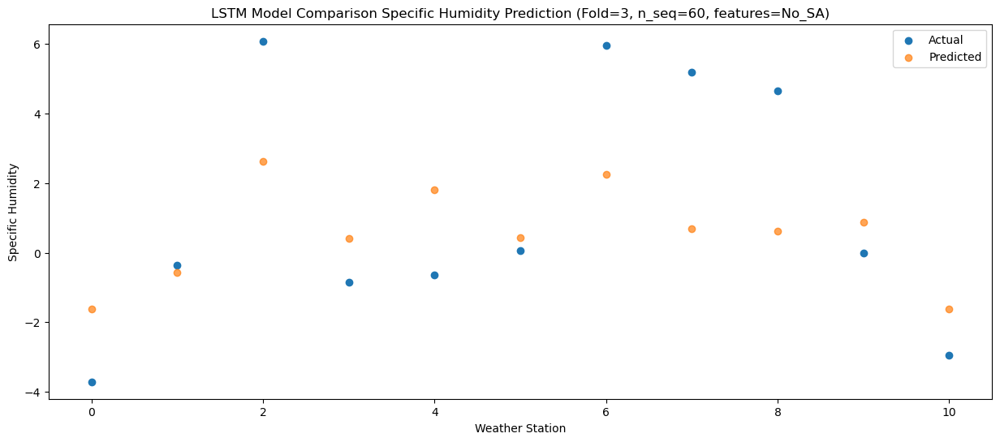

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0   -2.80  -1.589801
1                 1   -0.43  -0.549801
2                 2    6.23   2.650199
3                 3   -0.30   0.430199
4                 4   -0.27   1.830199
5                 5    0.65   0.450199
6                 6    5.93   2.280199
7                 7    5.58   0.710199
8                 8    4.47   0.650199
9                 9    0.55   0.900199
10               10   -2.16  -1.589801


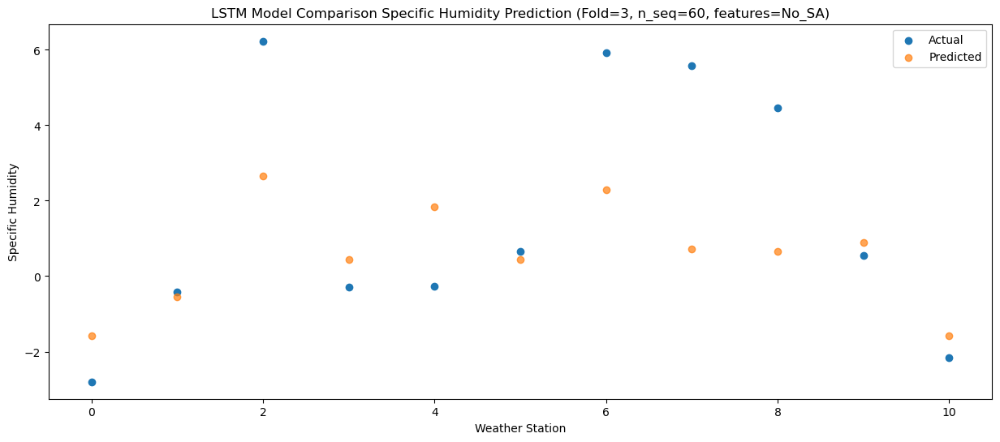

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0   -2.07  -1.332736
1                 1   -0.27  -0.292736
2                 2    5.10   2.907264
3                 3   -0.48   0.687264
4                 4    0.61   2.087264
5                 5    0.32   0.707264
6                 6    5.55   2.537264
7                 7    4.33   0.967264
8                 8    3.61   0.907264
9                 9   -0.16   1.157264
10               10   -2.91  -1.332736


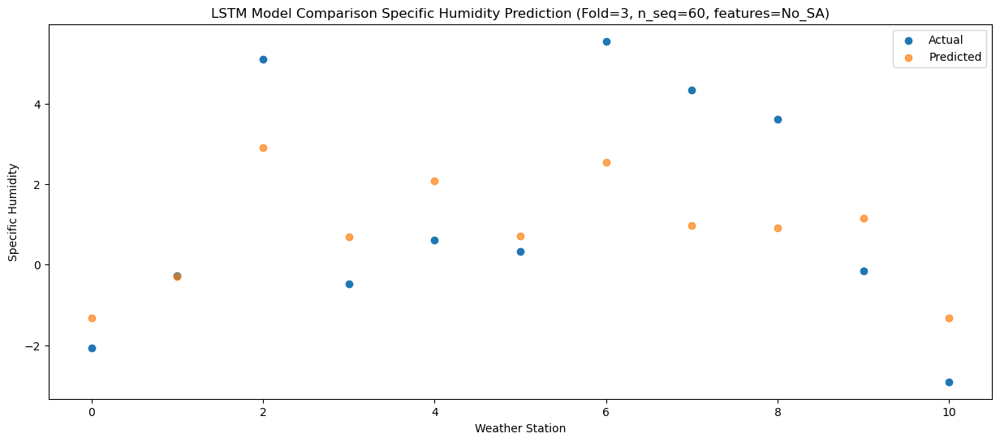

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0   -2.46  -0.264359
1                 1    0.67   0.775641
2                 2    6.62   3.975641
3                 3   -0.61   1.755641
4                 4    0.28   3.155641
5                 5    0.75   1.775641
6                 6    5.85   3.605641
7                 7    5.37   2.035641
8                 8    4.41   1.975641
9                 9    0.05   2.225641
10               10   -2.78  -0.264359


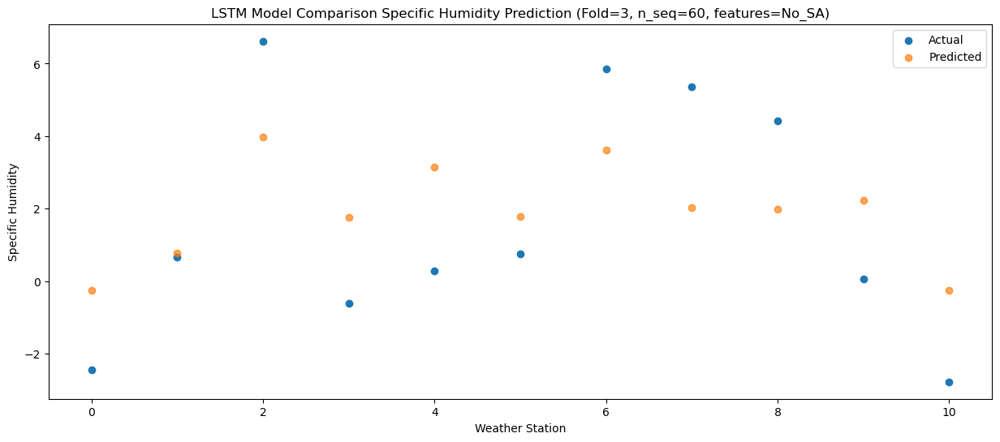

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0   -0.47   0.773901
1                 1    1.54   1.813901
2                 2    6.82   5.013901
3                 3    0.93   2.793901
4                 4    1.51   4.193901
5                 5    2.06   2.813901
6                 6    6.48   4.643901
7                 7    4.52   3.073901
8                 8    4.79   3.013901
9                 9    2.29   3.263901
10               10   -0.35   0.773901


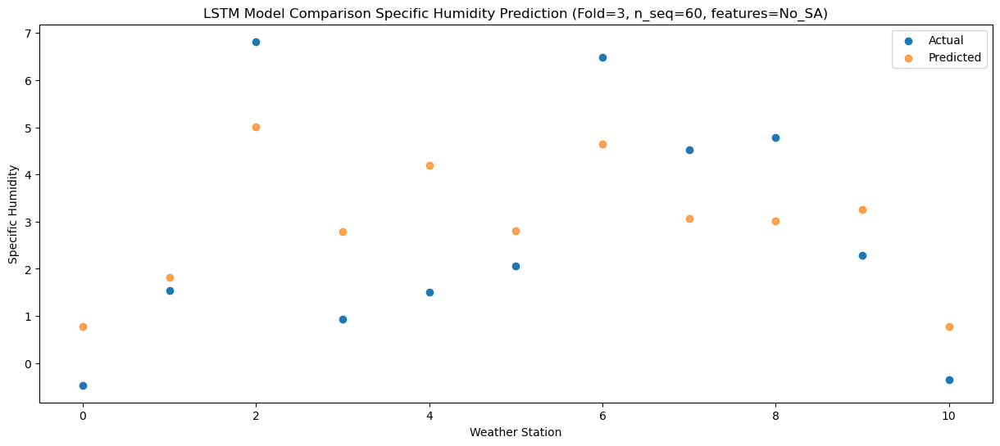

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    0.98   2.971664
1                 1    5.95   4.011664
2                 2    7.76   7.211664
3                 3    3.84   4.991664
4                 4    4.69   6.391664
5                 5    4.66   5.011664
6                 6    8.64   6.841664
7                 7    6.06   5.271664
8                 8    6.38   5.211664
9                 9    2.81   5.461664
10               10    0.12   2.971664


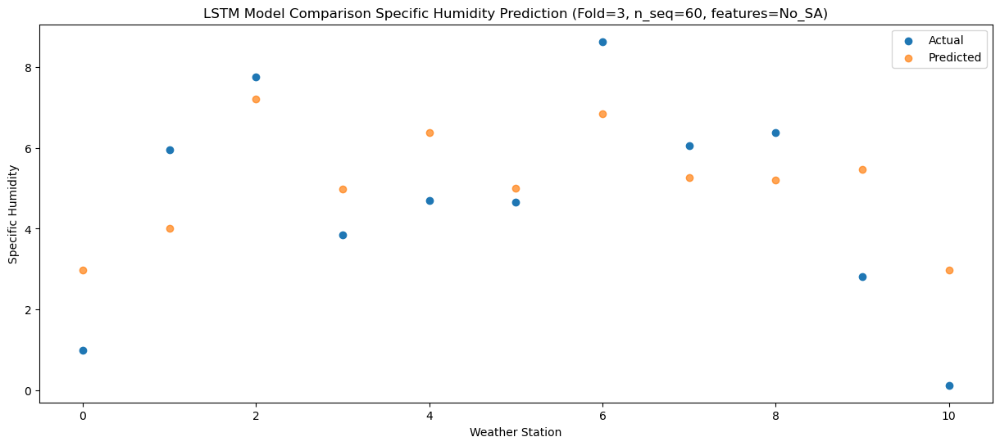

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0    4.25   6.384067
1                 1    8.59   7.424067
2                 2    8.53  10.624067
3                 3    5.86   8.404067
4                 4    6.82   9.804067
5                 5    6.82   8.424067
6                 6    8.87  10.254067
7                 7    6.56   8.684067
8                 8    6.44   8.624067
9                 9    6.51   8.874067
10               10    3.81   6.384067


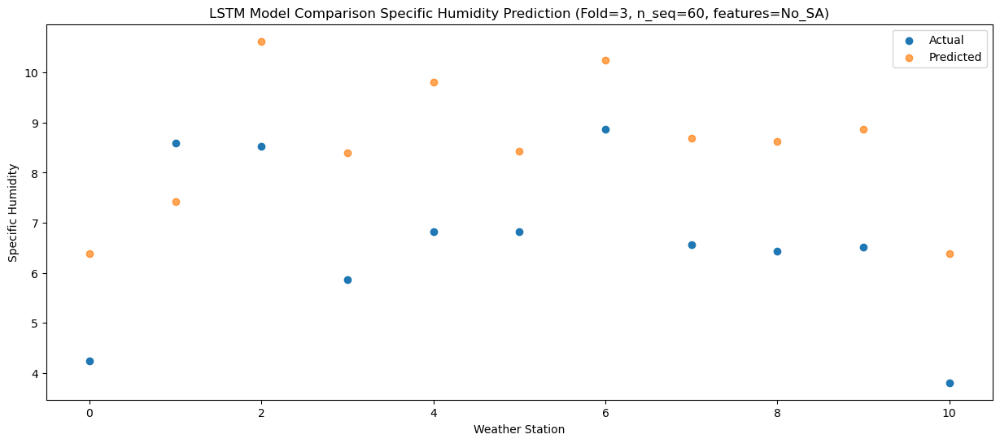

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0    8.20   9.069857
1                 1   10.86  10.109857
2                 2    9.63  13.309857
3                 3    9.51  11.089857
4                 4   10.59  12.489857
5                 5   11.33  11.109857
6                 6    9.71  12.939857
7                 7    7.53  11.369857
8                 8    7.28  11.309857
9                 9   11.36  11.559857
10               10    7.79   9.069857


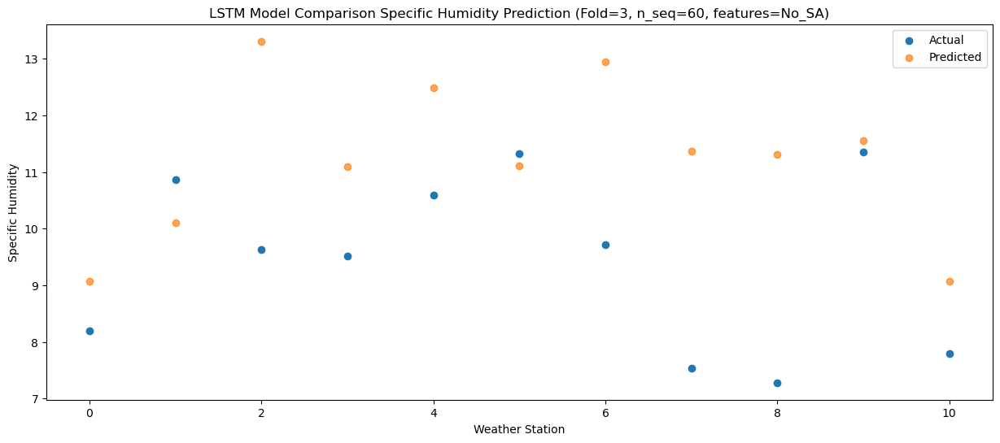

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0    7.30   7.389534
1                 1   11.10   8.429534
2                 2   10.70  11.629534
3                 3    8.96   9.409534
4                 4   10.98  10.809534
5                 5   10.45   9.429534
6                 6   11.36  11.259534
7                 7   10.11   9.689534
8                 8    8.55   9.629534
9                 9    8.79   9.879534
10               10    6.55   7.389534


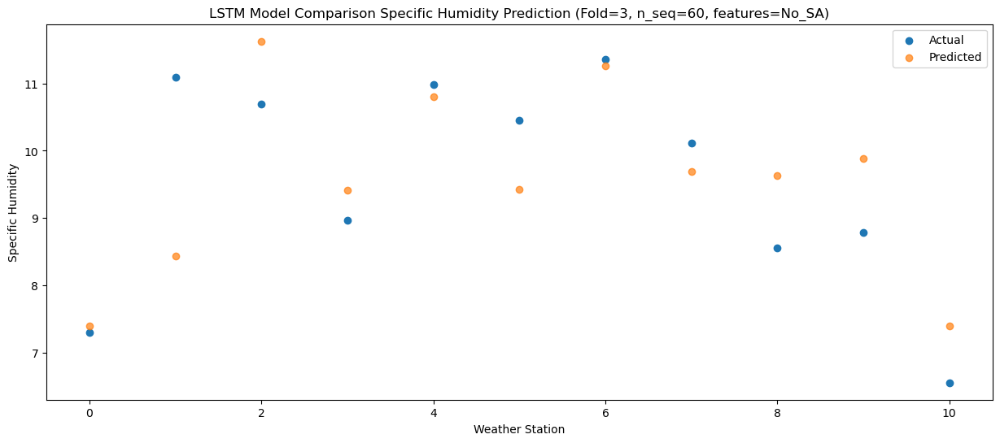

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    4.39   5.416523
1                 1    7.03   6.456523
2                 2    9.16   9.656523
3                 3    6.49   7.436523
4                 4    6.87   8.836523
5                 5    7.22   7.456523
6                 6    8.74   9.286523
7                 7    9.17   7.716523
8                 8    8.00   7.656523
9                 9    7.82   7.906523
10               10    4.86   5.416523


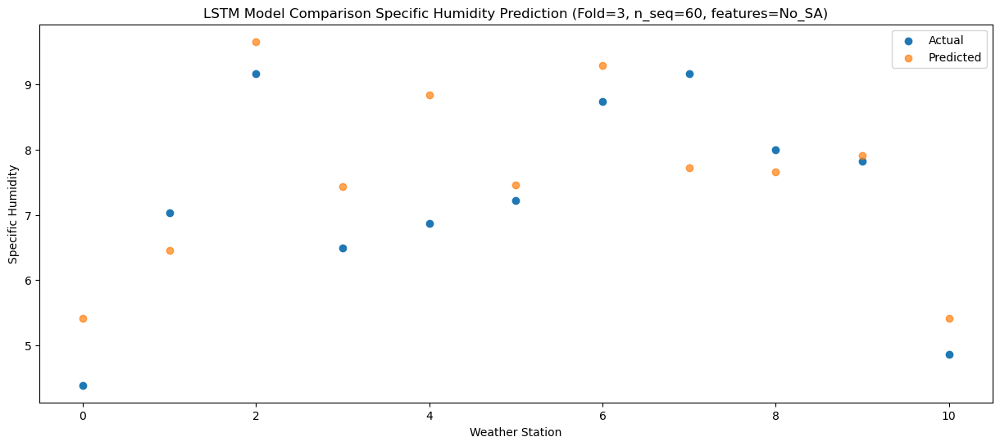

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    0.28   1.880845
1                 1    3.59   2.920845
2                 2    8.00   6.120845
3                 3    2.96   3.900845
4                 4    3.25   5.300845
5                 5    3.84   3.920845
6                 6    7.49   5.750845
7                 7    6.11   4.180845
8                 8    6.57   4.120845
9                 9    4.43   4.370845
10               10    1.59   1.880845


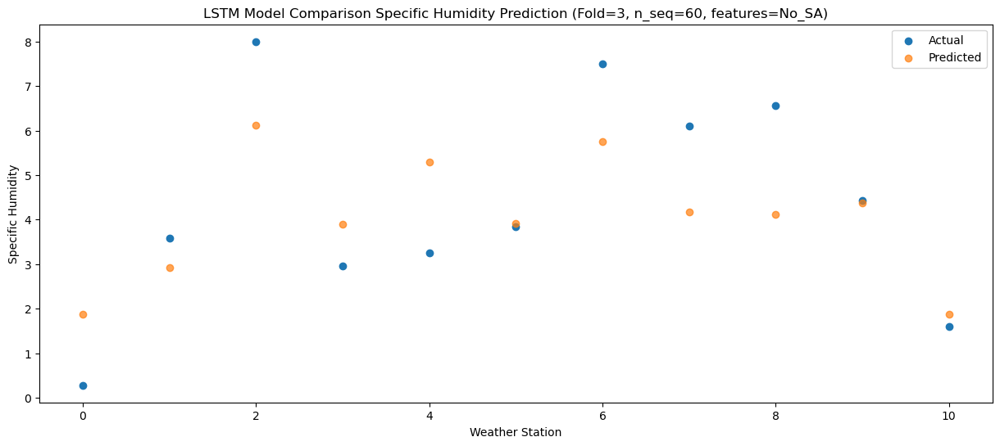

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0   -2.95  -0.593757
1                 1    0.71   0.446243
2                 2    5.89   3.646243
3                 3   -0.43   1.426243
4                 4    0.08   2.826243
5                 5    0.65   1.446243
6                 6    6.16   3.276243
7                 7    5.10   1.706243
8                 8    5.48   1.646243
9                 9    0.63   1.896243
10               10   -2.09  -0.593757


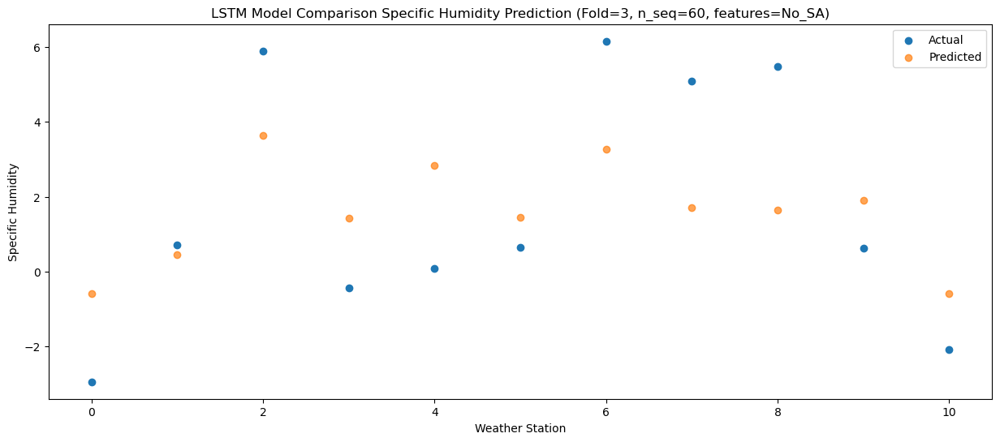

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -2.96  -1.783237
1                 1   -0.11  -0.743237
2                 2    6.12   2.456763
3                 3   -0.41   0.236763
4                 4   -0.33   1.636763
5                 5    0.61   0.256763
6                 6    6.03   2.086763
7                 7    5.02   0.516763
8                 8    5.86   0.456763
9                 9    0.96   0.706763
10               10   -1.71  -1.783237


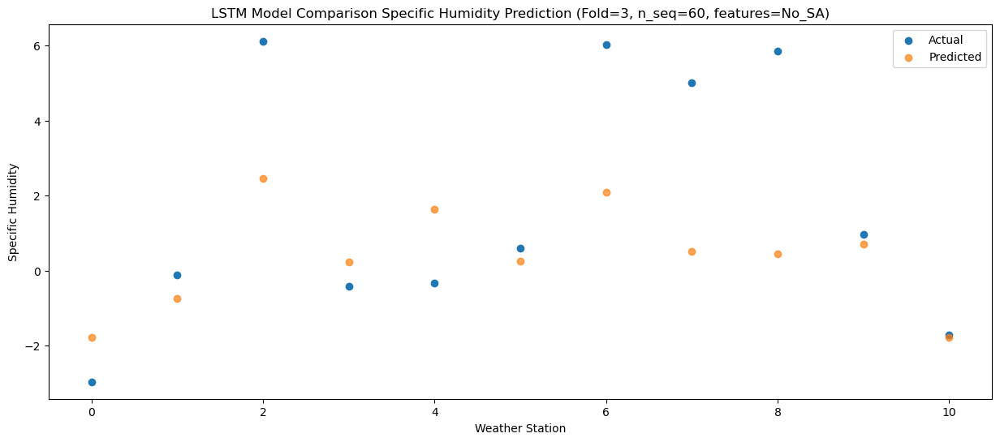

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -3.61  -3.060813
1                 1   -1.42  -2.020813
2                 2    6.66   1.179187
3                 3   -1.15  -1.040813
4                 4   -1.20   0.359187
5                 5   -0.27  -1.020813
6                 6    5.97   0.809187
7                 7    5.56  -0.760813
8                 8    5.87  -0.820813
9                 9   -0.34  -0.570813
10               10   -2.84  -3.060813


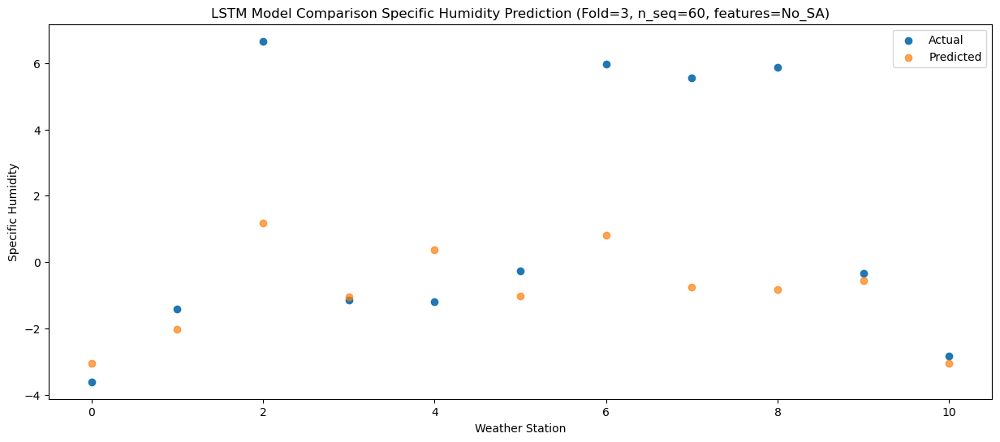

Predictions for (t+51):
    Weather_Station        Actual  Predicted
0                 0 -3.550000e+00  -1.276946
1                 1 -3.552714e-15  -0.236946
2                 2  6.830000e+00   2.963054
3                 3 -8.300000e-01   0.743054
4                 4 -2.900000e-01   2.143054
5                 5  3.100000e-01   0.763054
6                 6  6.040000e+00   2.593054
7                 7  6.380000e+00   1.023054
8                 8  5.560000e+00   0.963054
9                 9 -4.400000e-01   1.213054
10               10 -2.930000e+00  -1.276946


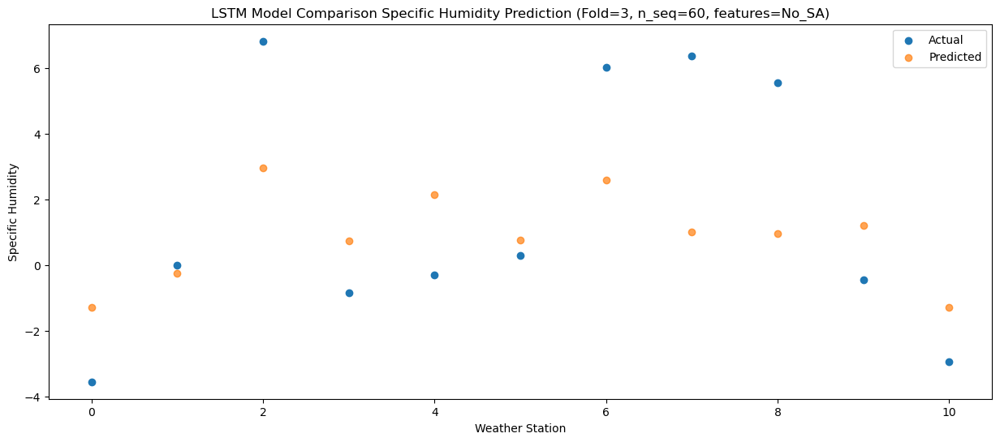

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0   -2.05   0.464899
1                 1    1.42   1.504899
2                 2    6.54   4.704899
3                 3    0.13   2.484899
4                 4    0.75   3.884899
5                 5    1.39   2.504899
6                 6    6.40   4.334899
7                 7    5.70   2.764899
8                 8    5.36   2.704899
9                 9    0.61   2.954899
10               10   -1.88   0.464899


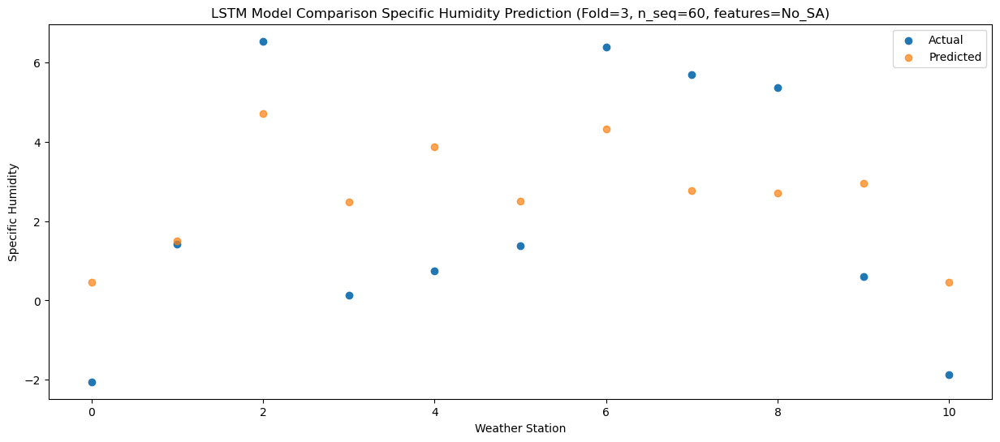

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0   -0.01   3.210158
1                 1    2.96   4.250158
2                 2    7.22   7.450158
3                 3    2.04   5.230158
4                 4    2.57   6.630158
5                 5    3.64   5.250158
6                 6    7.08   7.080158
7                 7    5.40   5.510158
8                 8    5.80   5.450158
9                 9    1.52   5.700158
10               10   -0.28   3.210158


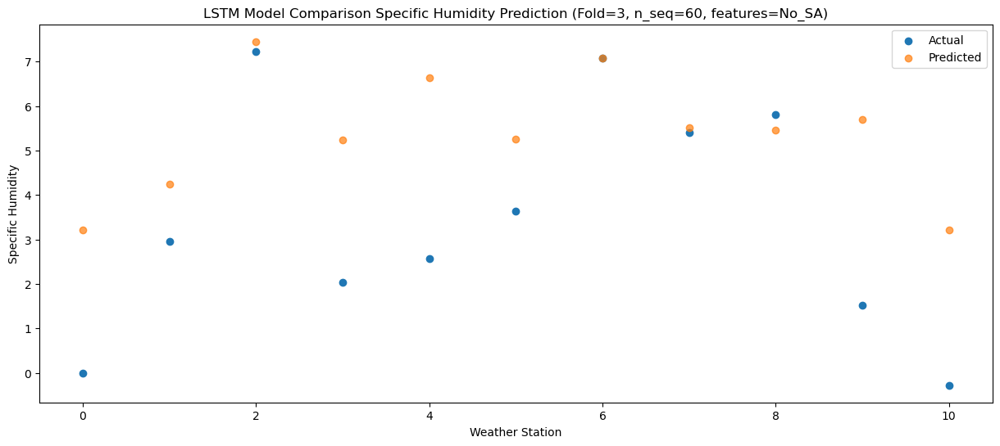

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    3.86   7.769968
1                 1    7.46   8.809968
2                 2    7.09  12.009968
3                 3    6.15   9.789968
4                 4    6.71  11.189968
5                 5    7.31   9.809968
6                 6    7.97  11.639968
7                 7    5.27  10.069968
8                 8    5.96  10.009968
9                 9    4.98  10.259968
10               10    3.35   7.769968


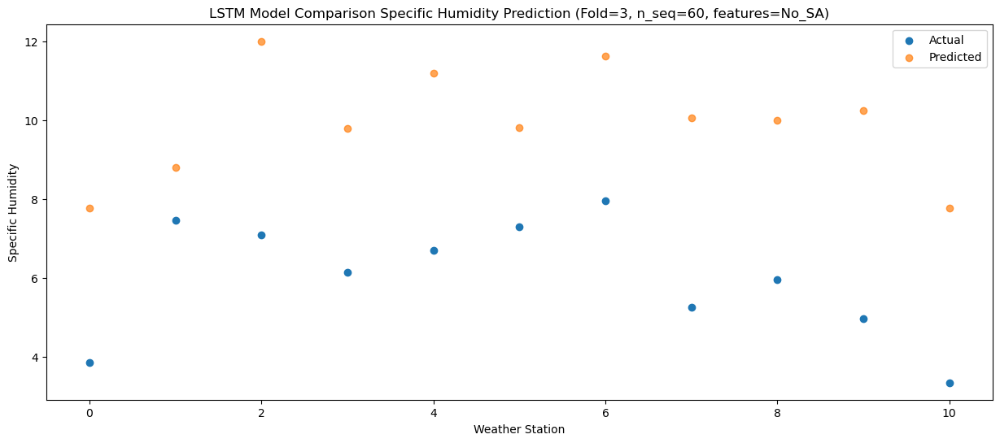

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0    5.59   9.429949
1                 1    9.74  10.469949
2                 2    8.36  13.669949
3                 3    7.95  11.449949
4                 4    8.68  12.849949
5                 5    9.13  11.469949
6                 6   10.26  13.299949
7                 7    6.67  11.729949
8                 8    7.11  11.669949
9                 9    7.85  11.919949
10               10    5.03   9.429949


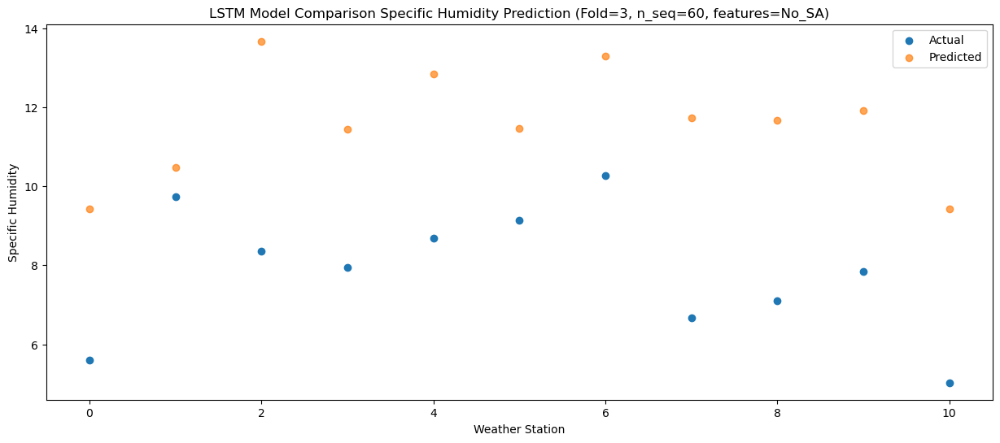

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0    8.45    10.2307
1                 1   10.23    11.2707
2                 2   10.34    14.4707
3                 3    8.85    12.2507
4                 4   10.25    13.6507
5                 5   10.32    12.2707
6                 6   10.31    14.1007
7                 7    7.70    12.5307
8                 8    8.69    12.4707
9                 9   11.02    12.7207
10               10    7.91    10.2307


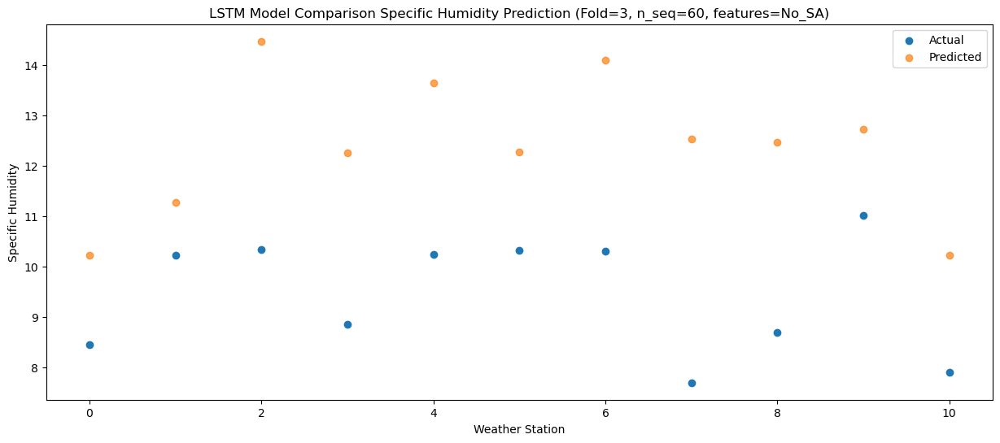

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0    7.01  10.086952
1                 1    9.49  11.126952
2                 2    8.65  14.326952
3                 3    7.53  12.106952
4                 4    9.77  13.506952
5                 5    9.76  12.126952
6                 6   11.77  13.956952
7                 7    8.52  12.386952
8                 8    7.96  12.326952
9                 9    9.67  12.576952
10               10    6.63  10.086952


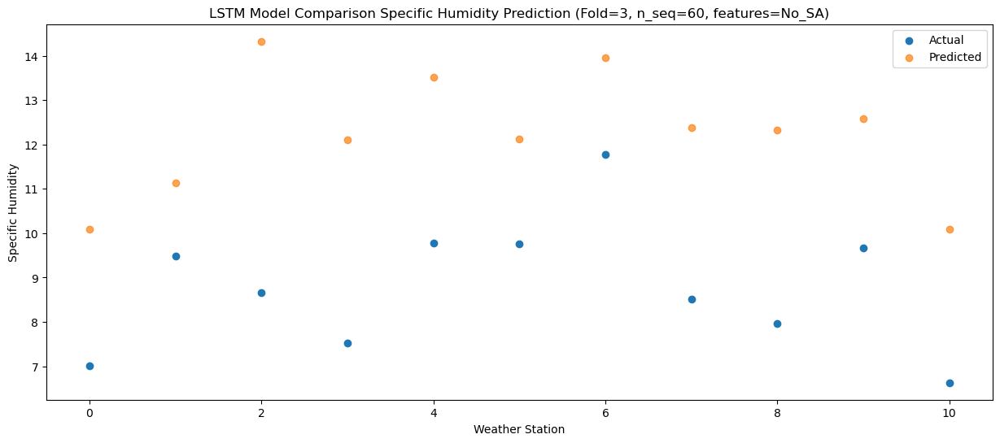

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    5.30   7.018905
1                 1    6.50   8.058905
2                 2    8.92  11.258905
3                 3    5.99   9.038905
4                 4    6.76  10.438905
5                 5    7.14   9.058905
6                 6    9.35  10.888905
7                 7    6.80   9.318905
8                 8    7.64   9.258905
9                 9    6.31   9.508905
10               10    3.81   7.018905


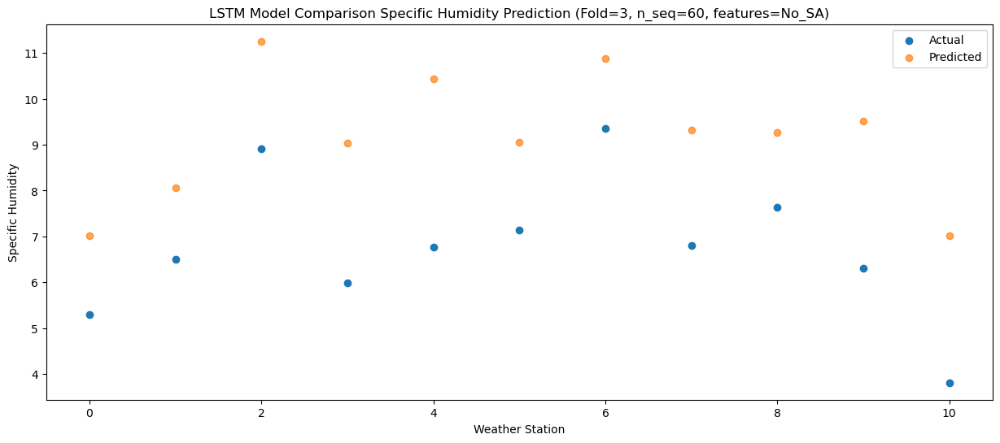

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    0.48    2.80718
1                 1    2.27    3.84718
2                 2    7.81    7.04718
3                 3    2.24    4.82718
4                 4    2.40    6.22718
5                 5    3.27    4.84718
6                 6    7.59    6.67718
7                 7    5.75    5.10718
8                 8    6.05    5.04718
9                 9    3.21    5.29718
10               10   -0.19    2.80718


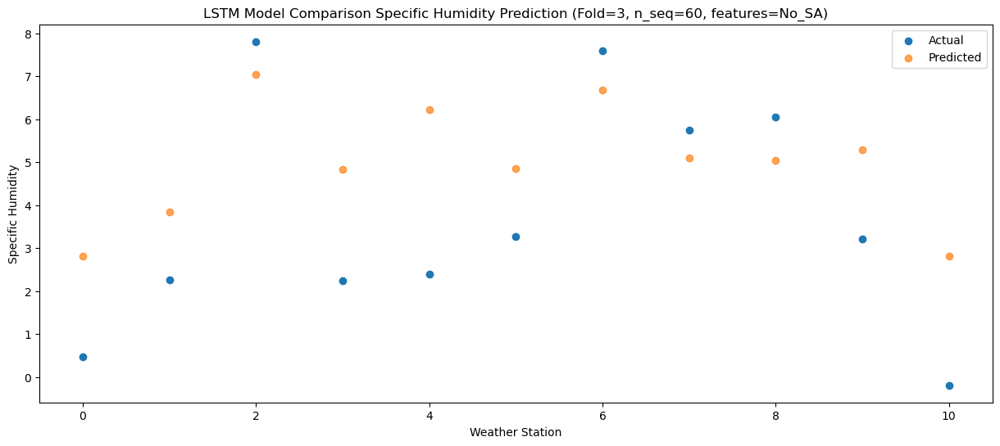

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_6 (LSTM)               (1, 1, 256)               2121728   
                                                                 
 dropout_6 (Dropout)         (1, 1, 256)               0         
                                                                 
 lstm_7 (LSTM)               (1, 256)                  525312    
                                                                 
 dropout_7 (Dropout)         (1, 256)                  0         
                                                                 
 dense_9 (Dense)             (1, 256)                  65792     
                                                                 
 dense_10 (Dense)            (1, 128)                  32896     
                                                                 
 dense_11 (Dense)            (1, 60)                  

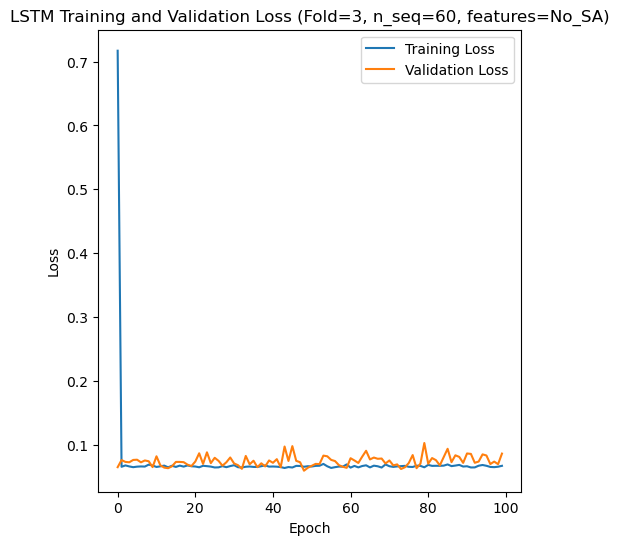

Epoch 1/100
84/84 [==============================] - 26s 91ms/step - loss: 0.6450 - accuracy: 0.3690 - mae: 0.5807 - rmse: 0.6450 - mape: 124.4855 - pearson: 0.6128 - val_loss: 0.0786 - val_accuracy: 0.0000e+00 - val_mae: 0.0622 - val_rmse: 0.0786 - val_mape: 13.4735 - val_pearson: 0.7503
Epoch 2/100
84/84 [==============================] - 2s 28ms/step - loss: 0.0695 - accuracy: 0.4524 - mae: 0.0549 - rmse: 0.0695 - mape: 12.4895 - pearson: 0.7607 - val_loss: 0.0726 - val_accuracy: 0.7000 - val_mae: 0.0576 - val_rmse: 0.0726 - val_mape: 12.6629 - val_pearson: 0.7292
Epoch 3/100
84/84 [==============================] - 2s 28ms/step - loss: 0.0670 - accuracy: 0.5119 - mae: 0.0525 - rmse: 0.0670 - mape: 11.8872 - pearson: 0.7676 - val_loss: 0.0683 - val_accuracy: 0.7000 - val_mae: 0.0536 - val_rmse: 0.0683 - val_mape: 11.5295 - val_pearson: 0.7746
Epoch 4/100
84/84 [==============================] - 3s 31ms/step - loss: 0.0782 - accuracy: 0.5119 - mae: 0.0630 - rmse: 0.0782 - mape: 14.28

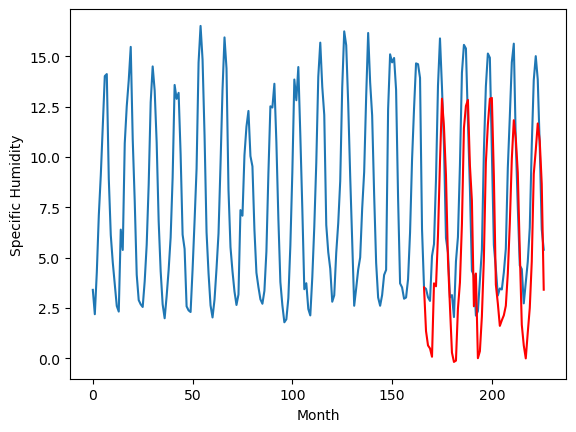

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.36		0.05		1.41
-1.22		-0.66		0.56
-2.78		-0.81		1.97
-1.94		-1.22		0.72
-0.56		2.42		2.98
0.65		2.28		1.63
1.30		4.81		3.51
4.63		8.46		3.83
6.37		11.59		5.22
6.61		10.18		3.57
6.03		7.79		1.76
3.99		3.61		-0.38
0.93		1.27		0.34
-3.81		-1.02		2.79
-3.46		-1.48		1.98
-1.47		-1.41		0.06
-1.50		1.17		2.67
-0.75		2.47		3.22
0.58		5.37		4.79
4.87		10.13		5.26
6.08		11.23		5.15
6.47		11.53		5.06
5.67		8.28		2.61
2.75		6.53		3.78
-1.91		1.28		3.19
-0.17		2.91		3.08
-4.03		-1.29		2.74
-2.45		-0.94		1.51
-0.92		0.78		1.70
0.37		3.65		3.28
2.76		8.43		5.67
5.66		10.30		4.64
6.69		11.59		4.90
6.77		11.63		4.86
5.90		7.77		1.87
1.12		2.36		1.24
1.29		1.42		0.13
-2.23		0.31		2.54
-2.74		0.59		3.33
-0.80		0.84		1.64
-0.42		1.31		1.73
1.07		2.92		1.85
1.87		5.39		3.52
5.38		8.60		3.22
7.29		10.52		3.23
7.59		9.62		2.03
5.14		7.91		2.77
1.52		4.02		2.50
-0.78		0.37		1.15
-1.87		-0.66		1.21
-2.91		-1.30		1

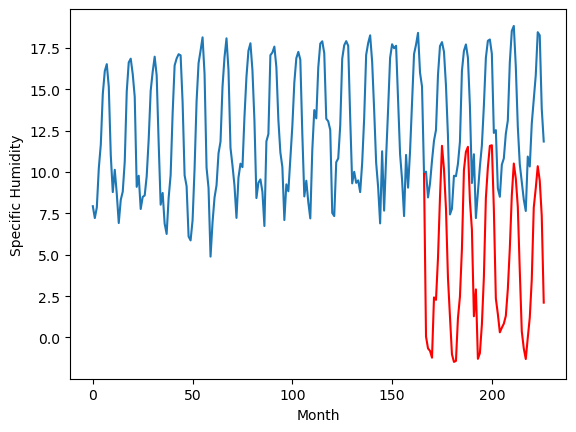

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.06		0.11		1.17
-0.22		-0.60		-0.38
-0.36		-0.75		-0.39
-0.55		-1.16		-0.61
3.00		2.48		-0.52
1.88		2.34		0.46
4.12		4.87		0.75
7.42		8.52		1.10
10.35		11.65		1.30
8.84		10.24		1.40
6.79		7.85		1.06
3.44		3.67		0.23
0.77		1.33		0.56
-1.61		-0.96		0.65
-1.72		-1.42		0.30
-1.84		-1.35		0.49
1.22		1.23		0.01
1.47		2.53		1.06
4.91		5.43		0.52
9.15		10.19		1.04
10.80		11.29		0.49
10.81		11.59		0.78
7.87		8.34		0.47
5.09		6.59		1.50
-0.35		1.34		1.69
2.60		2.97		0.37
-2.13		-1.23		0.90
-1.28		-0.88		0.40
-0.23		0.84		1.07
2.22		3.71		1.49
6.82		8.49		1.67
9.20		10.36		1.16
11.04		11.65		0.61
10.86		11.69		0.83
6.62		7.83		1.21
1.66		2.42		0.76
0.91		1.48		0.57
0.37		0.37		0.00
0.27		0.65		0.38
0.94		0.90		-0.04
1.27		1.37		0.10
2.11		2.98		0.87
5.49		5.45		-0.04
9.06		8.66		-0.40
10.65		10.58		-0.07
9.07		9.68		0.61
6.05		7.97		1.92
2.12		4.08		1.96
0.14		0.43		0.29
-1.17		-0.60		0.57
-1.89		-1.2

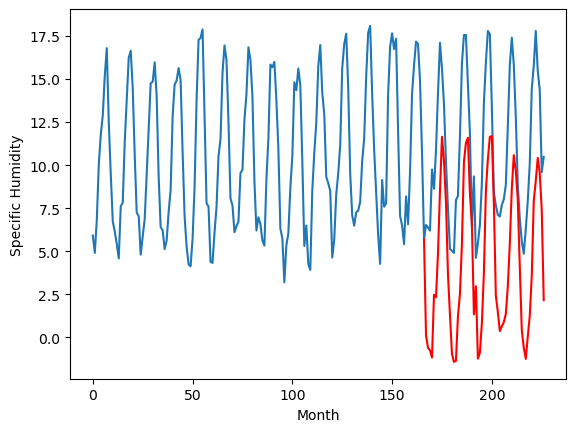

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.12		-0.03		-1.15
0.12		-0.74		-0.86
0.76		-0.89		-1.65
0.14		-1.30		-1.44
4.09		2.34		-1.75
3.69		2.20		-1.49
6.85		4.73		-2.12
9.01		8.38		-0.63
12.24		11.51		-0.73
9.65		10.10		0.45
8.44		7.71		-0.73
3.87		3.53		-0.34
2.23		1.19		-1.04
-0.37		-1.10		-0.73
-0.48		-1.56		-1.08
-0.80		-1.49		-0.69
1.86		1.09		-0.77
3.15		2.39		-0.76
7.15		5.29		-1.86
10.84		10.05		-0.79
11.41		11.15		-0.26
11.80		11.45		-0.35
7.79		8.20		0.41
4.94		6.45		1.51
1.32		1.20		-0.12
3.18		2.83		-0.35
-1.48		-1.37		0.11
-0.95		-1.02		-0.07
0.64		0.70		0.06
4.15		3.57		-0.58
8.14		8.35		0.21
9.91		10.22		0.31
9.33		11.51		2.18
10.34		11.55		1.21
7.06		7.69		0.63
2.60		2.28		-0.32
2.42		1.34		-1.08
0.84		0.23		-0.61
0.15		0.51		0.36
0.51		0.76		0.25
2.57		1.23		-1.34
3.25		2.84		-0.41
7.51		5.31		-2.20
11.45		8.52		-2.93
11.30		10.44		-0.86
9.20		9.54		0.34
8.30		7.83		-0.47
4.58		3.94		-0.64
2.05		0.29		-1.76
0.30		

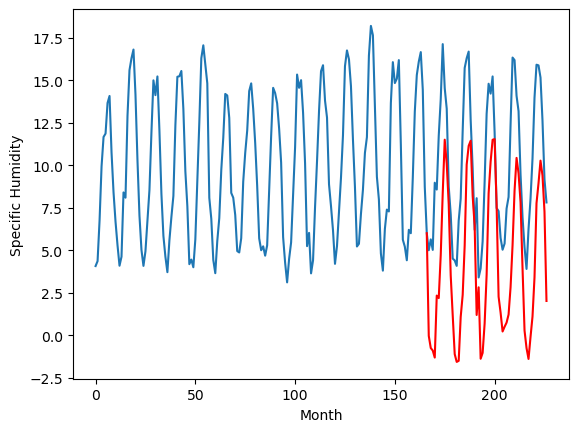

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.61		-0.47		-1.08
-0.36		-1.18		-0.82
0.33		-1.33		-1.66
-0.33		-1.74		-1.41
3.57		1.90		-1.67
3.06		1.76		-1.30
6.30		4.29		-2.01
8.28		7.94		-0.34
11.43		11.07		-0.36
8.78		9.66		0.88
7.89		7.27		-0.62
3.12		3.09		-0.03
1.76		0.75		-1.01
-0.81		-1.54		-0.73
-0.85		-2.00		-1.15
-1.30		-1.93		-0.63
1.28		0.65		-0.63
2.64		1.95		-0.69
6.93		4.85		-2.08
10.81		9.61		-1.20
11.19		10.71		-0.48
11.30		11.01		-0.29
7.40		7.76		0.36
4.67		6.01		1.34
1.06		0.76		-0.30
2.47		2.39		-0.08
-1.86		-1.81		0.05
-1.42		-1.46		-0.04
0.10		0.26		0.16
3.78		3.13		-0.65
7.66		7.91		0.25
9.34		9.78		0.44
8.84		11.07		2.23
10.01		11.11		1.10
6.86		7.25		0.39
2.40		1.84		-0.56
1.98		0.90		-1.08
0.39		-0.21		-0.60
-0.36		0.07		0.43
0.04		0.32		0.28
2.01		0.79		-1.22
2.86		2.40		-0.46
7.13		4.87		-2.26
10.61		8.08		-2.53
9.71		10.00		0.29
8.33		9.10		0.77
8.00		7.39		-0.61
4.34		3.50		-0.84
1.92		-0.15		-2.07
0.16		

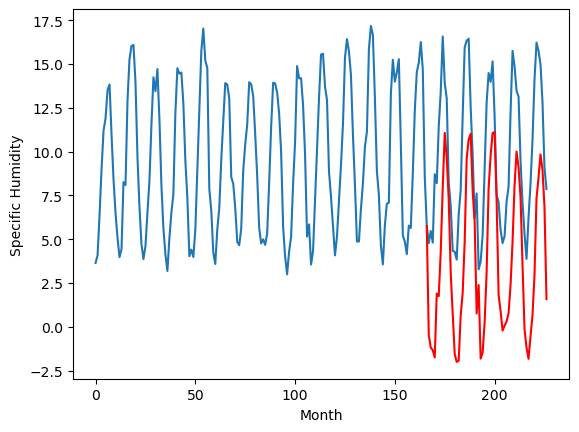

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
6.92		4.07		-2.85
5.68		3.36		-2.32
5.56		3.21		-2.35
5.44		2.80		-2.64
8.24		6.44		-1.80
7.49		6.30		-1.19
9.76		8.83		-0.93
11.47		12.48		1.01
12.70		15.61		2.91
11.39		14.20		2.81
11.20		11.81		0.61
7.55		7.63		0.08
7.09		5.29		-1.80
4.53		3.00		-1.53
5.23		2.54		-2.69
4.59		2.61		-1.98
6.08		5.19		-0.89
7.04		6.49		-0.55
11.59		9.39		-2.20
13.89		14.15		0.26
14.92		15.25		0.33
14.64		15.55		0.91
11.39		12.30		0.91
8.34		10.55		2.21
6.62		5.30		-1.32
5.77		6.93		1.16
4.31		2.73		-1.58
4.30		3.08		-1.22
4.89		4.80		-0.09
6.92		7.67		0.75
9.18		12.45		3.27
12.03		14.32		2.29
12.72		15.61		2.89
14.71		15.65		0.94
13.46		11.79		-1.67
9.95		6.38		-3.57
7.25		5.44		-1.81
6.61		4.33		-2.28
5.06		4.61		-0.45
5.18		4.86		-0.32
6.47		5.33		-1.14
6.44		6.94		0.50
11.28		9.41		-1.87
15.14		12.62		-2.52
12.81		14.54		1.73
11.95		13.64		1.69
12.46		11.93		-0.53
10.33		8.04		-2.29
8.03		4.39		-3.64
6.45	

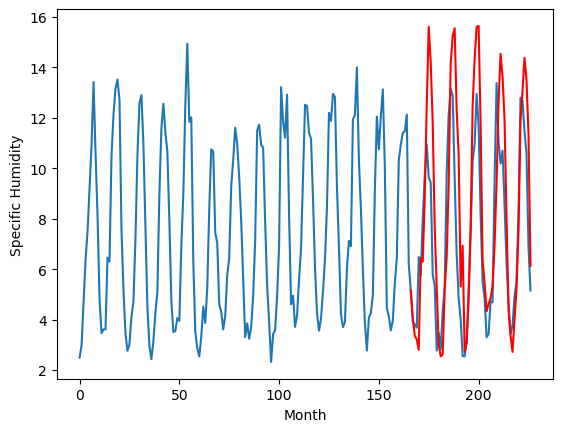

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.46		2.05		1.59
0.53		1.34		0.81
0.37		1.19		0.82
0.95		0.78		-0.17
3.14		4.42		1.28
2.47		4.28		1.81
5.59		6.81		1.22
9.42		10.46		1.04
12.01		13.59		1.58
12.22		12.18		-0.04
8.38		9.79		1.41
5.73		5.61		-0.12
2.90		3.27		0.37
-0.44		0.98		1.42
-0.56		0.52		1.08
-0.31		0.59		0.90
1.40		3.17		1.77
1.81		4.47		2.66
4.79		7.37		2.58
9.48		12.13		2.65
11.08		13.23		2.15
11.46		13.53		2.07
7.88		10.28		2.40
5.67		8.53		2.86
-0.05		3.28		3.33
1.81		4.91		3.10
-1.17		0.71		1.88
0.15		1.06		0.91
0.99		2.78		1.79
2.05		5.65		3.60
6.06		10.43		4.37
8.34		12.30		3.96
11.50		13.59		2.09
10.31		13.63		3.32
6.76		9.77		3.01
2.08		4.36		2.28
1.90		3.42		1.52
-0.09		2.31		2.40
0.54		2.59		2.05
1.58		2.84		1.26
1.07		3.31		2.24
2.67		4.92		2.25
4.89		7.39		2.50
7.94		10.60		2.66
11.33		12.52		1.19
10.87		11.62		0.75
7.42		9.91		2.49
3.51		6.02		2.51
0.56		2.37		1.81
0.28		1.34		1.06
-0.50		0.70		1.20
-0.32	

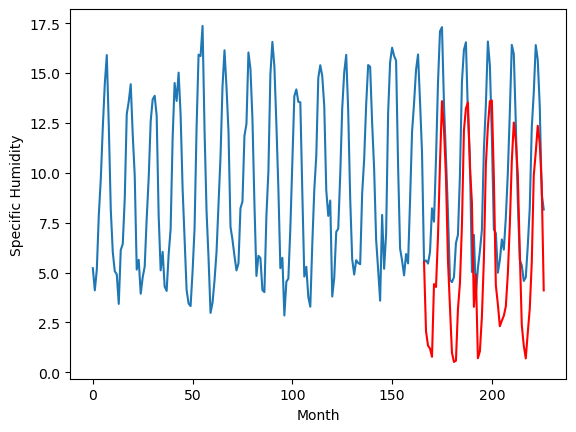

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.67		0.21		-0.46
0.40		-0.50		-0.90
0.16		-0.65		-0.81
-0.07		-1.06		-0.99
2.48		2.58		0.10
2.80		2.44		-0.36
6.18		4.97		-1.21
9.79		8.62		-1.17
11.84		11.75		-0.09
9.19		10.34		1.15
7.59		7.95		0.36
3.04		3.77		0.73
1.37		1.43		0.06
-0.56		-0.86		-0.30
-0.71		-1.32		-0.61
-1.34		-1.25		0.09
1.03		1.33		0.30
1.95		2.63		0.68
5.11		5.53		0.42
9.71		10.29		0.58
10.66		11.39		0.73
10.40		11.69		1.29
7.14		8.44		1.30
5.05		6.69		1.64
0.36		1.44		1.08
1.83		3.07		1.24
-1.37		-1.13		0.24
-0.86		-0.78		0.08
0.65		0.94		0.29
2.44		3.81		1.37
7.15		8.59		1.44
9.51		10.46		0.95
10.31		11.75		1.44
10.78		11.79		1.01
6.97		7.93		0.96
2.31		2.52		0.21
0.95		1.58		0.63
0.08		0.47		0.39
0.36		0.75		0.39
0.17		1.00		0.83
0.93		1.47		0.54
1.83		3.08		1.25
6.22		5.55		-0.67
8.78		8.76		-0.02
11.57		10.68		-0.89
11.85		9.78		-2.07
7.65		8.07		0.42
4.04		4.18		0.14
1.01		0.53		-0.48
0.20		-0.50		-0.70
-0.95		-

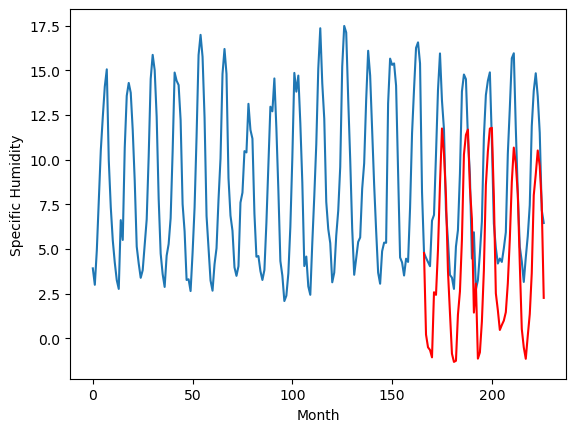

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.13		-0.22		-0.35
0.30		-0.93		-1.23
-0.07		-1.08		-1.01
-0.47		-1.49		-1.02
1.45		2.15		0.70
1.73		2.01		0.28
4.88		4.54		-0.34
7.62		8.19		0.57
10.84		11.32		0.48
9.17		9.91		0.74
6.25		7.52		1.27
2.87		3.34		0.47
1.19		1.00		-0.19
-0.41		-1.29		-0.88
-0.76		-1.75		-0.99
-1.33		-1.68		-0.35
0.61		0.90		0.29
1.94		2.20		0.26
4.23		5.10		0.87
9.29		9.86		0.57
10.55		10.96		0.41
10.69		11.26		0.57
7.21		8.01		0.80
6.06		6.26		0.20
0.29		1.01		0.72
1.00		2.64		1.64
-1.38		-1.56		-0.18
-0.80		-1.21		-0.41
0.51		0.51		0.00
2.00		3.38		1.38
6.02		8.16		2.14
7.46		10.03		2.57
10.20		11.32		1.12
9.84		11.36		1.52
7.18		7.50		0.32
1.85		2.09		0.24
0.81		1.15		0.34
-0.15		0.04		0.19
0.47		0.32		-0.15
0.07		0.57		0.50
0.42		1.04		0.62
1.87		2.65		0.78
4.12		5.12		1.00
6.08		8.33		2.25
10.38		10.25		-0.13
9.84		9.35		-0.49
7.04		7.64		0.60
3.71		3.75		0.04
0.64		0.10		-0.54
0.61		-0.93		-1.54
-0.47		-1

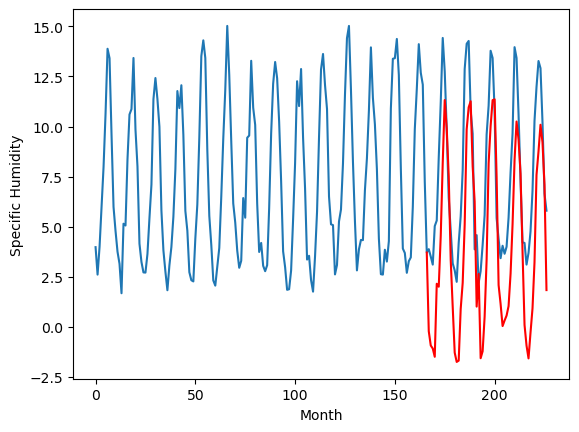

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.54		-1.38		-0.84
-0.37		-2.09		-1.72
-0.85		-2.24		-1.39
-1.12		-2.65		-1.53
0.93		0.99		0.06
1.52		0.85		-0.67
5.24		3.38		-1.86
7.72		7.03		-0.69
11.28		10.16		-1.12
9.09		8.75		-0.34
6.31		6.36		0.05
2.15		2.18		0.03
1.06		-0.16		-1.22
-0.85		-2.45		-1.60
-1.17		-2.91		-1.74
-1.81		-2.84		-1.03
0.56		-0.26		-0.82
1.87		1.04		-0.83
4.49		3.94		-0.55
9.24		8.70		-0.54
10.64		9.80		-0.84
10.89		10.10		-0.79
6.86		6.85		-0.01
4.99		5.10		0.11
-0.30		-0.15		0.15
0.24		1.48		1.24
-2.00		-2.72		-0.72
-1.30		-2.37		-1.07
0.22		-0.65		-0.87
1.52		2.22		0.70
5.59		7.00		1.41
7.83		8.87		1.04
10.47		10.16		-0.31
9.70		10.20		0.50
6.33		6.34		0.01
1.57		0.93		-0.64
0.20		-0.01		-0.21
-0.91		-1.12		-0.21
-0.39		-0.84		-0.45
-0.62		-0.59		0.03
-0.01		-0.12		-0.11
1.50		1.49		-0.01
4.28		3.96		-0.32
5.92		7.17		1.25
10.62		9.09		-1.53
10.49		8.19		-2.30
6.71		6.48		-0.23
3.27		2.59		-0.68
-0.12		-1.0

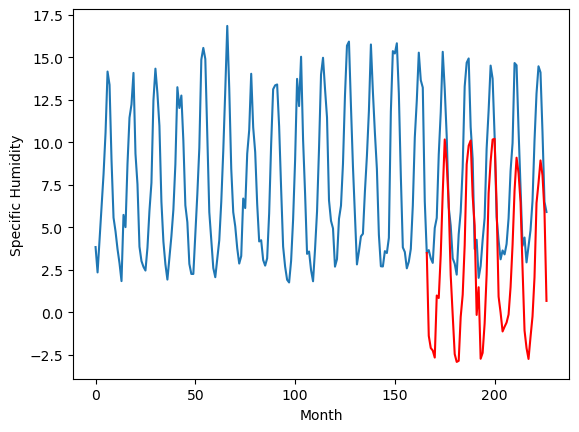

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.53		1.35		-0.18
1.68		0.64		-1.04
1.34		0.49		-0.85
0.99		0.08		-0.91
2.56		3.72		1.16
2.40		3.58		1.18
5.02		6.11		1.09
8.21		9.76		1.55
11.13		12.89		1.76
9.71		11.48		1.77
7.57		9.09		1.52
4.53		4.91		0.38
2.60		2.57		-0.03
1.27		0.28		-0.99
0.89		-0.18		-1.07
0.32		-0.11		-0.43
1.61		2.47		0.86
3.28		3.77		0.49
4.88		6.67		1.79
9.89		11.43		1.54
11.16		12.53		1.37
12.03		12.83		0.80
8.27		9.58		1.31
7.26		7.83		0.57
2.02		2.58		0.56
1.98		4.21		2.23
0.24		0.01		-0.23
0.69		0.36		-0.33
1.84		2.08		0.24
2.83		4.95		2.12
6.29		9.73		3.44
8.20		11.60		3.40
9.93		12.89		2.96
10.39		12.93		2.54
8.40		9.07		0.67
3.58		3.66		0.08
2.86		2.72		-0.14
1.41		1.61		0.20
2.03		1.89		-0.14
1.28		2.14		0.86
1.49		2.61		1.12
3.19		4.22		1.03
4.09		6.69		2.60
7.33		9.90		2.57
10.95		11.82		0.87
10.15		10.92		0.77
8.44		9.21		0.77
5.38		5.32		-0.06
1.94		1.67		-0.27
2.46		0.64		-1.82
1.39		-0.00		-1.39
1.

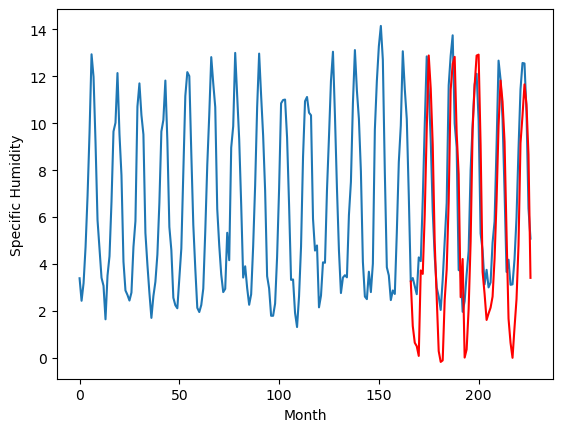

RangeIndex(start=1, stop=12, step=1)
[2.3299999999999996, -1.3599999999999994, -1.06, 1.1199999999999997, 0.6100000000000012, 6.92, 0.45999999999999996, 0.6700000000000013, 0.1299999999999999, -0.5399999999999991, 1.529999999999999]
[1.3536500644683835, 0.05365006446838372, 0.11365006446838377, -0.026349935531616353, -0.4663499355316163, 4.073650064468384, 2.0536500644683837, 0.21365006446838386, -0.2163499355316163, -1.376349935531616, 1.3536500644683835]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    2.33    1.35365
1                 1   -1.36    0.05365
2                 2   -1.06    0.11365
3                 3    1.12   -0.02635
4                 4    0.61   -0.46635
5                 5    6.92    4.07365
6                 6    0.46    2.05365
7                 7    0.67    0.21365
8                 8    0.13   -0.21635
9                 9   -0.54   -1.37635
10               10    1.53    1.35365


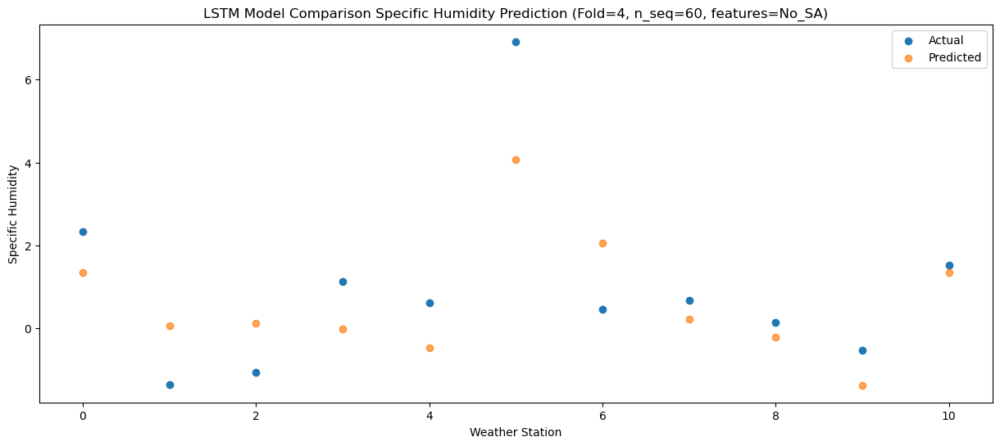

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    2.26   0.641205
1                 1   -1.22  -0.658795
2                 2   -0.22  -0.598795
3                 3    0.12  -0.738795
4                 4   -0.36  -1.178795
5                 5    5.68   3.361205
6                 6    0.53   1.341205
7                 7    0.40  -0.498795
8                 8    0.30  -0.928795
9                 9   -0.37  -2.088795
10               10    1.68   0.641205


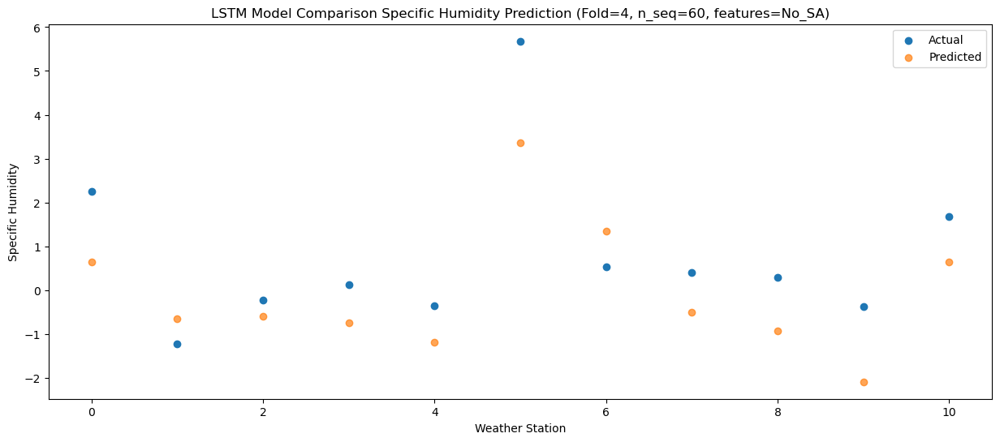

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0    1.84   0.490812
1                 1   -2.78  -0.809188
2                 2   -0.36  -0.749188
3                 3    0.76  -0.889188
4                 4    0.33  -1.329188
5                 5    5.56   3.210812
6                 6    0.37   1.190812
7                 7    0.16  -0.649188
8                 8   -0.07  -1.079188
9                 9   -0.85  -2.239188
10               10    1.34   0.490812


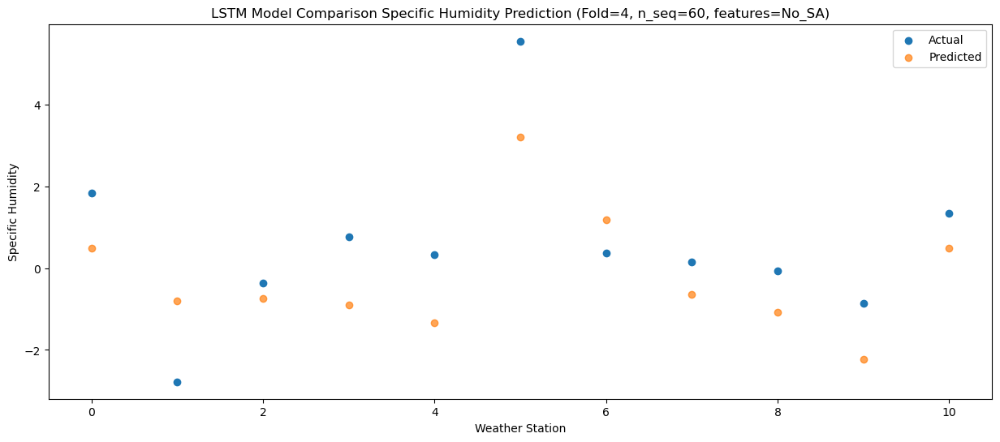

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0    1.66   0.079499
1                 1   -1.94  -1.220501
2                 2   -0.55  -1.160501
3                 3    0.14  -1.300501
4                 4   -0.33  -1.740501
5                 5    5.44   2.799499
6                 6    0.95   0.779499
7                 7   -0.07  -1.060501
8                 8   -0.47  -1.490501
9                 9   -1.12  -2.650501
10               10    0.99   0.079499


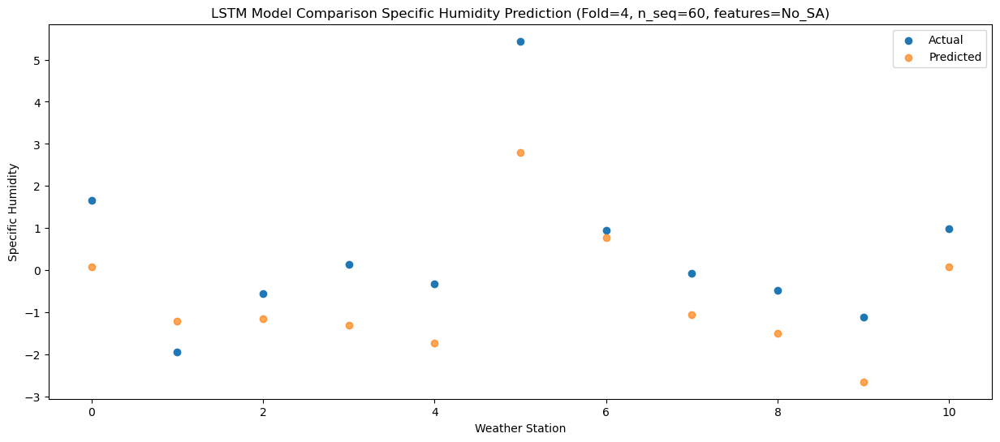

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    3.89   3.723913
1                 1   -0.56   2.423913
2                 2    3.00   2.483913
3                 3    4.09   2.343913
4                 4    3.57   1.903913
5                 5    8.24   6.443913
6                 6    3.14   4.423913
7                 7    2.48   2.583913
8                 8    1.45   2.153913
9                 9    0.93   0.993913
10               10    2.56   3.723913


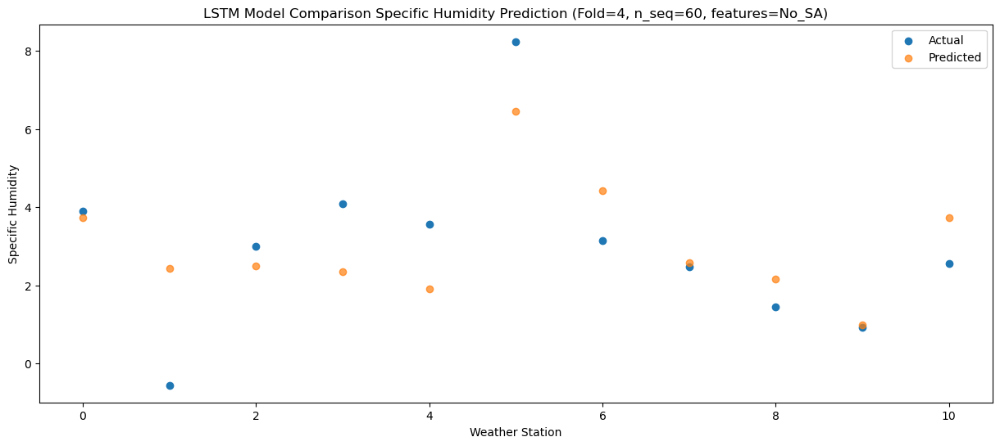

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    4.48   3.575583
1                 1    0.65   2.275583
2                 2    1.88   2.335583
3                 3    3.69   2.195583
4                 4    3.06   1.755583
5                 5    7.49   6.295583
6                 6    2.47   4.275583
7                 7    2.80   2.435583
8                 8    1.73   2.005583
9                 9    1.52   0.845583
10               10    2.40   3.575583


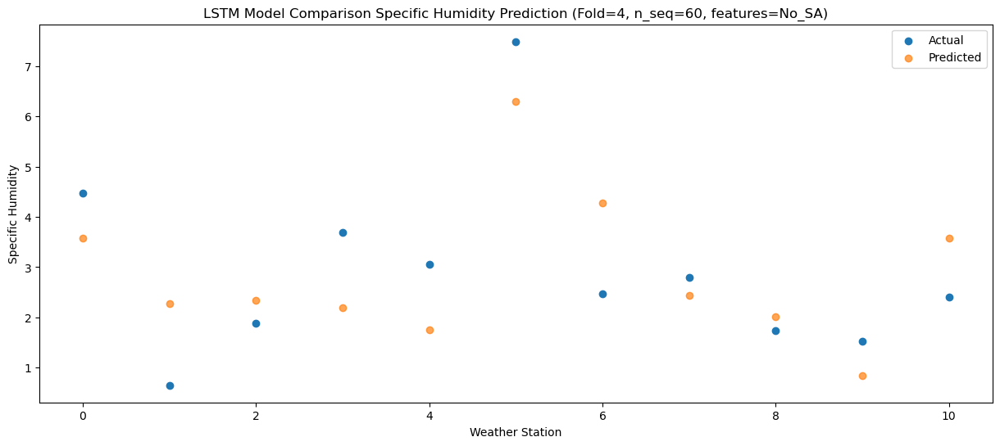

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    7.69   6.111552
1                 1    1.30   4.811552
2                 2    4.12   4.871552
3                 3    6.85   4.731552
4                 4    6.30   4.291552
5                 5    9.76   8.831552
6                 6    5.59   6.811552
7                 7    6.18   4.971552
8                 8    4.88   4.541552
9                 9    5.24   3.381552
10               10    5.02   6.111552


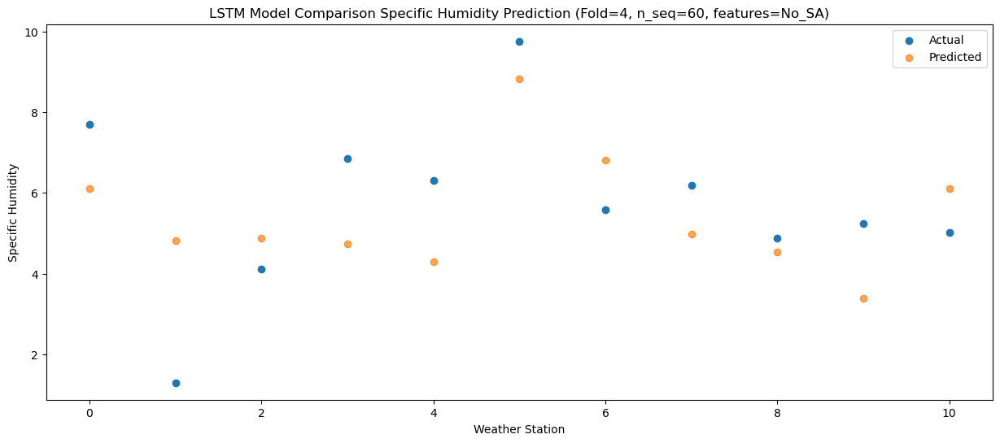

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   12.34    9.75808
1                 1    4.63    8.45808
2                 2    7.42    8.51808
3                 3    9.01    8.37808
4                 4    8.28    7.93808
5                 5   11.47   12.47808
6                 6    9.42   10.45808
7                 7    9.79    8.61808
8                 8    7.62    8.18808
9                 9    7.72    7.02808
10               10    8.21    9.75808


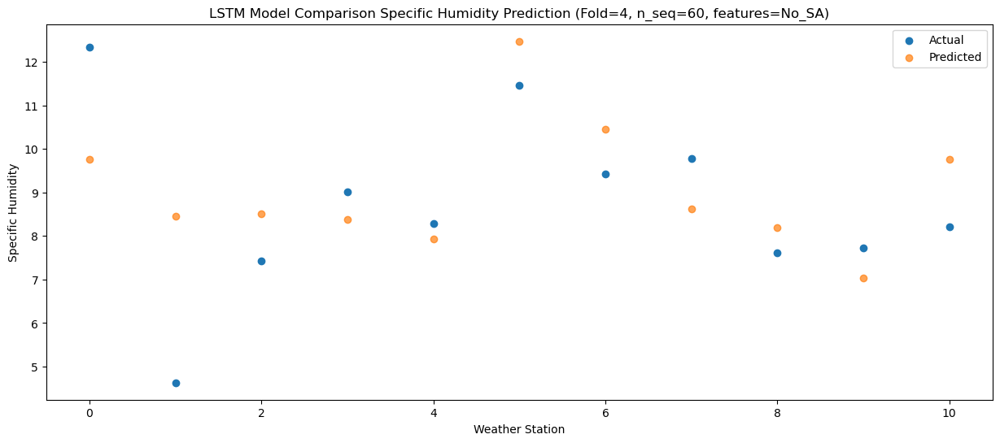

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   14.69   12.89006
1                 1    6.37   11.59006
2                 2   10.35   11.65006
3                 3   12.24   11.51006
4                 4   11.43   11.07006
5                 5   12.70   15.61006
6                 6   12.01   13.59006
7                 7   11.84   11.75006
8                 8   10.84   11.32006
9                 9   11.28   10.16006
10               10   11.13   12.89006


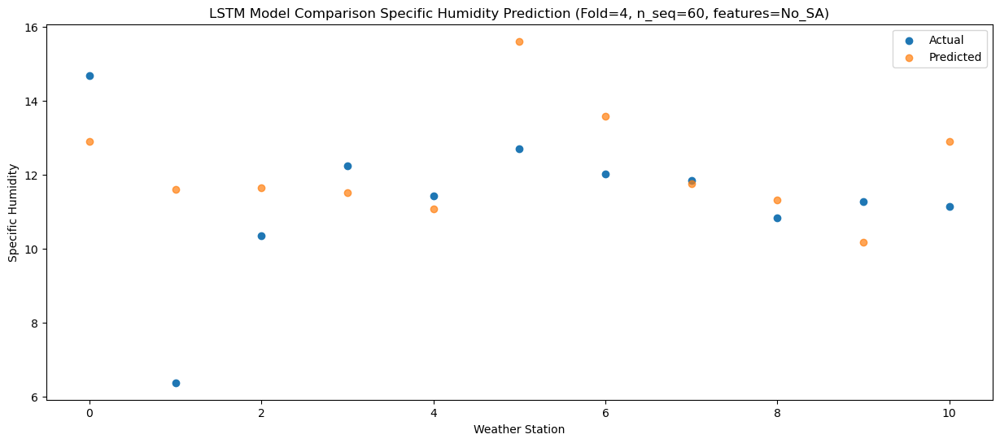

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   12.26   11.48237
1                 1    6.61   10.18237
2                 2    8.84   10.24237
3                 3    9.65   10.10237
4                 4    8.78    9.66237
5                 5   11.39   14.20237
6                 6   12.22   12.18237
7                 7    9.19   10.34237
8                 8    9.17    9.91237
9                 9    9.09    8.75237
10               10    9.71   11.48237


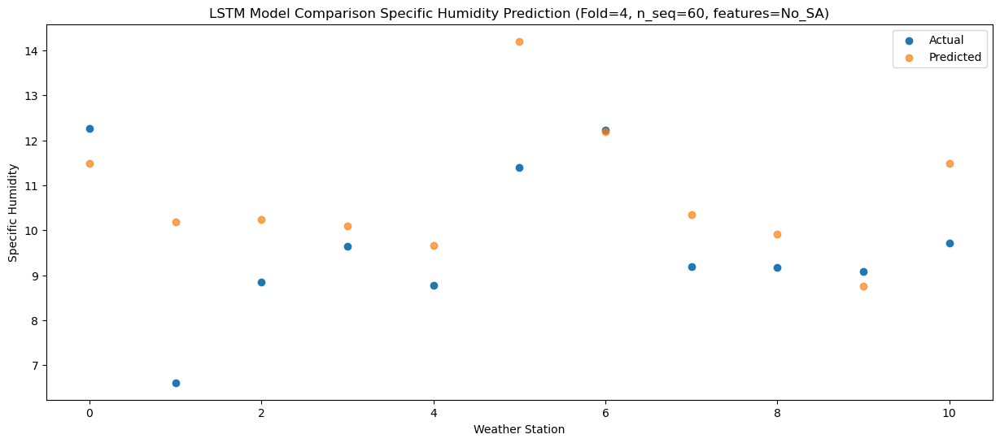

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    9.37   9.088842
1                 1    6.03   7.788842
2                 2    6.79   7.848842
3                 3    8.44   7.708842
4                 4    7.89   7.268842
5                 5   11.20  11.808842
6                 6    8.38   9.788842
7                 7    7.59   7.948842
8                 8    6.25   7.518842
9                 9    6.31   6.358842
10               10    7.57   9.088842


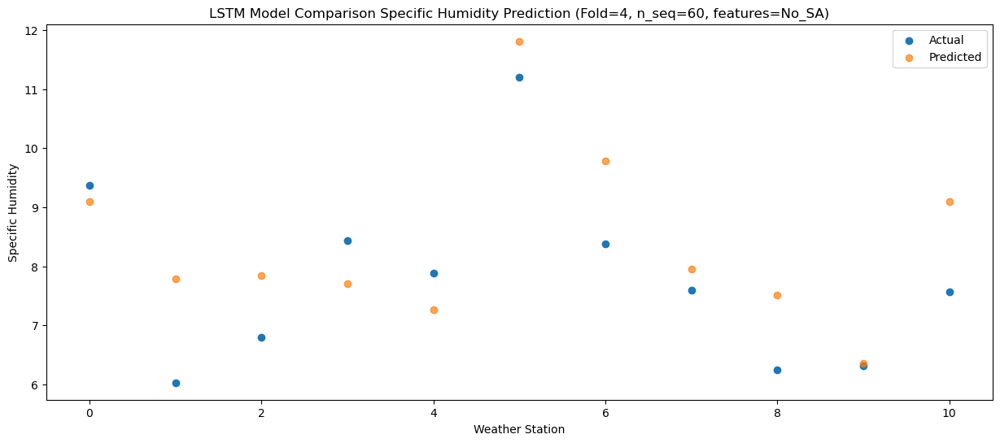

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    4.78   4.905292
1                 1    3.99   3.605292
2                 2    3.44   3.665292
3                 3    3.87   3.525292
4                 4    3.12   3.085292
5                 5    7.55   7.625292
6                 6    5.73   5.605292
7                 7    3.04   3.765292
8                 8    2.87   3.335292
9                 9    2.15   2.175292
10               10    4.53   4.905292


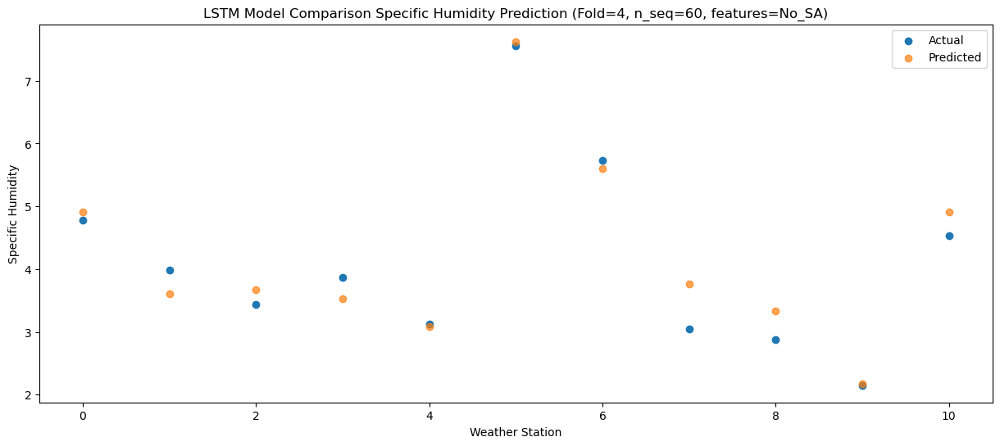

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    4.06   2.568122
1                 1    0.93   1.268122
2                 2    0.77   1.328122
3                 3    2.23   1.188122
4                 4    1.76   0.748122
5                 5    7.09   5.288122
6                 6    2.90   3.268122
7                 7    1.37   1.428122
8                 8    1.19   0.998122
9                 9    1.06  -0.161878
10               10    2.60   2.568122


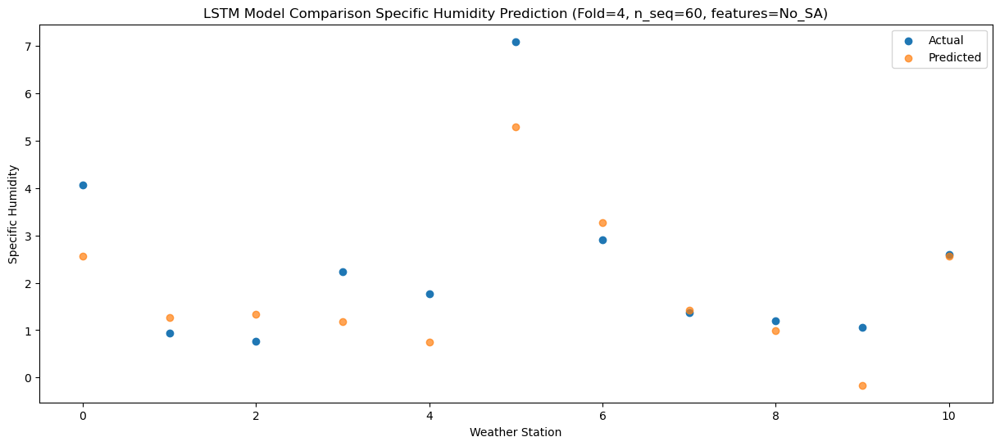

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0    1.83   0.283993
1                 1   -3.81  -1.016007
2                 2   -1.61  -0.956007
3                 3   -0.37  -1.096007
4                 4   -0.81  -1.536007
5                 5    4.53   3.003993
6                 6   -0.44   0.983993
7                 7   -0.56  -0.856007
8                 8   -0.41  -1.286007
9                 9   -0.85  -2.446007
10               10    1.27   0.283993


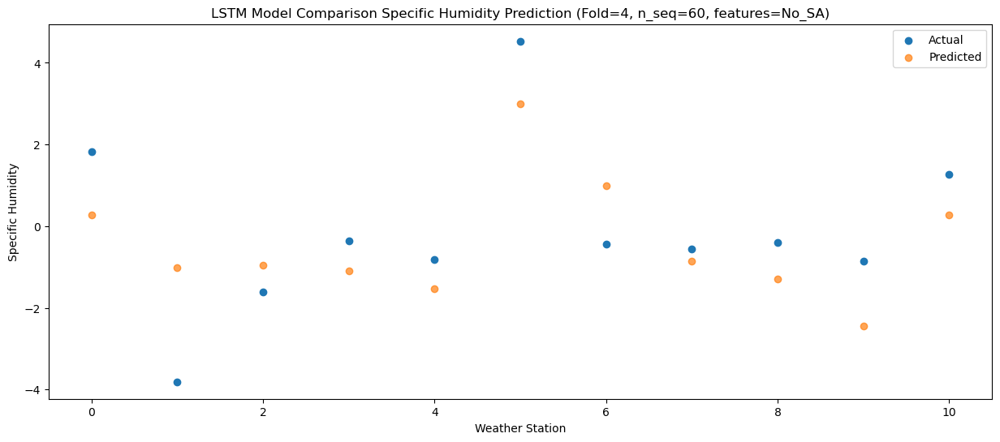

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0    1.95  -0.177322
1                 1   -3.46  -1.477322
2                 2   -1.72  -1.417322
3                 3   -0.48  -1.557322
4                 4   -0.85  -1.997322
5                 5    5.23   2.542678
6                 6   -0.56   0.522678
7                 7   -0.71  -1.317322
8                 8   -0.76  -1.747322
9                 9   -1.17  -2.907322
10               10    0.89  -0.177322


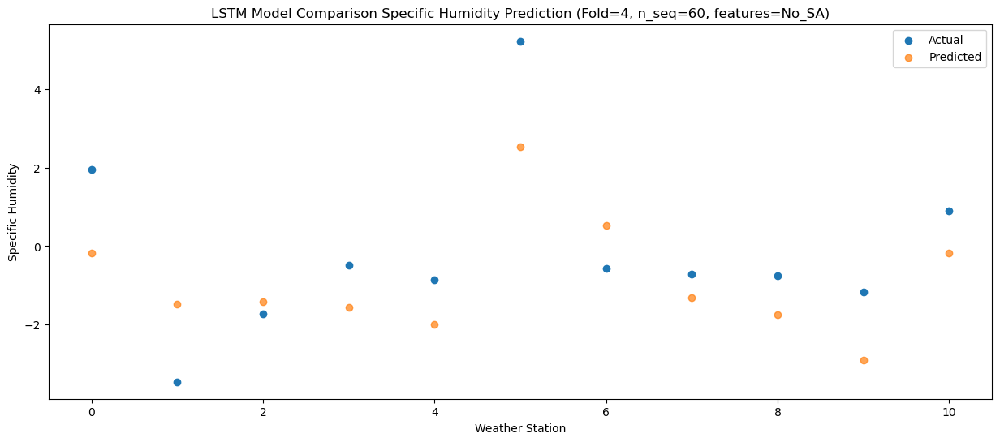

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0    0.86  -0.112477
1                 1   -1.47  -1.412477
2                 2   -1.84  -1.352477
3                 3   -0.80  -1.492477
4                 4   -1.30  -1.932477
5                 5    4.59   2.607523
6                 6   -0.31   0.587523
7                 7   -1.34  -1.252477
8                 8   -1.33  -1.682477
9                 9   -1.81  -2.842477
10               10    0.32  -0.112477


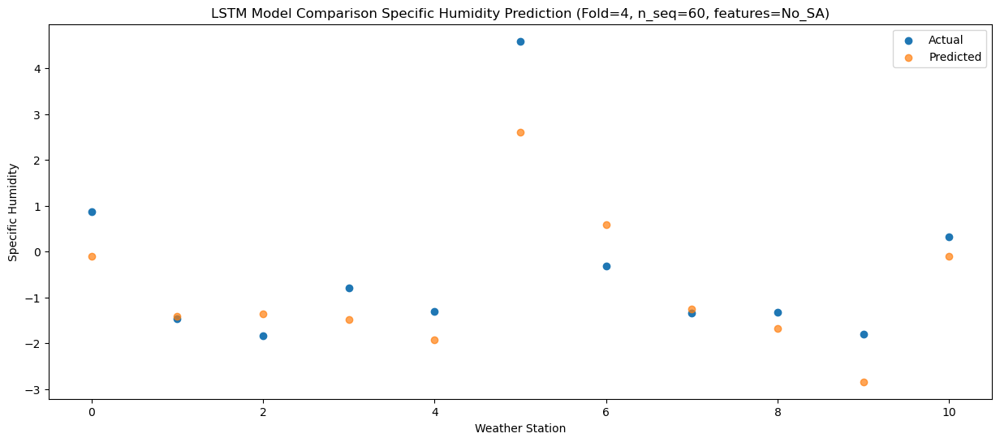

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    3.62    2.46669
1                 1   -1.50    1.16669
2                 2    1.22    1.22669
3                 3    1.86    1.08669
4                 4    1.28    0.64669
5                 5    6.08    5.18669
6                 6    1.40    3.16669
7                 7    1.03    1.32669
8                 8    0.61    0.89669
9                 9    0.56   -0.26331
10               10    1.61    2.46669


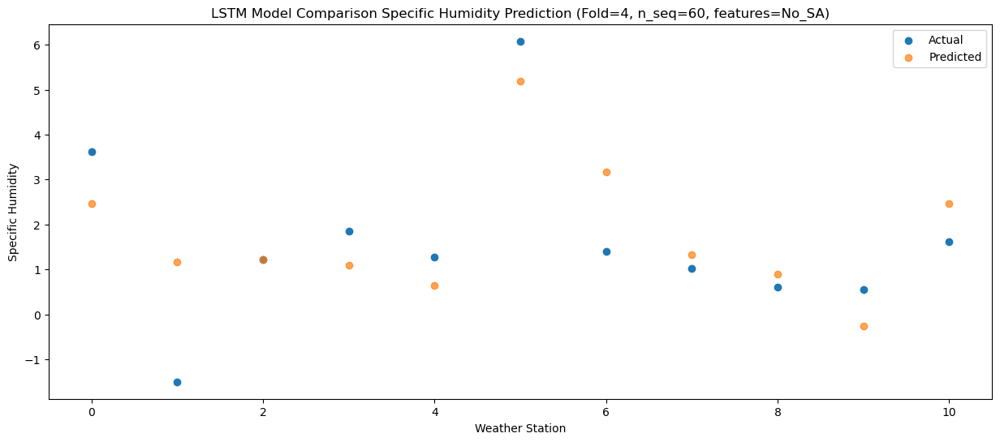

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    4.83   3.766194
1                 1   -0.75   2.466194
2                 2    1.47   2.526194
3                 3    3.15   2.386194
4                 4    2.64   1.946194
5                 5    7.04   6.486194
6                 6    1.81   4.466194
7                 7    1.95   2.626194
8                 8    1.94   2.196194
9                 9    1.87   1.036194
10               10    3.28   3.766194


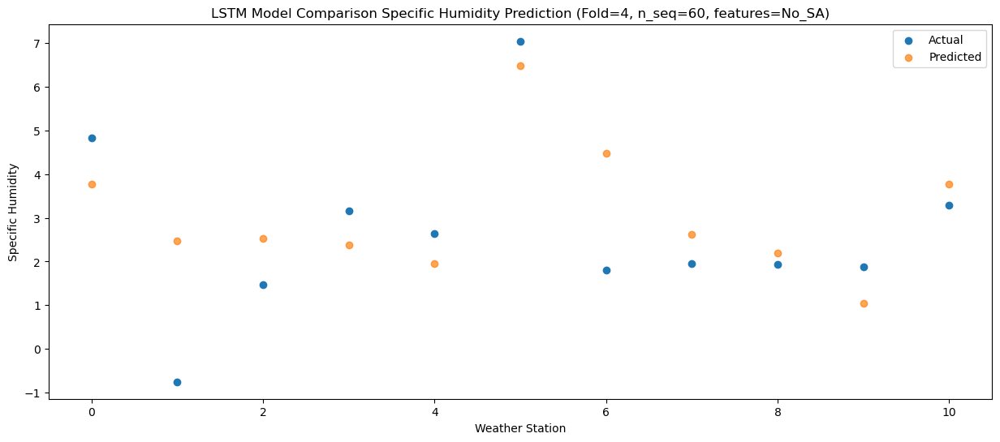

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    8.39   6.669984
1                 1    0.58   5.369984
2                 2    4.91   5.429984
3                 3    7.15   5.289984
4                 4    6.93   4.849984
5                 5   11.59   9.389984
6                 6    4.79   7.369984
7                 7    5.11   5.529984
8                 8    4.23   5.099984
9                 9    4.49   3.939984
10               10    4.88   6.669984


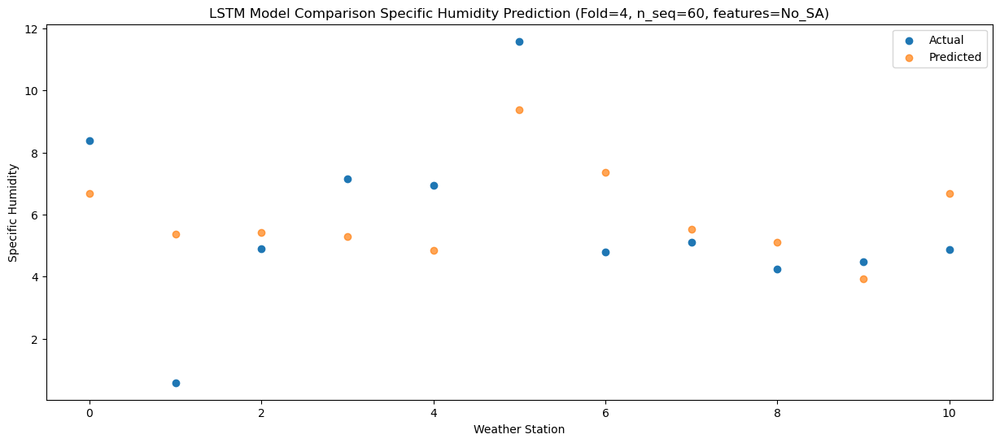

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   12.98  11.426868
1                 1    4.87  10.126868
2                 2    9.15  10.186868
3                 3   10.84  10.046868
4                 4   10.81   9.606868
5                 5   13.89  14.146868
6                 6    9.48  12.126868
7                 7    9.71  10.286868
8                 8    9.29   9.856868
9                 9    9.24   8.696868
10               10    9.89  11.426868


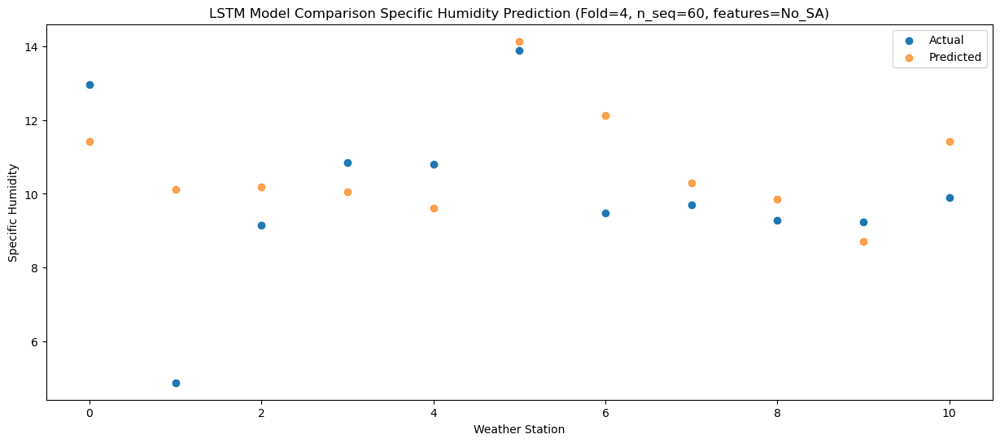

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   14.37  12.525834
1                 1    6.08  11.225834
2                 2   10.80  11.285834
3                 3   11.41  11.145834
4                 4   11.19  10.705834
5                 5   14.92  15.245834
6                 6   11.08  13.225834
7                 7   10.66  11.385834
8                 8   10.55  10.955834
9                 9   10.64   9.795834
10               10   11.16  12.525834


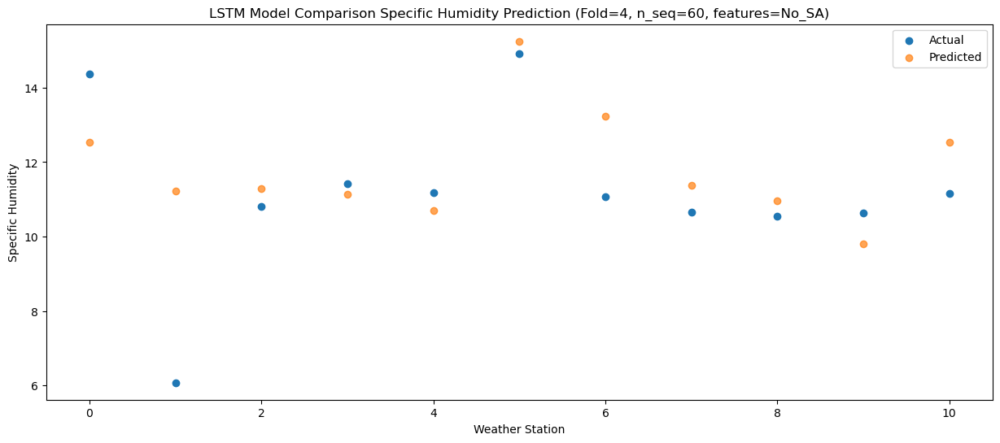

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   14.19  12.830248
1                 1    6.47  11.530248
2                 2   10.81  11.590248
3                 3   11.80  11.450248
4                 4   11.30  11.010248
5                 5   14.64  15.550248
6                 6   11.46  13.530248
7                 7   10.40  11.690248
8                 8   10.69  11.260248
9                 9   10.89  10.100248
10               10   12.03  12.830248


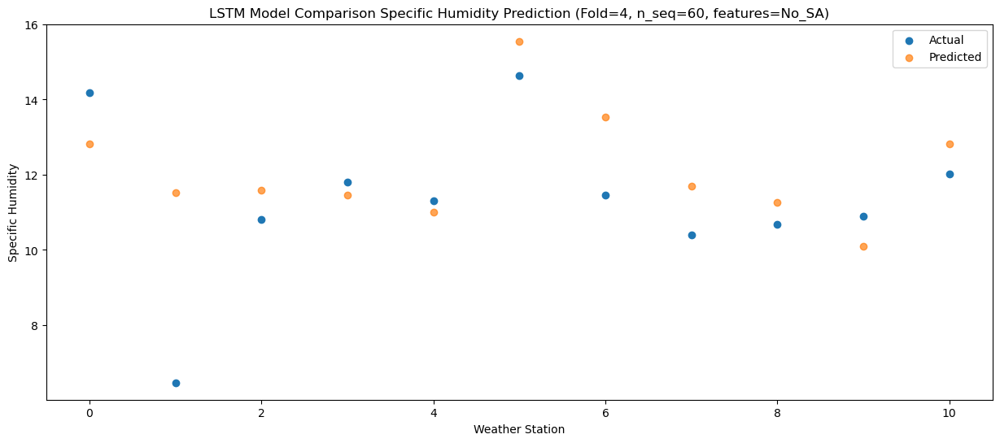

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   10.61   9.579194
1                 1    5.67   8.279194
2                 2    7.87   8.339194
3                 3    7.79   8.199194
4                 4    7.40   7.759194
5                 5   11.39  12.299194
6                 6    7.88  10.279194
7                 7    7.14   8.439194
8                 8    7.21   8.009194
9                 9    6.86   6.849194
10               10    8.27   9.579194


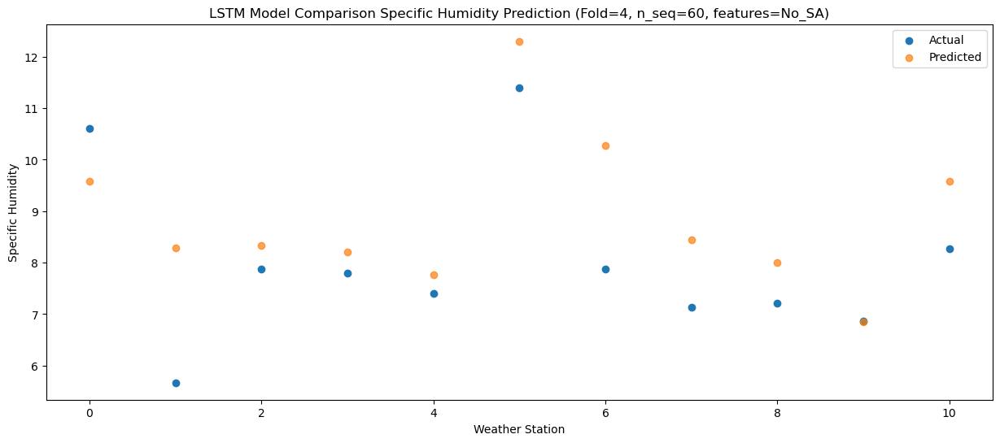

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    7.24   7.829074
1                 1    2.75   6.529074
2                 2    5.09   6.589074
3                 3    4.94   6.449074
4                 4    4.67   6.009074
5                 5    8.34  10.549074
6                 6    5.67   8.529074
7                 7    5.05   6.689074
8                 8    6.06   6.259074
9                 9    4.99   5.099074
10               10    7.26   7.829074


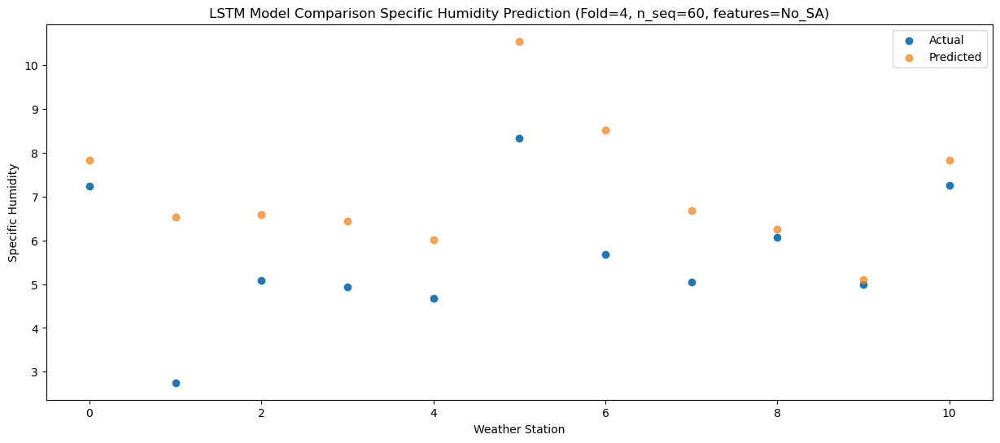

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    3.15   2.583693
1                 1   -1.91   1.283693
2                 2   -0.35   1.343693
3                 3    1.32   1.203693
4                 4    1.06   0.763693
5                 5    6.62   5.303693
6                 6   -0.05   3.283693
7                 7    0.36   1.443693
8                 8    0.29   1.013693
9                 9   -0.30  -0.146307
10               10    2.02   2.583693


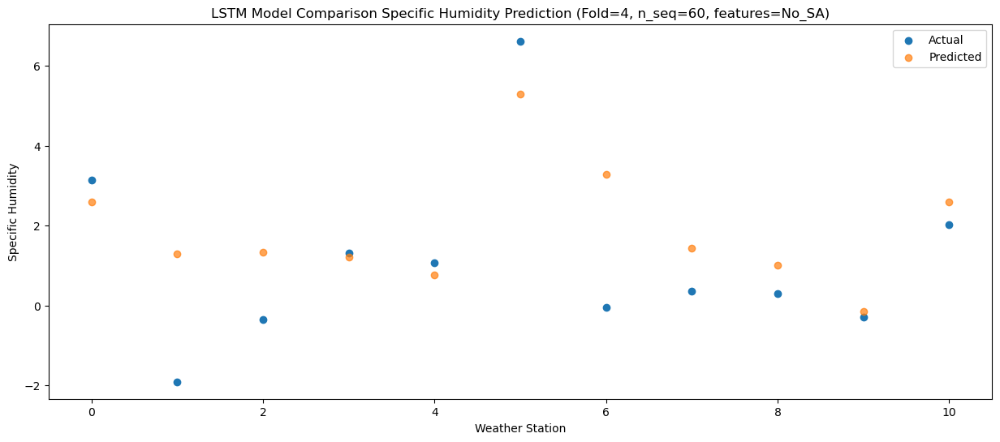

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    2.94   4.210594
1                 1   -0.17   2.910594
2                 2    2.60   2.970594
3                 3    3.18   2.830594
4                 4    2.47   2.390594
5                 5    5.77   6.930594
6                 6    1.81   4.910594
7                 7    1.83   3.070594
8                 8    1.00   2.640594
9                 9    0.24   1.480594
10               10    1.98   4.210594


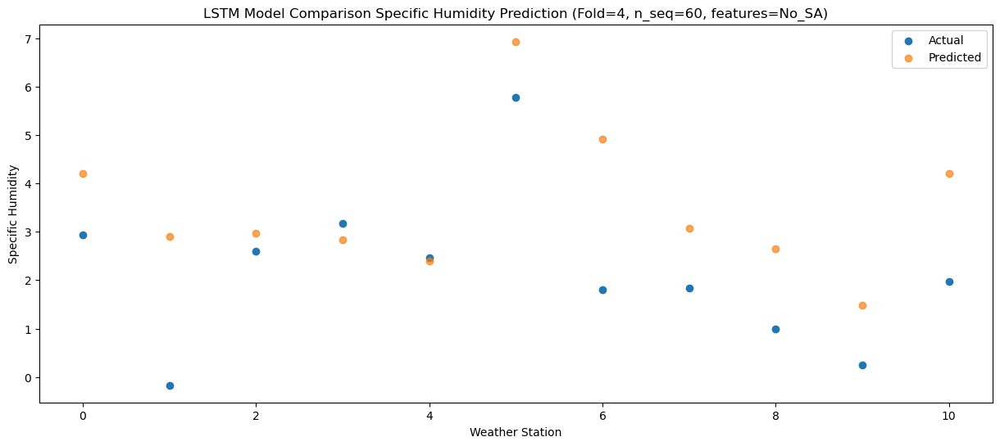

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0    0.93   0.007825
1                 1   -4.03  -1.292175
2                 2   -2.13  -1.232175
3                 3   -1.48  -1.372175
4                 4   -1.86  -1.812175
5                 5    4.31   2.727825
6                 6   -1.17   0.707825
7                 7   -1.37  -1.132175
8                 8   -1.38  -1.562175
9                 9   -2.00  -2.722175
10               10    0.24   0.007825


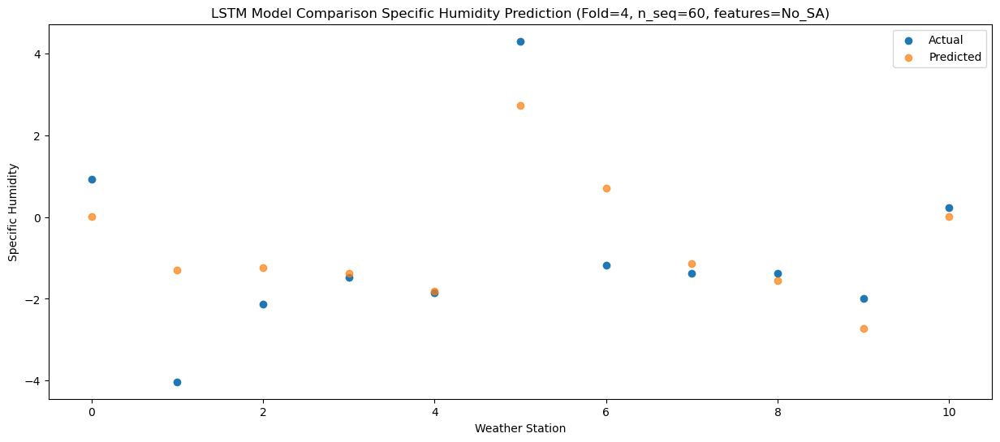

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0    1.15   0.355253
1                 1   -2.45  -0.944747
2                 2   -1.28  -0.884747
3                 3   -0.95  -1.024747
4                 4   -1.42  -1.464747
5                 5    4.30   3.075253
6                 6    0.15   1.055253
7                 7   -0.86  -0.784747
8                 8   -0.80  -1.214747
9                 9   -1.30  -2.374747
10               10    0.69   0.355253


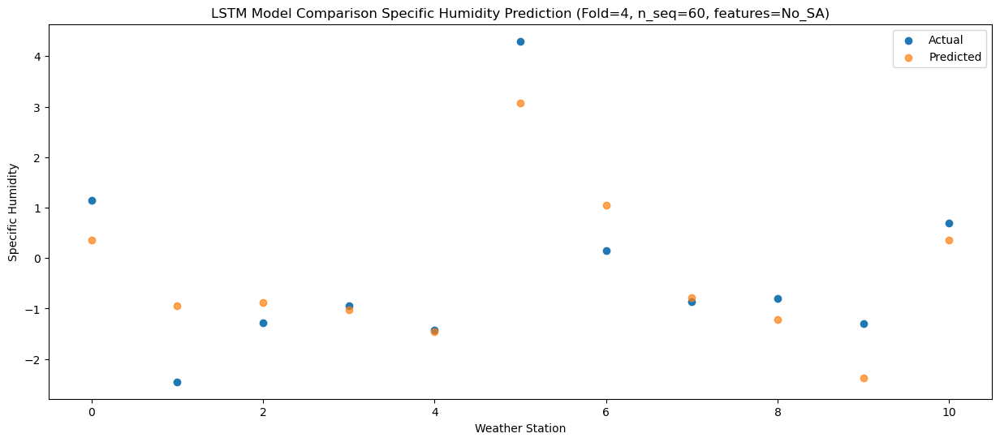

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    2.71   2.080961
1                 1   -0.92   0.780961
2                 2   -0.23   0.840961
3                 3    0.64   0.700961
4                 4    0.10   0.260961
5                 5    4.89   4.800961
6                 6    0.99   2.780961
7                 7    0.65   0.940961
8                 8    0.51   0.510961
9                 9    0.22  -0.649039
10               10    1.84   2.080961


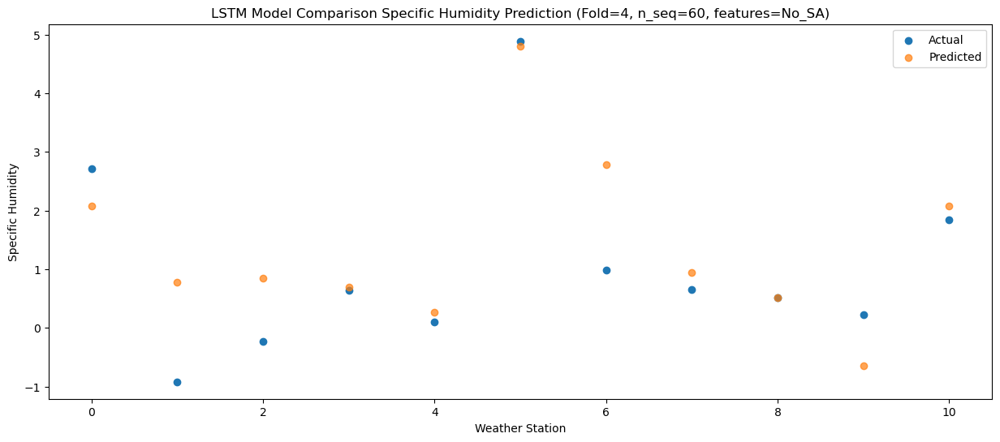

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    4.20   4.945067
1                 1    0.37   3.645067
2                 2    2.22   3.705067
3                 3    4.15   3.565067
4                 4    3.78   3.125067
5                 5    6.92   7.665067
6                 6    2.05   5.645067
7                 7    2.44   3.805067
8                 8    2.00   3.375067
9                 9    1.52   2.215067
10               10    2.83   4.945067


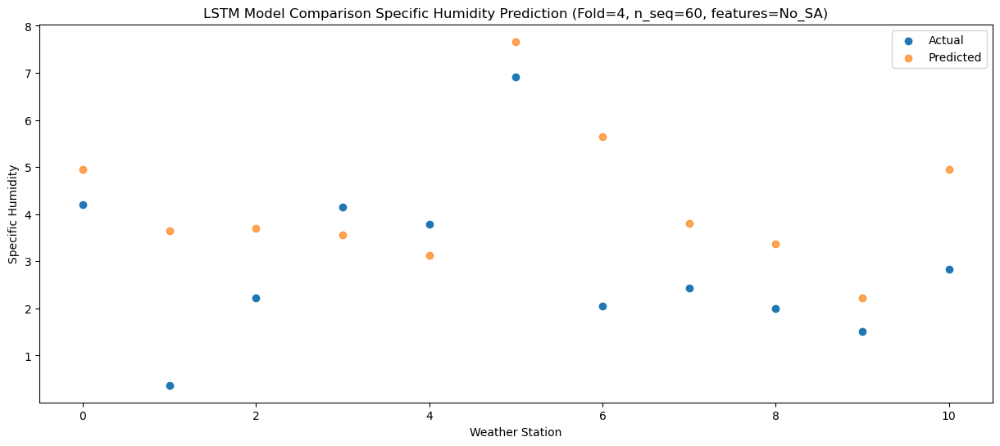

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    9.08   9.733848
1                 1    2.76   8.433848
2                 2    6.82   8.493848
3                 3    8.14   8.353848
4                 4    7.66   7.913848
5                 5    9.18  12.453848
6                 6    6.06  10.433848
7                 7    7.15   8.593848
8                 8    6.02   8.163848
9                 9    5.59   7.003848
10               10    6.29   9.733848


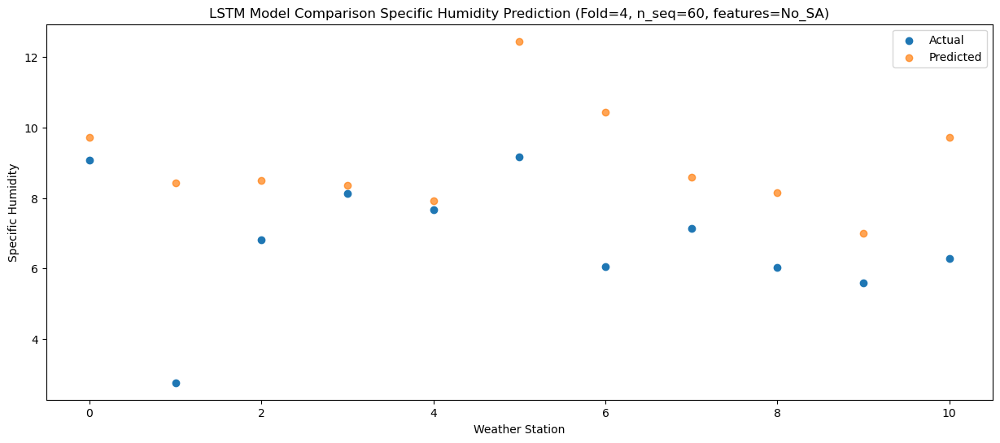

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   12.31  11.596201
1                 1    5.66  10.296201
2                 2    9.20  10.356201
3                 3    9.91  10.216201
4                 4    9.34   9.776201
5                 5   12.03  14.316201
6                 6    8.34  12.296201
7                 7    9.51  10.456201
8                 8    7.46  10.026201
9                 9    7.83   8.866201
10               10    8.20  11.596201


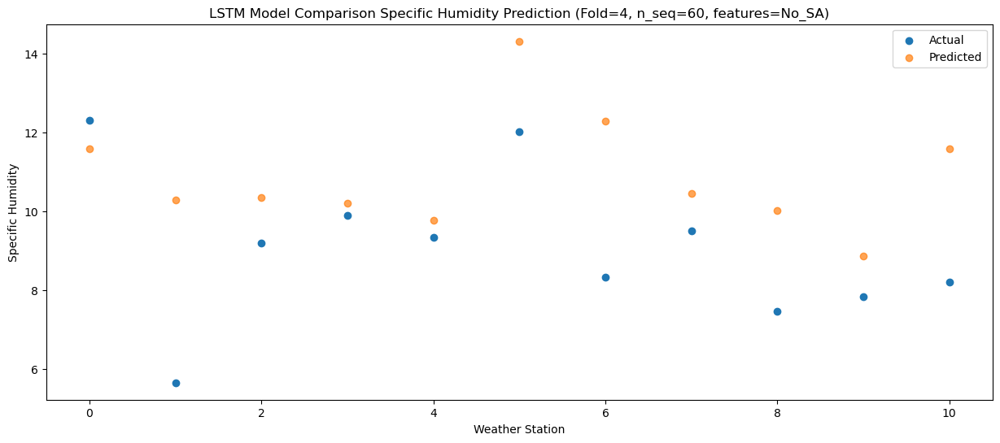

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   13.94  12.886029
1                 1    6.69  11.586029
2                 2   11.04  11.646029
3                 3    9.33  11.506029
4                 4    8.84  11.066029
5                 5   12.72  15.606029
6                 6   11.50  13.586029
7                 7   10.31  11.746029
8                 8   10.20  11.316029
9                 9   10.47  10.156029
10               10    9.93  12.886029


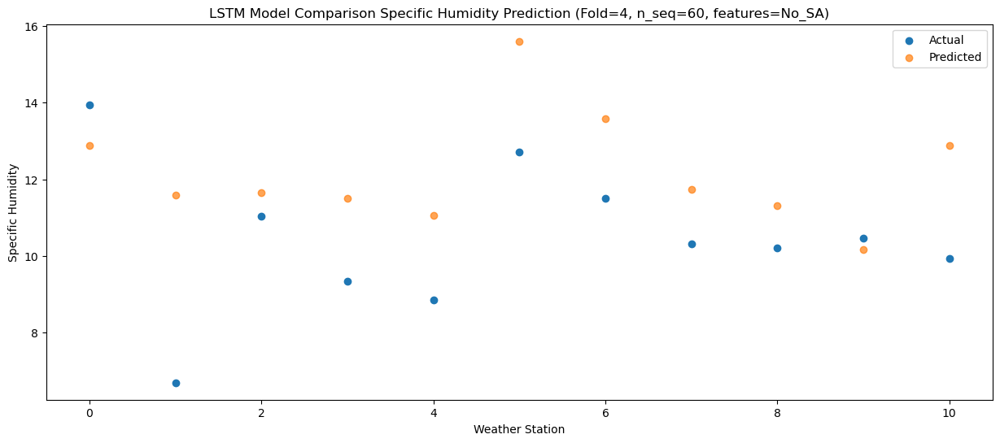

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   13.73  12.925937
1                 1    6.77  11.625937
2                 2   10.86  11.685937
3                 3   10.34  11.545937
4                 4   10.01  11.105937
5                 5   14.71  15.645937
6                 6   10.31  13.625937
7                 7   10.78  11.785937
8                 8    9.84  11.355937
9                 9    9.70  10.195937
10               10   10.39  12.925937


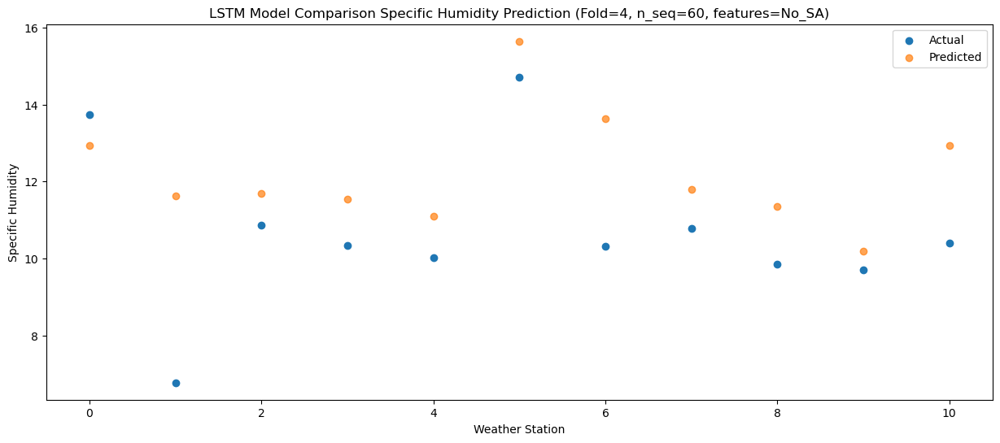

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    9.03   9.067326
1                 1    5.90   7.767326
2                 2    6.62   7.827326
3                 3    7.06   7.687326
4                 4    6.86   7.247326
5                 5   13.46  11.787326
6                 6    6.76   9.767326
7                 7    6.97   7.927326
8                 8    7.18   7.497326
9                 9    6.33   6.337326
10               10    8.40   9.067326


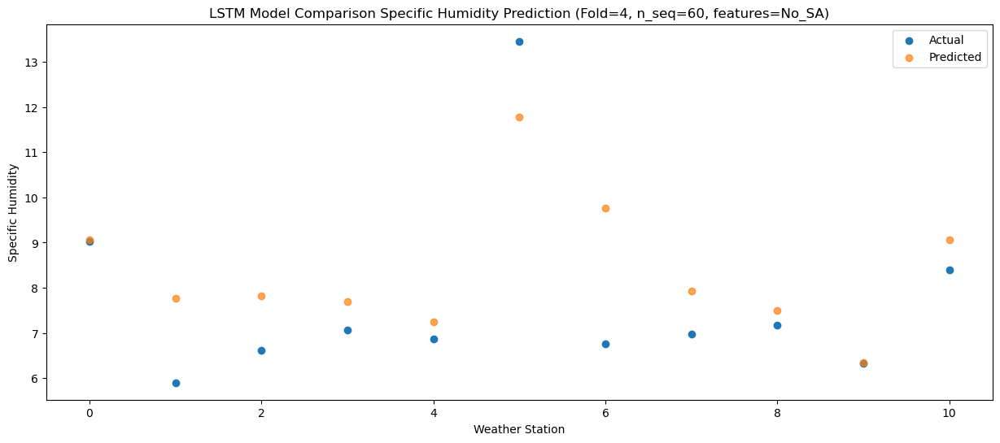

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    4.44   3.659196
1                 1    1.12   2.359196
2                 2    1.66   2.419196
3                 3    2.60   2.279196
4                 4    2.40   1.839196
5                 5    9.95   6.379196
6                 6    2.08   4.359196
7                 7    2.31   2.519196
8                 8    1.85   2.089196
9                 9    1.57   0.929196
10               10    3.58   3.659196


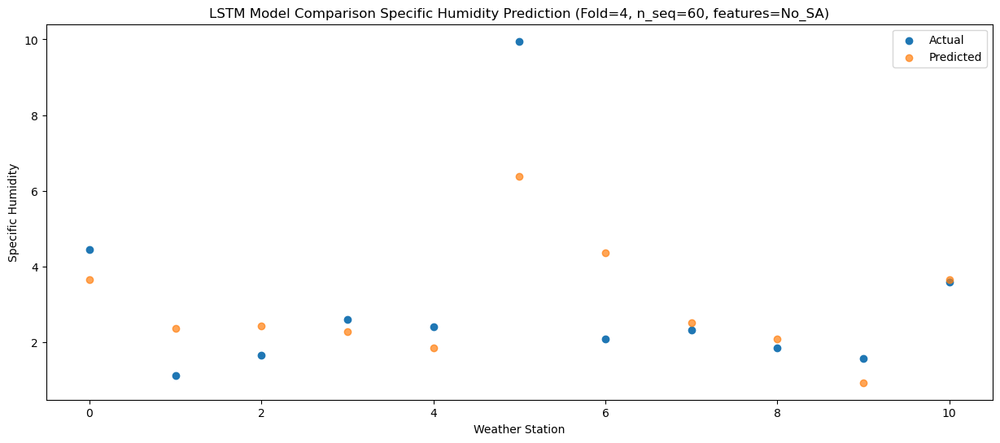

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    3.27   2.719654
1                 1    1.29   1.419654
2                 2    0.91   1.479654
3                 3    2.42   1.339654
4                 4    1.98   0.899654
5                 5    7.25   5.439654
6                 6    1.90   3.419654
7                 7    0.95   1.579654
8                 8    0.81   1.149654
9                 9    0.20  -0.010346
10               10    2.86   2.719654


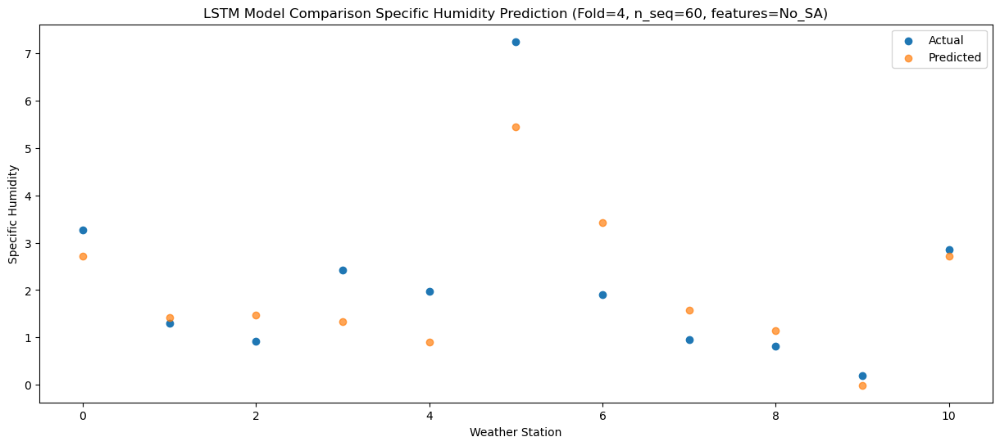

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0    1.93   1.611805
1                 1   -2.23   0.311805
2                 2    0.37   0.371805
3                 3    0.84   0.231805
4                 4    0.39  -0.208195
5                 5    6.61   4.331805
6                 6   -0.09   2.311805
7                 7    0.08   0.471805
8                 8   -0.15   0.041805
9                 9   -0.91  -1.118195
10               10    1.41   1.611805


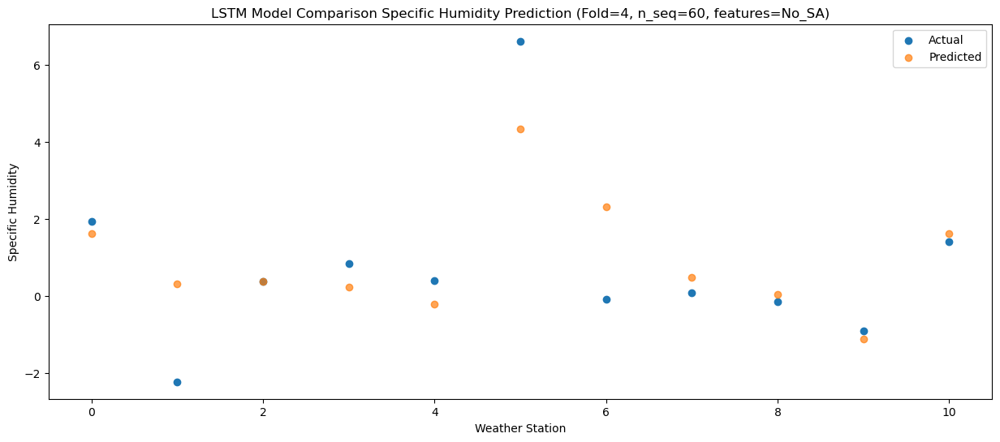

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    2.28   1.890283
1                 1   -2.74   0.590283
2                 2    0.27   0.650283
3                 3    0.15   0.510283
4                 4   -0.36   0.070283
5                 5    5.06   4.610283
6                 6    0.54   2.590283
7                 7    0.36   0.750283
8                 8    0.47   0.320283
9                 9   -0.39  -0.839717
10               10    2.03   1.890283


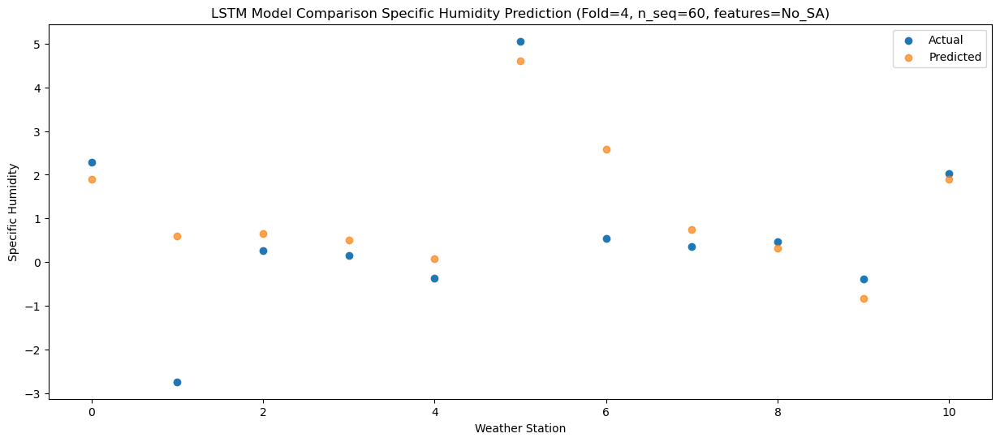

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    2.23   2.135602
1                 1   -0.80   0.835602
2                 2    0.94   0.895602
3                 3    0.51   0.755602
4                 4    0.04   0.315602
5                 5    5.18   4.855602
6                 6    1.58   2.835602
7                 7    0.17   0.995602
8                 8    0.07   0.565602
9                 9   -0.62  -0.594398
10               10    1.28   2.135602


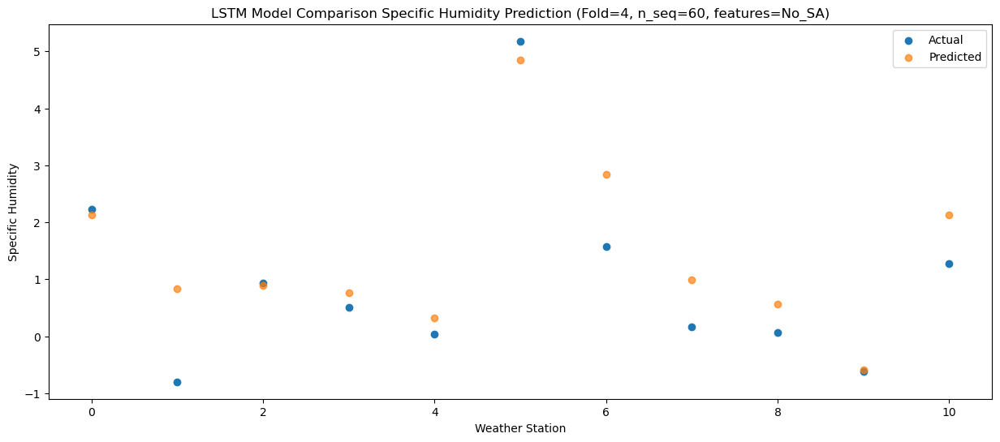

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    3.07   2.607704
1                 1   -0.42   1.307704
2                 2    1.27   1.367704
3                 3    2.57   1.227704
4                 4    2.01   0.787704
5                 5    6.47   5.327704
6                 6    1.07   3.307704
7                 7    0.93   1.467704
8                 8    0.42   1.037704
9                 9   -0.01  -0.122296
10               10    1.49   2.607704


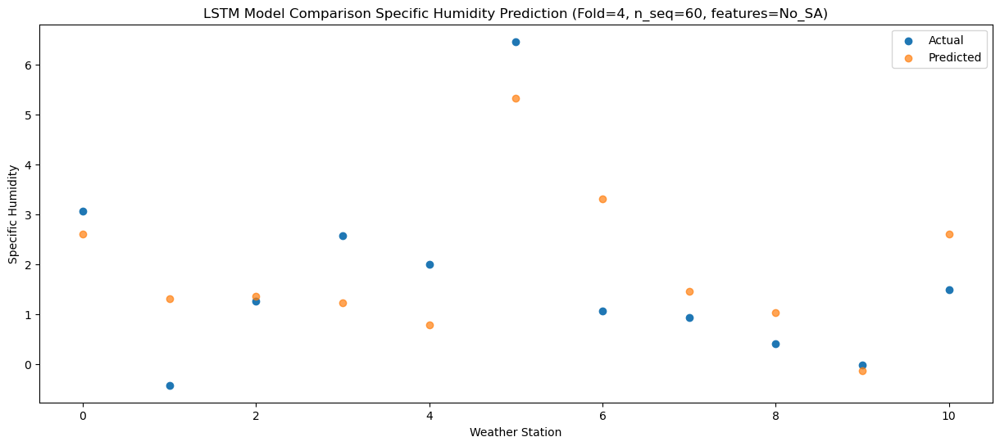

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    4.25   4.220403
1                 1    1.07   2.920403
2                 2    2.11   2.980403
3                 3    3.25   2.840403
4                 4    2.86   2.400403
5                 5    6.44   6.940403
6                 6    2.67   4.920403
7                 7    1.83   3.080403
8                 8    1.87   2.650403
9                 9    1.50   1.490403
10               10    3.19   4.220403


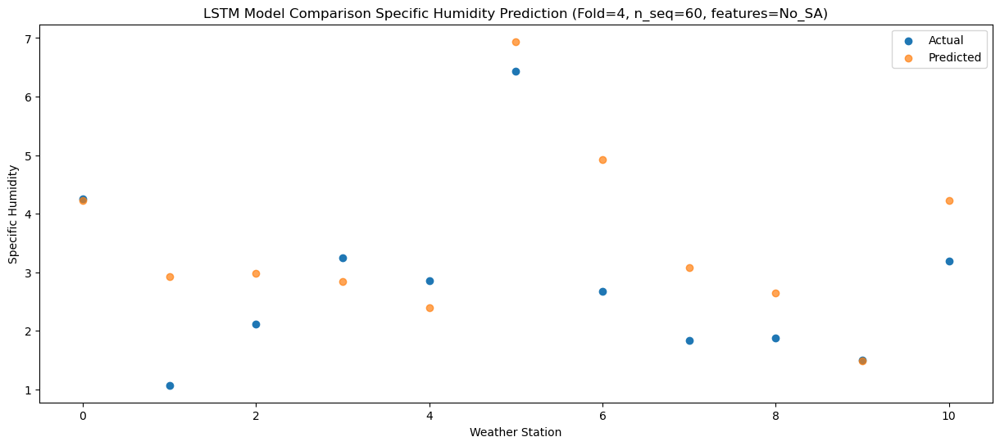

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    8.27   6.694348
1                 1    1.87   5.394348
2                 2    5.49   5.454348
3                 3    7.51   5.314348
4                 4    7.13   4.874348
5                 5   11.28   9.414348
6                 6    4.89   7.394348
7                 7    6.22   5.554348
8                 8    4.12   5.124348
9                 9    4.28   3.964348
10               10    4.09   6.694348


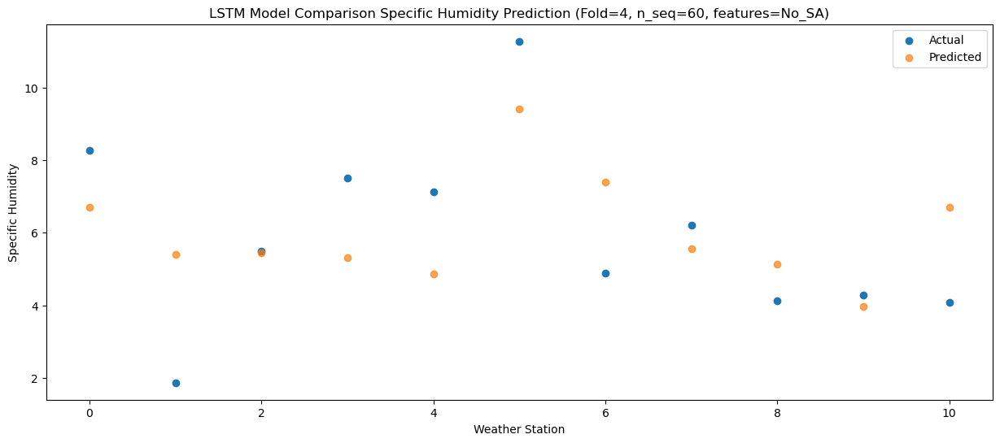

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   10.81   9.895763
1                 1    5.38   8.595763
2                 2    9.06   8.655763
3                 3   11.45   8.515763
4                 4   10.61   8.075763
5                 5   15.14  12.615763
6                 6    7.94  10.595763
7                 7    8.78   8.755763
8                 8    6.08   8.325763
9                 9    5.92   7.165763
10               10    7.33   9.895763


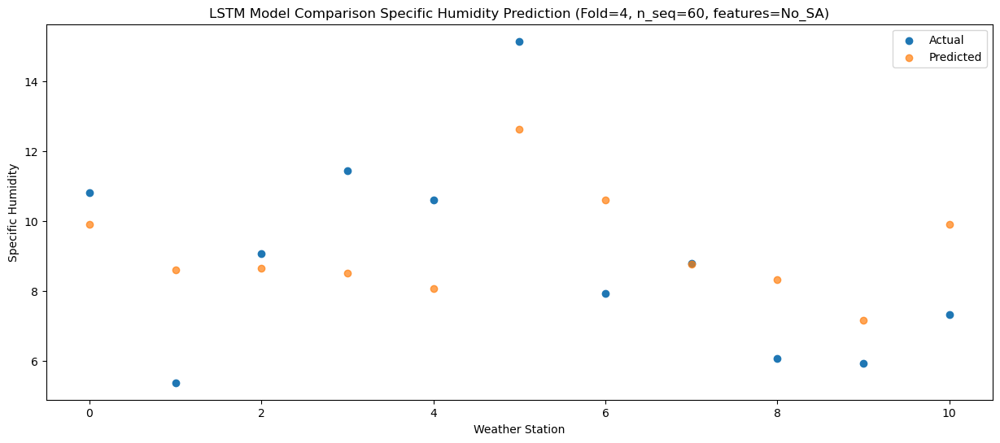

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   13.50  11.820029
1                 1    7.29  10.520029
2                 2   10.65  10.580029
3                 3   11.30  10.440029
4                 4    9.71  10.000029
5                 5   12.81  14.540029
6                 6   11.33  12.520029
7                 7   11.57  10.680029
8                 8   10.38  10.250029
9                 9   10.62   9.090029
10               10   10.95  11.820029


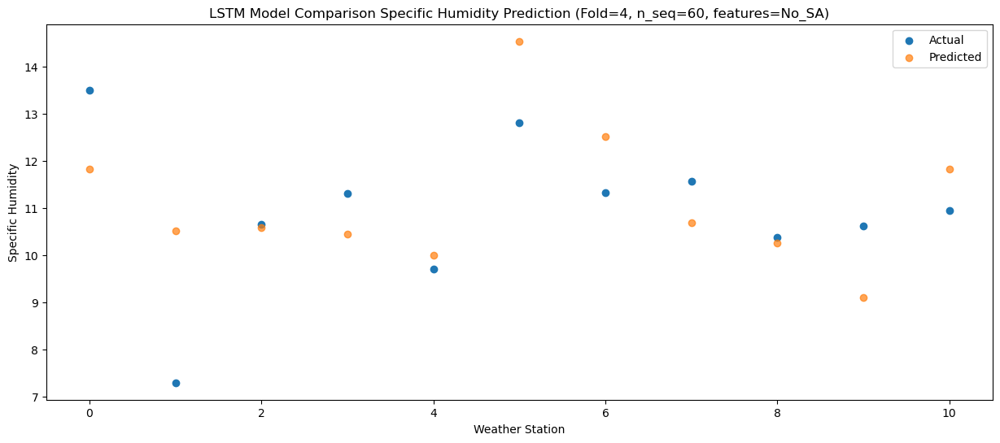

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   14.43  10.915086
1                 1    7.59   9.615086
2                 2    9.07   9.675086
3                 3    9.20   9.535086
4                 4    8.33   9.095086
5                 5   11.95  13.635086
6                 6   10.87  11.615086
7                 7   11.85   9.775086
8                 8    9.84   9.345086
9                 9   10.49   8.185086
10               10   10.15  10.915086


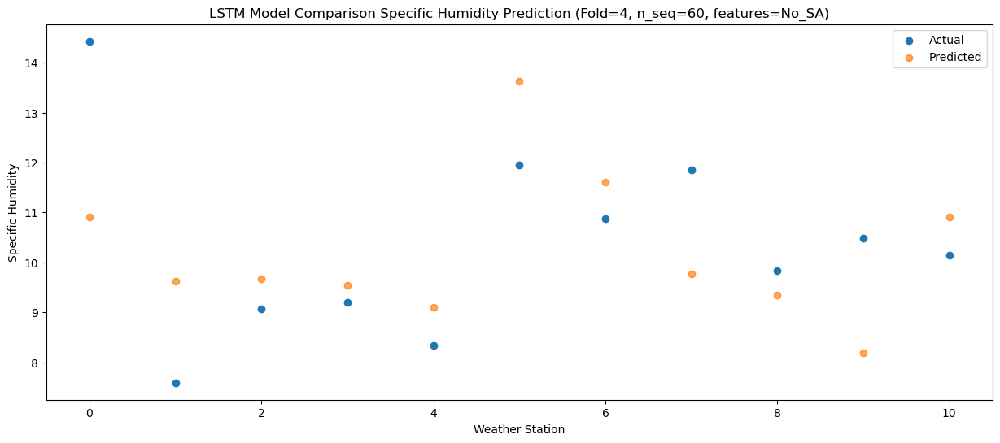

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    9.51   9.214499
1                 1    5.14   7.914499
2                 2    6.05   7.974499
3                 3    8.30   7.834499
4                 4    8.00   7.394499
5                 5   12.46  11.934499
6                 6    7.42   9.914499
7                 7    7.65   8.074499
8                 8    7.04   7.644499
9                 9    6.71   6.484499
10               10    8.44   9.214499


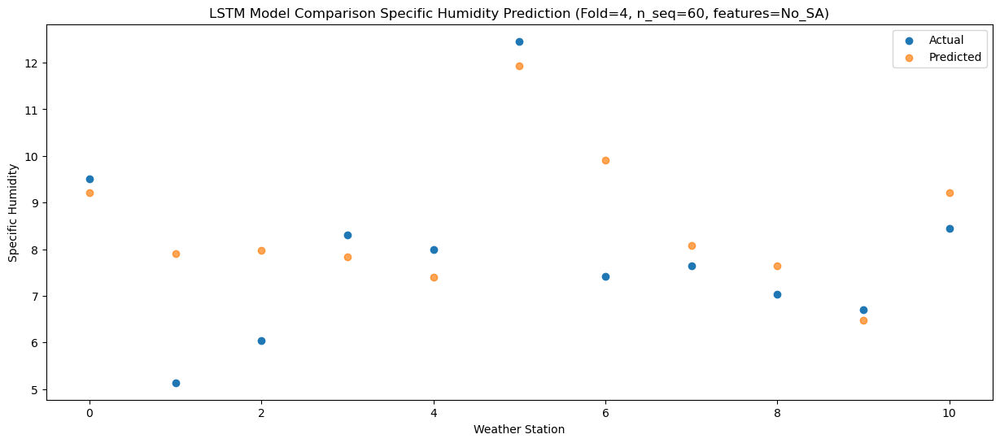

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    6.32   5.316203
1                 1    1.52   4.016203
2                 2    2.12   4.076203
3                 3    4.58   3.936203
4                 4    4.34   3.496203
5                 5   10.33   8.036203
6                 6    3.51   6.016203
7                 7    4.04   4.176203
8                 8    3.71   3.746203
9                 9    3.27   2.586203
10               10    5.38   5.316203


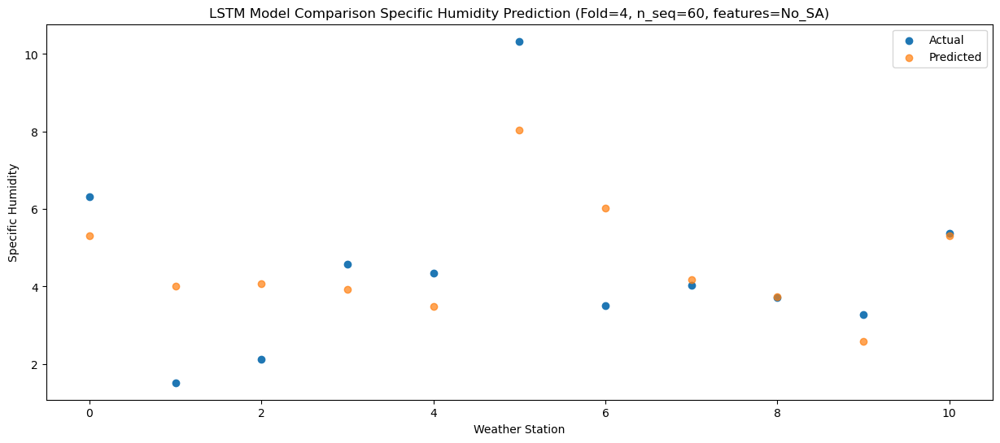

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    3.42   1.667929
1                 1   -0.78   0.367929
2                 2    0.14   0.427929
3                 3    2.05   0.287929
4                 4    1.92  -0.152071
5                 5    8.03   4.387929
6                 6    0.56   2.367929
7                 7    1.01   0.527929
8                 8    0.64   0.097929
9                 9   -0.12  -1.062071
10               10    1.94   1.667929


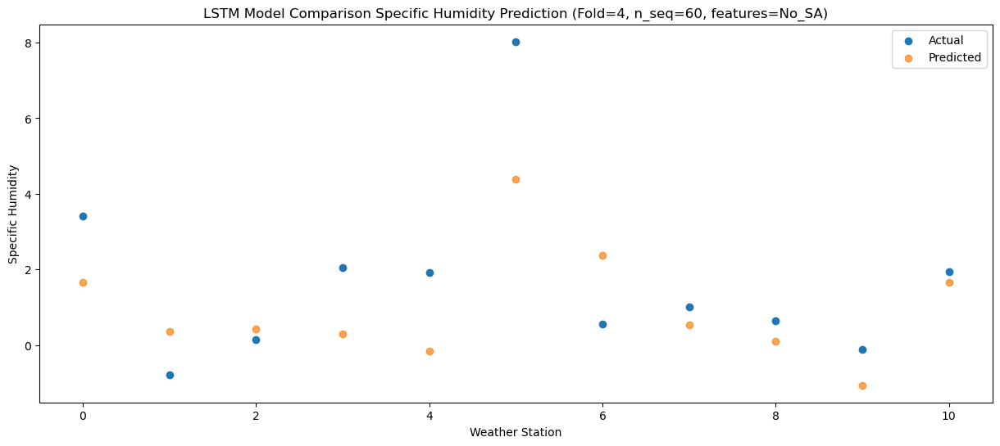

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0    3.24   0.637421
1                 1   -1.87  -0.662579
2                 2   -1.17  -0.602579
3                 3    0.30  -0.742579
4                 4    0.16  -1.182579
5                 5    6.45   3.357421
6                 6    0.28   1.337421
7                 7    0.20  -0.502579
8                 8    0.61  -0.932579
9                 9    0.37  -2.092579
10               10    2.46   0.637421


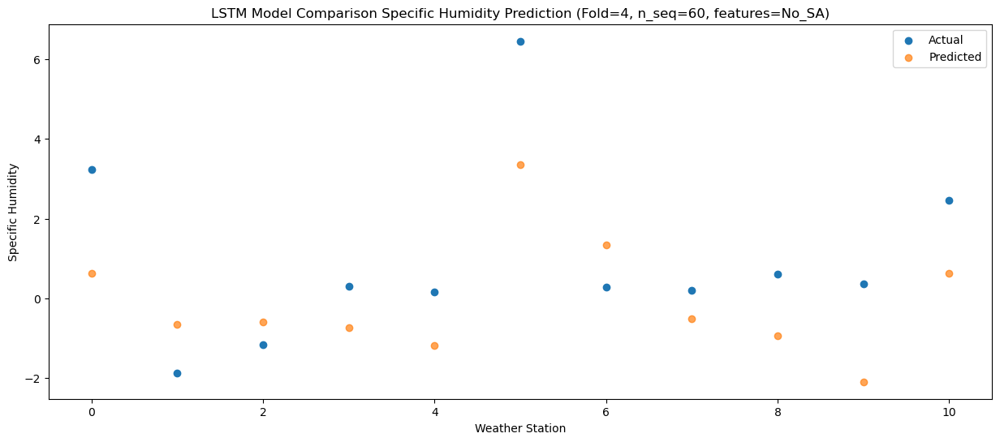

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0    1.54  -0.002342
1                 1   -2.91  -1.302342
2                 2   -1.89  -1.242342
3                 3   -0.98  -1.382342
4                 4   -1.26  -1.822342
5                 5    5.18   2.717658
6                 6   -0.50   0.697658
7                 7   -0.95  -1.142342
8                 8   -0.47  -1.572342
9                 9   -1.09  -2.732342
10               10    1.39  -0.002342


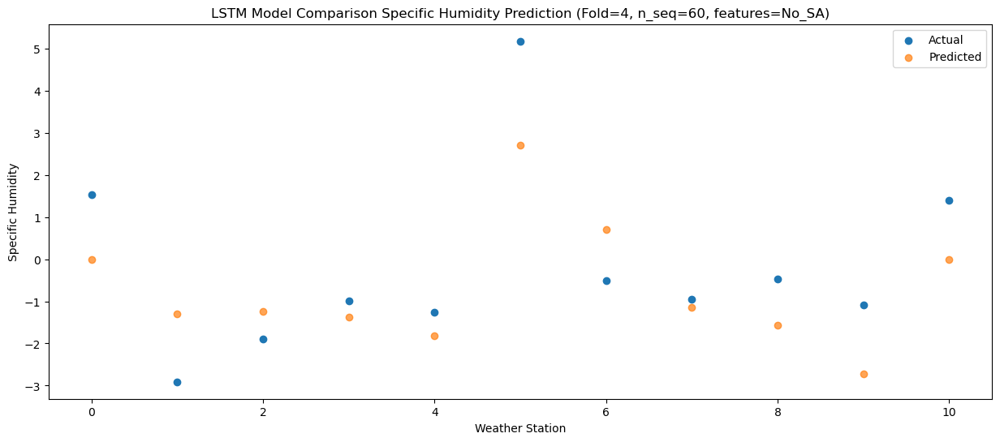

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    2.55   1.288056
1                 1   -3.60  -0.011944
2                 2   -0.46   0.048056
3                 3    1.36  -0.091944
4                 4    1.09  -0.531944
5                 5    5.53   4.008056
6                 6   -0.32   1.988056
7                 7    0.41   0.148056
8                 8    0.11  -0.281944
9                 9   -0.17  -1.441944
10               10    1.41   1.288056


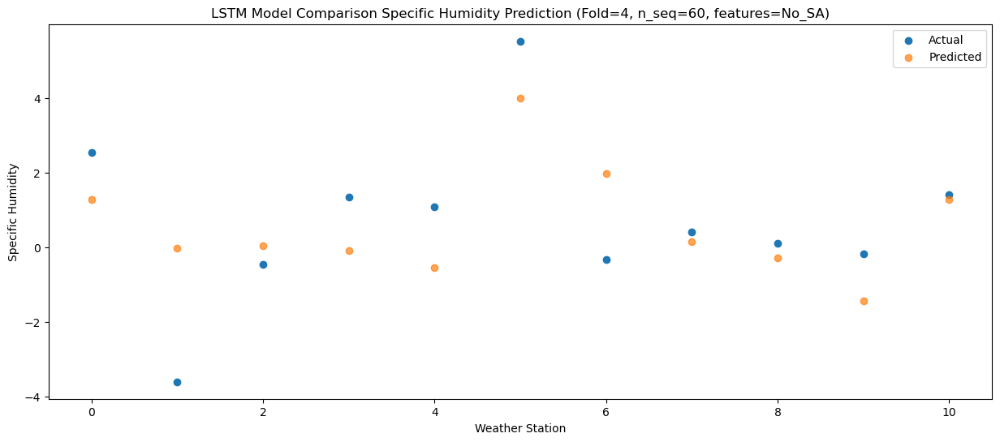

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    3.61   2.496779
1                 1   -0.31   1.196779
2                 2    1.17   1.256779
3                 3    3.15   1.116779
4                 4    3.04   0.676779
5                 5    6.67   5.216779
6                 6    1.25   3.196779
7                 7    1.62   1.356779
8                 8    1.18   0.926779
9                 9    0.80  -0.233221
10               10    2.48   2.496779


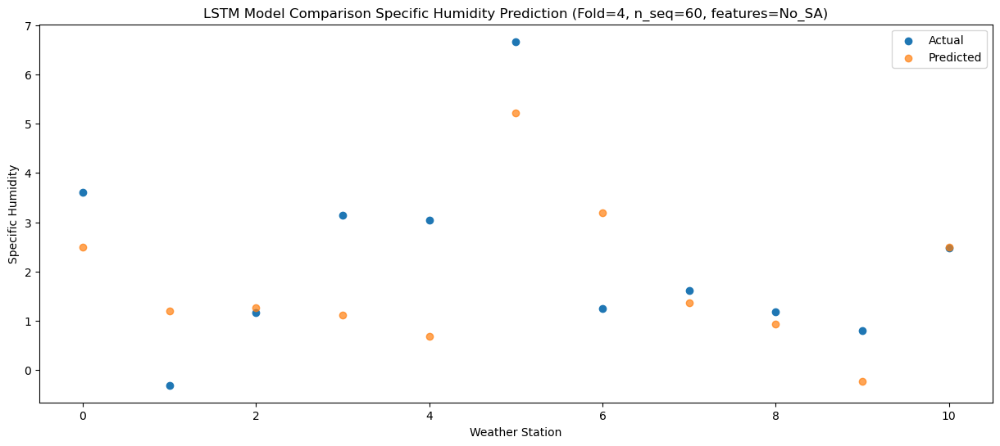

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    5.29   4.799439
1                 1   -0.91   3.499439
2                 2    3.35   3.559439
3                 3    5.52   3.419439
4                 4    5.54   2.979439
5                 5    7.27   7.519439
6                 6    3.17   5.499439
7                 7    3.35   3.659439
8                 8    3.21   3.229439
9                 9    2.52   2.069439
10               10    4.26   4.799439


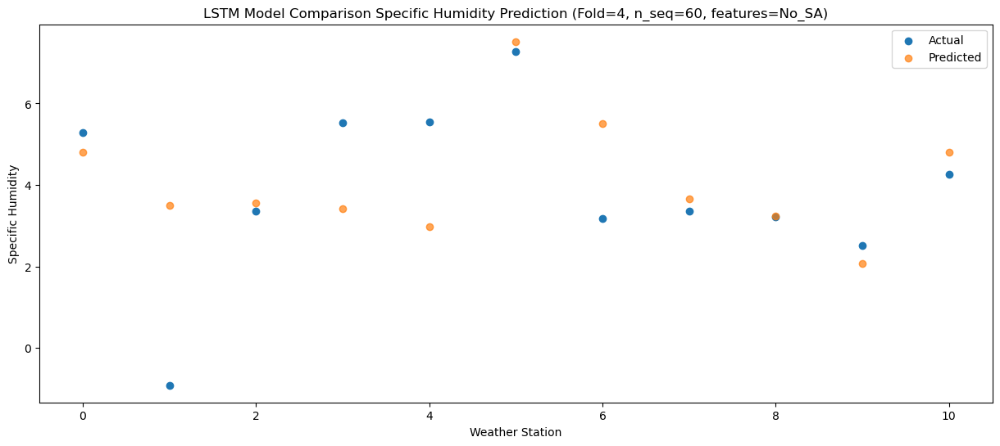

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    9.36   9.154063
1                 1    1.68   7.854063
2                 2    7.67   7.914063
3                 3    9.09   7.774063
4                 4    8.97   7.334063
5                 5   10.03  11.874063
6                 6    7.17   9.854063
7                 7    7.77   8.014063
8                 8    6.70   7.584063
9                 9    6.06   6.424063
10               10    7.18   9.154063


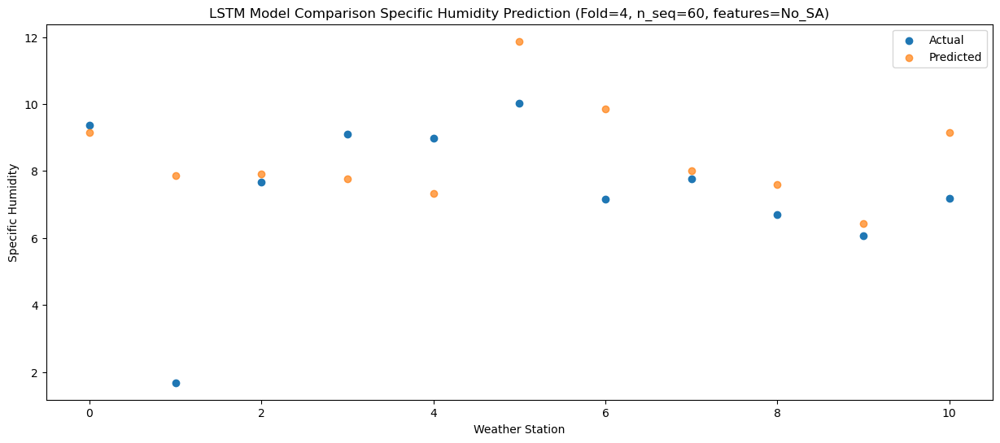

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   12.62  10.324946
1                 1    3.14   9.024946
2                 2    9.01   9.084946
3                 3   11.03   8.944946
4                 4   11.08   8.504946
5                 5   14.56  13.044946
6                 6    8.93  11.024946
7                 7    9.75   9.184946
8                 8    8.39   8.754946
9                 9    8.82   7.594946
10               10    9.73  10.324946


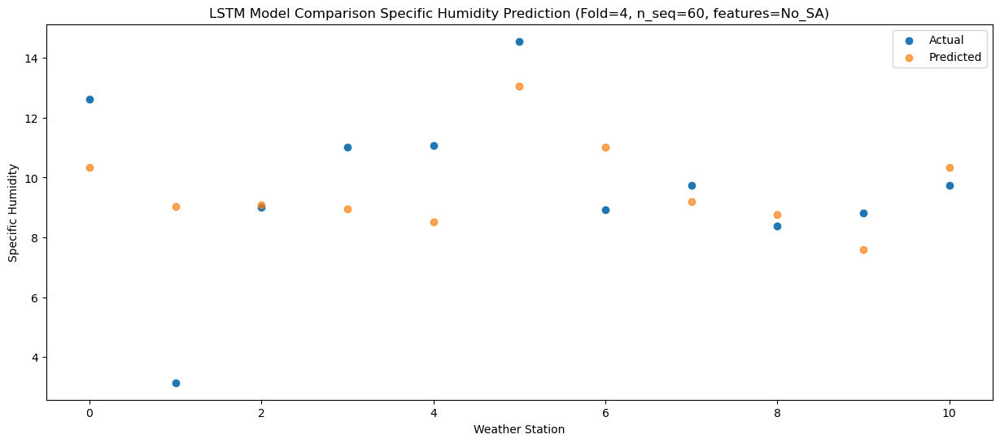

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   13.81  11.658501
1                 1    4.60  10.358501
2                 2   11.04  10.418501
3                 3   10.99  10.278501
4                 4   10.61   9.838501
5                 5   14.44  14.378501
6                 6   11.32  12.358501
7                 7   10.73  10.518501
8                 8    9.69  10.088501
9                 9   10.43   8.928501
10               10   10.85  11.658501


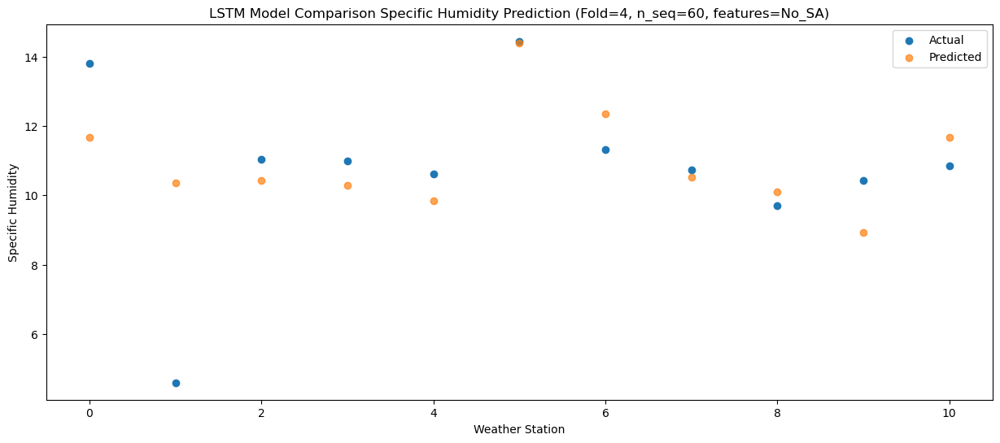

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   12.65  10.788792
1                 1    7.21   9.488792
2                 2    8.73   9.548792
3                 3   10.28   9.408792
4                 4    9.84   8.968792
5                 5   13.24  13.508792
6                 6   10.58  11.488792
7                 7    9.44   9.648792
8                 8    9.33   9.218792
9                 9   10.07   8.058792
10               10   10.83  10.788792


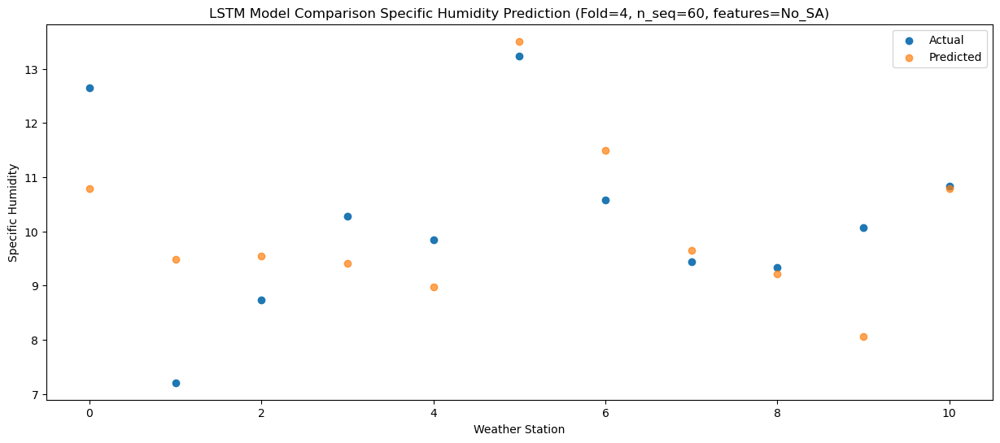

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    9.35   8.660926
1                 1    7.02   7.360926
2                 2    7.63   7.420926
3                 3    7.75   7.280926
4                 4    7.68   6.840926
5                 5   12.36  11.380926
6                 6    8.26   9.360926
7                 7    7.40   7.520926
8                 8    6.65   7.090926
9                 9    6.57   5.930926
10               10    8.76   8.660926


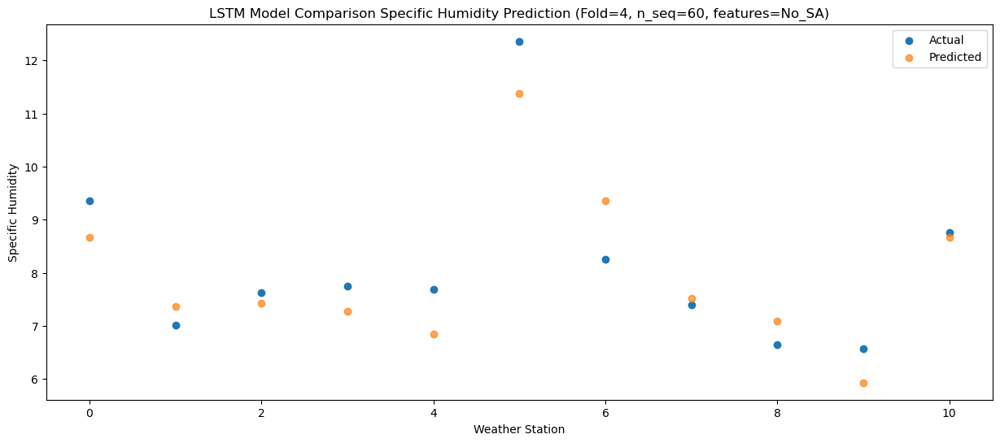

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    5.22   3.407264
1                 1    2.60   2.107264
2                 2    2.84   2.167264
3                 3    4.29   2.027264
4                 4    3.94   1.587264
5                 5    8.67   6.127264
6                 6    3.86   4.107264
7                 7    3.08   2.267264
8                 8    3.07   1.837264
9                 9    2.47   0.677264
10               10    4.65   3.407264


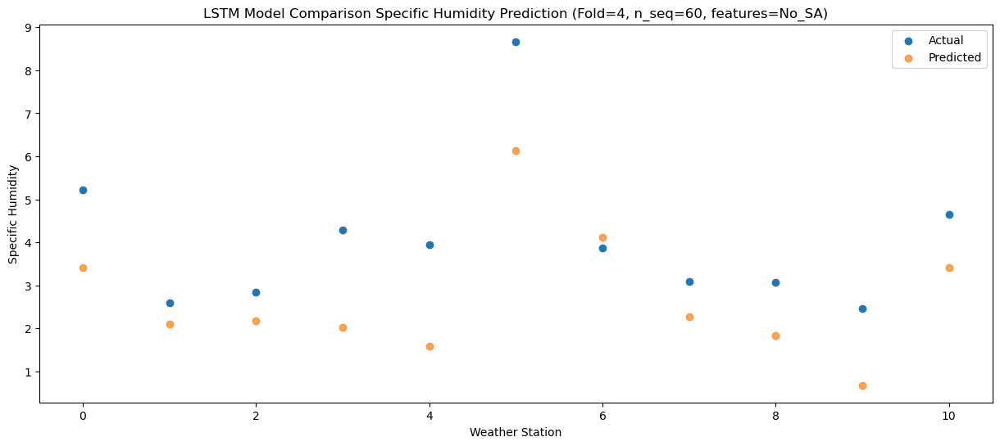

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_8 (LSTM)               (1, 1, 256)               2121728   
                                                                 
 dropout_8 (Dropout)         (1, 1, 256)               0         
                                                                 
 lstm_9 (LSTM)               (1, 256)                  525312    
                                                                 
 dropout_9 (Dropout)         (1, 256)                  0         
                                                                 
 dense_12 (Dense)            (1, 256)                  65792     
                                                                 
 dense_13 (Dense)            (1, 128)                  32896     
                                                                 
 dense_14 (Dense)            (1, 60)                  

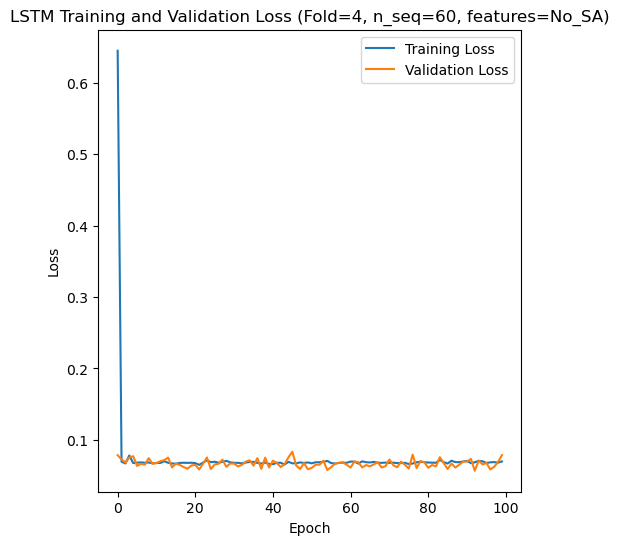

[[1.7867117754840784, 2.2794834340065444, 3.05039524065051, 2.7206855207026246, 3.2381507164350056, 3.0308544080706032, 2.8694811344381996, 1.8005162391364893, 1.4677651472673958, 1.0492166998971635, 1.5921621670936579, 1.7146885445918765, 2.4132307120730467, 2.888158719711157, 3.3452731052673332, 2.6453907054339987, 3.0236327519540698, 2.5655136692545355, 2.8182324361801356, 1.8321999831938254, 1.3372806865416118, 1.1897123605446656, 1.176536754850759, 1.6247991710683687, 2.862396117194483, 1.8930752646599407, 2.613804599153843, 2.134417495397795, 2.0343390926315297, 2.4924175944978924, 1.6636258200093699, 2.1223056188161316, 1.7662103803236802, 1.8485554014746484, 1.947650047766535, 3.1507839017280004, 3.15906301529413, 4.060490483131318, 3.4397911131216707, 3.5748912257994565, 4.596039186389041, 3.611871073764462, 4.850236513295862, 3.4386998349196194, 2.652902683685392, 3.382558232171299, 3.2820211536732415, 3.689409420962296, 4.45679977598999, 4.013142863582823, 3.581787793664493,

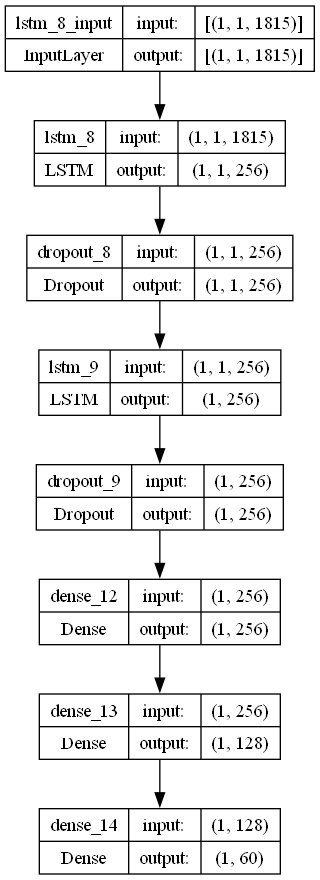

In [2]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, mean_absolute_percentage_error, r2_score
from tensorflow.keras.utils import plot_model

def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))

# fit the best LSTM model using parameters found by Optuna
def create_best_model(X, y, n_lag, n_seq, n_batch, nb_epoch):
    
    #Parameters:
    #trial (array-like): Optuna parameters.
    #train (array-like): Target values.
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations
    #nb_epoch (int): Maximum number of epochs
    
    # Hyperparameters from the best model
    lr = 0.05240465728663423
    optimizer = Adam(learning_rate = lr)
    activation_function = 'relu'
    lstm_units = 256
    dropout_rate = 0.45234894910170736

    # design network
    model = Sequential()
    model.add(LSTM(lstm_units, return_sequences=True, batch_input_shape=(n_batch, X.shape[1], X.shape[2]), stateful=True))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units))
    model.add(Dropout(dropout_rate))
    model.add(Dense(256, input_dim=y.shape[1], activation=activation_function))
    model.add(Dense(128, activation=activation_function))
    model.add(Dense(n_seq))
    model.compile(loss=rmse, optimizer=optimizer, metrics=['accuracy', 'mae', rmse, mape, pearson])
        
    return model

# Make one forecast with an LSTM
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def forecast_lstm(model, X, n_seq, n_test):
    # reshape input pattern to [samples, timesteps, features]
    X = X.reshape(1, 1, X.shape[1])
    # make forecast
    forecast = model.predict(X)
    # convert to array
    return forecast
     
# Evaluate the persistence model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def make_forecasts(model, X_test, y_test, n_lag, n_seq, n_test):
    forecasts = list()
    for i in range(len(X_test)):
        X, y = X_test[i, :], y_test[i, :]
        # make forecast
        forecast = forecast_lstm(model, X, n_seq, n_test)
        # store the forecast
        forecasts.append(forecast)
    return forecasts
     
# Invert differenced forecast
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_difference(last_ob, forecast):
    # Invert the first forecast
    inverted = list()
    inverted.append(forecast[0] + last_ob)
    # Propagate the difference forecast using the inverted first value
    for i in range(1, len(forecast)):
        inverted.append(forecast[i] + inverted[i-1])
    return inverted
     
# Inverse data transform on forecasts
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_transform(series, forecasts, scaler, n_test, n_seq):
    inverted = list()
    for i in range(len(forecasts)):
        # Create an array from the forecast
        forecast = forecasts[i]
        forecast = forecast.reshape(1, n_seq)
        # invert scaling
        inv_scale = scaler.inverse_transform(forecast)
        inv_scale = inv_scale[0, :]
        # invert differencing
        index = len(series) - n_test + i - 1
        last_ob = series.values[index]
        inv_diff = inverse_difference(last_ob, inv_scale)
        # store
        inverted.append(inv_diff)
    return inverted
     
# evaluate the RMSE for each forecast time step
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def evaluate_forecasts(test, forecasts, n_lag, n_seq):
    rmse_list = []
    mae_list = []
    mape_list = []
    r2_list = []
    for i in range(n_seq):
        actual = [row[i] for row in test]
        predicted = [forecast[i] for forecast in forecasts]
        rmse = sqrt(mean_squared_error(actual, predicted))
        mae = mean_absolute_error(actual, predicted)
        mse = mean_squared_error(actual, predicted)
        mape = mean_absolute_percentage_error(actual, predicted)
        r2 = r2_score(actual, predicted) 
        rmse_list.append(rmse)
        mae_list.append(mae)
        mape_list.append(mape)
        r2_list.append(r2)
        print("Month at t+"+str(i+1)+":")
        print('t+%d RMSE: %f' % ((i+1), rmse))
        print('t+%d MAE: %f' % ((i+1), mae))
        print('t+%d MAPE: %f' % ((i+1), mape))
        print('t+%d R2_SCORE: %f' % ((i+1), r2))

    return rmse_list, mae_list, mape_list, r2_list
     
# plot the forecasts in the context of the original dataset
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def plot_forecasts(series, forecasts, n_test, n_seq, n_lag):
    # plot the entire dataset in blue
    plt.plot(series[:n_lag+2+len(forecasts)].values)
    # plot the forecasts in red
    off_s = n_lag + 1
    off_e = off_s + len(forecasts) + 1
    xaxis = [x for x in range(off_s, off_e)]
    yaxis = [series.values[off_s]] + forecasts
    print(xaxis)
    print(yaxis)
    plt.plot(xaxis, yaxis, color='red')
    plt.xlabel("Month")
    plt.ylabel("Specific Humidity")
    # show the plot
    plt.show()

n_batch = 1
n_test = 11
nb_epoch = 100
    
rmse_avg_list = []
mae_avg_list = []
mape_avg_list = []
r2_score_avg_list = []
forecast_results = []
actual_results = []
    
for i in range(5):
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]

    X = train1[:, 0:-n_seq]
    y = train1[:, -n_seq:]
    X_test = test1[:, 0:-n_seq]
    y_test = test1[:, -n_seq:]
    X_val = validation1[:, 0:-n_seq]
    y_val = validation1[:, -n_seq:]

    dataset_df = pd.DataFrame(val_y[i])
    dataset_df = dataset_df.iloc[0:10, :]
    dataset = dataset_df.values

    series = pd.Series(dataset[:, 0]) # Using first column (specific humidity)

    X = X.reshape(X.shape[0], 1, X.shape[1])
    X1 = X_test
    X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
    X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])

    best_model = create_best_model(X, y, n_lag, n_seq, n_batch, nb_epoch)
    history = best_model.fit(X, y, epochs=100, batch_size=n_batch, validation_data=(X_val, y_val))

    # Evaluate the model
    loss = best_model.evaluate(X_test, y_test, verbose=2)
    print(f'Test Loss: {loss}')

    # make forecasts
    forecasts = make_forecasts(best_model, X_test, y_test, n_lag, n_seq, n_test)
    
    # inverse transform forecasts and test
    forecasts = inverse_transform(series, forecasts, scaler[i], n_test+2, n_seq)
    actual = [row[-n_seq:] for row in test1]
    actual = inverse_transform(series, actual, scaler[i], n_test+2, n_seq)

    rmse_list = [] # list stores root mean squared errors for each future time prediction
    mae_list = [] # list stores root mean squared errors for each future time prediction
    mape_list = [] # list stores root mean squared errors for each future time prediction
    r2_list = [] # list stores root mean squared errors for each future time prediction

    # evaluate forecasts
    rmse_list, mae_list, mape_list, r2_list = evaluate_forecasts(actual, forecasts, n_lag, n_seq)

    rmse_avg_list.append(rmse_list)
    mae_avg_list.append(mae_list)
    mape_avg_list.append(mape_list)
    r2_score_avg_list.append(r2_list)
    forecast_results.append(forecasts)
    actual_results.append(actual)

    for j in range(11):
        print("Weather Station "+str(j+1)+":")
        print("Actual S.H.\tPredicted S.H.\tDifference")
        print("-----------\t--------------\t----------")
        for k in range(n_seq):
            diff = forecasts[j][k] - actual[j][k]
            print(f"{actual[j][k]:.2f}\t\t{forecasts[j][k]:.2f}\t\t{diff:.2f}")
    
        # plot forecasts
        dataset_df = pd.DataFrame(val_y[i])
        dataset_df = dataset_df.iloc[0:11, :]
        dataset_df = dataset_df.transpose()
        dataset = dataset_df.values

        series_ws = pd.Series(dataset[:, j]) # Using first column (temperatures)
        forecasts_ws = forecasts[j]
        
        plot_forecasts(series_ws, forecasts_ws, n_test, n_seq, n_lag)

    # Print out plots of actual and predicted values for weather stations
    ws = df.index[1:12]
    print(ws)
    a = []
    f = []
    for q in range(len(actual)):
        x = actual[q]
        a.append(x[0])
    for q in range(len(forecasts)):
        x = forecasts[q]
        f.append(x[0])
    print(a)
    print(f)
    # Create a DataFrame for plotting
    results_df = pd.DataFrame({
        'ws': ws,
        'Actual': a,
        'Predicted': f
    })

    for k in range(n_seq):
        print("Predictions for (t+"+str(k)+"):")
        # Print out plots of actual and predicted values for each weather station
        results = []

        # Create a DataFrame for plotting
        for j in range(11):
            results.append([j, actual[j][k], forecasts[j][k]])
               
        results_df = pd.DataFrame(results)
        results_df.columns = ['Weather_Station', 'Actual', 'Predicted']

        print(results_df)
            
        # Plotting the results
        plt.figure(figsize=(15, 6))
        plt.scatter(results_df['Weather_Station'], results_df['Actual'], label='Actual')
        plt.scatter(results_df['Weather_Station'], results_df['Predicted'], label='Predicted', alpha=0.7)
        title1='LSTM Model Comparison Specific Humidity Prediction (Fold='+str(i)+', n_seq='+str(n_seq)+', features=No_SA)'
        plt.title(title1)
        plt.xlabel('Weather Station')
        plt.ylabel('Specific Humidity')
        plt.legend()
        plt.show()

    best_model.summary()

    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    title2 = 'LSTM Training and Validation Loss (Fold='+str(i)+', n_seq='+str(n_seq)+', features=No_SA)'
    plt.title(title2)
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(loc='upper right')
    plt.show()

print(rmse_avg_list)
print(mae_avg_list)
print(mape_avg_list)
print(r2_score_avg_list)
print(forecast_results)
print(actual_results)
print("Accuracy Results:")
print("RMSE for each fold:")
print(rmse_avg_list)
print("Average RMSE:"+str(np.mean(rmse_avg_list)))
print("Average MAE:"+str(np.mean(mae_avg_list)))
print("Average MAPE:"+str(np.mean(mape_avg_list)))
print("Average R2 Score:"+str(np.mean(r2_score_avg_list)))

# Plot model architecture
filename = "lstm_model_optimized_SH_S60_No_SA.png"
plot_model(best_model, to_file=filename, show_shapes=True, show_layer_names=True)

In [3]:
print(np.mean(mape_avg_list))

2175067919090.569


In [4]:
print(np.mean(mape_avg_list[0]))

3.6022043915304818


In [5]:
print(np.mean(mape_avg_list[1]))

6187859922697.516


In [6]:
print(np.mean(mape_avg_list[2]))

1.3218454502541432


In [7]:
print(np.mean(mape_avg_list[3]))

4687479672749.461


In [8]:
print(np.mean(mape_avg_list[4]))

0.9449676011246246


In [9]:
print(mape_avg_list[1])

[1.3846101682145509, 1.812593514958356, 172884315446993.72, 9.079677991703921, 0.5635967886675033, 5.394333676766748, 0.2518314366451078, 0.08637550325079589, 0.13387145849721385, 0.14869412420532704, 0.1846336471419387, 0.23714421713387177, 1.116196919826341, 2.293143184432378, 3.5018410114435947, 2.1867073758940516, 2.150636995095562, 8.986204009052539, 0.3898705647650471, 0.15403463941963216, 0.0983098294105266, 0.09551913505677216, 0.1182179797102067, 0.2652794066068877, 1.3453425084306252, 2.436440411489627, 2.677680265173659, 5.53928555413649, 21.441389318217595, 198387279914718.22, 0.22360349237416155, 0.14880716733304344, 0.08154562967609522, 0.06137579972881697, 0.14414704618526272, 8.677680853746692, 3.566548254069583, 1.9763340962701768, 2.3896055778485232, 16.80280415451287, 3.499388778474008, 0.7960810607813557, 0.3783299881800381, 0.2608791744181906, 0.1333877700187525, 0.18047116489119588, 0.2762884072224948, 0.685087277543265, 1.8383440146864005, 2.026683469584497, 8.98

In [10]:
print(mape_avg_list[3])

[1.3667837195380685, 1.1516135862883592, 2.287057555025425, 1.8091588150417643, 1.1319425066327495, 0.6590162788693527, 0.31192822287819694, 0.15585356128631786, 0.1876935198634299, 0.10988205121895298, 0.1169443399368753, 0.27656994791634887, 0.79410441541398, 2.0658090089060703, 0.8456478168415196, 0.9785540790483425, 275185649251302.62, 0.5121169706201726, 0.7923443566381924, 0.24066553809108646, 0.11627306603366896, 0.11422985342878834, 0.16115423047900723, 0.3517987110026245, 1.7241395231300787, 1.0664038404969174, 1.004669718560818, 1.5553290353695943, 18.96301529535595, 0.6729799082422596, 0.37965579983242803, 0.25590302870036247, 0.12479967650716393, 0.1182665277099933, 0.15200103811768687, 1.026257902507396, 1.3934086162741195, 5.404357264786114, 1.3680709401004671, 1.6161006569537313, 5.721795420662091, 1.077033364562138, 2.5814384946189346, 0.34981550221477203, 0.2272953091839292, 0.08471703321954643, 0.11127348792485735, 0.7477739774895737, 4.180002061451697, 1.604447833797

In [11]:
print(mape_avg_list[1][2])

172884315446993.72


In [12]:
print(mape_avg_list[1][29])

198387279914718.22


In [13]:
print(mape_avg_list[3][16])

275185649251302.62


In [14]:
print(mape_avg_list[3][51])

6063131113555.592


In [15]:
print(np.sum(mape_avg_list[1][0:1])+np.sum(mape_avg_list[1][3:28])+np.sum(mape_avg_list[1][30:60]))

115.81628483089688


In [16]:
print(np.sum(mape_avg_list[3][0:15])+np.sum(mape_avg_list[3][17:50])+np.sum(mape_avg_list[3][52:60]))

107.6133612593768


In [17]:
print("MAPE Average for Fold 2 (removing >1e14 values): "+str(115.81628483089688/58))

MAPE Average for Fold 2 (removing >1e14 values): 1.996832497084429


In [18]:
print("MAPE Average for Fold 4 (removing >1e14 values): "+str(107.6133612593768/58))

MAPE Average for Fold 4 (removing >1e14 values): 1.855402780334083


In [19]:
print("Average MAPE: "+str((3.6022043915304818+1.996832497084429+1.3218454502541432+1.855402780334083+0.9449676011246246)/5))

Average MAPE: 1.944250544065552
